# Pediatric Obesity Prediction

#### This notebook contains the results of the most up to date analyses for predicting childhood obesity at age 5 (4.5 - 5.5 years) with data for the first two years of life (0 - 24 months).

This set of analyses considers the following views of the data for boys and girls separately using both regression and classification algorithms:
with a comparison of regression and classification methods.

This set of analyses considers the following views of the data for boys and girls separately using both regression and classification algorithms:
<ul>
    <li>No feature selection ("no_min" in title)</li>
    <ul>
        <li>All eligibile patients ("no_min full" in title)</li>
        <li>No census data included ("no_min no_census" in title)</li>
        <li>No weight or BMI data included ("no_min no_wt_bmi" in title)</li>
        <li>Single Feature: The average weight for length Z score reading between 19 and 24 months - "Vital: Wt for Length ZScore-avg19to24" ("no_min wfl_19_24" in title)</li>
        <li>Single Feature: The latest weight for length Z score reading in the data "Vital: Wt for Length ZScore-latest" ("no_min wfl_latest" in title)</li>
        <li>Single Feature: The average BMI reading between 19 and 24 month "Vital: BMI-avg19to24" ("no_min bmi_19_24" in title)</li>
        <li>Single Feature: The latest weight for length Z score reading in the data "Vital: BMI-latest" ("no_min bmi_latest" in title)</li>
    </ul>
    <br /><li>Any features with at least 5 observations ("min_5" in title)</li>
    <ul>
        <li>All eligibile patients ("min_5 full" in title)</li>
        <li>No census data included ("min_5 no_census" in title)</li>
        <li>No weight or BMI data included ("min_5 no_wt_bmi" in title)</li>
    </ul>
    <br /><li>Only features that have are deemed to be important by a 10-fold bootstrap LASSO cross validation ("lasso_fts" in title)</li>
    <ul>
        <li>All eligibile patients ("lasso_fts full" in title)</li>
        <li>No census data included ("lasso_fts no_census" in title)</li>
        <li>No weight or BMI data included ("lasso_fts no_wt_bmi" in title)</li>
    </ul>
</ul>

When reading a plot title for a model, such as "Girls - Lasso Regression lasso_fts no_census @24 obese", we can interpret this to mean we are modeling girls only with a LASSO regression to predict obesity at age 4.5 to 5.5 from 24 months using lasso feature selection after removing all census features. 

For the single feature models we have only considered them in the "no feature selection" option because we are using the single feature as our feature selection. For example, in "Boys - Lasso Classification no_min wfl_19_24 @24 obese" we are using a logistic regression with LASSO (L1) loss for binary classification (obese/not obese) of boys using only the weight for length zscore average for all readings taken between 19 months and 24 months.

LASSO Regression: https://en.wikipedia.org/wiki/Lasso_(statistics)

Gradient Boosting:https://en.wikipedia.org/wiki/Gradient_boosting

Random Forest: https://en.wikipedia.org/wiki/Random_forest

In [1]:
import train
import build_features

import os
import time
import pickle
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from datetime import datetime

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
pd.options.display.max_columns = 500
pd.options.display.max_rows = 500

### Load the data

In [2]:
# Get the data
d1 = pickle.load(open('../python objects/patientdata_20170823.pkl', 'rb'))
d1mom = pickle.load(open('../python objects/patient_mother_data_20170724.pkl', 'rb'))
lat_lon_dic = pickle.load(open('../python objects/lat_lon_data_20180329.pkl', 'rb'))
env_dic= pickle.load(open('../python objects/census_data_20170920.pkl', 'rb'))
d1mom_hist = pickle.load(open('../python objects/full_lutheran_mother_data.pkl', 'rb'))


### Initialize variables for predicting using data from 0 to 24 months to predict at 4.5 to 5.5 years

In [3]:
timestr = time.strftime("%Y%m%d")
newdir='../outputs_24_months_final_'+timestr
if not os.path.isdir(newdir):
    os.mkdir(newdir)

In [4]:
agex_low = 4.5
agex_high = 5.5
months_from = 0
months_to = 24

### Create the base level data with all patients

In [5]:
x1,y1,y1label,feature_headers,mrns = build_features.call_build_function(d1, d1mom, d1mom_hist, lat_lon_dic, env_dic, agex_low, agex_high, months_from, months_to, False, prediction='multi')

np.savez_compressed(newdir+'/raw_matrix_data_'+str(months_to)+'months', x=x1, y=y1, ylabel=y1label, mrns=mrns, features=np.array(feature_headers))

print('Number of patients: {0:,d}'.format(int(x1.shape[0])))
print('Number of features: {0:,d}'.format(int(x1.shape[1])))

Processing 52,945 patients: 52945it [03:24, 259.01it/s]   


Number of patients: 52,945
Number of features: 19,290


In [6]:
label_ix = {'underweight':0,'normal':1,'overweight':2,'obese':3,'class I severe obesity':4,'class II severe obesity':5}
for label, ix in label_ix.items():
    print('Number of {0:s} children: {1:,d}'.format(label,int(y1label[:,ix].sum())))

Number of underweight children: 257
Number of normal children: 6,924
Number of overweight children: 2,035
Number of obese children: 2,278
Number of class I severe obesity children: 375
Number of class II severe obesity children: 98


In [7]:
print('Total number of children in cohort: {0:,d}'.format(int(y1.shape[0])))
print('Total number of eligible children at age 5 (4.5-5.5): {0:,d}'.format(int(y1label.sum())))
print('Total number of ineligible children at age 5 (4.5-5.5): {0:,d}'.format(int(y1.shape[0] - y1label.sum())))

Total number of children in cohort: 52,945
Total number of eligible children at age 5 (4.5-5.5): 11,967
Total number of ineligible children at age 5 (4.5-5.5): 40,978


In [8]:
ft_info = []
ft_cats = {}

for f in feature_headers:
    try:
        ft_cats[f.split(':')[0]] += 1
    except:
        ft_cats[f.split(':')[0]] = 1
        
xsum = x1.sum(axis=0)
for k in ft_cats:
    cols = [f.startswith(k) for f in feature_headers]
    ft_info.append([k, ft_cats[k], (xsum[cols] > 0).sum(), (xsum[cols] >= 5).sum()])

ft_info = pd.DataFrame(ft_info, columns=['Feature Category', 'Number of Features', 'Number of Non-Zero Features', 'Number of Features with >=5 Occurrences'])
ft_info.to_csv('../summary_statistics/feature_categories.csv', index=False)
ft_info

,Feature Category,Number of Features,Number of Non-Zero Features,Number of Features with >=5 Occurrences
0,Diagnosis,566,160,107
1,Lab,549,73,57
2,Medication,2968,78,14
3,Gender,2,2,2
4,Ethnicity,2,2,2
5,Race,11,9,8
6,Vital,343,228,228
7,Number of Visits,1,1,1
8,Zipcode,652,207,86
9,Census,34,34,34


In [9]:
ft_info[['Number of Features','Number of Non-Zero Features','Number of Features with >=5 Occurrences']].sum(axis=0)

Number of Features                         19290
Number of Non-Zero Features                 2311
Number of Features with >=5 Occurrences     1509
dtype: int64

### Get modeling subset and split into boys and girls data sets for predicting the Obese label

In [10]:
no_wt_bmi = ['Census', 'Lab','Number of Visits','MatDeliveryAge','Maternal','Diagnosis','Newborn Diagnosis']+[fh for fh in feature_headers if fh.startswith('Vital') and not any([x in fh for x in ('Wt','BMI')])]
no_census = ['Vital','Lab','Number of Visits','MatDeliveryAge','Maternal','Diagnosis','Newborn Diagnosis']

data = {
    'boys':{
        'no_min':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:0']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:0']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:0']},
            'wfl_19_24':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-avg19to24'], 'filt_str':['Gender:0']},
            'wfl_latest':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-latest'], 'filt_str':['Gender:0']},
            'bmi_19_24':{'data':[], 'variablesubset':['Vital: BMI-avg19to24'], 'filt_str':['Gender:0']},
            'bmi_latest':{'data':[], 'variablesubset':['Vital: BMI-latest'], 'filt_str':['Gender:0']}
            },
        'min_5':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:0']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:0']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:0']}
            },
        'lasso_fts':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:0']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:0']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:0']}
            },
    },
    'girls':{
        'no_min':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:1']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:1']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:1']},
            'wfl_19_24':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-avg19to24'], 'filt_str':['Gender:1']},
            'wfl_latest':{'data':[], 'variablesubset':['Vital: Wt for Length ZScore-latest'], 'filt_str':['Gender:1']},
            'bmi_19_24':{'data':[], 'variablesubset':['Vital: BMI-avg19to24'], 'filt_str':['Gender:1']},
            'bmi_latest':{'data':[], 'variablesubset':['Vital: BMI-latest'], 'filt_str':['Gender:1']}
            },
        'min_5':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:1']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:1']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:1']}
            },
        'lasso_fts':{
            'full':{'data':[], 'variablesubset':[], 'filt_str':['Gender:1']},
            'no_census':{'data':[], 'variablesubset':no_census, 'filt_str':['Gender:1']},
            'no_wt_bmi':{'data':[], 'variablesubset':no_wt_bmi, 'filt_str':['Gender:1']}
            }
        }
    }

In [11]:
start = datetime.now() 
for gender in [*data]:
    for subset in [*data[gender]]:
        min_occ = 5 if subset == 'min_5' else 0
        lasso_sel = True if subset == 'lasso_fts' else False
        for filt in [*data[gender][subset]]:
            print(gender, subset, filt)
            x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corrs_matrix_filtered, ix_corr_headers = \
                train.prepare_data_for_analysis({}, {}, {}, {}, {},
                    x1, y1, y1label[:,label_ix['obese']], feature_headers, mrns,
                    agex_low, agex_high, months_from, months_to,
                    filterSTR=data[gender][subset][filt]['filt_str'],
                    variablesubset=data[gender][subset][filt]['variablesubset'],
                    do_impute=False,
                    do_normalize=True,
                    min_occur=min_occ,
                    feature_info=False,
                    delay_print=False,
                    lasso_selection=lasso_sel)
            corr_headers_filtered = np.array(corr_headers_filtered) if type(corr_headers_filtered) == list else corr_headers_filtered
            ix_corr_headers = np.array(ix_corr_headers) if type(ix_corr_headers) == list else ix_corr_headers
            data[gender][subset][filt]['data'] = [x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corrs_matrix_filtered, ix_corr_headers]
            fname=newdir+'/'+'_'.join(['x2',str(gender),str(months_to),'months_obese',str(subset),str(filt)])
            np.savez_compressed(fname, x2=x2, mrns2=mrns2, features2=np.array(feature_headers2), y2=y2, y2label=y2label, corr_mat=corrs_matrix_filtered, ix_corr_headers=ix_corr_headers, corr_headers_filtered=corr_headers_filtered)
            print('data saved to',fname)
            print('Time elapsed {}'.format(datetime.now() - start))
            print('-----------------------------------------------------\n')



boys no_min full
Using pre-prepared data

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:0 male']  is: 5775
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..


/home/rob/ObesityPY/src/train.py:463: RuntimeWarning: Mean of empty slice
  mu = np.nanmean(xcop, axis=0)
/home/rob/anaconda3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1427: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)
/home/rob/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3167: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/home/rob/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3168: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


filtered correlated features to: 18,947
corr matrix is filtered to size: (19290, 18947)
output is: average: 16.875, min: 11.260, max: 30.480
total patients: 1,751, positive: 386.00, negative: 1,365.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:0']
total size: 1,751 x 19,290
data saved to ../outputs_24_months_final_20180518/x2_boys_24_months_obese_no_min_full
Time elapsed 0:01:07.834551
-----------------------------------------------------

boys no_min no_census
Using pre-prepared data

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:0 male']  is: 5775
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..
subsetting variab

total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..
subsetting variables that are only: ['Vital: Wt for Length ZScore-avg19to24']
from  19290  variables to  1
filtered correlated features to: 0
corr matrix is filtered to size: (1, 0)
output is: average: 16.875, min: 11.260, max: 30.480
total patients: 1,751, positive: 386.00, negative: 1,365.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:0']
total size: 1,751 x 1
data saved to ../outputs_24_months_final_20180518/x2_boys_24_months_obese_no_min_wfl_19_24
Time elapsed 0:02:27.882756
-----------------------------------------------------

boys no_min wfl_latest
Using pre-prepared data

Original cohort size is: 52945 num 

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:0 male']  is: 5775
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5775
total number of people who have maternal data available: 3451
intersection of the three above is: 1751
1751 patients selected..


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 2 has 15 non-zero features and 19,275 zero-weight features
AUC Train: 0.771,  Explained Variance Score Train: 0.283
AUC Test: 0.765,  Explained Variance Score Test: 0.328

Run 4 has 12 non-zero features and 19,278 zero-weight features
AUC Train: 0.774,  Explained Variance Score Train: 0.313
AUC Test: 0.752,  Explained Variance Score Test: 0.282

Run 1 has 12 non-zero features and 19,278 zero-weight features
AUC Train: 0.751,  Explained Variance Score Train: 0.259
AUC Test: 0.802,  Explained Variance Score Test: 0.346

Run 6 has 16 non-zero features and 19,274 zero-weight features
AUC Train: 0.760,  Explained Variance Score Train: 0.292
AUC Test: 0.788,  Explained Variance Score Test: 0.336

Run 0 has 9 non-zero features and 19,281 zero-weight features
AUC Train: 0.760,  Explained Variance Score Train: 0.331
AUC Test: 0.789,  Explained Variance Score Test: 0.253

Run 5 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.767,  Explained Variance Score Train: 0.289
A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 8 has 14 non-zero features and 2,012 zero-weight features
AUC Train: 0.757,  Explained Variance Score Train: 0.296
AUC Test: 0.819,  Explained Variance Score Test: 0.351

Run 7 has 12 non-zero features and 2,014 zero-weight features
AUC Train: 0.780,  Explained Variance Score Train: 0.326
AUC Test: 0.774,  Explained Variance Score Test: 0.285
Run 1 has 13 non-zero features and 2,013 zero-weight features
AUC Train: 0.792,  Explained Variance Score Train: 0.340
AUC Test: 0.754,  Explained Variance Score Test: 0.270


Run 3 has 9 non-zero features and 2,017 zero-weight features
AUC Train: 0.782,  Explained Variance Score Train: 0.345
AUC Test: 0.760,  Explained Variance Score Test: 0.245

Run 0 has 16 non-zero features and 2,010 zero-weight features
AUC Train: 0.774,  Explained Variance Score Train: 0.320
AUC Test: 0.785,  Explained Variance Score Test: 0.303

Run 6 has 9 non-zero features and 2,017 zero-weight features
AUC Train: 0.782,  Explained Variance Score Train: 0.343
AUC Test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 1 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.637,  Explained Variance Score Train: 0.044
AUC Test: 0.555,  Explained Variance Score Test: 0.018

Run 6 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.635,  Explained Variance Score Train: 0.042
AUC Test: 0.604,  Explained Variance Score Test: 0.030

Run 4 has 9 non-zero features and 1,909 zero-weight features
AUC Train: 0.629,  Explained Variance Score Train: 0.041
AUC Test: 0.570,  Explained Variance Score Test: 0.030

Run 5 has 14 non-zero features and 1,904 zero-weight features
AUC Train: 0.641,  Explained Variance Score Train: 0.053
AUC Test: 0.575,  Explained Variance Score Test: 0.023

Run 2 has 109 non-zero features and 1,809 zero-weight features
AUC Train: 0.739,  Explained Variance Score Train: 0.189
AUC Test: 0.623,  Explained Variance Score Test: 0.044

Run 9 has 9 non-zero features and 1,909 zero-weight features
AUC Train: 0.636,  Explained Variance Score Train: 0.047
AUC Tes

filtered correlated features to: 1,717
corr matrix is filtered to size: (1918, 1717)
output is: average: 16.487, min: 10.470, max: 35.320
total patients: 1,698, positive: 256.00, negative: 1,442.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:1']
total size: 1,698 x 1,918
data saved to ../outputs_24_months_final_20180518/x2_girls_24_months_obese_no_min_no_wt_bmi
Time elapsed 0:09:21.343477
-----------------------------------------------------

girls no_min wfl_19_24
Using pre-prepared data

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:1 female']  is: 5719
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5719
total number of people who have maternal data available: 3451
intersection of the three above is: 1698
1698 patients selected..
subsetting v

Original cohort size is: 52945 num features: 19290
total number of people who have:  ['Gender:1 female']  is: 5719
total number of people who have a BMI measured: 11484
total number of people who have all filtered variables: 5719
total number of people who have maternal data available: 3451
intersection of the three above is: 1698
1698 patients selected..


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 1 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.801,  Explained Variance Score Train: 0.371
AUC Test: 0.770,  Explained Variance Score Test: 0.233



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 2 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.802,  Explained Variance Score Train: 0.343
AUC Test: 0.752,  Explained Variance Score Test: 0.292

Run 3 has 14 non-zero features and 19,276 zero-weight features
AUC Train: 0.802,  Explained Variance Score Train: 0.350
AUC Test: 0.759,  Explained Variance Score Test: 0.288

Run 0 has 17 non-zero features and 19,273 zero-weight features
AUC Train: 0.797,  Explained Variance Score Train: 0.312
AUC Test: 0.761,  Explained Variance Score Test: 0.321

Run 9 has 15 non-zero features and 19,275 zero-weight features
AUC Train: 0.820,  Explained Variance Score Train: 0.372
AUC Test: 0.723,  Explained Variance Score Test: 0.245

Run 7 has 16 non-zero features and 19,274 zero-weight features
AUC Train: 0.777,  Explained Variance Score Train: 0.333
AUC Test: 0.813,  Explained Variance Score Test: 0.310

Run 5 has 23 non-zero features and 19,267 zero-weight features
AUC Train: 0.789,  Explained Variance Score Train: 0.314


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 4 has 16 non-zero features and 2,010 zero-weight features
AUC Train: 0.805,  Explained Variance Score Train: 0.340
AUC Test: 0.770,  Explained Variance Score Test: 0.348
Run 2 has 14 non-zero features and 2,012 zero-weight features
AUC Train: 0.804,  Explained Variance Score Train: 0.351
AUC Test: 0.769,  Explained Variance Score Test: 0.342


Run 0 has 11 non-zero features and 2,015 zero-weight features
AUC Train: 0.805,  Explained Variance Score Train: 0.376
AUC Test: 0.776,  Explained Variance Score Test: 0.278

Run 1 has 15 non-zero features and 2,011 zero-weight features
AUC Train: 0.797,  Explained Variance Score Train: 0.355
AUC Test: 0.798,  Explained Variance Score Test: 0.345

Run 8 has 14 non-zero features and 2,012 zero-weight features
AUC Train: 0.791,  Explained Variance Score Train: 0.311
AUC Test: 0.797,  Explained Variance Score Test: 0.391

Run 5 has 13 non-zero features and 2,013 zero-weight features
AUC Train: 0.805,  Explained Variance Score Train: 0.381
AUC Te

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Run 3 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.660,  Explained Variance Score Train: 0.067
AUC Test: 0.600,  Explained Variance Score Test: 0.023



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 1 has 9 non-zero features and 1,909 zero-weight features
AUC Train: 0.670,  Explained Variance Score Train: 0.065
AUC Test: 0.612,  Explained Variance Score Test: 0.044

Run 5 has 8 non-zero features and 1,910 zero-weight features
AUC Train: 0.662,  Explained Variance Score Train: 0.057
AUC Test: 0.605,  Explained Variance Score Test: 0.041



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 7 has 12 non-zero features and 1,906 zero-weight features
AUC Train: 0.673,  Explained Variance Score Train: 0.064
AUC Test: 0.626,  Explained Variance Score Test: 0.038

Run 0 has 7 non-zero features and 1,911 zero-weight features
AUC Train: 0.640,  Explained Variance Score Train: 0.049
AUC Test: 0.644,  Explained Variance Score Test: 0.038

Run 2 has 11 non-zero features and 1,907 zero-weight features
AUC Train: 0.658,  Explained Variance Score Train: 0.057
AUC Test: 0.613,  Explained Variance Score Test: 0.045

Run 4 has 10 non-zero features and 1,908 zero-weight features
AUC Train: 0.661,  Explained Variance Score Train: 0.060
AUC Test: 0.613,  Explained Variance Score Test: 0.040

Run 8 has 8 non-zero features and 1,910 zero-weight features
AUC Train: 0.652,  Explained Variance Score Train: 0.045
AUC Test: 0.635,  Explained Variance Score Test: 0.052



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Run 6 has 8 non-zero features and 1,910 zero-weight features
AUC Train: 0.682,  Explained Variance Score Train: 0.073
AUC Test: 0.562,  Explained Variance Score Test: 0.027

Run 9 has 10 non-zero features and 1,908 zero-weight features
AUC Train: 0.656,  Explained Variance Score Train: 0.056
AUC Test: 0.605,  Explained Variance Score Test: 0.033

1,895 features with 0 weights being filtered. 23 features remaining.
filtered correlated features to: 6
corr matrix is filtered to size: (23, 6)
output is: average: 16.487, min: 10.470, max: 35.320
total patients: 1,698, positive: 256.00, negative: 1,442.00
normalizing output...
Using pre-prepared data
1698 features are binary
Predicting BMI at age: 4.5 to 5.5 years, from data in ages: 0 - 24 months
filtering patients with: ['Gender:1']
total size: 1,698 x 23
data saved to ../outputs_24_months_final_20180518/x2_girls_24_months_obese_lasso_fts_no_wt_bmi
Time elapsed 0:14:45.894386
-----------------------------------------------------



In [12]:
for gender in [*data]:
    for subset in [*data[gender]]:
        for filt in [*data[gender][subset]]:
            x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data[gender][subset][filt]['data']
            print(gender, subset, filt, 'children:',x2.shape[0], 'features:',x2.shape[1],'pos:', y2label.sum())

boys no_min full children: 1751 features: 19290 pos: 386.0
boys no_min no_census children: 1751 features: 2026 pos: 386.0
boys no_min no_wt_bmi children: 1751 features: 1918 pos: 386.0
boys no_min wfl_19_24 children: 1751 features: 1 pos: 386.0
boys no_min wfl_latest children: 1751 features: 1 pos: 386.0
boys no_min bmi_19_24 children: 1751 features: 1 pos: 386.0
boys no_min bmi_latest children: 1751 features: 1 pos: 386.0
boys min_5 full children: 1751 features: 858 pos: 386.0
boys min_5 no_census children: 1751 features: 328 pos: 386.0
boys min_5 no_wt_bmi children: 1751 features: 254 pos: 386.0
boys lasso_fts full children: 1751 features: 35 pos: 386.0
boys lasso_fts no_census children: 1751 features: 28 pos: 386.0
boys lasso_fts no_wt_bmi children: 1751 features: 116 pos: 386.0
girls no_min full children: 1698 features: 19290 pos: 256.0
girls no_min no_census children: 1698 features: 2026 pos: 256.0
girls no_min no_wt_bmi children: 1698 features: 1918 pos: 256.0
girls no_min wfl_19

### Create the test sets and instatiate the results lists

In [13]:
title_list = []
auc_list = []
metric2_list = [] # R^2 for regression and accuracy for classification
metric3_list = [] # explained variance for regression and matthew's correlation coefficient for classification
results_list = []
features_list = []

# Boys test set creation
x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data['boys']['no_min']['full']['data']
N = x2.shape[0]
test_ix_boys = list(range(0,N))
random.shuffle(test_ix_boys)
test_ix_boys = test_ix_boys[:int(N*0.2)]

# Girls test set creation
x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data['girls']['no_min']['full']['data']
N = x2.shape[0]
test_ix_girls = list(range(0,N))
random.shuffle(test_ix_girls)
test_ix_girls = test_ix_girls[:int(N*0.2)]

np.savez_compressed(newdir+'/test_ix', boys=test_ix_boys, girls=test_ix_girls)

In [14]:
len(test_ix_boys), len(test_ix_girls)

(350, 339)

### Run all the models

In [15]:
start = datetime.now()
for gender in [*data]:
    test_ix = test_ix_boys if gender == 'boys' else test_ix_girls
    for subset in [*data[gender]]:
        for filt in [*data[gender][subset]]:
            x2, y2, y2label, mrns2, ix_filter, feature_headers2, corr_headers_filtered, corr_matrix_filtered, ix_corr_headers = data[gender][subset][filt]['data']
            for model_type in ('lasso','randomforest','gradientboost'):
                for pred in ('regression','classification'):
                    analysis_start = datetime.now()
                    reg = True if pred == 'regression' else False
                    print(gender, subset, filt, model_type, pred)
                    title = ' '.join([gender.title(),'-',model_type.title(),pred.title(),subset,filt,'@'+str(months_to), 'obese'])
                    (model_list, randix_track, ix_train_track, ix_val_track, test_ix, 
                     results_arr, results_cols, feature_data, feature_data_cols, 
                     auc_val_mean, auc_val_mean_ste, metric2_val_mean, metric2_val_mean_ste, metric3_val_mean, metric3_val_mean_ste,
                     auc_test_mean, auc_test_mean_ste, metric2_test_mean, metric2_test_mean_ste, metric3_test_mean, metric3_test_mean_ste) = \
                            train.train_model_for_bmi_parallel(x2, y2, y2label, feature_headers2, mrns2,
                                corr_headers_filtered, corr_matrix_filtered, ix_corr_headers,
                                modelType=model_type,
                                regression=reg,
                                test_ix=test_ix,
                                iters=20,
                                percentile=False,
                                feature_info=True)

                    title_list.append(title)
                    auc_list.append([auc_val_mean, auc_val_mean_ste, auc_test_mean, auc_test_mean_ste])
                    metric2_list.append([metric2_val_mean, metric2_val_mean_ste, metric2_test_mean, metric2_test_mean_ste])
                    metric3_list.append([metric3_val_mean, metric3_val_mean_ste, metric3_test_mean, metric3_test_mean_ste])
                    results_list.append(results_arr)
                    features_list.append(feature_data)
                    fname = newdir+'_'.join(['/'+str(gender),str(months_to),'months_obese',str(model_type),str(pred),'index',str(subset),str(filt)])
                    np.savez_compressed(fname, cv_ix=randix_track, train_ix=ix_train_track, val_ix=ix_val_track, test_ix=test_ix)
                    print('Train/Validation/Test indices saved to:',fname)
                    fname = newdir+'_'.join(['/'+str(gender),str(months_to),'months_obese',str(model_type),str(pred),'results',str(subset),str(filt)])
                    np.savez_compressed(fname, results=results_arr, results_cols=results_cols, features=feature_data, feature_cols=feature_data_cols)
                    print('Results saved to:',fname)
                    fname = newdir+'_'.join(['/'+str(gender),str(months_to),'months_obese',str(model_type),str(pred),'models',str(subset),str(filt)])+'.pkl'
                    pickle.dump(model_list, open(fname, 'wb'))
                    print('Models saved to:',fname)
                    end_time = datetime.now()
                    print('Time to run analysis {}'.format(end_time - analysis_start))
                    print('Total Time elapsed {}'.format(end_time - start))
                    print('-----------------------------------------------------\n')
                

boys no_min full lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 1, alpha = 0.001, R^2 train: 0.987, R^2 test: -0.729
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.881, R^2 test: -0.096
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.761, R^2 test: 0.106
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.387, R^2 test: 0.251
best alpha via bootstrap CV: 0.1
AUC Train: 0.861, Explained Variance Score Train: 0.387
AUC Validation: 0.738, Explained Variance Score Validation: 0.251
AUC Test: 0.768, Explained Variance Score Test: 0.311



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.987, R^2 test: -1.133
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.864, R^2 test: -0.094
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.704, R^2 test: 0.078
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.197, R^2 test: 0.187
best alpha via bootstrap CV: 0.1
AUC Train: 0.691, Explained Variance Score Train: 0.197
AUC Validation: 0.755, Explained Variance Score Validation: 0.188
AUC Test: 0.771, Explained Variance Score Test: 0.261



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 5, alpha = 0.001, R^2 train: 0.980, R^2 test: -2.809
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.855, R^2 test: -0.832
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.743, R^2 test: -0.543
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.302, R^2 test: 0.107
best alpha via bootstrap CV: 0.1
AUC Train: 0.789, Explained Variance Score Train: 0.302
AUC Validation: 0.514, Explained Variance Score Validation: 0.119
AUC Test: 0.769, Explained Variance Score Test: 0.302


Bootstrap CV 7, alpha = 0.001, R^2 train: 0.990, R^2 test: -2.137
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.908, R^2 test: -0.762
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.827, R^2 test: -0.366
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.323, R^2 test: 0.208
best alpha via bootstrap CV: 0.1
AUC Train: 0.832, Explained Variance Score Train: 0.323
AUC Validation: 0.708, Explained Variance Score Validation: 0.216
AUC Test: 0.750, Explained Variance Score Test: 0.291


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 8, alpha = 0.001, R^2 train: 0.980, R^2 test: -0.959
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.861, R^2 test: -0.306
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.751, R^2 test: 0.000
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.311, R^2 test: 0.320
best alpha via bootstrap CV: 0.1
AUC Train: 0.716, Explained Variance Score Train: 0.311
AUC Validation: 0.766, Explained Variance Score Validation: 0.323
AUC Test: 0.778, Explained Variance Score Test: 0.297



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 9, alpha = 0.001, R^2 train: 0.987, R^2 test: -1.252
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.894, R^2 test: -0.097
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.806, R^2 test: 0.169
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.454, R^2 test: 0.332
best alpha via bootstrap CV: 0.1
AUC Train: 0.825, Explained Variance Score Train: 0.454
AUC Validation: 0.814, Explained Variance Score Validation: 0.359
AUC Test: 0.748, Explained Variance Score Test: 0.256



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 13, alpha = 0.001, R^2 train: 0.980, R^2 test: -1.391
Bootstrap CV 13, alpha = 0.005, R^2 train: 0.870, R^2 test: -0.445
Bootstrap CV 13, alpha = 0.01, R^2 train: 0.777, R^2 test: -0.199
Bootstrap CV 13, alpha = 0.1, R^2 train: 0.351, R^2 test: 0.141
best alpha via bootstrap CV: 0.1
AUC Train: 0.758, Explained Variance Score Train: 0.351
AUC Validation: 0.673, Explained Variance Score Validation: 0.146
AUC Test: 0.756, Explained Variance Score Test: 0.305

Bootstrap CV 15, alpha = 0.001, R^2 train: 0.988, R^2 test: -2.714
Bootstrap CV 15, alpha = 0.005, R^2 train: 0.887, R^2 test: -1.069
Bootstrap CV 15, alpha = 0.01, R^2 train: 0.764, R^2 test: -0.339
Bootstrap CV 15, alpha = 0.1, R^2 train: 0.352, R^2 test: 0.214
best alpha via bootstrap CV: 0.1
AUC Train: 0.778, Explained Variance Score Train: 0.352
AUC Validation: 0.722, Explained Variance Score Validation: 0.217
AUC Test: 0.763, Explained Variance Score Test: 0.304

Bootstrap CV 14, alpha = 0.001, R^2 train: 0.992, R^

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.510
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.867, R^2 test: -0.160
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.745, R^2 test: -0.077
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.288, R^2 test: 0.164
best alpha via bootstrap CV: 0.1
AUC Train: 0.784, Explained Variance Score Train: 0.288
AUC Validation: 0.685, Explained Variance Score Validation: 0.164
AUC Test: 0.776, Explained Variance Score Test: 0.283

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.986, R^2 test: -2.086
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.872, R^2 test: -0.646
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.754, R^2 test: -0.138
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.378, R^2 test: 0.174
best alpha via bootstrap CV: 0.1
AUC Train: 0.821, Explained Variance Score Train: 0.378
AUC Validation: 0.704, Explained Variance Score Validation: 0.177
AUC Test: 0.768, Explained Variance Score Test: 0.290

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.992, R^

Maternal Diagnosis : 0.00121034862399
Newborn Diagnosis : 0.00104337632378
MatDeliveryAge : 0.000355127232702
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_regression_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_regression_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_regression_models_no_min_full.pkl
Time to run analysis 0:00:45.732423
Total Time elapsed 0:00:45.732889
-----------------------------------------------------

boys no_min full lasso classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 0, alpha = 0.1, Accuracy train: 0.838, MCC train: 0.391, Accuracy Validation: 0.391, MCC Validation: 0.724
Bootstrap CV 0, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.506, Accuracy Validation: 0.506, MCC Validation: 0.733
Bootstrap CV 0, alpha = 0.3, Accuracy train: 0.876, MCC train: 0.570, Accuracy Validation: 0.570, MCC Validation: 0.752
Bootstrap CV 0, alpha = 0.4, Accuracy train: 0.900, MCC train: 0.667, Accuracy Validation: 0.667, MCC Validation: 0.752
Bootstrap CV 0, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.681, Accuracy Validation: 0.681, MCC Validation: 0.752
Bootstrap CV 0, alpha = 0.6, Accuracy train: 0.924, MCC train: 0.752, Accuracy Validation: 0.752, MCC Validation: 0.733
Bootstrap CV 0, alpha = 0.7, Accuracy train: 0.948, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.724
Bootstrap CV 0, alpha = 0.8, Accuracy train: 0.957, MCC train: 0.864, Accuracy Validation: 0.864, MCC Validation: 0.733
Bootstrap CV 0, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.838, MCC train: 0.502, Accuracy Validation: 0.502, MCC Validation: 0.743
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.852, MCC train: 0.554, Accuracy Validation: 0.554, MCC Validation: 0.752
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.603, Accuracy Validation: 0.603, MCC Validation: 0.752
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.900, MCC train: 0.713, Accuracy Validation: 0.713, MCC Validation: 0.762
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.914, MCC train: 0.758, Accuracy Validation: 0.758, MCC Validation: 0.762
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.943, MCC train: 0.841, Accuracy Validation: 0.841, MCC Validation: 0.762
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.952, MCC train: 0.868, Accuracy Validation: 0.868, MCC Validation: 0.762
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.957, MCC train: 0.881, Accuracy Validation: 0.881, MCC Validation: 0.752
Bootstrap CV 1, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))



Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.814, MCC train: 0.320, Accuracy Validation: 0.320, MCC Validation: 0.876
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.829, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.886
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.848, MCC train: 0.483, Accuracy Validation: 0.483, MCC Validation: 0.876
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.886, MCC train: 0.634, Accuracy Validation: 0.634, MCC Validation: 0.876
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.704, Accuracy Validation: 0.704, MCC Validation: 0.867
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.933, MCC train: 0.797, Accuracy Validation: 0.797, MCC Validation: 0.857
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.948, MCC train: 0.842, Accuracy Validation: 0.842, MCC Validation: 0.838
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.952, MCC train: 0.856, Accuracy Validation: 0.856, MCC Validation: 0.838
Bootstrap CV 2, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.781, MCC train: 0.339, Accuracy Validation: 0.339, MCC Validation: 0.829
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.824, MCC train: 0.500, Accuracy Validation: 0.500, MCC Validation: 0.810
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.620, Accuracy Validation: 0.620, MCC Validation: 0.790
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.881, MCC train: 0.677, Accuracy Validation: 0.677, MCC Validation: 0.762
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.900, MCC train: 0.731, Accuracy Validation: 0.731, MCC Validation: 0.752
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.924, MCC train: 0.800, Accuracy Validation: 0.800, MCC Validation: 0.743
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.838, Accuracy Validation: 0.838, MCC Validation: 0.724
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.962, MCC train: 0.901, Accuracy Validation: 0.901, MCC Validation: 0.714
Bootstrap CV 3, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 4, alpha = 0.1, Accuracy train: 0.829, MCC train: 0.455, Accuracy Validation: 0.455, MCC Validation: 0.762
Bootstrap CV 4, alpha = 0.2, Accuracy train: 0.857, MCC train: 0.564, Accuracy Validation: 0.564, MCC Validation: 0.743
Bootstrap CV 4, alpha = 0.3, Accuracy train: 0.881, MCC train: 0.644, Accuracy Validation: 0.644, MCC Validation: 0.714
Bootstrap CV 4, alpha = 0.4, Accuracy train: 0.910, MCC train: 0.736, Accuracy Validation: 0.736, MCC Validation: 0.686
Bootstrap CV 4, alpha = 0.5, Accuracy train: 0.948, MCC train: 0.851, Accuracy Validation: 0.851, MCC Validation: 0.657
Bootstrap CV 4, alpha = 0.6, Accuracy train: 0.957, MCC train: 0.878, Accuracy Validation: 0.878, MCC Validation: 0.657
Bootstrap CV 4, alpha = 0.7, Accuracy train: 0.967, MCC train: 0.906, Accuracy Validation: 0.906, MCC Validation: 0.667
Bootstrap CV 4, alpha = 0.8, Accuracy train: 0.971, MCC train: 0.919, Accuracy Validation: 0.919, MCC Validation: 0.667
Bootstrap CV 4, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.800, MCC train: 0.306, Accuracy Validation: 0.306, MCC Validation: 0.752
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.824, MCC train: 0.421, Accuracy Validation: 0.421, MCC Validation: 0.743
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.848, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.743
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.881, MCC train: 0.637, Accuracy Validation: 0.637, MCC Validation: 0.733
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.716, Accuracy Validation: 0.716, MCC Validation: 0.733
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.943, MCC train: 0.834, Accuracy Validation: 0.834, MCC Validation: 0.733
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.962, MCC train: 0.890, Accuracy Validation: 0.890, MCC Validation: 0.724
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.976, MCC train: 0.932, Accuracy Validation: 0.932, MCC Validation: 0.724
Bootstrap CV 5, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))



Bootstrap CV 6, alpha = 0.1, Accuracy train: 0.800, MCC train: 0.377, Accuracy Validation: 0.377, MCC Validation: 0.800
Bootstrap CV 6, alpha = 0.2, Accuracy train: 0.819, MCC train: 0.455, Accuracy Validation: 0.455, MCC Validation: 0.771
Bootstrap CV 6, alpha = 0.3, Accuracy train: 0.857, MCC train: 0.591, Accuracy Validation: 0.591, MCC Validation: 0.743
Bootstrap CV 6, alpha = 0.4, Accuracy train: 0.876, MCC train: 0.649, Accuracy Validation: 0.649, MCC Validation: 0.743
Bootstrap CV 6, alpha = 0.5, Accuracy train: 0.890, MCC train: 0.694, Accuracy Validation: 0.694, MCC Validation: 0.733
Bootstrap CV 6, alpha = 0.6, Accuracy train: 0.924, MCC train: 0.793, Accuracy Validation: 0.793, MCC Validation: 0.743
Bootstrap CV 6, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.762
Bootstrap CV 6, alpha = 0.8, Accuracy train: 0.957, MCC train: 0.885, Accuracy Validation: 0.885, MCC Validation: 0.762
Bootstrap CV 6, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))



Bootstrap CV 7, alpha = 0.1, Accuracy train: 0.790, MCC train: 0.379, Accuracy Validation: 0.379, MCC Validation: 0.800
Bootstrap CV 7, alpha = 0.2, Accuracy train: 0.805, MCC train: 0.433, Accuracy Validation: 0.433, MCC Validation: 0.810
Bootstrap CV 7, alpha = 0.3, Accuracy train: 0.838, MCC train: 0.546, Accuracy Validation: 0.546, MCC Validation: 0.800
Bootstrap CV 7, alpha = 0.4, Accuracy train: 0.852, MCC train: 0.591, Accuracy Validation: 0.591, MCC Validation: 0.800
Bootstrap CV 7, alpha = 0.5, Accuracy train: 0.876, MCC train: 0.665, Accuracy Validation: 0.665, MCC Validation: 0.800
Bootstrap CV 7, alpha = 0.6, Accuracy train: 0.905, MCC train: 0.746, Accuracy Validation: 0.746, MCC Validation: 0.790
Bootstrap CV 7, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.839, Accuracy Validation: 0.839, MCC Validation: 0.771
Bootstrap CV 7, alpha = 0.8, Accuracy train: 0.948, MCC train: 0.864, Accuracy Validation: 0.864, MCC Validation: 0.743
Bootstrap CV 7, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))



Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.786, MCC train: 0.192, Accuracy Validation: 0.192, MCC Validation: 0.781
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.833, MCC train: 0.448, Accuracy Validation: 0.448, MCC Validation: 0.781
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.561, Accuracy Validation: 0.561, MCC Validation: 0.771
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.895, MCC train: 0.678, Accuracy Validation: 0.678, MCC Validation: 0.752
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.910, MCC train: 0.725, Accuracy Validation: 0.725, MCC Validation: 0.752
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.933, MCC train: 0.801, Accuracy Validation: 0.801, MCC Validation: 0.743
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.943, MCC train: 0.831, Accuracy Validation: 0.831, MCC Validation: 0.724
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.948, MCC train: 0.846, Accuracy Validation: 0.846, MCC Validation: 0.714
Bootstrap CV 8, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.805, MCC train: 0.247, Accuracy Validation: 0.247, MCC Validation: 0.752
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.838, MCC train: 0.431, Accuracy Validation: 0.431, MCC Validation: 0.771
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.890, MCC train: 0.642, Accuracy Validation: 0.642, MCC Validation: 0.781
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.900, MCC train: 0.676, Accuracy Validation: 0.676, MCC Validation: 0.762
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.914, MCC train: 0.727, Accuracy Validation: 0.727, MCC Validation: 0.771
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.933, MCC train: 0.791, Accuracy Validation: 0.791, MCC Validation: 0.771
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.948, MCC train: 0.837, Accuracy Validation: 0.837, MCC Validation: 0.762
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.971, MCC train: 0.912, Accuracy Validation: 0.912, MCC Validation: 0.733
Bootstrap CV 9, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.819, MCC train: 0.327, Accuracy Validation: 0.327, MCC Validation: 0.810
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.833, MCC train: 0.402, Accuracy Validation: 0.402, MCC Validation: 0.819
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.550, Accuracy Validation: 0.550, MCC Validation: 0.829
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.895, MCC train: 0.661, Accuracy Validation: 0.661, MCC Validation: 0.790
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.919, MCC train: 0.744, Accuracy Validation: 0.744, MCC Validation: 0.790
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.933, MCC train: 0.791, Accuracy Validation: 0.791, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.807, Accuracy Validation: 0.807, MCC Validation: 0.771
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.948, MCC train: 0.837, Accuracy Validation: 0.837, MCC Validation: 0.762
Bootstrap CV 10, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 12, alpha = 0.1, Accuracy train: 0.857, MCC train: 0.485, Accuracy Validation: 0.485, MCC Validation: 0.838
Bootstrap CV 12, alpha = 0.2, Accuracy train: 0.876, MCC train: 0.568, Accuracy Validation: 0.568, MCC Validation: 0.800
Bootstrap CV 12, alpha = 0.3, Accuracy train: 0.895, MCC train: 0.644, Accuracy Validation: 0.644, MCC Validation: 0.819
Bootstrap CV 12, alpha = 0.4, Accuracy train: 0.924, MCC train: 0.748, Accuracy Validation: 0.748, MCC Validation: 0.819
Bootstrap CV 12, alpha = 0.5, Accuracy train: 0.933, MCC train: 0.784, Accuracy Validation: 0.784, MCC Validation: 0.810
Bootstrap CV 12, alpha = 0.6, Accuracy train: 0.943, MCC train: 0.815, Accuracy Validation: 0.815, MCC Validation: 0.810
Bootstrap CV 12, alpha = 0.7, Accuracy train: 0.952, MCC train: 0.847, Accuracy Validation: 0.847, MCC Validation: 0.810
Bootstrap CV 12, alpha = 0.8, Accuracy train: 0.971, MCC train: 0.909, Accuracy Validation: 0.909, MCC Validation: 0.800
Bootstrap CV 12, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 13, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.491, Accuracy Validation: 0.491, MCC Validation: 0.752
Bootstrap CV 13, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.724
Bootstrap CV 13, alpha = 0.3, Accuracy train: 0.886, MCC train: 0.630, Accuracy Validation: 0.630, MCC Validation: 0.714
Bootstrap CV 13, alpha = 0.4, Accuracy train: 0.938, MCC train: 0.808, Accuracy Validation: 0.808, MCC Validation: 0.705
Bootstrap CV 13, alpha = 0.5, Accuracy train: 0.943, MCC train: 0.824, Accuracy Validation: 0.824, MCC Validation: 0.686
Bootstrap CV 13, alpha = 0.6, Accuracy train: 0.952, MCC train: 0.854, Accuracy Validation: 0.854, MCC Validation: 0.695
Bootstrap CV 13, alpha = 0.7, Accuracy train: 0.952, MCC train: 0.854, Accuracy Validation: 0.854, MCC Validation: 0.686
Bootstrap CV 13, alpha = 0.8, Accuracy train: 0.957, MCC train: 0.869, Accuracy Validation: 0.869, MCC Validation: 0.676
Bootstrap CV 13, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 14, alpha = 0.1, Accuracy train: 0.810, MCC train: 0.346, Accuracy Validation: 0.346, MCC Validation: 0.771
Bootstrap CV 14, alpha = 0.2, Accuracy train: 0.838, MCC train: 0.469, Accuracy Validation: 0.469, MCC Validation: 0.771
Bootstrap CV 14, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.580, Accuracy Validation: 0.580, MCC Validation: 0.771
Bootstrap CV 14, alpha = 0.4, Accuracy train: 0.905, MCC train: 0.712, Accuracy Validation: 0.712, MCC Validation: 0.762
Bootstrap CV 14, alpha = 0.5, Accuracy train: 0.929, MCC train: 0.788, Accuracy Validation: 0.788, MCC Validation: 0.762
Bootstrap CV 14, alpha = 0.6, Accuracy train: 0.943, MCC train: 0.831, Accuracy Validation: 0.831, MCC Validation: 0.733
Bootstrap CV 14, alpha = 0.7, Accuracy train: 0.957, MCC train: 0.875, Accuracy Validation: 0.875, MCC Validation: 0.733
Bootstrap CV 14, alpha = 0.8, Accuracy train: 0.967, MCC train: 0.903, Accuracy Validation: 0.903, MCC Validation: 0.733
Bootstrap CV 14, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.833, MCC train: 0.554, Accuracy Validation: 0.554, MCC Validation: 0.848
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.848, MCC train: 0.598, Accuracy Validation: 0.598, MCC Validation: 0.838
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.876, MCC train: 0.677, Accuracy Validation: 0.677, MCC Validation: 0.848
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.910, MCC train: 0.767, Accuracy Validation: 0.767, MCC Validation: 0.848
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.924, MCC train: 0.805, Accuracy Validation: 0.805, MCC Validation: 0.829
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.952, MCC train: 0.879, Accuracy Validation: 0.879, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.952, MCC train: 0.879, Accuracy Validation: 0.879, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.952, MCC train: 0.879, Accuracy Validation: 0.879, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.771, MCC train: 0.347, Accuracy Validation: 0.347, MCC Validation: 0.762
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.790, MCC train: 0.426, Accuracy Validation: 0.426, MCC Validation: 0.781
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.833, MCC train: 0.553, Accuracy Validation: 0.553, MCC Validation: 0.771
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.876, MCC train: 0.677, Accuracy Validation: 0.677, MCC Validation: 0.752
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.910, MCC train: 0.769, Accuracy Validation: 0.769, MCC Validation: 0.752
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.933, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.771
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.752
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.948, MCC train: 0.868, Accuracy Validation: 0.868, MCC Validation: 0.733
Bootstrap CV 17, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 18, alpha = 0.1, Accuracy train: 0.790, MCC train: 0.325, Accuracy Validation: 0.325, MCC Validation: 0.857
Bootstrap CV 18, alpha = 0.2, Accuracy train: 0.805, MCC train: 0.394, Accuracy Validation: 0.394, MCC Validation: 0.857
Bootstrap CV 18, alpha = 0.3, Accuracy train: 0.843, MCC train: 0.529, Accuracy Validation: 0.529, MCC Validation: 0.819
Bootstrap CV 18, alpha = 0.4, Accuracy train: 0.871, MCC train: 0.625, Accuracy Validation: 0.625, MCC Validation: 0.781
Bootstrap CV 18, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.730, Accuracy Validation: 0.730, MCC Validation: 0.781
Bootstrap CV 18, alpha = 0.6, Accuracy train: 0.929, MCC train: 0.800, Accuracy Validation: 0.800, MCC Validation: 0.781
Bootstrap CV 18, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.828, Accuracy Validation: 0.828, MCC Validation: 0.790
Bootstrap CV 18, alpha = 0.8, Accuracy train: 0.957, MCC train: 0.882, Accuracy Validation: 0.882, MCC Validation: 0.781
Bootstrap CV 18, alpha = 0.9, Ac


* Vital: Wt-avg1to3 | coef 0.091 95% CI: [0.009 , 0.172] | OR_adj 1.095 [1.009 1.188] | occ: 1388 | OR_unadj: 1.947 [1.549 2.448] | indivs AUC:0.580
Correlated most with:
Newborn Diagnosis:9ccs219:Low birth wt:-0.301
    Maternal Diagnosis:9ccs184:Early labor:-0.294
    Diagnosis:9ccs219:Low birth wt:-0.233
    Maternal Diagnosis:9ccs185:Long pregncy:0.167
    Newborn Diagnosis:9ccs221:Resp distres:-0.122
    Newborn Diagnosis:9ccs10:Immuniz/scrn:0.117
    Newborn Diagnosis:9ccs222:Perint jaund:-0.116
    Newborn Diagnosis:9ccs253:Allergy:-0.104
    Lab:297262 HEMOGLOBIN (HEMOCUE):0.103
    Maternal Diagnosis:9ccs183:HTN in preg:-0.096

  Diagnosis:9ccs256:Exam/eval | coef -0.090 95% CI: [-0.196 , 0.016] | OR_adj 0.914 [0.822 1.016] | occ: 141 | OR_unadj: 0.785 [0.505 1.221] | indivs AUC:0.502
Correlated most with:
Diagnosis:9ccs256:Exam/eval:1.000
    Diagnosis:9ccs133:Oth low resp:0.184
    Number of Visits:0.148
    Diagnosis:9ccs155:Other GI dx:0.140
    Diagnosis:9ccs200:Oth skin

* Maternal Maternal Lab History: MPV-postPregnancy | coef 0.036 95% CI: [-0.103 , 0.175] | OR_adj 1.036 [0.902 1.191] | occ: 481 | OR_unadj: 0.644 [0.440 0.942] | indivs AUC:0.484
Correlated most with:
Maternal Maternal Lab History: MPV-postPregnancy:1.000
    Maternal Maternal Lab History: PLATELET COUNT-postPregnancy:-0.417
    Maternal Maternal Lab History: MPV-otherPregnancy:0.404
    Maternal Maternal Lab History: PLATELET COUNT-otherPregnancy:-0.240
    Maternal Maternal Lab History: HEMOGLOBIN-postPregnancy:-0.217
    Maternal Maternal Lab History: HEMATOCRIT-postPregnancy:-0.207
    Maternal Maternal Lab History: TSH-postPregnancy:0.173
    Maternal Maternal Lab History: RBC-postPregnancy:-0.163
    Maternal Maternal Lab History: RDW-postPregnancy:0.160
    Maternal Maternal Lab History: LDH-postPregnancy:0.157

* Vital: Wt-gain0to3 | coef 0.036 95% CI: [-0.051 , 0.122] | OR_adj 1.036 [0.950 1.130] | occ: 1425 | OR_unadj: 1.462 [1.162 1.839] | indivs AUC:0.534
Correlated most w

  Maternal Maternal Lab History: HEMOGLOBIN-otherPregnancy | coef 0.008 95% CI: [-0.007 , 0.024] | OR_adj 1.008 [0.993 1.024] | occ: 241 | OR_unadj: 0.728 [0.448 1.182] | indivs AUC:0.487
Correlated most with:
Maternal Maternal Lab History: HEMOGLOBIN-otherPregnancy:1.000
    Maternal Maternal Lab History: HEMATOCRIT-otherPregnancy:0.941
    Maternal Maternal Lab History: RBC-otherPregnancy:0.595
    Maternal Maternal Lab History: MCH-otherPregnancy:0.534
    Maternal Maternal Lab History: RDW-otherPregnancy:-0.518
    Maternal Maternal Lab History: MCV-otherPregnancy:0.489
    Maternal Maternal Lab History: HEMOGLOBIN-postPregnancy:0.377
    Maternal Maternal Lab History: ALBUMIN-otherPregnancy:0.317
    Maternal Maternal Lab History: HEMATOCRIT-postPregnancy:0.313
    Maternal Maternal Lab History: MCH-postPregnancy:0.289

  Maternal Maternal Lab History: CHLORIDE-otherPregnancy | coef -0.008 95% CI: [-0.060 , 0.044] | OR_adj 0.992 [0.942 1.044] | occ: 182 | OR_unadj: 1.025 [0.629 1.

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_classification_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_classification_models_no_min_full.pkl
Time to run analysis 0:00:16.298297
Total Time elapsed 0:01:02.031318
-----------------------------------------------------

boys no_min full randomforest regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.891, R^2 test: 0.290
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 train: 0.830, R^2 test: 0.277
Bootstrap CV 1, alpha = (3000, 2, 5), R^2 train: 0.699, R^2 test: 0.276
Bootstrap CV 1, alpha = (3000, 2, 7), R^2 train: 0.633, R^2 test: 0.280
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.955, Explained Variance Score Train: 0.633
AUC Validation: 0.780, Explained Variance Score Validation: 0.280
AUC Test: 0.744, Explained Variance Score Test: 0.243

Bootstrap CV 4, alpha = (3000, 2, 1), R^2 train: 0.892, R^


Running batch 2 of 2 with 4 nodes
Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.909, R^2 test: 0.188
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.880, R^2 test: 0.188
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.773, R^2 test: 0.192
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.708, R^2 test: 0.191
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.936, Explained Variance Score Train: 0.708
AUC Validation: 0.642, Explained Variance Score Validation: 0.209
AUC Test: 0.766, Explained Variance Score Test: 0.308

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.906, R^2 test: 0.245
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.859, R^2 test: 0.248
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.734, R^2 test: 0.252
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.668, R^2 test: 0.261
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.919, Explained Variance Score Train: 0.668
AUC Validation: 0.803, Explained Variance Score Validation: 0.26

* Vital: Wt-gain3to7 | coef 0.004 95% CI: [0.002 , 0.005] | OR_adj 1.004 [1.002 1.005] | occ: 1487 | OR_unadj: 1.284 [1.021 1.614] | indivs AUC:0.520
Correlated most with:
Diagnosis:9ccs126:Ot up rsp in:0.097
    Diagnosis:9ccs92:Otitis media:0.091
    Number of Visits:0.090
    Maternal Maternal Lab History: HEMATOCRIT-postPregnancy:-0.086
    Maternal Maternal Lab History: HEMOGLOBIN-postPregnancy:-0.084
    Lab:294048 STOOL CULTURE - LMC:-0.080
    Maternal Maternal Diagnosis:9ccs160:Urin stone-otherPregnancy:0.080
    Maternal Diagnosis:9ccs244:Other injury:0.078
    Diagnosis:9ccs127:COPD:0.078
    Maternal Vital: BP-postPregnancy:0.077

* Vital: Wt for Length ZScore-avg3to5 | coef 0.004 95% CI: [0.003 , 0.005] | OR_adj 1.004 [1.003 1.005] | occ: 1321 | OR_unadj: 1.681 [1.337 2.114] | indivs AUC:0.639
Correlated most with:
Diagnosis:9ccs138:Esophgeal dx:-0.103
    Maternal Maternal Lab History: EOSINOPHIL-postPregnancy:0.087
    Maternal Maternal Lab History: MCH-postPregnancy:-0.

  Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 1122 | OR_unadj: 1.093 [0.852 1.402] | indivs AUC:0.443
Correlated most with:
Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth:1.000
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-latest:0.998
    Census:Percent; Estimate; Percent bachelor's degree or higher-birth:0.948
    Census:Percent; Estimate; Percent bachelor's degree or higher-latest:0.945
    Census:Percent; Estimate; Percent high school graduate or higher-birth:0.789
    Census:Percent; Estimate; Percent high school graduate or higher-latest:0.787
    Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-birth:0.787
    Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-latest:0.783
    Census:Percent; Estimate; Population 25 years and ov

  Maternal Maternal Lab History: CREATININE-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 317 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.499
Correlated most with:
Maternal Maternal Lab History: CREATININE-postPregnancy:1.000
    Maternal Maternal Lab History: NO. OF FETUSES-postPregnancy:0.435
    Maternal Maternal Lab History: HEMOGLOBIN A1-postPregnancy:-0.366
    Maternal Maternal Lab History: CREATININE-otherPregnancy:0.331
    Maternal Maternal Procedure History:99000-otherPregnancy:0.220
    Maternal Maternal Lab History: INR-postPregnancy:0.214
    Maternal Maternal Procedure History:90656-otherPregnancy:0.211
    Maternal Vital: Temp-postPregnancy:0.196
    Maternal Maternal Lab History: HEMOGLOBIN A1-otherPregnancy:-0.195
    Maternal Maternal Procedure History:J7300-postPregnancy:0.169

  Maternal Maternal Lab History: LYMPHOCYTE-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 507 | OR_unadj: 0.7

  Maternal Maternal Lab History: AST-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 245 | OR_unadj: 0.933 [0.548 1.589] | indivs AUC:0.545
Correlated most with:
Maternal Maternal Lab History: AST-postPregnancy:1.000
    Maternal Maternal Lab History: ALT-postPregnancy:0.625
    Maternal Maternal Lab History: Alk Phos-postPregnancy:0.284
    Maternal Maternal Lab History: LDH-postPregnancy:0.239
    Maternal Maternal Procedure History:97530-postPregnancy:-0.223
    Maternal Maternal Lab History: RET ABS-postPregnancy:-0.197
    Maternal Maternal Lab History: RET %-postPregnancy:-0.197
    Maternal Maternal Lab History: INHIBIN A MOM-postPregnancy:0.196
    Maternal Maternal Diagnosis:9ccs149:Biliary dx-postPregnancy:0.188
    Maternal Maternal Procedure History:97112-postPregnancy:0.187

  Vital: Wt Change-avg0to1 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 225 | OR_unadj: 0.845 [0.517 1.380] | indivs AUC:0.490
Corre

  Diagnosis:9ccs123:Influenza | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 29 | OR_unadj: 1.354 [0.595 3.082] | indivs AUC:0.509
Correlated most with:
Diagnosis:9ccs123:Influenza:1.000
    Diagnosis:9ccs188:Pelvic obstr:0.184
    Maternal Maternal Diagnosis:9ccs256:Exam/eval-otherPregnancy:0.167
    Maternal Maternal Diagnosis:9ccs257:Ot aftercare-otherPregnancy:0.163
    Maternal Maternal Lab History: HDL CHOLESTEROL-otherPregnancy:0.154
    Maternal Maternal Lab History: URINE CREAT.RANDOM-otherPregnancy:0.153
    Maternal Maternal Lab History: INHIBIN A MOM-otherPregnancy:0.148
    Maternal Maternal Lab History: PTT-otherPregnancy:0.144
    Maternal Maternal Lab History: INR-otherPregnancy:0.137
    Maternal Maternal Procedure History:93005-otherPregnancy:0.134

  Maternal Maternal Lab History: HCG-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 49 | OR_unadj: 0.542 [0.122 2.411] | indivs AUC:0.489
Correlated most 

  Maternal Maternal Diagnosis:10ccs251:Abdomnl pain-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 4 | OR_unadj: 3.543 [0.221 56.775] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Diagnosis:10ccs251:Abdomnl pain-postPregnancy:1.000
    Maternal Maternal Diagnosis:10ccs10:Immuniz/scrn-postPregnancy:0.548
    Maternal Maternal Diagnosis:10ccs258:Other screen-postPregnancy:0.500
    Maternal Maternal Diagnosis:9ccs174:Fem infertil-postPregnancy:0.408
    Maternal Maternal Diagnosis:10ccs171:Menstrual dx-postPregnancy:0.354
    Maternal Maternal Diagnosis:10ccs175:Ot femal gen-postPregnancy:0.354
    Maternal Maternal Diagnosis:10ccs256:Exam/eval-postPregnancy:0.301
    Maternal Maternal Diagnosis:9ccs126:Ot up rsp in-postPregnancy:0.261
    Maternal Maternal Procedure History:93005-otherPregnancy:0.239
    Maternal Maternal Diagnosis:9ccs74:Ot mentl cnd-otherPregnancy:-0.236

  Vital: HC Percentile-avg3to5 | coef 0.000 95% CI: [-0.000 

  Maternal Diagnosis:9ccs175:Ot femal gen | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 3 | OR_unadj: 1.770 [0.160 19.574] | indivs AUC:0.500
Correlated most with:
Maternal Diagnosis:9ccs175:Ot femal gen:1.000
    Maternal Diagnosis:9ccs163:Other GU dx:0.234
    Lab:297262 HEMOGLOBIN (HEMOCUE):0.158
    Maternal Maternal Procedure History:J7300-postPregnancy:-0.077
    Maternal Maternal Procedure History:58300-postPregnancy:-0.054
    Maternal Diagnosis:9ccs195:Ot compl bir:0.045
    Maternal Maternal Diagnosis:9ccs171:Menstrual dx-postPregnancy:-0.042
    Diagnosis:9ccs136:Teeth dx:0.041
    Maternal Maternal Lab History: GLUCOSE CHALLENGE-postPregnancy:-0.040
    Diagnosis:9ccs217:Ot cong anom:0.039

  Maternal Maternal Diagnosis:9ccs136:Teeth dx-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 8 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.502
Correlated most with:
Maternal Maternal Diagnosis:9ccs136:Teeth dx-postPreg

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_no_min_full.pkl
Time to run analysis 0:26:07.177018
Total Time elapsed 0:27:09.208419
-----------------------------------------------------

boys no_min full randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.752
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.895, MCC train: 0.702, Accuracy Validation: 0.702, MCC Validation: 0.781
Bootstrap CV 6, alpha = (3000, 2, 5), Accuracy train: 0.800, MCC train: 0.356, Accuracy Validation: 0.356, MCC Validation: 0.752
Bootstrap CV 6, alpha = (3000, 2, 7), Accuracy train: 0.762, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.752
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.895, MCC Train: 0.702
AUC Validation: 0.688, Accuracy Validation: 0.781, MCC Validation: 0.299
AUC Test: 0.753, Accuracy Test: 0.771, MCC Test: 0.175

Bootstrap CV 0, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.819
Bootstrap CV 0, alpha = (3000, 2, 2), Accuracy train: 0.914, MCC train: 0.754, Accuracy Validation: 0.754, MCC Validation


Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.919, MCC train: 0.746, Accuracy Validation: 0.746, MCC Validation: 0.762
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.805, MCC train: 0.234, Accuracy Validation: 0.234, MCC Validation: 0.762
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.790, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.680, Accuracy Validation: 0.790, MCC Validation: 0.307
AUC Test: 0.736, Accuracy Test: 0.777, MCC Test: 0.210

Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.933, MCC train: 0.819, Accuracy Validation: 0.819, MCC Validat

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.733
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.948, MCC train: 0.842, Accuracy Validation: 0.842, MCC Validation: 0.743
Bootstrap CV 15, alpha = (3000, 2, 5), Accuracy train: 0.829, MCC train: 0.405, Accuracy Validation: 0.405, MCC Validation: 0.743
Bootstrap CV 15, alpha = (3000, 2, 7), Accuracy train: 0.795, MCC train: 0.188, Accuracy Validation: 0.188, MCC Validation: 0.743
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.997, Accuracy Validation: 0.948, MCC Train: 0.842
AUC Validation: 0.666, Accuracy Validation: 0.743, MCC Validation: 0.169
AUC Test: 0.728, Accuracy Test: 0.769, MCC Test: 0.181

Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.905, MCC train: 0.620, Accuracy Validation: 0.620, MCC Vali

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.838
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.929, MCC train: 0.814, Accuracy Validation: 0.814, MCC Validation: 0.790
Bootstrap CV 16, alpha = (3000, 2, 5), Accuracy train: 0.771, MCC train: 0.312, Accuracy Validation: 0.312, MCC Validation: 0.771
Bootstrap CV 16, alpha = (3000, 2, 7), Accuracy train: 0.738, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.771
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.771, Accuracy Validation: 0.838, MCC Validation: 0.491
AUC Test: 0.767, Accuracy Test: 0.786, MCC Test: 0.271

Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.819
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.919, MCC train: 0.735, Accuracy Validation: 0.735, MCC Vali

* Vital: Ht-avg1to3 | coef 0.004 95% CI: [0.004 , 0.004] | OR_adj 1.004 [1.004 1.004] | occ: 1374 | OR_unadj: 1.477 [1.174 1.858] | indivs AUC:0.528
Correlated most with:
Maternal Diagnosis:9ccs184:Early labor:-0.297
    Newborn Diagnosis:9ccs219:Low birth wt:-0.290
    Diagnosis:9ccs219:Low birth wt:-0.225
    Maternal Diagnosis:9ccs185:Long pregncy:0.182
    Newborn Diagnosis:9ccs221:Resp distres:-0.146
    Newborn Diagnosis:9ccs10:Immuniz/scrn:0.126
    Newborn Diagnosis:9ccs256:Exam/eval:-0.108
    Newborn Diagnosis:9ccs253:Allergy:-0.106
    Newborn Diagnosis:9ccs222:Perint jaund:-0.099
    Lab:297262 HEMOGLOBIN (HEMOCUE):0.095

  Vital: Wt for Length ZScore-gain13to19 | coef 0.004 95% CI: [0.004 , 0.004] | OR_adj 1.004 [1.004 1.004] | occ: 1485 | OR_unadj: 1.109 [0.884 1.392] | indivs AUC:0.507
Correlated most with:
Maternal Maternal Lab History: PATIENT-postPregnancy:-0.091
    Maternal Maternal Lab History: IRON BINDING CAPACITY-otherPregnancy:-0.074
    Maternal Maternal Lab H

  Census:Percent households receiving food stamps/SNAP; Estimate; Households-birth | coef 0.003 95% CI: [0.003 , 0.003] | OR_adj 1.003 [1.003 1.003] | occ: 1123 | OR_unadj: 1.078 [0.842 1.380] | indivs AUC:0.554
Correlated most with:
Census:Percent households receiving food stamps/SNAP; Estimate; Households-birth:1.000
    Census:Percent households receiving food stamps/SNAP; Estimate; Households-latest:0.996
    Census:Estimate; Median household income in the past 12 months (in 2015 Inflation-adjusted dollars)-birth:-0.736
    Census:Estimate; Median household income in the past 12 months (in 2015 Inflation-adjusted dollars)-latest:-0.734
    Census:Percent; Estimate; Percent bachelor's degree or higher-birth:-0.673
    Census:Percent; Estimate; Percent bachelor's degree or higher-latest:-0.670
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth:-0.639
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-latest:-0.638
    Cens

  Maternal Diagnosis:9ccs10:Immuniz/scrn | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 181 | OR_unadj: 1.193 [0.834 1.706] | indivs AUC:0.518
Correlated most with:
Maternal Diagnosis:9ccs10:Immuniz/scrn:1.000
    Maternal Diagnosis:9ccs181:Ot preg comp:0.536
    Diagnosis:9ccs167:Breast dx:0.102
    Maternal Maternal Lab History: BASOPHIL-postPregnancy:0.089
    Maternal Diagnosis:9ccs2616:E Codes: Adverse effects of medical care:0.087
    Maternal Maternal Lab History: 1 HOUR-otherPregnancy:0.082
    Maternal Maternal Diagnosis:9ccs126:Ot up rsp in-otherPregnancy:0.082
    Maternal Maternal Diagnosis:9ccs120:Hemmorhoids-postPregnancy:0.079
    Maternal Vital: SpO2-otherPregnancy:-0.078
    Maternal Maternal Lab History: T-3(Total)-postPregnancy:0.078

  Vital: RR-avg16to19 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 156 | OR_unadj: 1.148 [0.576 2.288] | indivs AUC:0.490
Correlated most with:
Maternal Maternal Procedure History:97

  Maternal Maternal Lab History: EOSINOPHIL-otherPregnancy | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 234 | OR_unadj: 0.841 [0.497 1.425] | indivs AUC:0.487
Correlated most with:
Maternal Maternal Lab History: EOSINOPHIL-otherPregnancy:1.000
    Maternal Maternal Lab History: NEUTROPHILS-5P-otherPregnancy:-0.371
    Maternal Maternal Lab History: EOSINOPHIL-postPregnancy:0.354
    Maternal Maternal Diagnosis:9ccs93:Dizziness-postPregnancy:0.241
    Maternal Maternal Lab History: URINE UROBILINOGEN-otherPregnancy:0.211
    Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:0.206
    Maternal Maternal Diagnosis:9ccs159:UTI-otherPregnancy:0.191
    Maternal Maternal Lab History: PLATELET COUNT-otherPregnancy:0.185
    Maternal Maternal Procedure History:99401-postPregnancy:-0.163
    Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:-0.163

  Maternal Maternal Lab History: BASOPHIL-otherPregnancy | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj

  Maternal Maternal Lab History: LEUKOCYTE ESTERASE-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 128 | OR_unadj: 0.955 [0.470 1.937] | indivs AUC:0.507
Correlated most with:
Maternal Maternal Lab History: LEUKOCYTE ESTERASE-postPregnancy:1.000
    Maternal Maternal Lab History: LEUKOCYTE ESTERASE-otherPregnancy:0.238
    Maternal Maternal Lab History: LIPASE-postPregnancy:-0.180
    Maternal Maternal Lab History: O2 SATURATION-postPregnancy:-0.158
    Maternal Maternal Procedure History:86701-postPregnancy:0.155
    Maternal Maternal Lab History: PO2-postPregnancy:-0.153
    Maternal Maternal Procedure History:86701-otherPregnancy:0.148
    Newborn Diagnosis:9ccs252:Fatigue:0.143
    Maternal Maternal Lab History: TSH THIRD GENERATION-postPregnancy:0.131
    Maternal Maternal Lab History: HPV DNA/HIGH RISK-otherPregnancy:0.129

  Maternal Maternal Lab History: BUN-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] |

  Diagnosis:9ccs212:Ot bone dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 5 | OR_unadj: 2.365 [0.394 14.202] | indivs AUC:0.498
Correlated most with:
Diagnosis:9ccs212:Ot bone dx:1.000
    Diagnosis:9ccs44:Neoplsm unsp:0.315
    Diagnosis:9ccs209:Ot acq defor:0.182
    Maternal Diagnosis:9ccs182:Hemorr preg:0.092
    Diagnosis:9ccs0:No DX:0.085
    Diagnosis:9ccs89:Blindness:0.077
    Maternal Diagnosis:9ccs58:Ot nutrit dx:0.077
    Diagnosis:9ccs47:Ot bnign neo:0.064
    Maternal Diagnosis:9ccs49:DiabMel no c:0.059
    Diagnosis:9ccs96:Hrt valve dx:0.058

  Vital: HC Percentile-avg13to16 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 5 | OR_unadj: 7.104 [0.642 78.559] | indivs AUC:0.500
Correlated most with:
Maternal Diagnosis:9ccs67:Subst-r mntl:0.302
    Diagnosis:9ccs5:HIV infectn:0.302
    Maternal Diagnosis:9ccs69:Affective dx:0.151
    Maternal Diagnosis:9ccs5:HIV infectn:0.107
    Maternal Diagnosis:9ccs128:Asthma:-0.097
 

  Maternal Maternal Lab History: BICARBONATE-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 9 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.502
Correlated most with:
Maternal Maternal Lab History: BICARBONATE-postPregnancy:1.000
    Maternal Maternal Lab History: BASE DEFICIT-postPregnancy:-0.904
    Maternal Maternal Procedure History:92551-postPregnancy:-0.410
    Maternal Maternal Diagnosis:9ccs9:Sexual Infxs-postPregnancy:-0.347
    Maternal Maternal Procedure History:85018-postPregnancy:-0.339
    Maternal Maternal Lab History: METHEMOGLOBIN-postPregnancy:0.284
    Maternal Maternal Lab History: OXYHEMOGLOBIN-postPregnancy:-0.260
    Maternal Maternal Procedure History:87880-postPregnancy:-0.260
    Maternal Maternal Lab History: GTT 90 MIN-postPregnancy:0.241
    Maternal Vital: SpO2-postPregnancy:0.237

  Vital: Wt for Len Percentile-gain0to3 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 13 | OR_unadj: 0.884 [0.098

  Lab:306605 BILIRUBIN DIRECT - Sunrise | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 13 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Lab:306605 BILIRUBIN DIRECT - Sunrise:1.000
    Lab:292147 TSH - Sunrise:0.723
    Maternal Maternal Lab History: SPECIFIC GRAVITY-postPregnancy:0.491
    Maternal Maternal Diagnosis:9ccs239:Superfic inj-postPregnancy:-0.392
    Diagnosis:9ccs48:Thyroid dsor:0.258
    Maternal Maternal Lab History: NEUTROPHIL-postPregnancy:0.257
    Maternal Maternal Lab History: BAND NEUTROPHIL-postPregnancy:0.223
    Maternal Maternal Diagnosis:9ccs3:Oth bact inf-postPregnancy:-0.216
    Maternal Maternal Lab History: MONOCYTE-postPregnancy:-0.188
    Maternal Maternal Diagnosis:9ccs95:Oth nerv dx-postPregnancy:-0.179

  Maternal Maternal Lab History: GLOBULIN-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 13 | OR_unadj: 0.884 [0.098 7.930] | indivs AUC:0.494
Correlated most wi

  Maternal Maternal Lab History: AFP TUMOR MARKER(DPC IMMULITE 2000)-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: AFP TUMOR MARKER(DPC IMMULITE 2000)-otherPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs155:Other GI dx-otherPregnancy:0.645
    Maternal Maternal Lab History: ALPHA FETO PROTEIN TUMOR MARKE-postPregnancy:0.500
    Maternal Maternal Lab History: HEPATITIS B DNA-postPregnancy:0.500
    Maternal Maternal Lab History: HEPATITIS B DNA QUANT-postPregnancy:0.500
    Maternal Maternal Lab History: ABSOLUTE BASO-postPregnancy:-0.488
    Maternal Maternal Lab History: GLUCOSE NON-FASTING-otherPregnancy:-0.488
    Maternal Maternal Lab History: 1 HOUR-otherPregnancy:-0.395
    Maternal Maternal Lab History: UREA NITROGEN-otherPregnancy:-0.395
    Maternal Maternal Diagnosis:9ccs155:Other GI dx-postPregnancy:0.350

  Maternal Maternal 

Number of Visits : 0.00436215368088
Census : 0.111575955264
Maternal Diagnosis : 0.0188626893142
Maternal Vital : 0.0139201180138
Maternal Maternal Lab History : 0.0755127029696
Newborn Diagnosis : 0.007560750471
Diagnosis : 0.0316948855565
Maternal Maternal Diagnosis : 0.0142222021544
Maternal Maternal Procedure History : 0.00701433036411
Lab : 0.00252846913331
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_no_min_full.pkl
Time to run analysis 0:02:45.077395
Total Time elapsed 0:29:54.285903
-----------------------------------------------------

boys no_min full gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 0, alpha = (1500, 4, 2, 0.01,


Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.742, R^2 test: 0.196
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.841, R^2 test: 0.224
Bootstrap CV 14, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.884, R^2 test: 0.230
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.987, Explained Variance Score Train: 0.884
AUC Validation: 0.790, Explained Variance Score Validation: 0.160
AUC Test: 0.721, Explained Variance Score Test: 0.249

Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: 0.205
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.841, R^2 test: 0.199
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.906, R^2 test: 0.218
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.982, Explained Variance Score Train: 0.842
AUC Validation: 0.656, Explained Variance Score Validation: 0.227
AUC Test: 0.746, Explained Variance Scor

* Vital: Wt for Length ZScore-avg5to7 | coef 0.004 95% CI: [0.003 , 0.004] | OR_adj 1.004 [1.003 1.004] | occ: 1347 | OR_unadj: 1.778 [1.414 2.235] | indivs AUC:0.617
Correlated most with:
Diagnosis:9ccs138:Esophgeal dx:-0.108
    Diagnosis:9ccs95:Oth nerv dx:-0.102
    Diagnosis:9ccs128:Asthma:0.094
    Newborn Diagnosis:9ccs218:Liveborn:0.085
    Maternal Vital: Ht-postPregnancy:-0.079
    Maternal Maternal Diagnosis:9ccs117:Ot circul dx-postPregnancy:0.077
    Maternal Maternal Lab History: MCH-postPregnancy:-0.076
    Maternal Maternal Diagnosis:9ccs259:Unclassified-postPregnancy:0.076
    Maternal Vital: Ht-otherPregnancy:-0.073
    Diagnosis:9ccs204:Ot joint dx:0.072

* Vital: Ht-avg0to1 | coef 0.004 95% CI: [0.002 , 0.005] | OR_adj 1.004 [1.002 1.005] | occ: 1350 | OR_unadj: 1.413 [1.125 1.774] | indivs AUC:0.574
Correlated most with:
Newborn Diagnosis:9ccs219:Low birth wt:-0.333
    Maternal Diagnosis:9ccs184:Early labor:-0.327
    Diagnosis:9ccs219:Low birth wt:-0.286
    Mate

  Vital: Wt Percentile-avg1to3 | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 348 | OR_unadj: 1.343 [0.953 1.892] | indivs AUC:0.493
Correlated most with:
Maternal Diagnosis:9ccs185:Long pregncy:0.108
    Newborn Diagnosis:9ccs219:Low birth wt:-0.105
    Diagnosis:9ccs219:Low birth wt:-0.099
    Maternal Maternal Lab History: GLUCOSE-postPregnancy:0.097
    Maternal Maternal Lab History: GFR in African American-postPregnancy:0.094
    Maternal Maternal Lab History: GFR Calculation-postPregnancy:0.094
    Maternal Diagnosis:9ccs184:Early labor:-0.092
    Diagnosis:9ccs138:Esophgeal dx:-0.090
    Maternal Maternal Lab History: MONOS-otherPregnancy:0.089
    Maternal Diagnosis:9ccs183:HTN in preg:-0.088

  Maternal Vital: BP-otherPregnancy | coef 0.001 95% CI: [0.000 , 0.002] | OR_adj 1.001 [1.000 1.002] | occ: 268 | OR_unadj: 0.904 [0.578 1.413] | indivs AUC:0.520
Correlated most with:
Maternal Vital: BP-otherPregnancy:1.000
    Maternal Vital: Wt-otherPregnancy

  Diagnosis:9ccs166:Oth male gen | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 92 | OR_unadj: 1.049 [0.636 1.730] | indivs AUC:0.513
Correlated most with:
Diagnosis:9ccs166:Oth male gen:1.000
    Maternal Maternal Procedure History:96372-otherPregnancy:0.104
    Diagnosis:9ccs165:Inf male gen:0.102
    Maternal Diagnosis:9ccs198:Ot infl skin:0.102
    Diagnosis:9ccs142:Appendicitis:0.102
    Diagnosis:9ccs230:Fx leg:0.102
    Maternal Diagnosis:9ccs215:gu cong anom:0.102
    Newborn Diagnosis:9ccs2621:E Codes: Place of occurrence:0.102
    Newborn Diagnosis:9ccs229:Fx arm:0.102
    Newborn Diagnosis:9ccs2620:E Codes: Unspecified:0.102

  Maternal Maternal Diagnosis:9ccs257:Ot aftercare-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 335 | OR_unadj: 1.210 [0.822 1.780] | indivs AUC:0.501
Correlated most with:
Maternal Maternal Diagnosis:9ccs257:Ot aftercare-postPregnancy:1.000
    Maternal Maternal Diagnosis:10ccs258:Othe

  Maternal Vital: PL-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 68 | OR_unadj: 1.062 [0.423 2.663] | indivs AUC:0.526
Correlated most with:
Maternal Vital: PL-otherPregnancy:1.000
    Maternal Vital: HR-otherPregnancy:0.310
    Maternal Maternal Lab History: CREATININE CLEARANCE-otherPregnancy:0.304
    Maternal Vital: PL-postPregnancy:0.291
    Maternal Maternal Lab History: A/G RATIO-postPregnancy:0.250
    Maternal Maternal Lab History: BUN/CREATININE RATIO-postPregnancy:-0.250
    Maternal Maternal Diagnosis:9ccs128:Asthma-otherPregnancy:-0.232
    Maternal Vital: BP-otherPregnancy:0.213
    Lab:306617 OCCULT BLOOD TEST (FECAL):-0.200
    Maternal Maternal Lab History: ABSOLUTE EOS-otherPregnancy:0.198

  Maternal Diagnosis:9ccs128:Asthma | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 32 | OR_unadj: 1.393 [0.639 3.036] | indivs AUC:0.499
Correlated most with:
Maternal Diagnosis:9ccs128:Asthma:1.000
    Maternal 

  Maternal Maternal Diagnosis:9ccs155:Other GI dx-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 35 | OR_unadj: 1.417 [0.274 7.331] | indivs AUC:0.519
Correlated most with:
Maternal Maternal Diagnosis:9ccs155:Other GI dx-postPregnancy:1.000
    Maternal Maternal Lab History: ALPHA FETO PROTEIN TUMOR MARKE-postPregnancy:0.400
    Maternal Maternal Diagnosis:9ccs155:Other GI dx-otherPregnancy:0.396
    Maternal Maternal Diagnosis:10ccs256:Exam/eval-postPregnancy:0.384
    Maternal Maternal Diagnosis:9ccs251:Abdomnl pain-postPregnancy:0.353
    Maternal Maternal Lab History: HEPATITIS B DNA-postPregnancy:0.350
    Maternal Maternal Lab History: HEPATITIS B DNA QUANT-postPregnancy:0.350
    Maternal Maternal Lab History: AFP TUMOR MARKER(DPC IMMULITE 2000)-otherPregnancy:0.350
    Diagnosis:9ccs120:Hemmorhoids:0.307
    Diagnosis:9ccs2618:E Codes: Other specified and classifiable:0.307

  Maternal Maternal Lab History: PT-postPregnancy | coef 0.000 9


  Vital: HC Percentile-gain7to13 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 10 | OR_unadj: 0.706 [0.082 6.065] | indivs AUC:0.504
Correlated most with:
Maternal Maternal Lab History: TIMED URINE TOTAL PROTEIN-otherPregnancy:0.308
    Maternal Diagnosis:9ccs69:Affective dx:-0.235
    Maternal Maternal Procedure History:93005-otherPregnancy:0.210
    Maternal Maternal Lab History: GTT FASTING SPEC.-otherPregnancy:-0.208
    Maternal Maternal Diagnosis:9ccs186:DM in preg-otherPregnancy:-0.171
    Maternal Maternal Lab History: NEUTROPHILS-5P-otherPregnancy:0.138
    Diagnosis:9ccs216:Nerv cong an:-0.134
    Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:-0.133
    Maternal Maternal Lab History: 2 HOUR-otherPregnancy:0.126
    Maternal Maternal Lab History: WEIGHT-otherPregnancy:0.110

  Maternal Maternal Lab History: CREATININE VOLUME-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 14 | OR_unadj: 5.338 [0.88

  Maternal Maternal Lab History: RHEUMATOID FACTORS II-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: E.SEDIMENTATION RATE-postPregnancy:1.000
    Maternal Maternal Lab History: RHEUMATOID FACTORS II-postPregnancy:1.000
    Maternal Maternal Lab History: FOLATE-postPregnancy:0.607
    Maternal Maternal Lab History: VITAMIN B-12-postPregnancy:0.464
    Maternal Maternal Lab History: IRON BINDING CAPACITY-postPregnancy:-0.429
    Maternal Maternal Lab History: FREE T-4-postPregnancy:0.212
    Diagnosis:9ccs55:Fluid/elc dx:-0.197
    Maternal Maternal Lab History: HEPATITIS C ANTIBODY-postPregnancy:-0.181
    Maternal Maternal Lab History: URIC ACID-postPregnancy:0.174
    Maternal Maternal Lab History: LDL-postPregnancy:-0.166

  Maternal Maternal Lab History: CHOLIC ACID-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1

Number of Visits : 0.00598386813266
Maternal Maternal Lab History : 0.0859887513962
Maternal Vital : 0.0198214543258
Census : 0.0682726591771
Maternal Diagnosis : 0.0115824718889
Diagnosis : 0.0250148753881
Lab : 0.00274536656661
Newborn Diagnosis : 0.00373902741744
Maternal Maternal Diagnosis : 0.00740402449317
Maternal Maternal Procedure History : 0.00399746686272
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_no_min_full.pkl
Time to run analysis 0:29:23.806475
Total Time elapsed 0:59:18.092602
-----------------------------------------------------

boys no_min full gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 10, alpha = (1500, 4, 2, 0.01,


Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.848
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.867
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.857
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.590, Accuracy Validation: 0.867, MCC Validation: 0.361
AUC Test: 0.662, Accuracy Test: 0.740, MCC Test: 0.203

Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.838
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.848
Bootstrap 

* Vital: Wt for Len Percentile-latest | coef 0.003 95% CI: [0.002 , 0.005] | OR_adj 1.003 [1.002 1.005] | occ: 1601 | OR_unadj: 4.255 [3.294 5.497] | indivs AUC:0.751
Correlated most with:
Diagnosis:9ccs128:Asthma:0.102
    Maternal Diagnosis:9ccs185:Long pregncy:0.092
    Maternal Maternal Lab History: PROLACTIN-postPregnancy:-0.080
    Diagnosis:9ccs95:Oth nerv dx:-0.074
    Diagnosis:9ccs138:Esophgeal dx:-0.073
    Maternal Vital: Wt-postPregnancy:0.072
    Maternal Maternal Lab History: MCH-postPregnancy:-0.071
    Maternal Maternal Lab History: BLOOD UREA NITROGEN-otherPregnancy:-0.070
    Maternal Maternal Lab History: IRON-postPregnancy:-0.069
    Maternal Maternal Lab History: WBC-otherPregnancy:0.068

  Vital: Wt Percentile-gain16to24 | coef 0.003 95% CI: [0.001 , 0.005] | OR_adj 1.003 [1.001 1.005] | occ: 963 | OR_unadj: 0.991 [0.728 1.347] | indivs AUC:0.550
Correlated most with:
Diagnosis:9ccs138:Esophgeal dx:-0.089
    Maternal Diagnosis:9ccs39:Leukemias:-0.089
    Number 


* Vital: Wt for Len Percentile-avg13to16 | coef 0.002 95% CI: [0.001 , 0.003] | OR_adj 1.002 [1.001 1.003] | occ: 1286 | OR_unadj: 2.171 [1.726 2.731] | indivs AUC:0.666
Correlated most with:
Maternal Diagnosis:9ccs185:Long pregncy:0.104
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-birth:-0.078
    MatDeliveryAge:-0.076
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-latest:-0.076
    Diagnosis:9ccs147:Anal/rectal:0.072
    Maternal Diagnosis:9ccs188:Pelvic obstr:0.071
    Maternal Diagnosis:9ccs186:DM in preg:-0.069
    Maternal Maternal Lab History: TOTAL PROTEIN-postPregnancy:-0.068
    Maternal Maternal Lab History: BLOOD UREA NITROGEN-otherPregnancy:-0.067
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-postPregnancy:-0.065

  Census:Percent; Estimate; Population 25 years and over - Some college, no degree-birth | coef 0.002 95% CI: [0.001 , 0.003] | OR_adj 1

  Vital: Wt Change-avg10to13 | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 616 | OR_unadj: 1.170 [0.832 1.646] | indivs AUC:0.539
Correlated most with:
Maternal Maternal Procedure History:J7302-postPregnancy:0.145
    Maternal Maternal Lab History: IRON-postPregnancy:-0.143
    Maternal Maternal Lab History: UIBC-postPregnancy:0.134
    Number of Visits:-0.133
    Maternal Maternal Diagnosis:10ccs175:Ot femal gen-postPregnancy:-0.119
    Maternal Maternal Diagnosis:10ccs181:Ot preg comp-postPregnancy:-0.119
    Maternal Maternal Lab History: FERRITIN-otherPregnancy:-0.115
    Diagnosis:9ccs92:Otitis media:-0.114
    Maternal Maternal Lab History: IRON BINDING CAPACITY-postPregnancy:0.110
    Maternal Diagnosis:9ccs90:Eye infectn:0.103

  Maternal Vital: Wt Change-postPregnancy | coef 0.001 95% CI: [-0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 255 | OR_unadj: 0.977 [0.645 1.479] | indivs AUC:0.507
Correlated most with:
Maternal Vital: Wt Change-postPreg


  Maternal Maternal Lab History: HEMOGLOBIN A-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 30 | OR_unadj: 0.586 [0.172 2.000] | indivs AUC:0.488
Correlated most with:
Maternal Maternal Lab History: HEMOGLOBIN A-otherPregnancy:1.000
    Maternal Maternal Lab History: HEMOGLOBIN F-otherPregnancy:-0.693
    Maternal Maternal Lab History: HEMOGLOBIN A-postPregnancy:0.382
    Maternal Maternal Diagnosis:9ccs171:Menstrual dx-otherPregnancy:-0.327
    Maternal Maternal Lab History: HEMOGLOBIN F-postPregnancy:-0.292
    Maternal Maternal Lab History: MATERNAL WEIGHT-otherPregnancy:-0.248
    Maternal Maternal Diagnosis:9ccs7:Viral infect-otherPregnancy:-0.219
    Maternal Maternal Lab History: GLOBULIN-otherPregnancy:-0.211
    Maternal Maternal Lab History: FOLLICLE STIMULATING HORMONE-postPregnancy:0.187
    Maternal Maternal Lab History: PH-otherPregnancy:0.177

  Maternal Maternal Diagnosis:9ccs257:Ot aftercare-postPregnancy | coef 0.000 95% CI:

  Maternal Maternal Lab History: CREATININE-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 181 | OR_unadj: 3.543 [0.221 56.775] | indivs AUC:0.486
Correlated most with:
Maternal Maternal Lab History: CREATININE-otherPregnancy:1.000
    Maternal Maternal Procedure History:99000-otherPregnancy:0.549
    Maternal Maternal Lab History: HEMOGLOBIN A1-otherPregnancy:-0.512
    Maternal Maternal Procedure History:90656-otherPregnancy:0.467
    Maternal Maternal Lab History: CREATININE-postPregnancy:0.331
    Maternal Maternal Lab History: NO. OF FETUSES-postPregnancy:0.246
    Maternal Maternal Diagnosis:9ccs196:Nml preg/del-postPregnancy:-0.235
    Maternal Maternal Procedure History:81000-postPregnancy:-0.203
    Maternal Maternal Lab History: TP PERIOD-otherPregnancy:0.203
    Maternal Maternal Lab History: 24HR UR. TTL PROTEIN-otherPregnancy:0.196

  Maternal Maternal Lab History: HEMOGLOBIN-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR

  Maternal Maternal Lab History: RUBELLA AB (IGG)-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 49 | OR_unadj: 0.503 [0.114 2.221] | indivs AUC:0.506
Correlated most with:
Maternal Maternal Lab History: RUBELLA AB (IGG)-postPregnancy:1.000
    Maternal Maternal Lab History: RUBELLA AB (IGG)-otherPregnancy:0.578
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-postPregnancy:0.366
    Maternal Maternal Lab History: URINE CREAT.RANDOM-otherPregnancy:0.337
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-otherPregnancy:0.301
    Maternal Maternal Procedure History:93005-otherPregnancy:0.296
    Maternal Maternal Diagnosis:9ccs9:Sexual Infxs-otherPregnancy:0.293
    Maternal Maternal Diagnosis:9ccs69:Affective dx-otherPregnancy:0.292
    Maternal Maternal Lab History: CREATININE VOLUME-otherPregnancy:-0.292
    Maternal Maternal Lab History: TIMED URINE CREATININE-otherPregnancy:-0.292

  Maternal Diagnosis:9ccs259:Unclassified | coef 0.000 95

  Maternal Diagnosis:9ccs96:Hrt valve dx | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 4 | OR_unadj: 3.549 [0.498 25.281] | indivs AUC:0.500
Correlated most with:
Maternal Diagnosis:9ccs96:Hrt valve dx:1.000
    Maternal Diagnosis:9ccs143:Abdom hernia:0.353
    Maternal Maternal Lab History: MONOCYTE-postPregnancy:-0.272
    Maternal Maternal Lab History: NEUTROPHIL-postPregnancy:-0.227
    Maternal Diagnosis:9ccs2616:E Codes: Adverse effects of medical care:0.222
    Diagnosis:9ccs208:Acq foot def:0.187
    Maternal Diagnosis:9ccs238:Complic proc:0.164
    Maternal Diagnosis:9ccs106:Dysrhythmia:0.105
    Maternal Maternal Lab History: ATYPICAL LYMPHOCYTES-postPregnancy:-0.099
    Diagnosis:9ccs123:Influenza:0.088

  Maternal Maternal Lab History: BAND NEUTROPHIL-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 12 | OR_unadj: 2.365 [0.394 14.202] | indivs AUC:0.504
Correlated most with:
Maternal Maternal Lab History: BA

MatDeliveryAge : 0.0285185814788
Vital : 0.635088720449
Number of Visits : 0.0180742078261
Diagnosis : 0.0570371665456
Maternal Diagnosis : 0.0441698720644
Newborn Diagnosis : 0.0196131753037
Maternal Maternal Lab History : 0.0655439133005
Census : 0.0700116672479
Maternal Vital : 0.0159409114795
Maternal Maternal Diagnosis : 0.0145413085417
Lab : 0.00545786753438
Maternal Maternal Procedure History : 0.00162260822824
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_no_min_full.pkl
Time to run analysis 0:27:04.525795
Total Time elapsed 1:26:22.618682
-----------------------------------------------------

boys no_min no_census lasso regression
Running batch 1 of 2

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.946, R^2 test: -0.600
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.797, R^2 test: 0.085
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.686, R^2 test: 0.181
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.345, R^2 test: 0.284
best alpha via bootstrap CV: 0.1
AUC Train: 0.786, Explained Variance Score Train: 0.345
AUC Validation: 0.736, Explained Variance Score Validation: 0.285
AUC Test: 0.755, Explained Variance Score Test: 0.277

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.926, R^2 test: -1.618
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.810, R^2 test: -0.333
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.723, R^2 test: -0.074
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.377, R^2 test: 0.258
best alpha via bootstrap CV: 0.1
AUC Train: 0.843, Explained Variance Score Train: 0.377
AUC Validation: 0.781, Explained Variance Score Validation: 0.276
AUC Test: 0.749, Explained Variance Score Test: 0.303



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 11, alpha = 0.001, R^2 train: 0.934, R^2 test: -0.770
Bootstrap CV 11, alpha = 0.005, R^2 train: 0.792, R^2 test: 0.003
Bootstrap CV 11, alpha = 0.01, R^2 train: 0.680, R^2 test: 0.070
Bootstrap CV 11, alpha = 0.1, R^2 train: 0.355, R^2 test: 0.177
best alpha via bootstrap CV: 0.1
AUC Train: 0.837, Explained Variance Score Train: 0.355
AUC Validation: 0.672, Explained Variance Score Validation: 0.182
AUC Test: 0.767, Explained Variance Score Test: 0.283



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 0, alpha = 0.001, R^2 train: 0.879, R^2 test: -0.447
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.751, R^2 test: -0.123
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.667, R^2 test: 0.004
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.283, R^2 test: 0.216
best alpha via bootstrap CV: 0.1
AUC Train: 0.744, Explained Variance Score Train: 0.283
AUC Validation: 0.734, Explained Variance Score Validation: 0.239
AUC Test: 0.757, Explained Variance Score Test: 0.267

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.968, R^2 test: -1.136
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.854, R^2 test: -0.278
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.747, R^2 test: -0.070
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.342, R^2 test: 0.133
best alpha via bootstrap CV: 0.1
AUC Train: 0.782, Explained Variance Score Train: 0.342
AUC Validation: 0.596, Explained Variance Score Validation: 0.137
AUC Test: 0.768, Explained Variance Score Test: 0.300
Bootstrap CV 3, alpha = 0.001, R^2 train: 0.955, R^2 test: -0.

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.940, R^2 test: -1.268
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.795, R^2 test: -0.288
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.667, R^2 test: 0.029
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.257, R^2 test: 0.267
best alpha via bootstrap CV: 0.1
AUC Train: 0.718, Explained Variance Score Train: 0.257
AUC Validation: 0.774, Explained Variance Score Validation: 0.267
AUC Test: 0.769, Explained Variance Score Test: 0.276

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.899, R^2 test: -0.378
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.759, R^2 test: 0.154
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.645, R^2 test: 0.195
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.323, R^2 test: 0.172
best alpha via bootstrap CV: 0.1
AUC Train: 0.780, Explained Variance Score Train: 0.323
AUC Validation: 0.604, Explained Variance Score Validation: 0.184
AUC Test: 0.768, Explained Variance Score Test: 0.301

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.968, R^2 t

boys no_min no_census lasso classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.829, MCC train: 0.054, Accuracy Validation: 0.054, MCC Validation: 0.867
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.843, MCC train: 0.245, Accuracy Validation: 0.245, MCC Validation: 0.867
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.871, MCC train: 0.440, Accuracy Validation: 0.440, MCC Validation: 0.876
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.890, MCC train: 0.546, Accuracy Validation: 0.546, MCC Validation: 0.867
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.910, MCC train: 0.639, Accuracy Validation: 0.639, MCC Validation: 0.867
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.914, MCC train: 0.661, Accuracy Validation: 0.661, MCC Validation: 0.857
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.924, MCC train: 0.703, Accuracy Validation: 0.703, MCC Validation: 0.838
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.938, MCC train: 0.765, Accuracy Validation: 0.765, MCC Validation: 0.829
Bootstrap CV 2, alpha = 0.9, Accuracy tr

Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.814, MCC train: 0.256, Accuracy Validation: 0.256, MCC Validation: 0.829
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.843, MCC train: 0.429, Accuracy Validation: 0.429, MCC Validation: 0.829
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.852, MCC train: 0.473, Accuracy Validation: 0.473, MCC Validation: 0.838
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.886, MCC train: 0.606, Accuracy Validation: 0.606, MCC Validation: 0.838
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.679, Accuracy Validation: 0.679, MCC Validation: 0.838
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.924, MCC train: 0.749, Accuracy Validation: 0.749, MCC Validation: 0.829
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.933, MCC train: 0.782, Accuracy Validation: 0.782, MCC Validation: 0.819
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.948, MCC train: 0.831, Accuracy Validation: 0.831, MCC Validation: 0.810
Bootstrap CV 8, alpha = 0.9, Accuracy tr


Bootstrap CV 12, alpha = 0.1, Accuracy train: 0.800, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.790
Bootstrap CV 12, alpha = 0.2, Accuracy train: 0.829, MCC train: 0.477, Accuracy Validation: 0.477, MCC Validation: 0.810
Bootstrap CV 12, alpha = 0.3, Accuracy train: 0.871, MCC train: 0.627, Accuracy Validation: 0.627, MCC Validation: 0.781
Bootstrap CV 12, alpha = 0.4, Accuracy train: 0.900, MCC train: 0.716, Accuracy Validation: 0.716, MCC Validation: 0.771
Bootstrap CV 12, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.730, Accuracy Validation: 0.730, MCC Validation: 0.743
Bootstrap CV 12, alpha = 0.6, Accuracy train: 0.910, MCC train: 0.744, Accuracy Validation: 0.744, MCC Validation: 0.705
Bootstrap CV 12, alpha = 0.7, Accuracy train: 0.933, MCC train: 0.814, Accuracy Validation: 0.814, MCC Validation: 0.705
Bootstrap CV 12, alpha = 0.8, Accuracy train: 0.933, MCC train: 0.814, Accuracy Validation: 0.814, MCC Validation: 0.724
Bootstrap CV 12, alpha = 0.9, A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.838, MCC train: 0.256, Accuracy Validation: 0.256, MCC Validation: 0.724
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.848, MCC train: 0.340, Accuracy Validation: 0.340, MCC Validation: 0.790
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.458, Accuracy Validation: 0.458, MCC Validation: 0.771
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.881, MCC train: 0.527, Accuracy Validation: 0.527, MCC Validation: 0.724
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.886, MCC train: 0.550, Accuracy Validation: 0.550, MCC Validation: 0.705
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.905, MCC train: 0.637, Accuracy Validation: 0.637, MCC Validation: 0.686
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.905, MCC train: 0.637, Accuracy Validation: 0.637, MCC Validation: 0.667
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.919, MCC train: 0.698, Accuracy Validation: 0.698, MCC Validation: 0.686
Bootstrap CV 17, alpha = 0.9, Ac

* Lab:297262 HEMOGLOBIN (HEMOCUE) | coef 0.020 95% CI: [-0.009 , 0.049] | OR_adj 1.021 [0.991 1.051] | occ: 31 | OR_unadj: 3.235 [1.305 8.018] | indivs AUC:0.518
Correlated most with:
Lab:297262 HEMOGLOBIN (HEMOCUE):1.000
    Lab:295490 17 HYDROXYPROGESTERONE - LMC:0.307
    Lab:292405 17-HYDROXYPROGESTERONE - Sunrise:-0.307
    Diagnosis:9ccs219:Low birth wt:-0.264
    Diagnosis:9ccs59:Anemia:-0.135
    Diagnosis:10ccs238:Complic proc:0.132
    Diagnosis:9ccs2604:E Codes: Fire/burn:0.132
    Newborn Diagnosis:9ccs256:Exam/eval:-0.105
    Newborn Diagnosis:9ccs219:Low birth wt:-0.095
    Diagnosis:9ccs153:GI hemorrhag:-0.095

* Vital: Wt-gain7to13 | coef -0.020 95% CI: [-0.083 , 0.043] | OR_adj 0.980 [0.920 1.044] | occ: 1496 | OR_unadj: 1.701 [1.338 2.162] | indivs AUC:0.561
Correlated most with:
Lab:294205 TSH REFLEX TO FT4 - LMC:0.078
    Lab:292495 LEAD LEVEL - Sunrise:-0.070
    Diagnosis:9ccs59:Anemia:0.068
    Newborn Diagnosis:9ccs62:Coag/hemr dx:0.065
    Diagnosis:9ccs72:Anxi

Running batch 1 of 2 with 16 nodes
Bootstrap CV 7, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.164
Bootstrap CV 7, alpha = (3000, 2, 2), R^2 train: 0.852, R^2 test: 0.167
Bootstrap CV 7, alpha = (3000, 2, 5), R^2 train: 0.709, R^2 test: 0.184
Bootstrap CV 7, alpha = (3000, 2, 7), R^2 train: 0.638, R^2 test: 0.194
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.908, Explained Variance Score Train: 0.638
AUC Validation: 0.638, Explained Variance Score Validation: 0.194
AUC Test: 0.774, Explained Variance Score Test: 0.305

Bootstrap CV 11, alpha = (3000, 2, 1), R^2 train: 0.902, R^2 test: 0.127
Bootstrap CV 11, alpha = (3000, 2, 2), R^2 train: 0.860, R^2 test: 0.127
Bootstrap CV 11, alpha = (3000, 2, 5), R^2 train: 0.733, R^2 test: 0.122
Bootstrap CV 11, alpha = (3000, 2, 7), R^2 train: 0.672, R^2 test: 0.146
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.908, Explained Variance Score Train: 0.672
AUC Validation: 0.759, Explained Variance Score Validation: 0.170
AU

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.893, R^2 test: 0.276
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.828, R^2 test: 0.263
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.688, R^2 test: 0.280
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.612, R^2 test: 0.279
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.931, Explained Variance Score Train: 0.612
AUC Validation: 0.810, Explained Variance Score Validation: 0.285
AUC Test: 0.767, Explained Variance Score Test: 0.284

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.885, R^2 test: 0.018
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.815, R^2 test: 0.074
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.617, R^2 test: 0.099
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.538, R^2 test: 0.130
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.910, Explained Variance Score Train: 0.538
AUC Validation: 0.721, Explained Variance Score Validation: 0.143
AUC Test: 0.767, Explained Varian


  Vital: Wt Change-avg10to13 | coef 0.001 95% CI: [-0.000 , 0.002] | OR_adj 1.001 [1.000 1.002] | occ: 616 | OR_unadj: 1.170 [0.832 1.646] | indivs AUC:0.539
Correlated most with:
Number of Visits:-0.133
    Diagnosis:9ccs92:Otitis media:-0.114
    Diagnosis:9ccs257:Ot aftercare:-0.091
    Diagnosis:9ccs125:Bronchitis:-0.090
    Diagnosis:9ccs126:Ot up rsp in:-0.080
    Diagnosis:9ccs128:Asthma:-0.072
    Diagnosis:9ccs166:Oth male gen:-0.069
    Diagnosis:9ccs113:Late eff CVD:-0.068
    Diagnosis:9ccs122:Pneumonia:-0.065
    Diagnosis:9ccs7:Viral infect:-0.063

  Diagnosis:9ccs255:Social admin | coef 0.001 95% CI: [0.000 , 0.002] | OR_adj 1.001 [1.000 1.002] | occ: 1667 | OR_unadj: 1.120 [0.650 1.932] | indivs AUC:0.504
Correlated most with:
Diagnosis:9ccs255:Social admin:1.000
    Diagnosis:9ccs10:Immuniz/scrn:0.472
    Diagnosis:9ccs126:Ot up rsp in:0.356
    Diagnosis:9ccs92:Otitis media:0.205
    Diagnosis:9ccs253:Allergy:0.198
    Diagnosis:9ccs257:Ot aftercare:0.197
    Diagnos

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_no_min_no_census.pkl
Time to run analysis 0:05:36.161309
Total Time elapsed 1:32:18.805680
-----------------------------------------------------

boys no_min no_census randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.906, Accuracy Validation: 0.906, MCC Validation: 0.800
Bootstrap CV 12, alpha = (3000, 2, 5), Accuracy train: 0.929, MCC train: 0.756, Accuracy Validation: 0.756, MCC Validation: 0.800
Bootstrap CV 12, alpha = (3000, 2, 7), Accuracy train: 0.900, MCC train: 0.647, Accuracy Validation: 0.647, MCC Validation: 0.810
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.792, Accuracy Validation: 0.800, MCC Validation: 0.334
AUC Test: 0.706, Accuracy Test: 0.791, MCC Test: 0.348

Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.919, Accuracy Validation: 0.919, MCC Vali


Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.987, Accuracy Validation: 0.987, MCC Validation: 0.829
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.962, MCC train: 0.899, Accuracy Validation: 0.899, MCC Validation: 0.838
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.867, MCC train: 0.625, Accuracy Validation: 0.625, MCC Validation: 0.829
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.852, MCC train: 0.580, Accuracy Validation: 0.580, MCC Validation: 0.829
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.962, MCC Train: 0.899
AUC Validation: 0.710, Accuracy Validation: 0.838, MCC Validation: 0.339
AUC Test: 0.760, Accuracy Test: 0.777, MCC Test: 0.272

Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.771
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.921, Accuracy Validation: 0.921, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.981, MCC train: 0.942, Accuracy Validation: 0.942, MCC Validation: 0.762
Bootstrap CV 17, alpha = (3000, 2, 5), Accuracy train: 0.871, MCC train: 0.576, Accuracy Validation: 0.576, MCC Validation: 0.752
Bootstrap CV 17, alpha = (3000, 2, 7), Accuracy train: 0.857, MCC train: 0.519, Accuracy Validation: 0.519, MCC Validation: 0.743
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.634, Accuracy Validation: 0.762, MCC Validation: 0.314
AUC Test: 0.727, Accuracy Test: 0.777, MCC Test: 0.252

Bootstrap CV 19, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.984, Accuracy Validation: 0.984, MCC Validation: 0.800
Bootstrap CV 19, alpha = (3000, 2, 2), Accuracy train: 0.967, MCC train: 0.885, Accuracy Validation: 0.885, MCC Vali

Correlated most with:
Diagnosis:9ccs63:Wht blood dx:0.088
    Diagnosis:9ccs127:COPD:-0.082
    Diagnosis:9ccs125:Bronchitis:0.061
    Newborn Diagnosis:9ccs155:Other GI dx:-0.058
    Diagnosis:9ccs200:Oth skin dx:0.058
    Diagnosis:9ccs134:Ot uppr resp:-0.056
    Diagnosis:9ccs7:Viral infect:0.056
    Diagnosis:9ccs224:Ot perint dx:-0.054
    Diagnosis:9ccs109:Acute CVD:-0.053
    Diagnosis:9ccs76:Meningitis:-0.052

  Vital: Ht Percentile-gain10to16 | coef 0.002 95% CI: [0.002 , 0.003] | OR_adj 1.002 [1.002 1.003] | occ: 760 | OR_unadj: 0.965 [0.731 1.274] | indivs AUC:0.544
Correlated most with:
Diagnosis:9ccs0:No DX:0.103
    Diagnosis:9ccs105:Conduction:0.092
    Diagnosis:9ccs230:Fx leg:-0.075
    Diagnosis:9ccs228:Fx skull fac:0.074
    Diagnosis:9ccs167:Breast dx:0.074
    Lab:294199 BILIRUBIN SCAN - LMC:-0.071
    Lab:292495 LEAD LEVEL - Sunrise:0.069
    Diagnosis:9ccs51:Ot endo dsor:-0.065
    Diagnosis:9ccs222:Perint jaund:-0.061
    Diagnosis:9ccs72:Anxiety dx:0.061

  Vit

  Lab:294495 LEAD, BLOOD - LMC | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Lab:294495 LEAD, BLOOD - LMC:1.000
    Diagnosis:9ccs95:Oth nerv dx:-0.103
    Newborn Diagnosis:9ccs217:Ot cong anom:0.099
    Lab:294203 BILIRUBIN TOTAL - LMC:-0.074
    Newborn Diagnosis:9ccs256:Exam/eval:0.073
    Diagnosis:9ccs136:Teeth dx:0.065
    Lab:295669 BILIRUBIN DIRECT - LMC:-0.059
    Diagnosis:9ccs96:Hrt valve dx:-0.059
    Diagnosis:9ccs94:Other ear dx:-0.058
    Diagnosis:9ccs134:Ot uppr resp:0.058

  Newborn Diagnosis:9ccs55:Fluid/elc dx | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 3 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Newborn Diagnosis:9ccs55:Fluid/elc dx:1.000
    Newborn Diagnosis:9ccs58:Ot nutrit dx:0.577
    Newborn Diagnosis:9ccs161:Ot dx kidney:0.407
    Diagnosis:9ccs163:Other GU dx:0.164
    Newborn Diagnosis:9ccs221:Resp d

Diagnosis : 0.0300110325221
Lab : 0.00247769304602
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_index_no_min_no_census
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_no_min_no_census.pkl
Time to run analysis 0:02:03.462275
Total Time elapsed 1:34:22.268373
-----------------------------------------------------

boys no_min no_census gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.874, R^2 test: 0.189
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.901, R^2 test: 0.205
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.908, R^2 test: 0.217
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.983, Explaine


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.698, R^2 test: 0.203
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: 0.204
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.823, R^2 test: 0.193
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.964, Explained Variance Score Train: 0.860
AUC Validation: 0.759, Explained Variance Score Validation: 0.228
AUC Test: 0.753, Explained Variance Score Test: 0.299

Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.734, R^2 test: -0.030
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.784, R^2 test: 0.038
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.799, R^2 test: -0.004
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.973, Explained Variance Score Train: 0.782
AUC Validation: 0.765, Explained Variance Score Validation: -0.009
AUC Test: 0.708, Explained Variance S


  Diagnosis:9ccs59:Anemia | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 182 | OR_unadj: 1.032 [0.714 1.490] | indivs AUC:0.518
Correlated most with:
Diagnosis:9ccs59:Anemia:1.000
    Lab:297262 HEMOGLOBIN (HEMOCUE):-0.135
    Diagnosis:9ccs216:Nerv cong an:0.108
    Number of Visits:0.088
    Diagnosis:9ccs10:Immuniz/scrn:0.085
    Diagnosis:9ccs255:Social admin:0.076
    Diagnosis:9ccs245:Syncope:0.076
    Diagnosis:9ccs137:Mouth dx:0.075
    Diagnosis:9ccs4:Mycoses:0.074
    Newborn Diagnosis:9ccs138:Esophgeal dx:0.070

  Diagnosis:9ccs4:Mycoses | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 182 | OR_unadj: 1.068 [0.742 1.539] | indivs AUC:0.513
Correlated most with:
Diagnosis:9ccs4:Mycoses:1.000
    Number of Visits:0.185
    Diagnosis:9ccs92:Otitis media:0.150
    Diagnosis:9ccs200:Oth skin dx:0.133
    Diagnosis:9ccs253:Allergy:0.131
    Diagnosis:9ccs126:Ot up rsp in:0.128
    Diagnosis:9ccs7:Viral infect:0.095
    Diagnosis:9

Number of Visits : 0.0104829227496
MatDeliveryAge : 0.00638724927903
Diagnosis : 0.0330601336161
Lab : 0.00243516962959
Newborn Diagnosis : 0.00476990506139
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_index_no_min_no_census
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_no_min_no_census.pkl
Time to run analysis 0:03:15.738629
Total Time elapsed 1:37:38.007261
-----------------------------------------------------

boys no_min no_census gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.987, Accuracy Validation: 0.987, MCC Validation: 0.790
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC tra


Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.705
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.714
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.714
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.596, Accuracy Validation: 0.705, MCC Validation: -0.016
AUC Test: 0.661, Accuracy Test: 0.731, MCC Test: 0.187

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.771
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.771
Bootstrap C

Correlated most with:
Diagnosis:9ccs141:Ot dx stomch:1.000
    Diagnosis:9ccs250:Nausea/vomit:0.179
    Diagnosis:9ccs214:GI cong anom:0.148
    Diagnosis:9ccs251:Abdomnl pain:0.090
    Diagnosis:9ccs138:Esophgeal dx:0.088
    Diagnosis:9ccs257:Ot aftercare:0.074
    Diagnosis:9ccs128:Asthma:0.062
    Lab:295669 BILIRUBIN DIRECT - LMC:0.061
    Diagnosis:9ccs143:Abdom hernia:0.059
    Diagnosis:9ccs224:Ot perint dx:0.052

  Diagnosis:9ccs211:Ot conn tiss | coef 0.001 95% CI: [-0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 20 | OR_unadj: 2.386 [0.968 5.880] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs211:Ot conn tiss:1.000
    Diagnosis:9ccs204:Ot joint dx:0.255
    Diagnosis:9ccs105:Conduction:0.222
    Diagnosis:9ccs95:Oth nerv dx:0.147
    Diagnosis:9ccs52:Nutrit defic:0.126
    Lab:323700 CULTURE THROAT W SENS - Sunrise:-0.124
    Diagnosis:9ccs134:Ot uppr resp:0.111
    Newborn Diagnosis:9ccs200:Oth skin dx:0.107
    Newborn Diagnosis:9ccs191:Amnios dx:0.095
    New

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_no_min_no_census.pkl
Time to run analysis 0:02:34.404514
Total Time elapsed 1:40:12.412023
-----------------------------------------------------

boys no_min no_wt_bmi lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.886, R^2 test: -1.561
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.665, R^2 test: -0.476
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.506, R^2 test: -0.174
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.047, R^2 test: -0.007
best alpha via bootstrap CV: 0.1
AUC Train: 0.589, Explained Variance Score Train: 0.047
AUC Validation: 0.585, Explained Variance Score Validation: 0.000
AUC Test: 0.588, Explained Variance Score Test: 0.026



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 7, alpha = 0.001, R^2 train: 0.868, R^2 test: -1.294
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.683, R^2 test: -0.635
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.552, R^2 test: -0.441
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.028, R^2 test: -0.039
best alpha via bootstrap CV: 0.1
AUC Train: 0.697, Explained Variance Score Train: 0.028
AUC Validation: 0.490, Explained Variance Score Validation: 0.001
AUC Test: 0.548, Explained Variance Score Test: 0.004


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 6, alpha = 0.001, R^2 train: 0.898, R^2 test: -1.539
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.715, R^2 test: -0.408
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.621, R^2 test: -0.278
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.141, R^2 test: -0.047
best alpha via bootstrap CV: 0.1
AUC Train: 0.772, Explained Variance Score Train: 0.141
AUC Validation: 0.477, Explained Variance Score Validation: -0.025
AUC Test: 0.599, Explained Variance Score Test: 0.028



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 0, alpha = 0.001, R^2 train: 0.825, R^2 test: -1.574
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.641, R^2 test: -0.260
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.511, R^2 test: -0.025
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.038, R^2 test: 0.038
best alpha via bootstrap CV: 0.1
AUC Train: 0.646, Explained Variance Score Train: 0.038
AUC Validation: 0.683, Explained Variance Score Validation: 0.039
AUC Test: 0.558, Explained Variance Score Test: 0.003


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 5, alpha = 0.001, R^2 train: 0.893, R^2 test: -2.148
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.673, R^2 test: -0.707
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.512, R^2 test: -0.363
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.036, R^2 test: 0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.652, Explained Variance Score Train: 0.036
AUC Validation: 0.518, Explained Variance Score Validation: 0.004
AUC Test: 0.596, Explained Variance Score Test: 0.026

Bootstrap CV 8, alpha = 0.001, R^2 train: 0.897, R^2 test: -1.870
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.735, R^2 test: -0.612
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.590, R^2 test: -0.373
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.056, R^2 test: -0.108
best alpha via bootstrap CV: 0.1
AUC Train: 0.647, Explained Variance Score Train: 0.056
AUC Validation: 0.545, Explained Variance Score Validation: -0.017
AUC Test: 0.562, Explained Variance Score Test: 0.017
Bootstrap CV 10, alpha = 0.001, R^2 train: 0.867, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 3, alpha = 0.001, R^2 train: 0.897, R^2 test: -1.369
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.613, R^2 test: -0.429
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.442, R^2 test: -0.294
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.085, R^2 test: -0.015
best alpha via bootstrap CV: 0.1
AUC Train: 0.637, Explained Variance Score Train: 0.085
AUC Validation: 0.487, Explained Variance Score Validation: -0.012
AUC Test: 0.573, Explained Variance Score Test: 0.004

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.850, R^2 test: -3.465
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.629, R^2 test: -1.014
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.489, R^2 test: -0.481
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.028, R^2 test: -0.019
best alpha via bootstrap CV: 0.1
AUC Train: 0.524, Explained Variance Score Train: 0.028
AUC Validation: 0.470, Explained Variance Score Validation: -0.012
AUC Test: 0.444, Explained Variance Score Test: -0.015

Bootstrap CV 11, alpha = 0.001, R^2 train: 0.878, R^2 t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.872, R^2 test: -1.161
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.648, R^2 test: -0.474
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.503, R^2 test: -0.226
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.010, R^2 test: 0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.579, Explained Variance Score Train: 0.010
AUC Validation: 0.518, Explained Variance Score Validation: 0.004
AUC Test: 0.528, Explained Variance Score Test: 0.004

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.848, R^2 test: -1.611
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.638, R^2 test: -0.439
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.466, R^2 test: -0.227
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.020, R^2 test: -0.006
best alpha via bootstrap CV: 0.1
AUC Train: 0.571, Explained Variance Score Train: 0.020
AUC Validation: 0.466, Explained Variance Score Validation: -0.006
AUC Test: 0.472, Explained Variance Score Test: -0.003

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.881,

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountere

Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.838, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.838, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.838, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.843, MCC train: 0.157, Accuracy Validation: 0.157, MCC Validation: 0.762
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.848, MCC train: 0.222, Accuracy Validation: 0.222, MCC Validation: 0.743
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.350, Accuracy Validation: 0.350, MCC Validation: 0.743
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.867, MCC train: 0.387, Accuracy Validation: 0.387, MCC Validation: 0.752
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.881, MCC train: 0.477, Accuracy Validation: 0.477, MCC Validation: 0.762
Bootstrap CV 2, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.795, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.795, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.795, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.771
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.810, MCC train: 0.237, Accuracy Validation: 0.237, MCC Validation: 0.771
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.843, MCC train: 0.441, Accuracy Validation: 0.441, MCC Validation: 0.771
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.867, MCC train: 0.547, Accuracy Validation: 0.547, MCC Validation: 0.733
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.886, MCC train: 0.622, Accuracy Validation: 0.622, MCC Validation: 0.714
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.895, MCC train: 0.657, Accuracy Validation: 0.657, MCC Validation: 0.648
Bootstrap CV 5, alpha = 0.9, Accuracy tr


Bootstrap CV 6, alpha = 0.1, Accuracy train: 0.829, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.743
Bootstrap CV 6, alpha = 0.2, Accuracy train: 0.833, MCC train: 0.152, Accuracy Validation: 0.152, MCC Validation: 0.743
Bootstrap CV 6, alpha = 0.3, Accuracy train: 0.871, MCC train: 0.465, Accuracy Validation: 0.465, MCC Validation: 0.724
Bootstrap CV 6, alpha = 0.4, Accuracy train: 0.881, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.733
Bootstrap CV 6, alpha = 0.5, Accuracy train: 0.881, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.733
Bootstrap CV 6, alpha = 0.6, Accuracy train: 0.886, MCC train: 0.541, Accuracy Validation: 0.541, MCC Validation: 0.733
Bootstrap CV 6, alpha = 0.7, Accuracy train: 0.890, MCC train: 0.565, Accuracy Validation: 0.565, MCC Validation: 0.724
Bootstrap CV 6, alpha = 0.8, Accuracy train: 0.910, MCC train: 0.652, Accuracy Validation: 0.652, MCC Validation: 0.714
Bootstrap CV 6, alpha = 0.9, Accuracy t


Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.790, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.743
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.790, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.733
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.819, MCC train: 0.333, Accuracy Validation: 0.333, MCC Validation: 0.743
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.843, MCC train: 0.457, Accuracy Validation: 0.457, MCC Validation: 0.733
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.838, MCC train: 0.425, Accuracy Validation: 0.425, MCC Validation: 0.733
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.714
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.876, MCC train: 0.590, Accuracy Validation: 0.590, MCC Validation: 0.705
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.881, MCC train: 0.608, Accuracy Validation: 0.608, MCC Validation: 0.733
Bootstrap CV 9, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have 

Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.743, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.800
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.757, MCC train: 0.194, Accuracy Validation: 0.194, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.790, MCC train: 0.367, Accuracy Validation: 0.367, MCC Validation: 0.819
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.810, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.848
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.833, MCC train: 0.526, Accuracy Validation: 0.526, MCC Validation: 0.848
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.617, Accuracy Validation: 0.617, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.871, MCC train: 0.646, Accuracy Validation: 0.646, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.881, MCC train: 0.672, Accuracy Validation: 0.672, MCC Validation: 0.790
Bootstrap CV 16, alpha = 0.9, Ac

  Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-birth | coef -0.002 95% CI: [-0.061 , 0.056] | OR_adj 0.998 [0.941 1.058] | occ: 1123 | OR_unadj: 0.843 [0.641 1.108] | indivs AUC:0.482
Correlated most with:
Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-birth:1.000
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-latest:0.997
    Census:Percent; Estimate; Percent high school graduate or higher-birth:-0.918
    Census:Percent; Estimate; Percent high school graduate or higher-latest:-0.916
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth:-0.746
    Census:Percent; Estimate; Percent bachelor's degree or higher-birth:-0.746
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-latest:-0.744
    Census:Percent; Estimate; Percent bachelor's degree or higher-latest:-0.743
    Census:Percent; Estimate; Population


Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.868, R^2 test: -0.112
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.809, R^2 test: -0.089
Bootstrap CV 5, alpha = (3000, 2, 5), R^2 train: 0.597, R^2 test: -0.084
Bootstrap CV 5, alpha = (3000, 2, 7), R^2 train: 0.506, R^2 test: -0.078
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.949, Explained Variance Score Train: 0.506
AUC Validation: 0.553, Explained Variance Score Validation: 0.002
AUC Test: 0.597, Explained Variance Score Test: 0.020

Bootstrap CV 11, alpha = (3000, 2, 1), R^2 train: 0.857, R^2 test: -0.176
Bootstrap CV 11, alpha = (3000, 2, 2), R^2 train: 0.776, R^2 test: -0.176
Bootstrap CV 11, alpha = (3000, 2, 5), R^2 train: 0.569, R^2 test: -0.119
Bootstrap CV 11, alpha = (3000, 2, 7), R^2 train: 0.475, R^2 test: -0.099
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.950, Explained Variance Score Train: 0.475
AUC Validation: 0.478, Explained Variance Score Validation: -0.099
AUC Test: 0.614, Explained 

  Diagnosis:9ccs222:Perint jaund | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 225 | OR_unadj: 0.925 [0.656 1.303] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs222:Perint jaund:1.000
    Diagnosis:9ccs151:Oth liver dx:0.181
    Newborn Diagnosis:9ccs222:Perint jaund:0.108
    Lab:294203 BILIRUBIN TOTAL - LMC:-0.101
    Lab:321981 BILIRUBIN TOTAL - Sunrise:0.077
    Diagnosis:9ccs224:Ot perint dx:0.073
    Lab:306617 OCCULT BLOOD TEST (FECAL):-0.068
    Diagnosis:9ccs231:Oth fracture:0.067
    Diagnosis:9ccs238:Complic proc:0.067
    Diagnosis:9ccs55:Fluid/elc dx:0.066

  Diagnosis:9ccs161:Ot dx kidney | coef 0.001 95% CI: [-0.000 , 0.002] | OR_adj 1.001 [1.000 1.002] | occ: 41 | OR_unadj: 1.144 [0.556 2.356] | indivs AUC:0.493
Correlated most with:
Diagnosis:9ccs161:Ot dx kidney:1.000
    Newborn Diagnosis:9ccs215:gu cong anom:0.472
    Diagnosis:9ccs159:UTI:0.225
    Newborn Diagnosis:9ccs161:Ot dx kidney:0.218
    Newborn Diagnosis:9ccs162:Ot dx b

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_no_min_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_no_min_no_wt_bmi.pkl
Time to run analysis 0:04:46.418878
Total Time elapsed 1:45:19.869983
-----------------------------------------------------

boys no_min no_wt_bmi randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.829
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.917, Accuracy Validation: 0.917, MCC Validation: 0.829
Bootstrap CV 10, alpha = (3000, 2, 5), Accuracy train: 0.776, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.829
Bootstrap CV 10, alpha = (3000, 2, 7), Accuracy train: 0.776, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.829
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.560, Accuracy Validation: 0.829, MCC Validation: 0.000
AUC Test: 0.620, Accuracy Test: 0.749, MCC Test: -0.067

Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.724
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.933, MCC train: 0.713, Accuracy Validation: 0.713, MCC Valid

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.867
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.957, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.857
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.790, MCC train: 0.364, Accuracy Validation: 0.364, MCC Validation: 0.857
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.767, MCC train: 0.240, Accuracy Validation: 0.240, MCC Validation: 0.848
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.693, Accuracy Validation: 0.867, MCC Validation: 0.329
AUC Test: 0.609, Accuracy Test: 0.760, MCC Test: 0.046

Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.948, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.910, MCC train: 0.642, Accuracy Validation: 0.642, MCC Validation: 0.790
Bootstrap CV 2, alpha = (3000, 2, 5), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.790
Bootstrap CV 2, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.790
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.691, Accuracy Validation: 0.790, MCC Validation: 0.000
AUC Test: 0.590, Accuracy Test: 0.760, MCC Test: -0.030

Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.819
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.952, MCC train: 0.856, Accuracy Validation: 0.856, MCC Validat

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)



Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.829
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.943, MCC train: 0.827, Accuracy Validation: 0.827, MCC Validation: 0.838
Bootstrap CV 15, alpha = (3000, 2, 5), Accuracy train: 0.795, MCC train: 0.188, Accuracy Validation: 0.188, MCC Validation: 0.829
Bootstrap CV 15, alpha = (3000, 2, 7), Accuracy train: 0.790, MCC train: 0.132, Accuracy Validation: 0.132, MCC Validation: 0.829
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.943, MCC Train: 0.827
AUC Validation: 0.453, Accuracy Validation: 0.838, MCC Validation: 0.216
AUC Test: 0.582, Accuracy Test: 0.766, MCC Test: 0.096


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.829
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.943, MCC train: 0.830, Accuracy Validation: 0.830, MCC Validation: 0.819
Bootstrap CV 9, alpha = (3000, 2, 5), Accuracy train: 0.795, MCC train: 0.227, Accuracy Validation: 0.227, MCC Validation: 0.810
Bootstrap CV 9, alpha = (3000, 2, 7), Accuracy train: 0.781, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.810
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.759, Accuracy Validation: 0.829, MCC Validation: 0.284
AUC Test: 0.604, Accuracy Test: 0.774, MCC Test: 0.193



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)



Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.714
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.948, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.724
Bootstrap CV 14, alpha = (3000, 2, 5), Accuracy train: 0.781, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.724
Bootstrap CV 14, alpha = (3000, 2, 7), Accuracy train: 0.781, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.724
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.948, MCC Train: 0.844
AUC Validation: 0.618, Accuracy Validation: 0.724, MCC Validation: 0.000
AUC Test: 0.600, Accuracy Test: 0.766, MCC Test: 0.096
Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.943, MCC train: 0.804, Accuracy Validation: 0.804, MCC Vali

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 11, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 11, alpha = (3000, 2, 2), Accuracy train: 0.952, MCC train: 0.859, Accuracy Validation: 0.859, MCC Validation: 0.800
Bootstrap CV 11, alpha = (3000, 2, 5), Accuracy train: 0.781, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.800
Bootstrap CV 11, alpha = (3000, 2, 7), Accuracy train: 0.781, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.800
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.535, Accuracy Validation: 0.800, MCC Validation: 0.000
AUC Test: 0.569, Accuracy Test: 0.763, MCC Test: 0.047

Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.829
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.976, MCC train: 0.932, Accuracy Validation: 0.932, MCC Valida

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.810
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.919, MCC train: 0.693, Accuracy Validation: 0.693, MCC Validation: 0.810
Bootstrap CV 18, alpha = (3000, 2, 5), Accuracy train: 0.829, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.810
Bootstrap CV 18, alpha = (3000, 2, 7), Accuracy train: 0.829, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.810
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.566, Accuracy Validation: 0.810, MCC Validation: 0.000
AUC Test: 0.558, Accuracy Test: 0.760, MCC Test: -0.030

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.771
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.948, MCC train: 0.829, Accuracy Validation: 0.829, MCC Val

  Diagnosis:9ccs224:Ot perint dx | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 79 | OR_unadj: 1.297 [0.777 2.164] | indivs AUC:0.517
Correlated most with:
Diagnosis:9ccs224:Ot perint dx:1.000
    Number of Visits:0.116
    Diagnosis:9ccs109:Acute CVD:0.110
    Newborn Diagnosis:9ccs222:Perint jaund:0.087
    Diagnosis:9ccs155:Other GI dx:0.081
    Diagnosis:9ccs253:Allergy:0.079
    Diagnosis:9ccs205:Back problem:0.077
    Diagnosis:9ccs219:Low birth wt:0.077
    Diagnosis:9ccs2611:E Codes: Natural/environment:0.074
    Diagnosis:9ccs44:Neoplsm unsp:0.074

  Diagnosis:9ccs4:Mycoses | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 182 | OR_unadj: 1.068 [0.742 1.539] | indivs AUC:0.513
Correlated most with:
Diagnosis:9ccs4:Mycoses:1.000
    Number of Visits:0.185
    Diagnosis:9ccs92:Otitis media:0.150
    Diagnosis:9ccs200:Oth skin dx:0.133
    Diagnosis:9ccs253:Allergy:0.131
    Diagnosis:9ccs126:Ot up rsp in:0.128
    Diagnosis:9ccs7:

  Lab:323854 CULTURE FECES - Sunrise | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 4 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Lab:323854 CULTURE FECES - Sunrise:1.000
    Diagnosis:9ccs153:GI hemorrhag:0.127
    Diagnosis:9ccs143:Abdom hernia:0.107
    Diagnosis:9ccs154:Gastroent:0.099
    Diagnosis:9ccs166:Oth male gen:0.093
    Diagnosis:9ccs161:Ot dx kidney:-0.091
    Diagnosis:9ccs140:Gastritis:-0.080
    Diagnosis:9ccs136:Teeth dx:0.080
    Diagnosis:9ccs134:Ot uppr resp:0.070
    Diagnosis:9ccs151:Oth liver dx:0.070

  Diagnosis:9ccs188:Pelvic obstr | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs188:Pelvic obstr:1.000
    Diagnosis:9ccs242:Poisn ot med:0.315
    Diagnosis:9ccs123:Influenza:0.184
    Newborn Diagnosis:9ccs223:Birth trauma:0.184
    Diagnosis:9ccs124:Tonsillitis:0.130
    Diagnosis:9ccs137:Mouth dx


Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.707, R^2 test: 0.022
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.768, R^2 test: -0.001
Bootstrap CV 14, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.843, R^2 test: -0.041
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.975, Explained Variance Score Train: 0.737
AUC Validation: 0.610, Explained Variance Score Validation: -0.017
AUC Test: 0.575, Explained Variance Score Test: -0.016

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.704, R^2 test: -0.065
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.788, R^2 test: -0.036
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.839, R^2 test: -0.096
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.967, Explained Variance Score Train: 0.757
AUC Validation: 0.479, Explained Variance Score Validation: -0.037
AUC Test: 0.495, Explained Variance Score Test: -0.105

Bootstrap CV 

  Diagnosis:9ccs2611:E Codes: Natural/environment | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj: 3.543 [0.221 56.775] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs2611:E Codes: Natural/environment:1.000
    Diagnosis:9ccs219:Low birth wt:0.126
    Diagnosis:9ccs213:Cardiac anom:0.090
    Diagnosis:9ccs224:Ot perint dx:0.074
    Diagnosis:9ccs250:Nausea/vomit:0.069
    Newborn Diagnosis:9ccs94:Other ear dx:-0.065
    Diagnosis:9ccs259:Unclassified:0.059
    Diagnosis:9ccs136:Teeth dx:0.055
    Diagnosis:9ccs58:Ot nutrit dx:0.048
    Diagnosis:9ccs59:Anemia:0.044

  Newborn Diagnosis:9ccs218:Liveborn | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1748 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.504
Correlated most with:
Newborn Diagnosis:9ccs218:Liveborn:1.000
    Newborn Diagnosis:9ccs130:Pleurisy:-0.577
    Lab:306854 PLATELET COUNT - Sunrise:0.404
    Newborn Diagnosis:9ccs0:No DX:-0.157
    Newborn Diagnosi

Number of Visits : 0.00947021804042
MatDeliveryAge : 0.00923613802148
Census : 0.151516726034
Diagnosis : 0.0509459092276
Lab : 0.00588584529517
Newborn Diagnosis : 0.00748076883122
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_index_no_min_no_wt_bmi
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_no_min_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_no_min_no_wt_bmi.pkl
Time to run analysis 0:02:31.632668
Total Time elapsed 1:49:52.423568
-----------------------------------------------------

boys no_min no_wt_bmi gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'deviance'), Accurac


Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.752
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV 13, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.733
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.550, Accuracy Validation: 0.752, MCC Validation: 0.120
AUC Test: 0.518, Accuracy Test: 0.709, MCC Test: -0.032
Bootstrap CV 5, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.648
Bootstrap CV 5, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.676
Bootstrap

  Diagnosis:9ccs165:Inf male gen | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 48 | OR_unadj: 1.473 [0.782 2.774] | indivs AUC:0.489
Correlated most with:
Diagnosis:9ccs165:Inf male gen:1.000
    Newborn Diagnosis:9ccs229:Fx arm:0.142
    Newborn Diagnosis:9ccs2620:E Codes: Unspecified:0.142
    Newborn Diagnosis:9ccs2621:E Codes: Place of occurrence:0.142
    Newborn Diagnosis:9ccs252:Fatigue:0.142
    Diagnosis:9ccs9:Sexual Infxs:0.142
    Diagnosis:9ccs2603:E Codes: Fall:0.124
    Lab:294048 STOOL CULTURE - LMC:-0.119
    Diagnosis:9ccs244:Other injury:0.118
    Lab:294147 FREE T4 - LMC:-0.110

  Vital: HC Percentile-gain1to5 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 12 | OR_unadj: 0.706 [0.082 6.065] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs76:Meningitis:0.097
    Diagnosis:9ccs259:Unclassified:-0.053
    Diagnosis:9ccs137:Mouth dx:0.053
    Diagnosis:9ccs4:Mycoses:0.050
    Lab:294048 STOOL CULTURE - LMC:0.0

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_no_min_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_no_min_no_wt_bmi.pkl
Time to run analysis 0:02:04.662050
Total Time elapsed 1:51:57.085894
-----------------------------------------------------

boys no_min wfl_19_24 lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 9, alpha = 0.001, R^2 train: 0.194, R^2 test: 0.121
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.194, R^2 test: 0.120
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.194, R^2 test: 0.119
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.180, R^2 test: 0.089
best alpha via bootstrap CV: 0.001
AUC Train: 0.681, Explained Variance Score Train: 0.194
AUC Validation: 0.760, Explained Variance Score Validation: 0.168
AUC Test: 0.774, Explained Variance Score Test: 0.280
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.282, R^2 test: 0.227
Bootstra

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.162, R^2 test: 0.221
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.162, R^2 test: 0.222
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.162, R^2 test: 0.224
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.143, R^2 test: 0.221
best alpha via bootstrap CV: 0.001
AUC Train: 0.731, Explained Variance Score Train: 0.162
AUC Validation: 0.770, Explained Variance Score Validation: 0.227
AUC Test: 0.774, Explained Variance Score Test: 0.288


Bootstrap CV 18, alpha = 0.001, R^2 train: 0.198, R^2 test: 0.229
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.198, R^2 test: 0.229
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.198, R^2 test: 0.228
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.187, R^2 test: 0.206
best alpha via bootstrap CV: 0.001
AUC Train: 0.700, Explained Variance Score Train: 0.198
AUC Validation: 0.723, Explained Variance Score Validation: 0.230
AUC Test: 0.774, Explained Variance Score Test: 0.289

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.267, R^2

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.814, MCC train: 0.146, Accuracy Validation: 0.146, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.824, MCC train: 0.248, Accuracy Validation: 0.248, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.819, MCC train: 0.220, Accuracy Validation: 0.220, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.814, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.814, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.814, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.814, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.814, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))



Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.771, MCC train: 0.291, Accuracy Validation: 0.291, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.762, MCC train: 0.231, Accuracy Validation: 0.231, MCC Validation: 0.800
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.762, MCC train: 0.231, Accuracy Validation: 0.231, MCC Validation: 0.800
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.762, MCC train: 0.231, Accuracy Validation: 0.231, MCC Validation: 0.800
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.762, MCC train: 0.236, Accuracy Validation: 0.236, MCC Validation: 0.800
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.762, MCC train: 0.236, Accuracy Validation: 0.236, MCC Validation: 0.800
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.762, MCC train: 0.236, Accuracy Validation: 0.236, MCC Validation: 0.800
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.762, MCC train: 0.236, Accuracy Validation: 0.236, MCC Validation: 0.800
Bootstrap CV 1, alpha = 0.9, Accuracy t

Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.833, MCC train: 0.314, Accuracy Validation: 0.314, MCC Validation: 0.810
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.848, MCC train: 0.397, Accuracy Validation: 0.397, MCC Validation: 0.790
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.790
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.790
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.790
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.857, MCC train: 0.447, Accuracy Validation: 0.447, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.857, MCC train: 0.447, Accuracy Validation: 0.447, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.9, Ac



Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.819, MCC train: 0.272, Accuracy Validation: 0.272, MCC Validation: 0.800
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.819, MCC train: 0.287, Accuracy Validation: 0.287, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.819, MCC train: 0.296, Accuracy Validation: 0.296, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.819, MCC train: 0.296, Accuracy Validation: 0.296, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.819, MCC train: 0.296, Accuracy Validation: 0.296, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.819, MCC train: 0.296, Accuracy Validation: 0.296, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.819, MCC train: 0.296, Accuracy Validation: 0.296, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.819, MCC train: 0.296, Accuracy Validation: 0.296, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.9, Accuracy 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.824, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.790
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.814, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.800
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.814, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.800
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.810, MCC train: 0.299, Accuracy Validation: 0.299, MCC Validation: 0.790
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.805, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.781
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.805, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.781
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.805, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.781
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.805, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.781
Bootstrap CV 16, alpha = 0.9, Ac

Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.732, R^2 test: 0.225
Bootstrap CV 3, alpha = (3000, 2, 2), R^2 train: 0.574, R^2 test: 0.253
Bootstrap CV 3, alpha = (3000, 2, 5), R^2 train: 0.378, R^2 test: 0.267
Bootstrap CV 3, alpha = (3000, 2, 7), R^2 train: 0.334, R^2 test: 0.279
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.806, Explained Variance Score Train: 0.334
AUC Validation: 0.780, Explained Variance Score Validation: 0.297
AUC Test: 0.768, Explained Variance Score Test: 0.257

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.709, R^2 test: -0.197
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.534, R^2 test: -0.115
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.373, R^2 test: 0.029
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.315, R^2 test: 0.091
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.783, Explained Variance Score Train: 0.315
AUC Validation: 0.715, Explained Variance Score Validation: 0.091
AUC Test: 0.745, Explained Variance


Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.645, R^2 test: -0.013
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.502, R^2 test: 0.076
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.383, R^2 test: 0.119
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.338, R^2 test: 0.127
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.790, Explained Variance Score Train: 0.338
AUC Validation: 0.665, Explained Variance Score Validation: 0.133
AUC Test: 0.747, Explained Variance Score Test: 0.245

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.725, R^2 test: -0.256
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.564, R^2 test: -0.094
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.413, R^2 test: 0.007
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.352, R^2 test: 0.017
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.791, Explained Variance Score Train: 0.352
AUC Validation: 0.695, Explained Variance Score Validation: 0.026
AUC Test: 0.746, Explained Va

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_no_min_wfl_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_no_min_wfl_19_24.pkl
Time to run analysis 0:01:35.353453
Total Time elapsed 1:53:47.764296
-----------------------------------------------------

boys no_min wfl_19_24 randomforest classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 0.952, MCC train: 0.854, Accuracy Validation: 0.854, MCC Validation: 0.695
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.881, MCC train: 0.606, Accuracy Validation: 0.606, MCC Validation: 0.714
Bootstrap CV 1, alpha = (3000, 2, 5), Accuracy train: 0.843, MCC train: 0.452, Accuracy Validation: 0.452, MCC Validation: 0.705
Bootstrap CV 1, alpha = (3000, 2, 7), Accuracy train: 0.848, MCC train: 0.469, Accuracy Validation: 0.469, MCC Validation: 0.705
best alpha via bootstrap


Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 0.952, MCC train: 0.868, Accuracy Validation: 0.868, MCC Validation: 0.705
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.862, MCC train: 0.594, Accuracy Validation: 0.594, MCC Validation: 0.762
Bootstrap CV 10, alpha = (3000, 2, 5), Accuracy train: 0.824, MCC train: 0.460, Accuracy Validation: 0.460, MCC Validation: 0.752
Bootstrap CV 10, alpha = (3000, 2, 7), Accuracy train: 0.814, MCC train: 0.440, Accuracy Validation: 0.440, MCC Validation: 0.724
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.928, Accuracy Validation: 0.862, MCC Train: 0.594
AUC Validation: 0.639, Accuracy Validation: 0.762, MCC Validation: 0.209
AUC Test: 0.658, Accuracy Test: 0.766, MCC Test: 0.236

Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 0.967, MCC train: 0.906, Accuracy Validation: 0.906, MCC Validation: 0.762
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.910, MCC train: 0.735, Accuracy Validation: 0.735, MCC Valid

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_no_min_wfl_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_no_min_wfl_19_24.pkl
Time to run analysis 0:01:50.526853
Total Time elapsed 1:55:38.291584
-----------------------------------------------------

boys no_min wfl_19_24 gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.348, R^2 test: -0.013
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.369, R^2 test: -0.032
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.371, R^2 test: -0.035
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.821, Explained Variance Score Train: 0.394
AUC Validation: 0.654, Explained Variance Score Validation: 0.077
AUC Test: 0.741, Explained Variance Score Test: 0.236

Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, '


Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.420, R^2 test: -0.034
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.420, R^2 test: -0.034
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.420, R^2 test: -0.034
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.842, Explained Variance Score Train: 0.449
AUC Validation: 0.696, Explained Variance Score Validation: -0.014
AUC Test: 0.758, Explained Variance Score Test: 0.215

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.228, R^2 test: 0.051
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.228, R^2 test: 0.051
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.228, R^2 test: 0.051
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.768, Explained Variance Score Train: 0.276
AUC Validation: 0.740, Explained Variance Score Validation: 0.127
AUC Test: 0.768, Explained Variance 

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_no_min_wfl_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_no_min_wfl_19_24.pkl
Time to run analysis 0:00:29.287574
Total Time elapsed 1:56:07.579545
-----------------------------------------------------

boys no_min wfl_19_24 gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.976, MCC train: 0.926, Accuracy Validation: 0.926, MCC Validation: 0.752
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.976, MCC train: 0.926, Accuracy Validation: 0.926, MCC Validation: 0.752
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.976, MCC train: 0.926, Accuracy Validation: 0.926, MCC Validation: 0.752
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.989, Accuracy Validatio


Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.861, Accuracy Validation: 0.861, MCC Validation: 0.657
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.861, Accuracy Validation: 0.861, MCC Validation: 0.657
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.861, Accuracy Validation: 0.861, MCC Validation: 0.657
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.977, Accuracy Validation: 0.957, MCC Train: 0.861
AUC Validation: 0.686, Accuracy Validation: 0.657, MCC Validation: 0.100
AUC Test: 0.650, Accuracy Test: 0.729, MCC Test: 0.145

Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.986, MCC train: 0.949, Accuracy Validation: 0.949, MCC Validation: 0.743
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.986, MCC train: 0.949, Accuracy Validation: 0.949, MCC Validation: 0.743
Bootstrap CV

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_no_min_wfl_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_no_min_wfl_19_24.pkl
Time to run analysis 0:00:20.094065
Total Time elapsed 1:56:27.674086
-----------------------------------------------------

boys no_min wfl_latest lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 10, alpha = 0.001, R^2 train: 0.282, R^2 test: 0.186
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.282, R^2 test: 0.186
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.282, R^2 test: 0.186
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.271, R^2 test: 0.172
best alpha via bootstrap CV: 0.001
AUC Train: 0.789, Explained Variance Score Train: 0.282
AUC Validation: 0.768, Explained Variance Score Validation: 0.188
AUC Test: 0.761, Explained Variance Score Test: 0.272
Bootstrap CV 9, alpha = 0.001, R^2 train: 0.299, R^2 test: 0.090
Boo


Bootstrap CV 19, alpha = 0.001, R^2 train: 0.231, R^2 test: 0.184
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.231, R^2 test: 0.185
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.231, R^2 test: 0.186
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.220, R^2 test: 0.185
best alpha via bootstrap CV: 0.001
AUC Train: 0.753, Explained Variance Score Train: 0.231
AUC Validation: 0.782, Explained Variance Score Validation: 0.185
AUC Test: 0.761, Explained Variance Score Test: 0.271

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.257, R^2 test: 0.154
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.257, R^2 test: 0.155
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.257, R^2 test: 0.156
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.247, R^2 test: 0.166
best alpha via bootstrap CV: 0.005
AUC Train: 0.786, Explained Variance Score Train: 0.257
AUC Validation: 0.700, Explained Variance Score Validation: 0.158
AUC Test: 0.761, Explained Variance Score Test: 0.274
Bootstrap CV 17, alpha = 0.001, R^2 train: 0.109, R^2 

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.819, MCC train: 0.243, Accuracy Validation: 0.243, MCC Validation: 0.790
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.819, MCC train: 0.272, Accuracy Validation: 0.272, MCC Validation: 0.800
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.824, MCC train: 0.302, Accuracy Validation: 0.302, MCC Validation: 0.790
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.824, MCC train: 0.311, Accuracy Validation: 0.311, MCC Validation: 0.790
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.824, MCC train: 0.311, Accuracy Validation: 0.311, MCC Validation: 0.790
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.824, MCC train: 0.311, Accuracy Validation: 0.311, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.824, MCC train: 0.311, Accuracy Validation: 0.311, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.824, MCC train: 0.311, Accuracy Validation: 0.311, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.9, Accuracy tr


Bootstrap CV 15, alpha = 0.1, Accuracy train: 0.810, MCC train: 0.230, Accuracy Validation: 0.230, MCC Validation: 0.810
Bootstrap CV 15, alpha = 0.2, Accuracy train: 0.814, MCC train: 0.269, Accuracy Validation: 0.269, MCC Validation: 0.800
Bootstrap CV 15, alpha = 0.3, Accuracy train: 0.814, MCC train: 0.274, Accuracy Validation: 0.274, MCC Validation: 0.800
Bootstrap CV 15, alpha = 0.4, Accuracy train: 0.814, MCC train: 0.274, Accuracy Validation: 0.274, MCC Validation: 0.800
Bootstrap CV 15, alpha = 0.5, Accuracy train: 0.810, MCC train: 0.251, Accuracy Validation: 0.251, MCC Validation: 0.800
Bootstrap CV 15, alpha = 0.6, Accuracy train: 0.810, MCC train: 0.251, Accuracy Validation: 0.251, MCC Validation: 0.800
Bootstrap CV 15, alpha = 0.7, Accuracy train: 0.810, MCC train: 0.251, Accuracy Validation: 0.251, MCC Validation: 0.800
Bootstrap CV 15, alpha = 0.8, Accuracy train: 0.810, MCC train: 0.251, Accuracy Validation: 0.251, MCC Validation: 0.800
Bootstrap CV 15, alpha = 0.9, A





Bootstrap CV 0, alpha = 0.1, Accuracy train: 0.857, MCC train: 0.344, Accuracy Validation: 0.344, MCC Validation: 0.876
Bootstrap CV 0, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.380, Accuracy Validation: 0.380, MCC Validation: 0.867
Bootstrap CV 0, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.385, Accuracy Validation: 0.385, MCC Validation: 0.867
Bootstrap CV 0, alpha = 0.4, Accuracy train: 0.867, MCC train: 0.415, Accuracy Validation: 0.415, MCC Validation: 0.857
Bootstrap CV 0, alpha = 0.5, Accuracy train: 0.867, MCC train: 0.415, Accuracy Validation: 0.415, MCC Validation: 0.857
Bootstrap CV 0, alpha = 0.6, Accuracy train: 0.867, MCC train: 0.415, Accuracy Validation: 0.415, MCC Validation: 0.857
Bootstrap CV 0, alpha = 0.7, Accuracy train: 0.867, MCC train: 0.415, Accuracy Validation: 0.415, MCC Validation: 0.857
Bootstrap CV 0, alpha = 0.8, Accuracy train: 0.867, MCC train: 0.415, Accuracy Validation: 0.415, MCC Validation: 0.857
Bootstrap CV 0, alpha = 0.9, Accurac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 19, alpha = 0.1, Accuracy train: 0.795, MCC train: 0.135, Accuracy Validation: 0.135, MCC Validation: 0.771
Bootstrap CV 19, alpha = 0.2, Accuracy train: 0.805, MCC train: 0.227, Accuracy Validation: 0.227, MCC Validation: 0.752
Bootstrap CV 19, alpha = 0.3, Accuracy train: 0.800, MCC train: 0.203, Accuracy Validation: 0.203, MCC Validation: 0.752
Bootstrap CV 19, alpha = 0.4, Accuracy train: 0.805, MCC train: 0.238, Accuracy Validation: 0.238, MCC Validation: 0.752
Bootstrap CV 19, alpha = 0.5, Accuracy train: 0.805, MCC train: 0.238, Accuracy Validation: 0.238, MCC Validation: 0.752
Bootstrap CV 19, alpha = 0.6, Accuracy train: 0.805, MCC train: 0.238, Accuracy Validation: 0.238, MCC Validation: 0.752
Bootstrap CV 19, alpha = 0.7, Accuracy train: 0.805, MCC train: 0.238, Accuracy Validation: 0.238, MCC Validation: 0.752
Bootstrap CV 19, alpha = 0.8, Accuracy train: 0.805, MCC train: 0.238, Accuracy Validation: 0.238, MCC Validation: 0.752
Bootstrap CV 19, alpha = 0.9, Ac

Bootstrap CV 7, alpha = (3000, 2, 1), R^2 train: 0.640, R^2 test: 0.044
Bootstrap CV 7, alpha = (3000, 2, 2), R^2 train: 0.500, R^2 test: 0.073
Bootstrap CV 7, alpha = (3000, 2, 5), R^2 train: 0.380, R^2 test: 0.087
Bootstrap CV 7, alpha = (3000, 2, 7), R^2 train: 0.344, R^2 test: 0.092
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.802, Explained Variance Score Train: 0.344
AUC Validation: 0.629, Explained Variance Score Validation: 0.092
AUC Test: 0.713, Explained Variance Score Test: 0.185

Bootstrap CV 9, alpha = (3000, 2, 1), R^2 train: 0.665, R^2 test: -0.650
Bootstrap CV 9, alpha = (3000, 2, 2), R^2 train: 0.514, R^2 test: -0.447
Bootstrap CV 9, alpha = (3000, 2, 5), R^2 train: 0.354, R^2 test: -0.139
Bootstrap CV 9, alpha = (3000, 2, 7), R^2 train: 0.315, R^2 test: -0.037
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.818, Explained Variance Score Train: 0.315
AUC Validation: 0.608, Explained Variance Score Validation: -0.022
AUC Test: 0.737, Explained Variance 


Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.689, R^2 test: -0.231
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.485, R^2 test: -0.122
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.326, R^2 test: 0.017
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.275, R^2 test: 0.057
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.819, Explained Variance Score Train: 0.275
AUC Validation: 0.797, Explained Variance Score Validation: 0.213
AUC Test: 0.704, Explained Variance Score Test: 0.161

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.676, R^2 test: -0.004
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.505, R^2 test: 0.058
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.366, R^2 test: 0.095
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.333, R^2 test: 0.130
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.819, Explained Variance Score Train: 0.333
AUC Validation: 0.699, Explained Variance Score Validation: 0.132
AUC Test: 0.712, Explained Va

Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_no_min_wfl_latest.pkl
Time to run analysis 0:01:33.913636
Total Time elapsed 1:58:17.007676
-----------------------------------------------------

boys no_min wfl_latest randomforest classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 0.929, MCC train: 0.783, Accuracy Validation: 0.783, MCC Validation: 0.724
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.867, MCC train: 0.584, Accuracy Validation: 0.584, MCC Validation: 0.781
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.833, MCC train: 0.450, Accuracy Validation: 0.450, MCC Validation: 0.819
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.829, MCC train: 0.420, Accuracy Validation: 0.420, MCC Validation: 0.848
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.872, Accuracy Validation: 0.829, MCC Train: 0.420
AUC Validation: 0.732, Accuracy Validatio


Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 0.962, MCC train: 0.883, Accuracy Validation: 0.883, MCC Validation: 0.800
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.886, MCC train: 0.628, Accuracy Validation: 0.628, MCC Validation: 0.800
Bootstrap CV 1, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.800
Bootstrap CV 1, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.413, Accuracy Validation: 0.413, MCC Validation: 0.829
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.887, Accuracy Validation: 0.833, MCC Train: 0.413
AUC Validation: 0.716, Accuracy Validation: 0.829, MCC Validation: 0.271
AUC Test: 0.700, Accuracy Test: 0.794, MCC Test: 0.313

Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 0.957, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.771
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.900, MCC train: 0.688, Accuracy Validation: 0.688, MCC Validat

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_no_min_wfl_latest
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_no_min_wfl_latest.pkl
Time to run analysis 0:01:48.894346
Total Time elapsed 2:00:05.902124
-----------------------------------------------------

boys no_min wfl_latest gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.299, R^2 test: 0.311
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.299, R^2 test: 0.311
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.299, R^2 test: 0.311
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.863, Explained Variance Score Train: 0.346
AUC Validation: 0.741, Explained Variance Score Validation: 0.352
AUC Test: 0.747, Explained Variance Score Test: 0.237

Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, '


Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.267, R^2 test: 0.220
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.267, R^2 test: 0.220
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.267, R^2 test: 0.220
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.788, Explained Variance Score Train: 0.298
AUC Validation: 0.822, Explained Variance Score Validation: 0.229
AUC Test: 0.723, Explained Variance Score Test: 0.225

Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.342, R^2 test: -0.049
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.379, R^2 test: -0.051
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.382, R^2 test: -0.057
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.842, Explained Variance Score Train: 0.398
AUC Validation: 0.735, Explained Variance Score Validation: -0.013
AUC Test: 0.760, Explained Variance 

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_no_min_wfl_latest
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_no_min_wfl_latest.pkl
Time to run analysis 0:00:28.615510
Total Time elapsed 2:00:34.518177
-----------------------------------------------------

boys no_min wfl_latest gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.943, MCC train: 0.830, Accuracy Validation: 0.830, MCC Validation: 0.771
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.943, MCC train: 0.830, Accuracy Validation: 0.830, MCC Validation: 0.771
Bootstrap CV 8, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.943, MCC train: 0.830, Accuracy Validation: 0.830, MCC Validation: 0.771
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.988, Accuracy Valida


Bootstrap CV 7, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.962, MCC train: 0.876, Accuracy Validation: 0.876, MCC Validation: 0.724
Bootstrap CV 7, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.962, MCC train: 0.876, Accuracy Validation: 0.876, MCC Validation: 0.724
Bootstrap CV 7, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.962, MCC train: 0.876, Accuracy Validation: 0.876, MCC Validation: 0.724
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.993, Accuracy Validation: 0.962, MCC Train: 0.876
AUC Validation: 0.599, Accuracy Validation: 0.724, MCC Validation: 0.126
AUC Test: 0.706, Accuracy Test: 0.763, MCC Test: 0.287

Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.855, Accuracy Validation: 0.855, MCC Validation: 0.810
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.855, Accuracy Validation: 0.855, MCC Validation: 0.810
Bootstrap 

Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_no_min_wfl_latest.pkl
Time to run analysis 0:00:20.035192
Total Time elapsed 2:00:54.553640
-----------------------------------------------------

boys no_min bmi_19_24 lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 2, alpha = 0.001, R^2 train: 0.311, R^2 test: 0.221
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.311, R^2 test: 0.220
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.311, R^2 test: 0.219
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.286, R^2 test: 0.188
best alpha via bootstrap CV: 0.001
AUC Train: 0.763, Explained Variance Score Train: 0.311
AUC Validation: 0.807, Explained Variance Score Validation: 0.230
AUC Test: 0.762, Explained Variance Score Test: 0.278
Bootstrap CV 10, alpha = 0.001, R^2 train: 0.177, R^2 test: 0.207
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.177, R^2 test: 0.206
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.177, R^2 test: 0.206
Boot

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.262, R^2 test: 0.178
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.262, R^2 test: 0.180
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.262, R^2 test: 0.181
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.248, R^2 test: 0.192
best alpha via bootstrap CV: 0.01
AUC Train: 0.745, Explained Variance Score Train: 0.262
AUC Validation: 0.735, Explained Variance Score Validation: 0.201
AUC Test: 0.762, Explained Variance Score Test: 0.280



Bootstrap CV 16, alpha = 0.001, R^2 train: 0.335, R^2 test: 0.272
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.335, R^2 test: 0.273
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.334, R^2 test: 0.273
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.323, R^2 test: 0.268
best alpha via bootstrap CV: 0.1
AUC Train: 0.838, Explained Variance Score Train: 0.323
AUC Validation: 0.769, Explained Variance Score Validation: 0.269
AUC Test: 0.762, Explained Variance Score Test: 0.280
Bootstrap CV 17, alpha = 0.001, R^2 train: 0.325, R^2 te

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.829, MCC train: 0.230, Accuracy Validation: 0.230, MCC Validation: 0.800
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.838, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.838, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.838, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.838, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.838, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.838, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.838, MCC train: 0.321, Accuracy Validation: 0.321, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.9, Ac

Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.771, MCC train: 0.307, Accuracy Validation: 0.307, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.771, MCC train: 0.311, Accuracy Validation: 0.311, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.776, MCC train: 0.331, Accuracy Validation: 0.331, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.776, MCC train: 0.331, Accuracy Validation: 0.331, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.776, MCC train: 0.331, Accuracy Validation: 0.331, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.781, MCC train: 0.350, Accuracy Validation: 0.350, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.781, MCC train: 0.350, Accuracy Validation: 0.350, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.781, MCC train: 0.350, Accuracy Validation: 0.350, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.9, Accuracy tr


Bootstrap CV 6, alpha = 0.1, Accuracy train: 0.800, MCC train: 0.391, Accuracy Validation: 0.391, MCC Validation: 0.790
Bootstrap CV 6, alpha = 0.2, Accuracy train: 0.795, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.762
Bootstrap CV 6, alpha = 0.3, Accuracy train: 0.800, MCC train: 0.393, Accuracy Validation: 0.393, MCC Validation: 0.762
Bootstrap CV 6, alpha = 0.4, Accuracy train: 0.800, MCC train: 0.393, Accuracy Validation: 0.393, MCC Validation: 0.790
Bootstrap CV 6, alpha = 0.5, Accuracy train: 0.805, MCC train: 0.412, Accuracy Validation: 0.412, MCC Validation: 0.790
Bootstrap CV 6, alpha = 0.6, Accuracy train: 0.805, MCC train: 0.412, Accuracy Validation: 0.412, MCC Validation: 0.781
Bootstrap CV 6, alpha = 0.7, Accuracy train: 0.805, MCC train: 0.412, Accuracy Validation: 0.412, MCC Validation: 0.781
Bootstrap CV 6, alpha = 0.8, Accuracy train: 0.800, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.781
Bootstrap CV 6, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.790, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.771
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.805, MCC train: 0.358, Accuracy Validation: 0.358, MCC Validation: 0.743
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.805, MCC train: 0.358, Accuracy Validation: 0.358, MCC Validation: 0.743
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.800, MCC train: 0.342, Accuracy Validation: 0.342, MCC Validation: 0.743
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.800, MCC train: 0.342, Accuracy Validation: 0.342, MCC Validation: 0.752
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.800, MCC train: 0.342, Accuracy Validation: 0.342, MCC Validation: 0.762
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.800, MCC train: 0.342, Accuracy Validation: 0.342, MCC Validation: 0.762
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.800, MCC train: 0.342, Accuracy Validation: 0.342, MCC Validation: 0.762
Bootstrap CV 16, alpha = 0.9, Ac

Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (3000, 2, 1), R^2 train: 0.655, R^2 test: 0.204
Bootstrap CV 8, alpha = (3000, 2, 2), R^2 train: 0.487, R^2 test: 0.244
Bootstrap CV 8, alpha = (3000, 2, 5), R^2 train: 0.359, R^2 test: 0.304
Bootstrap CV 8, alpha = (3000, 2, 7), R^2 train: 0.304, R^2 test: 0.298
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.800, Explained Variance Score Train: 0.304
AUC Validation: 0.801, Explained Variance Score Validation: 0.299
AUC Test: 0.737, Explained Variance Score Test: 0.254

Bootstrap CV 4, alpha = (3000, 2, 1), R^2 train: 0.620, R^2 test: 0.114
Bootstrap CV 4, alpha = (3000, 2, 2), R^2 train: 0.465, R^2 test: 0.129
Bootstrap CV 4, alpha = (3000, 2, 5), R^2 train: 0.324, R^2 test: 0.156
Bootstrap CV 4, alpha = (3000, 2, 7), R^2 train: 0.307, R^2 test: 0.170
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.777, Explained Variance Score Train: 0.307
AUC Validation: 0.688, Explained Variance Score Validation: 0.170
AUC Te

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.589, R^2 test: 0.036
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.442, R^2 test: 0.120
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.322, R^2 test: 0.185
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.293, R^2 test: 0.200
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.803, Explained Variance Score Train: 0.293
AUC Validation: 0.768, Explained Variance Score Validation: 0.216
AUC Test: 0.758, Explained Variance Score Test: 0.273

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.705, R^2 test: -1.145
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.579, R^2 test: -0.829
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.433, R^2 test: -0.333
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.406, R^2 test: -0.253
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.824, Explained Variance Score Train: 0.406
AUC Validation: 0.654, Explained Variance Score Validation: -0.230
AUC Test: 0.736, Explained V

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_no_min_bmi_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_no_min_bmi_19_24.pkl
Time to run analysis 0:01:35.437077
Total Time elapsed 2:02:44.577697
-----------------------------------------------------

boys no_min bmi_19_24 randomforest classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 0.957, MCC train: 0.852, Accuracy Validation: 0.852, MCC Validation: 0.810
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.900, MCC train: 0.628, Accuracy Validation: 0.628, MCC Validation: 0.829
Bootstrap CV 9, alpha = (3000, 2, 5), Accuracy train: 0.862, MCC train: 0.446, Accuracy Validation: 0.446, MCC Validation: 0.810
Bootstrap CV 9, alpha = (3000, 2, 7), Accuracy train: 0.848, MCC train: 0.370, Accuracy Validation: 0.370, MCC Validation: 0.819
best alpha via bootstrap


Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 0.948, MCC train: 0.850, Accuracy Validation: 0.850, MCC Validation: 0.771
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.890, MCC train: 0.672, Accuracy Validation: 0.672, MCC Validation: 0.819
Bootstrap CV 14, alpha = (3000, 2, 5), Accuracy train: 0.805, MCC train: 0.354, Accuracy Validation: 0.354, MCC Validation: 0.810
Bootstrap CV 14, alpha = (3000, 2, 7), Accuracy train: 0.805, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.829
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.821, Accuracy Validation: 0.805, MCC Train: 0.374
AUC Validation: 0.746, Accuracy Validation: 0.829, MCC Validation: 0.418
AUC Test: 0.745, Accuracy Test: 0.757, MCC Test: 0.281

Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 0.967, MCC train: 0.892, Accuracy Validation: 0.892, MCC Validation: 0.743
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.900, MCC train: 0.654, Accuracy Validation: 0.654, MCC Valid

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_no_min_bmi_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_no_min_bmi_19_24.pkl
Time to run analysis 0:01:47.639967
Total Time elapsed 2:04:32.218084
-----------------------------------------------------

boys no_min bmi_19_24 gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.227, R^2 test: 0.139
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.227, R^2 test: 0.139
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.227, R^2 test: 0.139
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.757, Explained Variance Score Train: 0.272
AUC Validation: 0.806, Explained Variance Score Validation: 0.205
AUC Test: 0.706, Explained Variance Score Test: 0.186

Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'


Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.362, R^2 test: 0.136
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.362, R^2 test: 0.136
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.362, R^2 test: 0.136
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.819, Explained Variance Score Train: 0.393
AUC Validation: 0.772, Explained Variance Score Validation: 0.162
AUC Test: 0.726, Explained Variance Score Test: 0.176

Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.264, R^2 test: 0.120
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.264, R^2 test: 0.120
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.264, R^2 test: 0.120
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.776, Explained Variance Score Train: 0.299
AUC Validation: 0.744, Explained Variance Score Validation: 0.157
AUC Test: 0.754, Explained Variance Scor

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_no_min_bmi_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_no_min_bmi_19_24.pkl
Time to run analysis 0:00:28.775233
Total Time elapsed 2:05:00.993868
-----------------------------------------------------

boys no_min bmi_19_24 gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.933, MCC train: 0.801, Accuracy Validation: 0.801, MCC Validation: 0.781
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.933, MCC train: 0.801, Accuracy Validation: 0.801, MCC Validation: 0.781
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.933, MCC train: 0.801, Accuracy Validation: 0.801, MCC Validation: 0.781
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.969, Accuracy Valida


Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.790
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.790
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.957, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.790
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.982, Accuracy Validation: 0.957, MCC Train: 0.844
AUC Validation: 0.670, Accuracy Validation: 0.790, MCC Validation: 0.264
AUC Test: 0.669, Accuracy Test: 0.757, MCC Test: 0.221
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.952, MCC train: 0.837, Accuracy Validation: 0.837, MCC Validation: 0.695
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.952, MCC train: 0.837, Accuracy Validation: 0.837, MCC Validation: 0.695
Bootstrap CV 

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_no_min_bmi_19_24
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_no_min_bmi_19_24.pkl
Time to run analysis 0:00:20.427096
Total Time elapsed 2:05:21.421215
-----------------------------------------------------

boys no_min bmi_latest lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 9, alpha = 0.001, R^2 train: 0.250, R^2 test: 0.348
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.249, R^2 test: 0.346
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.249, R^2 test: 0.345
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.237, R^2 test: 0.308
best alpha via bootstrap CV: 0.01
AUC Train: 0.750, Explained Variance Score Train: 0.249
AUC Validation: 0.800, Explained Variance Score Validation: 0.347
AUC Test: 0.731, Explained Variance Score Test: 0.239

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.247, R^2 test: 0.214
Bootstr

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.199, R^2 test: 0.289
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.199, R^2 test: 0.288
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.199, R^2 test: 0.286
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.186, R^2 test: 0.248
best alpha via bootstrap CV: 0.001
AUC Train: 0.749, Explained Variance Score Train: 0.199
AUC Validation: 0.783, Explained Variance Score Validation: 0.289
AUC Test: 0.731, Explained Variance Score Test: 0.240


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.204, R^2 test: 0.207
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.204, R^2 test: 0.208
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.204, R^2 test: 0.209
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.189, R^2 test: 0.208
best alpha via bootstrap CV: 0.01
AUC Train: 0.731, Explained Variance Score Train: 0.204
AUC Validation: 0.654, Explained Variance Score Validation: 0.213
AUC Test: 0.731, Explained Variance Score Test: 0.241

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.210, R^2 

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.786, MCC train: 0.183, Accuracy Validation: 0.183, MCC Validation: 0.838
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.800, MCC train: 0.291, Accuracy Validation: 0.291, MCC Validation: 0.867
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.800, MCC train: 0.282, Accuracy Validation: 0.282, MCC Validation: 0.867
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.795, MCC train: 0.251, Accuracy Validation: 0.251, MCC Validation: 0.867
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.790, MCC train: 0.225, Accuracy Validation: 0.225, MCC Validation: 0.867
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.790, MCC train: 0.225, Accuracy Validation: 0.225, MCC Validation: 0.867
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.795, MCC train: 0.255, Accuracy Validation: 0.255, MCC Validation: 0.876
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.795, MCC train: 0.255, Accuracy Validation: 0.255, MCC Validation: 0.876
Bootstrap CV 10, alpha = 0.9, Ac



Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.814, MCC train: 0.403, Accuracy Validation: 0.403, MCC Validation: 0.695
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.814, MCC train: 0.408, Accuracy Validation: 0.408, MCC Validation: 0.705
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.814, MCC train: 0.408, Accuracy Validation: 0.408, MCC Validation: 0.714
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.814, MCC train: 0.408, Accuracy Validation: 0.408, MCC Validation: 0.714
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.819, MCC train: 0.427, Accuracy Validation: 0.427, MCC Validation: 0.714
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.819, MCC train: 0.427, Accuracy Validation: 0.427, MCC Validation: 0.714
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.819, MCC train: 0.427, Accuracy Validation: 0.427, MCC Validation: 0.714
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.819, MCC train: 0.427, Accuracy Validation: 0.427, MCC Validation: 0.714
Bootstrap CV 3, alpha = 0.9, Accuracy 


Bootstrap CV 7, alpha = 0.1, Accuracy train: 0.810, MCC train: 0.264, Accuracy Validation: 0.264, MCC Validation: 0.867
Bootstrap CV 7, alpha = 0.2, Accuracy train: 0.810, MCC train: 0.264, Accuracy Validation: 0.264, MCC Validation: 0.867
Bootstrap CV 7, alpha = 0.3, Accuracy train: 0.829, MCC train: 0.377, Accuracy Validation: 0.377, MCC Validation: 0.848
Bootstrap CV 7, alpha = 0.4, Accuracy train: 0.829, MCC train: 0.378, Accuracy Validation: 0.378, MCC Validation: 0.848
Bootstrap CV 7, alpha = 0.5, Accuracy train: 0.829, MCC train: 0.381, Accuracy Validation: 0.381, MCC Validation: 0.848
Bootstrap CV 7, alpha = 0.6, Accuracy train: 0.824, MCC train: 0.362, Accuracy Validation: 0.362, MCC Validation: 0.848
Bootstrap CV 7, alpha = 0.7, Accuracy train: 0.829, MCC train: 0.386, Accuracy Validation: 0.386, MCC Validation: 0.848
Bootstrap CV 7, alpha = 0.8, Accuracy train: 0.824, MCC train: 0.368, Accuracy Validation: 0.368, MCC Validation: 0.848
Bootstrap CV 7, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 18, alpha = 0.1, Accuracy train: 0.752, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.771
Bootstrap CV 18, alpha = 0.2, Accuracy train: 0.752, MCC train: 0.281, Accuracy Validation: 0.281, MCC Validation: 0.762
Bootstrap CV 18, alpha = 0.3, Accuracy train: 0.762, MCC train: 0.320, Accuracy Validation: 0.320, MCC Validation: 0.762
Bootstrap CV 18, alpha = 0.4, Accuracy train: 0.767, MCC train: 0.339, Accuracy Validation: 0.339, MCC Validation: 0.762
Bootstrap CV 18, alpha = 0.5, Accuracy train: 0.767, MCC train: 0.339, Accuracy Validation: 0.339, MCC Validation: 0.762
Bootstrap CV 18, alpha = 0.6, Accuracy train: 0.767, MCC train: 0.339, Accuracy Validation: 0.339, MCC Validation: 0.762
Bootstrap CV 18, alpha = 0.7, Accuracy train: 0.767, MCC train: 0.339, Accuracy Validation: 0.339, MCC Validation: 0.762
Bootstrap CV 18, alpha = 0.8, Accuracy train: 0.767, MCC train: 0.339, Accuracy Validation: 0.339, MCC Validation: 0.762
Bootstrap CV 18, alpha = 0.9, Ac

Bootstrap CV 2, alpha = (3000, 2, 1), R^2 train: 0.642, R^2 test: 0.106
Bootstrap CV 2, alpha = (3000, 2, 2), R^2 train: 0.514, R^2 test: 0.182
Bootstrap CV 2, alpha = (3000, 2, 5), R^2 train: 0.342, R^2 test: 0.199
Bootstrap CV 2, alpha = (3000, 2, 7), R^2 train: 0.295, R^2 test: 0.170
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.772, Explained Variance Score Train: 0.295
AUC Validation: 0.716, Explained Variance Score Validation: 0.170
AUC Test: 0.682, Explained Variance Score Test: 0.157

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.692, R^2 test: -0.067
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.584, R^2 test: 0.038
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.471, R^2 test: 0.121
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.418, R^2 test: 0.184
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.823, Explained Variance Score Train: 0.418
AUC Validation: 0.693, Explained Variance Score Validation: 0.186
AUC Test: 0.702, Explained Variance 


Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.721, R^2 test: -0.414
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.534, R^2 test: -0.098
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.377, R^2 test: 0.075
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.325, R^2 test: 0.142
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.800, Explained Variance Score Train: 0.325
AUC Validation: 0.663, Explained Variance Score Validation: 0.146
AUC Test: 0.714, Explained Variance Score Test: 0.226

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.726, R^2 test: -0.129
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.570, R^2 test: 0.027
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.418, R^2 test: 0.118
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.391, R^2 test: 0.166
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.797, Explained Variance Score Train: 0.391
AUC Validation: 0.760, Explained Variance Score Validation: 0.167
AUC Test: 0.717, Explained Va

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_no_min_bmi_latest
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_no_min_bmi_latest.pkl
Time to run analysis 0:01:35.288707
Total Time elapsed 2:07:12.094966
-----------------------------------------------------

boys no_min bmi_latest randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 0.933, MCC train: 0.773, Accuracy Validation: 0.773, MCC Validation: 0.733
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.857, MCC train: 0.462, Accuracy Validation: 0.462, MCC Validation: 0.810
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.833, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.819
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.829, MCC train: 0.328, Accuracy Validation: 0.328, MCC Validation: 0.819
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.837, Accuracy Validation: 0.829, MCC Train: 0.328
AUC Validation: 0.818, Accuracy Validation: 0.819, MCC Validation: 0.530
AUC Test: 0.598, Accuracy Test: 0.783, MCC Test: 0.267

Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 0.957, MCC train: 0.845, Accuracy Validation: 0.845, MCC Validation: 0.743
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.890, MCC train: 0.564, Accuracy Validation: 0.564, MCC Valida

Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 0.943, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.724
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.867, MCC train: 0.623, Accuracy Validation: 0.623, MCC Validation: 0.771
Bootstrap CV 7, alpha = (3000, 2, 5), Accuracy train: 0.843, MCC train: 0.549, Accuracy Validation: 0.549, MCC Validation: 0.762
Bootstrap CV 7, alpha = (3000, 2, 7), Accuracy train: 0.819, MCC train: 0.475, Accuracy Validation: 0.475, MCC Validation: 0.762
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.949, Accuracy Validation: 0.867, MCC Train: 0.623
AUC Validation: 0.558, Accuracy Validation: 0.771, MCC Validation: 0.265
AUC Test: 0.658, Accuracy Test: 0.763, MCC Test: 0.264

Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 0.929, MCC train: 0.786, Accuracy Validation: 0.786, MCC Validation: 0.819
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.876, MCC train: 0.613, Accuracy Validation: 0.613, MCC Validati

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_no_min_bmi_latest
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_no_min_bmi_latest.pkl
Time to run analysis 0:02:44.561136
Total Time elapsed 2:09:56.656535
-----------------------------------------------------

boys no_min bmi_latest gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.313, R^2 test: 0.160
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.313, R^2 test: 0.160
Bootstrap CV 8, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.313, R^2 test: 0.160
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.803, Explained Variance Score Train: 0.337
AUC Validation: 0.735, Explained Variance Score Validation: 0.177
AUC Test: 0.704, Explained Variance Score Test: 0.185

Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'l


Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.204, R^2 test: 0.070
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.204, R^2 test: 0.070
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.204, R^2 test: 0.070
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.810, Explained Variance Score Train: 0.264
AUC Validation: 0.697, Explained Variance Score Validation: 0.129
AUC Test: 0.717, Explained Variance Score Test: 0.220

Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.295, R^2 test: 0.156
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.295, R^2 test: 0.156
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.295, R^2 test: 0.156
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.790, Explained Variance Score Train: 0.322
AUC Validation: 0.748, Explained Variance Score Validation: 0.161
AUC Test: 0.707, Explained Variance Scor

Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_no_min_bmi_latest.pkl
Time to run analysis 0:00:28.216702
Total Time elapsed 2:10:24.873615
-----------------------------------------------------

boys no_min bmi_latest gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 12, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.948, MCC train: 0.855, Accuracy Validation: 0.855, MCC Validation: 0.610
Bootstrap CV 12, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.948, MCC train: 0.855, Accuracy Validation: 0.855, MCC Validation: 0.610
Bootstrap CV 12, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.948, MCC train: 0.854, Accuracy Validation: 0.854, MCC Validation: 0.610
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.989, Accuracy Validation: 0.948, MCC Train: 0.855
AUC Validation: 0.628, Accuracy Validation: 0.610, MCC Validation: 0.059
AUC Test: 0.677, Acc


Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.914, MCC train: 0.756, Accuracy Validation: 0.756, MCC Validation: 0.762
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.914, MCC train: 0.756, Accuracy Validation: 0.756, MCC Validation: 0.762
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.914, MCC train: 0.756, Accuracy Validation: 0.756, MCC Validation: 0.762
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.978, Accuracy Validation: 0.914, MCC Train: 0.756
AUC Validation: 0.781, Accuracy Validation: 0.762, MCC Validation: 0.120
AUC Test: 0.615, Accuracy Test: 0.726, MCC Test: 0.139

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.948, MCC train: 0.825, Accuracy Validation: 0.825, MCC Validation: 0.686
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.948, MCC train: 0.825, Accuracy Validation: 0.825, MCC Validation: 0.686
Bootstrap CV

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_no_min_bmi_latest
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_no_min_bmi_latest.pkl
Time to run analysis 0:00:21.171651
Total Time elapsed 2:10:46.045407
-----------------------------------------------------

boys min_5 full lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 12, alpha = 0.001, R^2 train: 0.992, R^2 test: -0.684
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.909, R^2 test: -0.151
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.792, R^2 test: 0.073
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.310, R^2 test: 0.307
best alpha via bootstrap CV: 0.1
AUC Train: 0.716, Explained Variance Score Train: 0.310
AUC Validation: 0.697, Explained Variance Score Validation: 0.307
AUC Test: 0.765, Explained Variance Score Test: 0.301
Bootstrap CV 0, alpha = 0.001, R^2 train: 0.990, R^2 test: -1.172
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.923, R^2 test: -0.619
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.819, R^2 test: -0.378
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.375, R^2 test: 0.067
best alpha via bootstrap CV: 0.1
AUC Train: 0.812, Explained Variance Score Train: 0.375
AUC Validation: 0.612, Explained Variance Score Validation: 0.083
AUC Test: 0.760, Explained Variance Score Test: 0.289


Bootstrap CV 1, alpha = 0.001, R^2 train: 0.991, R^2 test

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.973, R^2 test: -3.491
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.855, R^2 test: -0.945
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.742, R^2 test: -0.269
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.339, R^2 test: 0.131
best alpha via bootstrap CV: 0.1
AUC Train: 0.815, Explained Variance Score Train: 0.339
AUC Validation: 0.662, Explained Variance Score Validation: 0.136
AUC Test: 0.741, Explained Variance Score Test: 0.269

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.982, R^2 test: -4.214
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.848, R^2 test: -1.011
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.726, R^2 test: -0.326
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.244, R^2 test: 0.307
best alpha via bootstrap CV: 0.1
AUC Train: 0.778, Explained Variance Score Train: 0.244
AUC Validation: 0.755, Explained Variance Score Validation: 0.319
AUC Test: 0.747, Explained Variance Score Test: 0.278

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.965, R^

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.814, MCC train: 0.342, Accuracy Validation: 0.342, MCC Validation: 0.838
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.838, MCC train: 0.458, Accuracy Validation: 0.458, MCC Validation: 0.857
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.857, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.848
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.886, MCC train: 0.640, Accuracy Validation: 0.640, MCC Validation: 0.838
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.707, Accuracy Validation: 0.707, MCC Validation: 0.829
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.919, MCC train: 0.753, Accuracy Validation: 0.753, MCC Validation: 0.829
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.933, MCC train: 0.799, Accuracy Validation: 0.799, MCC Validation: 0.800
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.943, MCC train: 0.828, Accuracy Validation: 0.828, MCC Validation: 0.819
Bootstrap CV 2, alpha = 0.9, Accuracy tr



Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.810, MCC train: 0.135, Accuracy Validation: 0.135, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.848, MCC train: 0.405, Accuracy Validation: 0.405, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.501, Accuracy Validation: 0.501, MCC Validation: 0.762
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.895, MCC train: 0.626, Accuracy Validation: 0.626, MCC Validation: 0.762
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.905, MCC train: 0.664, Accuracy Validation: 0.664, MCC Validation: 0.743
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.938, MCC train: 0.790, Accuracy Validation: 0.790, MCC Validation: 0.752
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.957, MCC train: 0.857, Accuracy Validation: 0.857, MCC Validation: 0.733
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.971, MCC train: 0.906, Accuracy Validation: 0.906, MCC Validation: 0.743
Bootstrap CV 10, alpha = 0.9, 

Bootstrap CV 14, alpha = 0.1, Accuracy train: 0.843, MCC train: 0.328, Accuracy Validation: 0.328, MCC Validation: 0.857
Bootstrap CV 14, alpha = 0.2, Accuracy train: 0.867, MCC train: 0.471, Accuracy Validation: 0.471, MCC Validation: 0.867
Bootstrap CV 14, alpha = 0.3, Accuracy train: 0.876, MCC train: 0.519, Accuracy Validation: 0.519, MCC Validation: 0.857
Bootstrap CV 14, alpha = 0.4, Accuracy train: 0.895, MCC train: 0.607, Accuracy Validation: 0.607, MCC Validation: 0.867
Bootstrap CV 14, alpha = 0.5, Accuracy train: 0.924, MCC train: 0.725, Accuracy Validation: 0.725, MCC Validation: 0.838
Bootstrap CV 14, alpha = 0.6, Accuracy train: 0.933, MCC train: 0.762, Accuracy Validation: 0.762, MCC Validation: 0.800
Bootstrap CV 14, alpha = 0.7, Accuracy train: 0.948, MCC train: 0.816, Accuracy Validation: 0.816, MCC Validation: 0.781
Bootstrap CV 14, alpha = 0.8, Accuracy train: 0.962, MCC train: 0.868, Accuracy Validation: 0.868, MCC Validation: 0.762
Bootstrap CV 14, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.800, MCC train: 0.325, Accuracy Validation: 0.325, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.843, MCC train: 0.511, Accuracy Validation: 0.511, MCC Validation: 0.838
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.876, MCC train: 0.629, Accuracy Validation: 0.629, MCC Validation: 0.838
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.910, MCC train: 0.736, Accuracy Validation: 0.736, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.924, MCC train: 0.779, Accuracy Validation: 0.779, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.929, MCC train: 0.794, Accuracy Validation: 0.794, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.822, Accuracy Validation: 0.822, MCC Validation: 0.819
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.948, MCC train: 0.850, Accuracy Validation: 0.850, MCC Validation: 0.829
Bootstrap CV 16, alpha = 0.9, Ac

* Vital: HR-avg5to7 | coef 0.042 95% CI: [-0.004 , 0.088] | OR_adj 1.043 [0.996 1.091] | occ: 318 | OR_unadj: 2.013 [1.408 2.877] | indivs AUC:0.546
Correlated most with:
Maternal Maternal Diagnosis:9ccs212:Ot bone dx-postPregnancy:0.182
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-postPregnancy:0.151
    Maternal Maternal Lab History: ABSOLUTE LYMHS-postPregnancy:-0.138
    Maternal Maternal Procedure History:93005-otherPregnancy:0.119
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-otherPregnancy:0.116
    Maternal Maternal Lab History: ABSOLUTE BASO-otherPregnancy:-0.116
    Maternal Maternal Diagnosis:9ccs171:Menstrual dx-otherPregnancy:0.107
    Maternal Maternal Diagnosis:9ccs98:HTN-otherPregnancy:0.095
    Maternal Maternal Lab History: 2 HOUR-postPregnancy:0.091
    Maternal Maternal Lab History: ABSOLUTE EOS-postPregnancy:-0.089

  Vital: Wt Percentile-avg1to3 | coef 0.042 95% CI: [-0.033 , 0.116] | OR_adj 1.042 [0.968 1.123] | occ: 348 | OR_unadj: 1.343 [0.953 1.89

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_classification_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_classification_models_min_5_full.pkl
Time to run analysis 0:00:10.161652
Total Time elapsed 2:11:06.782495
-----------------------------------------------------

boys min_5 full randomforest regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 12, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.300
Bootstrap CV 12, alpha = (3000, 2, 2), R^2 train: 0.865, R^2 test: 0.314
Bootstrap CV 12, alpha = (3000, 2, 5), R^2 train: 0.750, R^2 test: 0.316
Bootstrap CV 12, alpha = (3000, 2, 7), R^2 train: 0.680, R^2 test: 0.318
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.952, Explained Variance Score Train: 0.680
AUC Validation: 0.769, Explained Variance Score Validation: 0.353
AUC Test: 0.738, Explained Variance Score Test: 0.266

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.908, 


Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.890, R^2 test: 0.169
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.840, R^2 test: 0.180
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.697, R^2 test: 0.193
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.622, R^2 test: 0.202
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.942, Explained Variance Score Train: 0.622
AUC Validation: 0.744, Explained Variance Score Validation: 0.220
AUC Test: 0.780, Explained Variance Score Test: 0.301

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.315
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.840, R^2 test: 0.335
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.685, R^2 test: 0.340
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.622, R^2 test: 0.334
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.923, Explained Variance Score Train: 0.622
AUC Validation: 0.762, Explained Variance Score Validation: 0.35

  Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-latest | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 1129 | OR_unadj: 1.087 [0.853 1.386] | indivs AUC:0.475
Correlated most with:
Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-latest:1.000
    Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-birth:0.999
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-birth:-0.511
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-latest:-0.511
    Census:Percent; Estimate; Population 18 to 24 years - Less than high school graduate-birth:-0.309
    Census:Percent; Estimate; Population 18 to 24 years - Less than high school graduate-latest:-0.309
    Census:Percent; Estimate; Population 25 years and over - Some college, no degree-latest:0.258
    Census

  Diagnosis:9ccs133:Oth low resp | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 244 | OR_unadj: 1.121 [0.815 1.542] | indivs AUC:0.510
Correlated most with:
Diagnosis:9ccs133:Oth low resp:1.000
    Number of Visits:0.321
    Diagnosis:9ccs256:Exam/eval:0.184
    Diagnosis:9ccs155:Other GI dx:0.172
    Diagnosis:9ccs128:Asthma:0.170
    Diagnosis:9ccs154:Gastroent:0.166
    Diagnosis:9ccs253:Allergy:0.164
    Diagnosis:9ccs126:Ot up rsp in:0.155
    Diagnosis:9ccs127:COPD:0.155
    Diagnosis:9ccs7:Viral infect:0.149

  Maternal Maternal Lab History: RDW-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 240 | OR_unadj: 1.025 [0.629 1.671] | indivs AUC:0.502
Correlated most with:
Maternal Maternal Lab History: RDW-otherPregnancy:1.000
    Maternal Maternal Lab History: MCH-otherPregnancy:-0.568
    Maternal Maternal Lab History: MCV-otherPregnancy:-0.533
    Maternal Maternal Lab History: HEMOGLOBIN-otherPregnancy:-0.518
   

  Maternal Maternal Diagnosis:9ccs176:Contraceptiv-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 44 | OR_unadj: 1.010 [0.209 4.884] | indivs AUC:0.487
Correlated most with:
Maternal Maternal Diagnosis:9ccs176:Contraceptiv-otherPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs257:Ot aftercare-otherPregnancy:0.567
    Maternal Maternal Diagnosis:9ccs256:Exam/eval-otherPregnancy:0.505
    Maternal Maternal Diagnosis:9ccs10:Immuniz/scrn-otherPregnancy:0.299
    Maternal Vital: RR-otherPregnancy:0.237
    Maternal Maternal Diagnosis:9ccs175:Ot femal gen-otherPregnancy:0.220
    Maternal Maternal Procedure History:90472-postPregnancy:0.209
    Maternal Maternal Diagnosis:9ccs189:Prev c-sectn-otherPregnancy:0.198
    Maternal Maternal Diagnosis:9ccs74:Ot mentl cnd-otherPregnancy:-0.191
    Maternal Maternal Diagnosis:9ccs171:Menstrual dx-otherPregnancy:0.188

  Maternal Maternal Lab History: APF MoM-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.0

  Maternal Maternal Lab History: GLUCOSE POCT-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 21 | OR_unadj: 0.352 [0.045 2.758] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: GLUCOSE POCT-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs247:Lymph enlarg-postPregnancy:-0.273
    Maternal Maternal Diagnosis:9ccs122:Pneumonia-postPregnancy:-0.228
    Maternal Maternal Lab History: TP VOLUME-postPregnancy:-0.198
    Maternal Maternal Diagnosis:9ccs95:Oth nerv dx-postPregnancy:-0.182
    Maternal Diagnosis:9ccs0:No DX:-0.173
    Maternal Maternal Lab History: GTT FASTING SPEC.-postPregnancy:0.165
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-postPregnancy:-0.153
    Maternal Maternal Lab History: eGFR-postPregnancy:-0.130
    Maternal Maternal Lab History: O2 SATURATION-postPregnancy:-0.121

  Diagnosis:9ccs89:Blindness | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 29 | OR_unadj: 0.7

  Maternal Maternal Diagnosis:9ccs251:Abdomnl pain-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 5 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Maternal Maternal Diagnosis:9ccs251:Abdomnl pain-otherPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs147:Anal/rectal-postPregnancy:-0.315
    Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-postPregnancy:-0.246
    Maternal Maternal Lab History: AFP TUMOR MARKER(DPC IMMULITE 2000)-postPregnancy:-0.235
    Maternal Maternal Lab History: IMMATURE GRANULOCYTES-postPregnancy:-0.225
    Maternal Maternal Lab History: POLYS-otherPregnancy:0.200
    Maternal Maternal Diagnosis:9ccs3:Oth bact inf-postPregnancy:-0.180
    Maternal Maternal Lab History: BETA-HCG QUANT-postPregnancy:0.176
    Maternal Maternal Diagnosis:9ccs171:Menstrual dx-otherPregnancy:-0.165
    Maternal Maternal Lab History: IMMATURE GRANULOCYTES-otherPregnancy:-0.153

  Maternal Maternal Lab Histo

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_min_5_full.pkl
Time to run analysis 0:06:50.465282
Total Time elapsed 2:17:57.247933
-----------------------------------------------------

boys min_5 full randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.972, Accuracy Validation: 0.972, MCC Validation: 0.800
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.900, MCC train: 0.685, Accuracy Validation: 0.685, MCC Validation: 0.790
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.881, MCC train: 0.615, Accuracy Validation: 0.615, MCC Validation: 0.790
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.738, Accuracy Validation: 0.800, MCC Validation: 0.361
AUC Test: 0.742, Accuracy Test: 0.777, MCC Test: 0.298

Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.810
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.981, MCC train: 0.942, Accuracy Validation: 0.942, MCC Validation


Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.973, Accuracy Validation: 0.973, MCC Validation: 0.790
Bootstrap CV 15, alpha = (3000, 2, 5), Accuracy train: 0.890, MCC train: 0.681, Accuracy Validation: 0.681, MCC Validation: 0.800
Bootstrap CV 15, alpha = (3000, 2, 7), Accuracy train: 0.876, MCC train: 0.636, Accuracy Validation: 0.636, MCC Validation: 0.790
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.981, Accuracy Validation: 0.890, MCC Train: 0.681
AUC Validation: 0.760, Accuracy Validation: 0.800, MCC Validation: 0.405
AUC Test: 0.694, Accuracy Test: 0.763, MCC Test: 0.144

Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.810
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.986, MCC train: 0.960, Accuracy Validation: 0.960, MCC Val

* Vital: HR-avg5to7 | coef 0.003 95% CI: [0.002 , 0.003] | OR_adj 1.003 [1.002 1.003] | occ: 318 | OR_unadj: 2.013 [1.408 2.877] | indivs AUC:0.546
Correlated most with:
Maternal Maternal Diagnosis:9ccs212:Ot bone dx-postPregnancy:0.182
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-postPregnancy:0.151
    Maternal Maternal Lab History: ABSOLUTE LYMHS-postPregnancy:-0.138
    Maternal Maternal Procedure History:93005-otherPregnancy:0.119
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-otherPregnancy:0.116
    Maternal Maternal Lab History: ABSOLUTE BASO-otherPregnancy:-0.116
    Maternal Maternal Diagnosis:9ccs171:Menstrual dx-otherPregnancy:0.107
    Maternal Maternal Diagnosis:9ccs98:HTN-otherPregnancy:0.095
    Maternal Maternal Lab History: 2 HOUR-postPregnancy:0.091
    Maternal Maternal Lab History: ABSOLUTE EOS-postPregnancy:-0.089

* Vital: HC-avg19to24 | coef 0.003 95% CI: [0.002 , 0.003] | OR_adj 1.003 [1.002 1.003] | occ: 933 | OR_unadj: 1.593 [1.247 2.034] | indivs

  Diagnosis:9ccs161:Ot dx kidney | coef 0.000 95% CI: [-0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 41 | OR_unadj: 1.144 [0.556 2.356] | indivs AUC:0.493
Correlated most with:
Diagnosis:9ccs161:Ot dx kidney:1.000
    Newborn Diagnosis:9ccs215:gu cong anom:0.472
    Diagnosis:9ccs159:UTI:0.225
    Maternal Maternal Lab History: HEMOGLOBIN A1C-otherPregnancy:0.148
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-otherPregnancy:0.146
    Number of Visits:0.130
    Diagnosis:9ccs163:Other GU dx:0.124
    Diagnosis:9ccs83:Epilepsy/cnv:0.118
    Newborn Diagnosis:9ccs217:Ot cong anom:0.105
    Diagnosis:9ccs213:Cardiac anom:0.101

  Maternal Maternal Lab History: ESTRIOL FREE-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 119 | OR_unadj: 0.720 [0.333 1.553] | indivs AUC:0.496
Correlated most with:
Maternal Maternal Lab History: ESTRIOL FREE-postPregnancy:1.000
    Maternal Maternal Lab History: ESTRIOL-postPregnancy:0.589
    Maternal Mater

  Maternal Maternal Diagnosis:9ccs195:Ot compl bir-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 76 | OR_unadj: 1.784 [0.758 4.201] | indivs AUC:0.532
Correlated most with:
Maternal Maternal Diagnosis:9ccs195:Ot compl bir-otherPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-postPregnancy:0.359
    Maternal Maternal Diagnosis:9ccs98:HTN-otherPregnancy:0.305
    Maternal Maternal Diagnosis:9ccs183:HTN in preg-otherPregnancy:0.267
    Maternal Maternal Lab History: 2 HOUR-postPregnancy:0.236
    Maternal Maternal Procedure History:81000-otherPregnancy:0.235
    Maternal Maternal Procedure History:93005-otherPregnancy:0.208
    Maternal Maternal Lab History: TSH THIRD GENERATION-otherPregnancy:0.198
    Maternal Maternal Lab History: URINE PROT. RANDOM-otherPregnancy:-0.195
    Maternal Maternal Lab History: GTT FASTING SPEC.-otherPregnancy:0.188

  Newborn Diagnosis:9ccs215:gu cong anom | coef 0.000 95% CI: [0.000 , 0.000] | OR

  Maternal Maternal Lab History: URINE SUGAR-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 6 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.492
Correlated most with:
Maternal Maternal Lab History: URINE SUGAR-otherPregnancy:1.000
    Maternal Maternal Lab History: URINE SUGAR-postPregnancy:0.835
    Maternal Maternal Lab History: HPV DNA/HIGH RISK-postPregnancy:-0.279
    Maternal Vital: Wt Change-postPregnancy:0.246
    Maternal Maternal Lab History: ANION GAP-postPregnancy:0.166
    Maternal Vital: BP-otherPregnancy:0.146
    Maternal Maternal Diagnosis:9ccs196:Nml preg/del-otherPregnancy:-0.120
    Maternal Maternal Lab History: ABS LYMPH-otherPregnancy:0.105
    Maternal Maternal Procedure History:81000-otherPregnancy:-0.102
    Maternal Maternal Lab History: Alk Phos-otherPregnancy:0.100

  Maternal Diagnosis:9ccs2616:E Codes: Adverse effects of medical care | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 5 | OR_unad

Number of Visits : 0.00488379453892
Census : 0.104280087655
Maternal Maternal Lab History : 0.0505653116233
Maternal Diagnosis : 0.0136600750657
Newborn Diagnosis : 0.00520371538314
Maternal Vital : 0.00948003239658
Diagnosis : 0.0212288550963
Maternal Maternal Diagnosis : 0.00804239500806
Lab : 0.00162168895624
Maternal Maternal Procedure History : 0.00297543899779
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_index_min_5_full
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_min_5_full.pkl
Time to run analysis 0:02:05.571028
Total Time elapsed 2:20:02.819290
-----------------------------------------------------

boys min_5 full gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 9, alpha = (1500, 4, 2, 0.01,


Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.713, R^2 test: 0.119
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.829, R^2 test: 0.123
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.853, R^2 test: 0.149
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.989, Explained Variance Score Train: 0.846
AUC Validation: 0.754, Explained Variance Score Validation: 0.184
AUC Test: 0.744, Explained Variance Score Test: 0.261

Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.646, R^2 test: 0.170
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.672, R^2 test: 0.191
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.717, R^2 test: 0.192
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.984, Explained Variance Score Train: 0.636
AUC Validation: 0.652, Explained Variance Score Validation: 0.196
AUC Test: 0.735, Explained Variance Scor

Correlated most with:
Diagnosis:9ccs138:Esophgeal dx:-0.096
    Newborn Diagnosis:9ccs191:Amnios dx:0.092
    Maternal Diagnosis:9ccs185:Long pregncy:0.092
    Maternal Diagnosis:9ccs188:Pelvic obstr:0.084
    Maternal Vital: Ht Percentile-postPregnancy:-0.082
    Diagnosis:9ccs155:Other GI dx:-0.082
    Maternal Maternal Lab History: APTT-postPregnancy:-0.079
    Maternal Maternal Procedure History:97110-postPregnancy:-0.077
    Maternal Diagnosis:9ccs259:Unclassified:-0.077
    Diagnosis:9ccs223:Birth trauma:0.075

* Vital: Wt for Len Percentile-avg13to16 | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 1286 | OR_unadj: 2.171 [1.726 2.731] | indivs AUC:0.666
Correlated most with:
Maternal Diagnosis:9ccs185:Long pregncy:0.104
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-birth:-0.078
    MatDeliveryAge:-0.076
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equ

  Maternal Maternal Lab History: WEIGHT-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 73 | OR_unadj: 2.078 [0.980 4.405] | indivs AUC:0.521
Correlated most with:
Maternal Maternal Lab History: WEIGHT-otherPregnancy:1.000
    Maternal Vital: Wt-otherPregnancy:0.575
    Maternal Maternal Diagnosis:9ccs124:Tonsillitis-postPregnancy:0.382
    Maternal Vital: Wt-postPregnancy:0.360
    Maternal Maternal Lab History: CHOL:HDL RATIO-otherPregnancy:0.301
    Maternal Maternal Lab History: TRIGLYCERIDE-otherPregnancy:0.272
    Maternal Maternal Diagnosis:9ccs197:Skin infectn-postPregnancy:0.256
    Maternal Maternal Lab History: AFP-otherPregnancy:-0.248
    Maternal Maternal Lab History: WEIGHT-postPregnancy:0.236
    Maternal Maternal Diagnosis:9ccs186:DM in preg-otherPregnancy:-0.222

  Maternal Vital: Temp-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 103 | OR_unadj: 0.936 [0.502 1.744] | indivs AUC:0.500
Co

  Maternal Maternal Lab History: ABSOLUTE NEUTROPHIL-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 15 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.484
Correlated most with:
Maternal Maternal Lab History: ABSOLUTE NEUTROPHIL-postPregnancy:1.000
    Maternal Maternal Lab History: ABSOLUTE MONO-postPregnancy:0.655
    Maternal Maternal Diagnosis:9ccs74:Ot mentl cnd-postPregnancy:0.351
    Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-postPregnancy:0.316
    Maternal Maternal Lab History: ABSOLUTE LYMHS-otherPregnancy:0.275
    Maternal Maternal Lab History: IMMATURE GRANULOCYTES-postPregnancy:0.259
    Maternal Maternal Lab History: ABSOLUTE LYMHS-postPregnancy:0.251
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-postPregnancy:0.242
    Maternal Maternal Lab History: FREE T3-postPregnancy:0.223
    Maternal Maternal Lab History: MATERNAL WEIGHT-postPregnancy:0.221

  Maternal Maternal Diagnosis:9ccs117:Ot circul dx-postPregnancy

Census : 0.0796646466626
Maternal Vital : 0.0185314910526
Diagnosis : 0.0270245150741
Lab : 0.00285459962594
Maternal Maternal Procedure History : 0.00468835051605
Maternal Maternal Diagnosis : 0.00720698608181
Maternal Diagnosis : 0.00904619438576
Newborn Diagnosis : 0.00352641161085
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_index_min_5_full
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_min_5_full.pkl
Time to run analysis 0:03:54.029742
Total Time elapsed 2:23:56.849269
-----------------------------------------------------

boys min_5 full gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC V


Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.676
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.686
Bootstrap CV 11, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.695
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.580, Accuracy Validation: 0.667, MCC Validation: 0.038
AUC Test: 0.665, Accuracy Test: 0.771, MCC Test: 0.267

Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap

Correlated most with:
Maternal Maternal Lab History: ABSOLUTE LYMHS-postPregnancy:-0.379
    Maternal Maternal Lab History: ABSOLUTE BASO-otherPregnancy:-0.308
    Maternal Maternal Lab History: ABSOLUTE MONO-otherPregnancy:-0.266
    Diagnosis:9ccs123:Influenza:0.207
    Maternal Maternal Procedure History:76830-postPregnancy:-0.200
    Maternal Maternal Lab History: ABSOLUTE NEUTROPHIL-otherPregnancy:-0.192
    Maternal Maternal Lab History: ABSOLUTE BASO-postPregnancy:-0.188
    Maternal Maternal Lab History: ABSOLUTE EOS-postPregnancy:-0.187
    Maternal Maternal Lab History: ABSOLUTE LYMHS-otherPregnancy:-0.186
    Maternal Maternal Diagnosis:9ccs119:Varicose vn-postPregnancy:-0.182

  Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 1122 | OR_unadj: 1.093 [0.852 1.402] | indivs AUC:0.443
Correlated most with:
Census:Percent; Estimate; Population 25 years and over - Bachelor's 

Correlated most with:
Maternal Maternal Lab History: NUCHAL TRANSLUCENCY-postPregnancy:1.000
    Maternal Maternal Lab History: NT MoM-postPregnancy:0.910
    Maternal Maternal Lab History: CROWN RUMP LENGTH-postPregnancy:0.363
    Maternal Maternal Lab History: REFERRING PHYSICIAL NPI-postPregnancy:0.282
    Maternal Maternal Lab History: NUCHAL TRANSLUCENCY-otherPregnancy:0.266
    Maternal Maternal Procedure History:96372-postPregnancy:0.255
    Maternal Maternal Lab History: NT MoM-otherPregnancy:0.244
    Maternal Maternal Lab History: HCG-postPregnancy:0.230
    Maternal Maternal Lab History: FMF-ULTRASONAGRAPHER ID-otherPregnancy:0.222
    Maternal Maternal Lab History: FMF-ULTRASONAGRAPHER ID-postPregnancy:0.203

  Maternal Maternal Diagnosis:9ccs49:DiabMel no c-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 15 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.488
Correlated most with:
Maternal Maternal Diagnosis:9ccs49:DiabMel no c-postPregna

  Maternal Maternal Lab History: A/G-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 13 | OR_unadj: 1.772 [0.323 9.712] | indivs AUC:0.498
Correlated most with:
Maternal Maternal Lab History: A/G-otherPregnancy:1.000
    Maternal Maternal Lab History: GLOBULIN-otherPregnancy:-0.780
    Maternal Maternal Lab History: AST (SGOT)-otherPregnancy:-0.546
    Maternal Maternal Lab History: BILE ACIDS-otherPregnancy:-0.409
    Maternal Maternal Lab History: AFP TUMOR MARKER(DPC IMMULITE 2000)-postPregnancy:0.383
    Maternal Maternal Lab History: UREA NITROGEN-otherPregnancy:0.374
    Maternal Maternal Procedure History:81025-otherPregnancy:-0.318
    Maternal Maternal Lab History: GFR Calculation-otherPregnancy:-0.297
    Maternal Maternal Lab History: GFR in African American-otherPregnancy:-0.297
    Maternal Maternal Diagnosis:9ccs3:Oth bact inf-postPregnancy:0.294

  Maternal Maternal Lab History: FERRITIN-postPregnancy | coef 0.000 95% CI: [-0.000 

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_min_5_full.pkl
Time to run analysis 0:02:58.925476
Total Time elapsed 2:26:55.774984
-----------------------------------------------------

boys min_5 no_census lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.916, R^2 test: -1.159
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.755, R^2 test: -0.073
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.633, R^2 test: 0.098
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.303, R^2 test: 0.302
best alpha via bootstrap CV: 0.1
AUC Train: 0.766, Explained Variance Score Train: 0.303
AUC Validation: 0.815, Explained Variance Score Validation: 0.306
AUC Test: 0.760, Explained Variance Score Test: 0.280

Bootstrap CV 3, alpha = 0.001, R^2 train: 0.888, R^2 test: -1.700
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.707, R^2 test: -0.162
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.579, R^2 test: 0.062
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.204, R^2 test: 0.207
best alpha via bootstrap CV: 0.1
AUC Train: 0.782, Explained Variance Score Train: 0.204
AUC Validation: 0.678, Explained Variance Score Validation: 0.219
AUC Test: 0.750, Explained Variance Score Test: 0.274

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.909, R^2 test: -1.

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.947, R^2 test: -1.214
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.808, R^2 test: -0.422
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.691, R^2 test: -0.143
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.356, R^2 test: 0.151
best alpha via bootstrap CV: 0.1
AUC Train: 0.814, Explained Variance Score Train: 0.356
AUC Validation: 0.773, Explained Variance Score Validation: 0.151
AUC Test: 0.763, Explained Variance Score Test: 0.303

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.913, R^2 test: -2.094
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.705, R^2 test: -0.003
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.584, R^2 test: 0.186
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.306, R^2 test: 0.282
best alpha via bootstrap CV: 0.1
AUC Train: 0.768, Explained Variance Score Train: 0.306
AUC Validation: 0.792, Explained Variance Score Validation: 0.283
AUC Test: 0.757, Explained Variance Score Test: 0.282

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.910, R^2

Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_regression_index_min_5_no_census
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_regression_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_regression_models_min_5_no_census.pkl
Time to run analysis 0:00:09.312743
Total Time elapsed 2:27:05.088075
-----------------------------------------------------

boys min_5 no_census lasso classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.848, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.743
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.867, MCC train: 0.352, Accuracy Validation: 0.352, MCC Validation: 0.752
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.881, MCC train: 0.448, Accuracy Validation: 0.448, MCC Validation: 0.752
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.900, MCC train: 0.554, Accuracy Validation: 0.554, MCC Validation: 0.733
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.914, MCC train: 0.630, Accuracy Validation: 0.630, MCC Validation: 0.724
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.929, MCC train: 0.698, Accuracy Validation: 0.698, MCC Validation: 0.714
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.938, MCC train: 0.742, Accuracy Validation: 0.742, MCC Validation: 0.714
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.948, MCC train: 0.785, Accuracy Validation: 0.785, MCC Validation: 0.714
Bootstrap CV 9, alpha = 0.9, Accuracy tr


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.843, MCC train: 0.520, Accuracy Validation: 0.520, MCC Validation: 0.857
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.857, MCC train: 0.571, Accuracy Validation: 0.571, MCC Validation: 0.857
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.587, Accuracy Validation: 0.587, MCC Validation: 0.848
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.895, MCC train: 0.696, Accuracy Validation: 0.696, MCC Validation: 0.848
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.900, MCC train: 0.710, Accuracy Validation: 0.710, MCC Validation: 0.857
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.905, MCC train: 0.726, Accuracy Validation: 0.726, MCC Validation: 0.848
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.924, MCC train: 0.786, Accuracy Validation: 0.786, MCC Validation: 0.857
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.924, MCC train: 0.784, Accuracy Validation: 0.784, MCC Validation: 0.876
Bootstrap CV 1, alpha = 0.9, Accuracy t




Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.814, MCC train: 0.366, Accuracy Validation: 0.366, MCC Validation: 0.781
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.561, Accuracy Validation: 0.561, MCC Validation: 0.714
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.876, MCC train: 0.613, Accuracy Validation: 0.613, MCC Validation: 0.705
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.905, MCC train: 0.710, Accuracy Validation: 0.710, MCC Validation: 0.657
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.910, MCC train: 0.725, Accuracy Validation: 0.725, MCC Validation: 0.638
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.919, MCC train: 0.756, Accuracy Validation: 0.756, MCC Validation: 0.638
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.924, MCC train: 0.772, Accuracy Validation: 0.772, MCC Validation: 0.648
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.938, MCC train: 0.816, Accuracy Validation: 0.816, MCC Validation: 0.648
Bootstrap CV 10, alpha = 0.9,

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 19, alpha = 0.1, Accuracy train: 0.819, MCC train: 0.366, Accuracy Validation: 0.366, MCC Validation: 0.790
Bootstrap CV 19, alpha = 0.2, Accuracy train: 0.824, MCC train: 0.399, Accuracy Validation: 0.399, MCC Validation: 0.800
Bootstrap CV 19, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.552, Accuracy Validation: 0.552, MCC Validation: 0.819
Bootstrap CV 19, alpha = 0.4, Accuracy train: 0.905, MCC train: 0.705, Accuracy Validation: 0.705, MCC Validation: 0.829
Bootstrap CV 19, alpha = 0.5, Accuracy train: 0.914, MCC train: 0.737, Accuracy Validation: 0.737, MCC Validation: 0.810
Bootstrap CV 19, alpha = 0.6, Accuracy train: 0.938, MCC train: 0.815, Accuracy Validation: 0.815, MCC Validation: 0.800
Bootstrap CV 19, alpha = 0.7, Accuracy train: 0.948, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.800
Bootstrap CV 19, alpha = 0.8, Accuracy train: 0.957, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.800
Bootstrap CV 19, alpha = 0.9, Ac

  Vital: HC-avg13to16 | coef -0.013 95% CI: [-0.082 , 0.056] | OR_adj 0.987 [0.921 1.058] | occ: 973 | OR_unadj: 1.129 [0.890 1.433] | indivs AUC:0.554
Correlated most with:
Lab:297262 HEMOGLOBIN (HEMOCUE):0.082
    Diagnosis:9ccs143:Abdom hernia:0.073
    Newborn Diagnosis:9ccs224:Ot perint dx:0.068
    Diagnosis:9ccs62:Coag/hemr dx:0.066
    Diagnosis:9ccs76:Meningitis:-0.063
    Diagnosis:9ccs209:Ot acq defor:0.055
    Diagnosis:9ccs216:Nerv cong an:-0.053
    Newborn Diagnosis:9ccs219:Low birth wt:-0.049
    Diagnosis:9ccs253:Allergy:0.048
    Diagnosis:9ccs137:Mouth dx:-0.048

  Vital: Wt for Len Percentile-gain7to13 | coef -0.012 95% CI: [-0.089 , 0.065] | OR_adj 0.988 [0.914 1.067] | occ: 1336 | OR_unadj: 1.084 [0.859 1.369] | indivs AUC:0.502
Correlated most with:
Lab:292495 LEAD LEVEL - Sunrise:-0.072
    Lab:294205 TSH REFLEX TO FT4 - LMC:0.059
    Diagnosis:9ccs96:Hrt valve dx:0.054
    Diagnosis:9ccs135:Intest infct:0.049
    Diagnosis:9ccs47:Ot bnign neo:-0.046
    Diagnos

Running batch 1 of 2 with 16 nodes
Bootstrap CV 12, alpha = (3000, 2, 1), R^2 train: 0.906, R^2 test: 0.084
Bootstrap CV 12, alpha = (3000, 2, 2), R^2 train: 0.874, R^2 test: 0.081
Bootstrap CV 12, alpha = (3000, 2, 5), R^2 train: 0.746, R^2 test: 0.109
Bootstrap CV 12, alpha = (3000, 2, 7), R^2 train: 0.684, R^2 test: 0.113
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.932, Explained Variance Score Train: 0.684
AUC Validation: 0.657, Explained Variance Score Validation: 0.113
AUC Test: 0.753, Explained Variance Score Test: 0.244

Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.889, R^2 test: 0.262
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.847, R^2 test: 0.289
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.698, R^2 test: 0.344
Bootstrap CV 10, alpha = (3000, 2, 7), R^2 train: 0.621, R^2 test: 0.353
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.899, Explained Variance Score Train: 0.621
AUC Validation: 0.786, Explained Variance Score Validation: 0.35

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.293
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.855, R^2 test: 0.295
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.713, R^2 test: 0.302
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.637, R^2 test: 0.318
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.926, Explained Variance Score Train: 0.637
AUC Validation: 0.810, Explained Variance Score Validation: 0.327
AUC Test: 0.767, Explained Variance Score Test: 0.284

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.284
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.844, R^2 test: 0.300
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.709, R^2 test: 0.323
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.643, R^2 test: 0.326
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.914, Explained Variance Score Train: 0.643
AUC Validation: 0.832, Explained Variance Score Validation: 0.352
AUC Test: 0.766, Explained Varian

  Vital: HR-avg19to24 | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 455 | OR_unadj: 1.253 [0.883 1.777] | indivs AUC:0.503
Correlated most with:
Diagnosis:9ccs251:Abdomnl pain:-0.069
    Diagnosis:9ccs259:Unclassified:0.066
    Diagnosis:9ccs212:Ot bone dx:-0.060
    Diagnosis:9ccs89:Blindness:-0.056
    Diagnosis:9ccs223:Birth trauma:0.046
    Diagnosis:9ccs205:Back problem:0.044
    Diagnosis:9ccs127:COPD:-0.043
    Lab:297275 STREP RAPID TEST (POCT):0.041
    Diagnosis:9ccs135:Intest infct:-0.041
    Number of Visits:-0.041

  Diagnosis:9ccs253:Allergy | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 857 | OR_unadj: 1.042 [0.831 1.306] | indivs AUC:0.448
Correlated most with:
Diagnosis:9ccs253:Allergy:1.000
    Number of Visits:0.299
    Diagnosis:9ccs200:Oth skin dx:0.229
    Diagnosis:9ccs126:Ot up rsp in:0.198
    Diagnosis:9ccs255:Social admin:0.198
    Diagnosis:9ccs10:Immuniz/scrn:0.198
    Diagnosis:9ccs198:Ot infl skin:0.187

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_min_5_no_census.pkl
Time to run analysis 0:04:27.203110
Total Time elapsed 2:31:41.891384
-----------------------------------------------------

boys min_5 no_census randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.972, Accuracy Validation: 0.972, MCC Validation: 0.790
Bootstrap CV 14, alpha = (3000, 2, 5), Accuracy train: 0.895, MCC train: 0.678, Accuracy Validation: 0.678, MCC Validation: 0.781
Bootstrap CV 14, alpha = (3000, 2, 7), Accuracy train: 0.876, MCC train: 0.613, Accuracy Validation: 0.613, MCC Validation: 0.790
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.795, Accuracy Validation: 0.790, MCC Validation: 0.334
AUC Test: 0.699, Accuracy Test: 0.786, MCC Test: 0.293

Bootstrap CV 0, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.982, Accuracy Validation: 0.982, MCC Validation: 0.762
Bootstrap CV 0, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.892, Accuracy Validation: 0.892, MCC Valida


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.810
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.974, Accuracy Validation: 0.974, MCC Validation: 0.800
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.871, MCC train: 0.634, Accuracy Validation: 0.634, MCC Validation: 0.810
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.857, MCC train: 0.586, Accuracy Validation: 0.586, MCC Validation: 0.810
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.578, Accuracy Validation: 0.810, MCC Validation: 0.210
AUC Test: 0.730, Accuracy Test: 0.791, MCC Test: 0.344

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.810
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.913, Accuracy Validation: 0.913, MCC Valid

  Vital: Ht Percentile-avg7to10 | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 538 | OR_unadj: 1.276 [0.951 1.712] | indivs AUC:0.523
Correlated most with:
Diagnosis:9ccs117:Ot circul dx:-0.084
    Diagnosis:9ccs219:Low birth wt:-0.084
    Diagnosis:9ccs223:Birth trauma:0.077
    Newborn Diagnosis:9ccs224:Ot perint dx:0.070
    Newborn Diagnosis:9ccs253:Allergy:-0.068
    Diagnosis:9ccs8:Oth infectns:0.061
    Newborn Diagnosis:9ccs223:Birth trauma:0.059
    Newborn Diagnosis:9ccs219:Low birth wt:-0.057
    Diagnosis:9ccs222:Perint jaund:0.054
    Lab:321981 BILIRUBIN TOTAL - Sunrise:-0.054

  Vital: Wt Change-avg13to16 | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 626 | OR_unadj: 0.825 [0.577 1.179] | indivs AUC:0.528
Correlated most with:
Number of Visits:-0.162
    Diagnosis:9ccs92:Otitis media:-0.111
    Diagnosis:9ccs125:Bronchitis:-0.087
    Diagnosis:9ccs126:Ot up rsp in:-0.087
    Diagnosis:9ccs257:Ot aftercare:-0.081
    Dia

Diagnosis : 0.0273347202715
Lab : 0.00174208670828
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_index_min_5_no_census
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_min_5_no_census.pkl
Time to run analysis 0:01:56.053708
Total Time elapsed 2:33:37.945550
-----------------------------------------------------

boys min_5 no_census gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.778, R^2 test: 0.264
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.850, R^2 test: 0.237
Bootstrap CV 11, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.851, R^2 test: 0.243
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.944, Explained


Running batch 2 of 2 with 4 nodes
Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.704, R^2 test: 0.083
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.729, R^2 test: 0.072
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.781, R^2 test: 0.112
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.967, Explained Variance Score Train: 0.735
AUC Validation: 0.668, Explained Variance Score Validation: 0.171
AUC Test: 0.743, Explained Variance Score Test: 0.239

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.707, R^2 test: 0.356
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.772, R^2 test: 0.329
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.760, R^2 test: 0.369
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.804
AUC Validation: 0.784, Explained Variance Score Validation: 0.354
AUC Test: 0.742, Explained Variance Scor

* Vital: Wt Percentile-avg5to7 | coef 0.002 95% CI: [0.001 , 0.003] | OR_adj 1.002 [1.001 1.003] | occ: 462 | OR_unadj: 1.576 [1.167 2.127] | indivs AUC:0.533
Correlated most with:
Newborn Diagnosis:9ccs191:Amnios dx:0.101
    Newborn Diagnosis:9ccs217:Ot cong anom:0.098
    Diagnosis:9ccs205:Back problem:0.083
    Diagnosis:9ccs138:Esophgeal dx:-0.081
    Diagnosis:9ccs159:UTI:0.075
    Diagnosis:9ccs219:Low birth wt:-0.072
    Newborn Diagnosis:9ccs215:gu cong anom:0.069
    Diagnosis:9ccs223:Birth trauma:0.064
    Newborn Diagnosis:9ccs219:Low birth wt:-0.055
    Diagnosis:9ccs155:Other GI dx:-0.051

  Vital: Wt Percentile-avg3to5 | coef 0.002 95% CI: [0.001 , 0.003] | OR_adj 1.002 [1.001 1.003] | occ: 396 | OR_unadj: 1.125 [0.805 1.571] | indivs AUC:0.529
Correlated most with:
Newborn Diagnosis:9ccs191:Amnios dx:0.114
    Newborn Diagnosis:9ccs217:Ot cong anom:0.107
    Diagnosis:9ccs219:Low birth wt:-0.074
    Newborn Diagnosis:9ccs219:Low birth wt:-0.072
    Diagnosis:9ccs138:Eso

Number of Visits : 0.00790779196982
MatDeliveryAge : 0.00770484152924
Diagnosis : 0.0352215283178
Newborn Diagnosis : 0.00588475576469
Lab : 0.00288654072791
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_index_min_5_no_census
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_min_5_no_census.pkl
Time to run analysis 0:02:23.620180
Total Time elapsed 2:36:01.566029
-----------------------------------------------------

boys min_5 no_census gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1


Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.695, Accuracy Validation: 0.781, MCC Validation: 0.173
AUC Test: 0.675, Accuracy Test: 0.726, MCC Test: 0.203

Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.733
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV

  Vital: Ht Percentile-avg0to1 | coef 0.001 95% CI: [-0.000 , 0.002] | OR_adj 1.001 [1.000 1.002] | occ: 309 | OR_unadj: 1.145 [0.783 1.674] | indivs AUC:0.507
Correlated most with:
Diagnosis:9ccs138:Esophgeal dx:-0.080
    Diagnosis:9ccs223:Birth trauma:0.079
    Diagnosis:9ccs251:Abdomnl pain:-0.077
    Newborn Diagnosis:9ccs219:Low birth wt:-0.061
    Diagnosis:9ccs250:Nausea/vomit:-0.057
    Diagnosis:9ccs140:Gastritis:-0.057
    Newborn Diagnosis:9ccs224:Ot perint dx:0.055
    Diagnosis:9ccs197:Skin infectn:0.055
    Newborn Diagnosis:9ccs10:Immuniz/scrn:0.052
    Newborn Diagnosis:9ccs217:Ot cong anom:0.051

  Diagnosis:9ccs76:Meningitis | coef 0.001 95% CI: [-0.001 , 0.003] | OR_adj 1.001 [0.999 1.003] | occ: 26 | OR_unadj: 1.308 [0.546 3.136] | indivs AUC:0.503
Correlated most with:
Diagnosis:9ccs76:Meningitis:1.000
    Lab:297275 STREP RAPID TEST (POCT):0.106
    Diagnosis:9ccs92:Otitis media:0.103
    Diagnosis:9ccs124:Tonsillitis:0.084
    Diagnosis:9ccs4:Mycoses:0.082
    N

Vital : 0.745397694112
Newborn Diagnosis : 0.0497745966762
Lab : 0.00374581158153
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_index_min_5_no_census
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_min_5_no_census.pkl
Time to run analysis 0:01:44.527695
Total Time elapsed 2:37:46.094106
-----------------------------------------------------

boys min_5 no_wt_bmi lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.879, R^2 test: -2.076
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.673, R^2 test: -0.255
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.517, R^2 test: -0.113
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.028, R^2 test: 0.023
best alpha via bootstrap CV: 0.1
AUC Train: 0.591, Explained Variance Score Train: 0.028
AUC Validation: 0.749, Explained Variance Score Validation: 0.030
AUC Test: 0.617, Explained Variance Score Test: 0.016

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.891, R^2 test: -5.720
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.717, R^2 test: -1.606
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.604, R^2 test: -0.856
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.162, R^2 test: -0.005
best alpha via bootstrap CV: 0.1
AUC Train: 0.718, Explained Variance Score Train: 0.162
AUC Validation: 0.583, Explained Variance Score Validation: -0.003
AUC Test: 0.609, Explained Variance Score Test: 0.052

Bootstrap CV 8, alpha = 0.001, R^2 train: 0.852, R^2 test:

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.892, R^2 test: -1.174
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.679, R^2 test: -0.221
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.533, R^2 test: -0.181
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.040, R^2 test: 0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.660, Explained Variance Score Train: 0.040
AUC Validation: 0.572, Explained Variance Score Validation: 0.004
AUC Test: 0.513, Explained Variance Score Test: 0.000

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.880, R^2 test: -2.879
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.649, R^2 test: -0.545
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.521, R^2 test: -0.253
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.031, R^2 test: -0.014
best alpha via bootstrap CV: 0.1
AUC Train: 0.622, Explained Variance Score Train: 0.031
AUC Validation: 0.530, Explained Variance Score Validation: -0.010
AUC Test: 0.612, Explained Variance Score Test: 0.019

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.868, 

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.810, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.705
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.829, MCC train: 0.287, Accuracy Validation: 0.287, MCC Validation: 0.695
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.843, MCC train: 0.376, Accuracy Validation: 0.376, MCC Validation: 0.676
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.857, MCC train: 0.461, Accuracy Validation: 0.461, MCC Validation: 0.667
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.881, MCC train: 0.572, Accuracy Validation: 0.572, MCC Validation: 0.648
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.890, MCC train: 0.612, Accuracy Validation: 0.612, MCC Validation: 0.657
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.905, MCC train: 0.669, Accuracy Validation: 0.669, MCC Validation: 0.629
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.914, MCC train: 0.705, Accuracy Validation: 0.705, MCC Validation: 0.638
Bootstrap CV 8, alpha = 0.9, Accuracy tr


Bootstrap CV 15, alpha = 0.1, Accuracy train: 0.771, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.790
Bootstrap CV 15, alpha = 0.2, Accuracy train: 0.776, MCC train: 0.127, Accuracy Validation: 0.127, MCC Validation: 0.781
Bootstrap CV 15, alpha = 0.3, Accuracy train: 0.781, MCC train: 0.173, Accuracy Validation: 0.173, MCC Validation: 0.752
Bootstrap CV 15, alpha = 0.4, Accuracy train: 0.786, MCC train: 0.228, Accuracy Validation: 0.228, MCC Validation: 0.743
Bootstrap CV 15, alpha = 0.5, Accuracy train: 0.790, MCC train: 0.264, Accuracy Validation: 0.264, MCC Validation: 0.762
Bootstrap CV 15, alpha = 0.6, Accuracy train: 0.833, MCC train: 0.461, Accuracy Validation: 0.461, MCC Validation: 0.771
Bootstrap CV 15, alpha = 0.7, Accuracy train: 0.848, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.743
Bootstrap CV 15, alpha = 0.8, Accuracy train: 0.871, MCC train: 0.604, Accuracy Validation: 0.604, MCC Validation: 0.762
Bootstrap CV 15, alpha = 0.9, A


Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.771, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.752
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.781, MCC train: 0.173, Accuracy Validation: 0.173, MCC Validation: 0.733
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.810, MCC train: 0.358, Accuracy Validation: 0.358, MCC Validation: 0.714
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.852, MCC train: 0.540, Accuracy Validation: 0.540, MCC Validation: 0.705
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.862, MCC train: 0.575, Accuracy Validation: 0.575, MCC Validation: 0.695
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.876, MCC train: 0.628, Accuracy Validation: 0.628, MCC Validation: 0.676
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.881, MCC train: 0.644, Accuracy Validation: 0.644, MCC Validation: 0.648
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.890, MCC train: 0.675, Accuracy Validation: 0.675, MCC Validation: 0.657
Bootstrap CV 11, alpha = 0.9, A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 19, alpha = 0.1, Accuracy train: 0.790, MCC train: 0.133, Accuracy Validation: 0.133, MCC Validation: 0.762
Bootstrap CV 19, alpha = 0.2, Accuracy train: 0.795, MCC train: 0.182, Accuracy Validation: 0.182, MCC Validation: 0.762
Bootstrap CV 19, alpha = 0.3, Accuracy train: 0.819, MCC train: 0.348, Accuracy Validation: 0.348, MCC Validation: 0.790
Bootstrap CV 19, alpha = 0.4, Accuracy train: 0.848, MCC train: 0.483, Accuracy Validation: 0.483, MCC Validation: 0.781
Bootstrap CV 19, alpha = 0.5, Accuracy train: 0.862, MCC train: 0.545, Accuracy Validation: 0.545, MCC Validation: 0.790
Bootstrap CV 19, alpha = 0.6, Accuracy train: 0.871, MCC train: 0.579, Accuracy Validation: 0.579, MCC Validation: 0.800
Bootstrap CV 19, alpha = 0.7, Accuracy train: 0.871, MCC train: 0.578, Accuracy Validation: 0.578, MCC Validation: 0.810
Bootstrap CV 19, alpha = 0.8, Accuracy train: 0.886, MCC train: 0.632, Accuracy Validation: 0.632, MCC Validation: 0.810
Bootstrap CV 19, alpha = 0.9, Ac

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_classification_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_lasso_classification_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:00:09.612233
Total Time elapsed 2:38:05.055044
-----------------------------------------------------

boys min_5 no_wt_bmi randomforest regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 15, alpha = (3000, 2, 1), R^2 train: 0.865, R^2 test: -0.082
Bootstrap CV 15, alpha = (3000, 2, 2), R^2 train: 0.801, R^2 test: -0.087
Bootstrap CV 15, alpha = (3000, 2, 5), R^2 train: 0.603, R^2 test: -0.073
Bootstrap CV 15, alpha = (3000, 2, 7), R^2 train: 0.514, R^2 test: -0.071
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.921, Explained Variance Score Train: 0.515
AUC Validation: 0.502, Explained Variance Score Validation: -0.065
AUC Test: 0.645, Explained Variance Score Test: 0.035

Bootstrap CV 0, alpha = (3000, 2, 1),


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.864, R^2 test: -0.229
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.800, R^2 test: -0.216
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.606, R^2 test: -0.033
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.508, R^2 test: -0.022
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.982, Explained Variance Score Train: 0.606
AUC Validation: 0.557, Explained Variance Score Validation: -0.020
AUC Test: 0.611, Explained Variance Score Test: 0.033

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.838, R^2 test: 0.009
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.756, R^2 test: 0.006
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.566, R^2 test: 0.056
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.466, R^2 test: 0.037
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.967, Explained Variance Score Train: 0.566
AUC Validation: 0.653, Explained Variance Score Validation:

  Diagnosis:9ccs2603:E Codes: Fall | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 36 | OR_unadj: 1.370 [0.655 2.866] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs2603:E Codes: Fall:1.000
    Diagnosis:10ccs58:Ot nutrit dx:0.703
    Diagnosis:9ccs8:Oth infectns:0.132
    Diagnosis:9ccs64:Ot hematl dx:0.128
    Diagnosis:9ccs165:Inf male gen:0.124
    Number of Visits:0.100
    Diagnosis:9ccs258:Other screen:0.091
    Diagnosis:9ccs209:Ot acq defor:0.089
    Lab:321981 BILIRUBIN TOTAL - Sunrise:-0.085
    Diagnosis:9ccs136:Teeth dx:0.083

  Diagnosis:9ccs217:Ot cong anom | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 137 | OR_unadj: 0.657 [0.410 1.052] | indivs AUC:0.499
Correlated most with:
Diagnosis:9ccs217:Ot cong anom:1.000
    Diagnosis:9ccs89:Blindness:0.212
    Newborn Diagnosis:9ccs217:Ot cong anom:0.147
    Number of Visits:0.123
    Diagnosis:9ccs91:Other eye dx:0.110
    Diagnosis:9ccs95:Oth nerv dx:0.107
    Diag

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:03:40.328755
Total Time elapsed 2:41:45.384034
-----------------------------------------------------

boys min_5 no_wt_bmi randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.995, MCC train: 0.987, Accuracy Validation: 0.987, MCC Validation: 0.800
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.867, MCC train: 0.626, Accuracy Validation: 0.626, MCC Validation: 0.810
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.781, MCC train: 0.299, Accuracy Validation: 0.299, MCC Validation: 0.810
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.984, Accuracy Validation: 0.867, MCC Train: 0.626
AUC Validation: 0.418, Accuracy Validation: 0.810, MCC Validation: 0.000
AUC Test: 0.593, Accuracy Test: 0.760, MCC Test: -0.030

Bootstrap CV 0, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.724
Bootstrap CV 0, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.966, Accuracy Validation: 0.966, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.981, MCC train: 0.951, Accuracy Validation: 0.951, MCC Validation: 0.771
Bootstrap CV 10, alpha = (3000, 2, 5), Accuracy train: 0.876, MCC train: 0.677, Accuracy Validation: 0.677, MCC Validation: 0.752
Bootstrap CV 10, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.553, Accuracy Validation: 0.553, MCC Validation: 0.752
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.981, MCC Train: 0.951
AUC Validation: 0.562, Accuracy Validation: 0.771, MCC Validation: 0.239
AUC Test: 0.604, Accuracy Test: 0.771, MCC Test: 0.193

Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.771
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.981, MCC train: 0.944, Accuracy Validation: 0.944, MCC Valida

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.733
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.973, Accuracy Validation: 0.973, MCC Validation: 0.733
Bootstrap CV 2, alpha = (3000, 2, 5), Accuracy train: 0.819, MCC train: 0.394, Accuracy Validation: 0.394, MCC Validation: 0.743
Bootstrap CV 2, alpha = (3000, 2, 7), Accuracy train: 0.781, MCC train: 0.129, Accuracy Validation: 0.129, MCC Validation: 0.733
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.994, Accuracy Validation: 0.819, MCC Train: 0.394
AUC Validation: 0.546, Accuracy Validation: 0.743, MCC Validation: 0.163
AUC Test: 0.575, Accuracy Test: 0.763, MCC Test: 0.000

Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.986, MCC train: 0.956, Accuracy Validation: 0.956, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.976, Accuracy Validation: 0.976, MCC Validation: 0.790
Bootstrap CV 6, alpha = (3000, 2, 5), Accuracy train: 0.848, MCC train: 0.596, Accuracy Validation: 0.596, MCC Validation: 0.800
Bootstrap CV 6, alpha = (3000, 2, 7), Accuracy train: 0.771, MCC train: 0.330, Accuracy Validation: 0.330, MCC Validation: 0.790
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.990, Accuracy Validation: 0.848, MCC Train: 0.596
AUC Validation: 0.506, Accuracy Validation: 0.800, MCC Validation: 0.190
AUC Test: 0.530, Accuracy Test: 0.763, MCC Test: 0.000

Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.648
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.972, Accuracy Validation: 0.972, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.995, MCC train: 0.986, Accuracy Validation: 0.986, MCC Validation: 0.810
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.843, MCC train: 0.498, Accuracy Validation: 0.498, MCC Validation: 0.810
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.786, MCC train: 0.183, Accuracy Validation: 0.183, MCC Validation: 0.810
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.999, Accuracy Validation: 0.995, MCC Train: 0.986
AUC Validation: 0.546, Accuracy Validation: 0.810, MCC Validation: 0.157
AUC Test: 0.635, Accuracy Test: 0.751, MCC Test: -0.022

Bootstrap CV 11, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 11, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.974, Accuracy Validation: 0.974, MCC Val

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.819
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.974, Accuracy Validation: 0.974, MCC Validation: 0.829
Bootstrap CV 1, alpha = (3000, 2, 5), Accuracy train: 0.824, MCC train: 0.472, Accuracy Validation: 0.472, MCC Validation: 0.829
Bootstrap CV 1, alpha = (3000, 2, 7), Accuracy train: 0.771, MCC train: 0.213, Accuracy Validation: 0.213, MCC Validation: 0.829
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.999, Accuracy Validation: 0.990, MCC Train: 0.974
AUC Validation: 0.589, Accuracy Validation: 0.829, MCC Validation: 0.000
AUC Test: 0.626, Accuracy Test: 0.757, MCC Test: 0.050

Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.648
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.981, MCC train: 0.948, Accuracy Validation: 0.948, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.800
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.986, MCC train: 0.960, Accuracy Validation: 0.960, MCC Validation: 0.810
Bootstrap CV 17, alpha = (3000, 2, 5), Accuracy train: 0.838, MCC train: 0.503, Accuracy Validation: 0.503, MCC Validation: 0.829
Bootstrap CV 17, alpha = (3000, 2, 7), Accuracy train: 0.795, MCC train: 0.311, Accuracy Validation: 0.311, MCC Validation: 0.810
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.982, Accuracy Validation: 0.838, MCC Train: 0.503
AUC Validation: 0.549, Accuracy Validation: 0.829, MCC Validation: 0.287
AUC Test: 0.578, Accuracy Test: 0.766, MCC Test: 0.096

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.838
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.975, Accuracy Validation: 0.975, MCC Vali

  Diagnosis:9ccs151:Oth liver dx | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 169 | OR_unadj: 0.743 [0.492 1.122] | indivs AUC:0.489
Correlated most with:
Diagnosis:9ccs151:Oth liver dx:1.000
    Diagnosis:9ccs222:Perint jaund:0.181
    Lab:294203 BILIRUBIN TOTAL - LMC:-0.123
    Diagnosis:9ccs10:Immuniz/scrn:0.101
    Diagnosis:9ccs258:Other screen:0.100
    Diagnosis:9ccs243:Poisn nonmed:0.096
    Diagnosis:9ccs154:Gastroent:0.092
    Diagnosis:9ccs138:Esophgeal dx:0.089
    Number of Visits:0.084
    Lab:321981 BILIRUBIN TOTAL - Sunrise:-0.083

  Diagnosis:9ccs113:Late eff CVD | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 169 | OR_unadj: 1.068 [0.732 1.557] | indivs AUC:0.523
Correlated most with:
Diagnosis:9ccs113:Late eff CVD:1.000
    Diagnosis:9ccs74:Ot mentl cnd:0.219
    Diagnosis:9ccs94:Other ear dx:0.198
    Diagnosis:9ccs75:Hx mental dx:0.127
    Number of Visits:0.112
    Diagnosis:9ccs126:Ot up rsp in:0.091
    Diagno

Census : 0.228081072571
Newborn Diagnosis : 0.0126770067915
Diagnosis : 0.0525827678812
Lab : 0.00261361635749
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_index_min_5_no_wt_bmi
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:01:56.742411
Total Time elapsed 2:43:42.126532
-----------------------------------------------------

boys min_5 no_wt_bmi gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.720, R^2 test: -0.090
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.832, R^2 test: -0.105
Bootstrap CV 8, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.915, R^2 test: -0.093
best alpha via bootstr


Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.533, R^2 test: -0.161
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.739, R^2 test: -0.157
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.757, R^2 test: -0.157
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.939, Explained Variance Score Train: 0.533
AUC Validation: 0.535, Explained Variance Score Validation: -0.057
AUC Test: 0.623, Explained Variance Score Test: 0.021

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.666, R^2 test: -0.141
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.712, R^2 test: -0.136
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.800, R^2 test: -0.094
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.965, Explained Variance Score Train: 0.597
AUC Validation: 0.399, Explained Variance Score Validation: -0.085
AUC Test: 0.569, Explained Varia

  Diagnosis:9ccs243:Poisn nonmed | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj: 2.031 [0.592 6.976] | indivs AUC:0.508
Correlated most with:
Diagnosis:9ccs243:Poisn nonmed:1.000
    Diagnosis:9ccs240:Burns:0.124
    Lab:292495 LEAD LEVEL - Sunrise:-0.102
    Diagnosis:9ccs151:Oth liver dx:0.096
    Diagnosis:9ccs92:Otitis media:-0.060
    Diagnosis:9ccs209:Ot acq defor:0.054
    Diagnosis:9ccs96:Hrt valve dx:0.050
    Diagnosis:9ccs215:gu cong anom:0.049
    Diagnosis:9ccs135:Intest infct:-0.048
    Diagnosis:9ccs250:Nausea/vomit:0.047

  Diagnosis:9ccs55:Fluid/elc dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 13 | OR_unadj: 0.293 [0.038 2.259] | indivs AUC:0.496
Correlated most with:
Diagnosis:9ccs55:Fluid/elc dx:1.000
    Newborn Diagnosis:9ccs213:Cardiac anom:0.136
    Diagnosis:9ccs62:Coag/hemr dx:0.093
    Diagnosis:9ccs219:Low birth wt:0.091
    Census:Unemployment rate; Estimate; Population 20 to 64 years-bi


Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.563, Accuracy Validation: 0.762, MCC Validation: -0.005
AUC Test: 0.547, Accuracy Test: 0.734, MCC Test: 0.080

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.724
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.676
Bootstrap C


Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.733
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.679, Accuracy Validation: 0.743, MCC Validation: 0.192
AUC Test: 0.553, Accuracy Test: 0.691, MCC Test: -0.013

Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.648
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.638
Bootst

  Diagnosis:9ccs239:Superfic inj | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 165 | OR_unadj: 0.910 [0.613 1.351] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs239:Superfic inj:1.000
    Number of Visits:0.206
    Diagnosis:9ccs258:Other screen:0.184
    Diagnosis:9ccs200:Oth skin dx:0.169
    Diagnosis:9ccs7:Viral infect:0.129
    Diagnosis:9ccs155:Other GI dx:0.129
    Diagnosis:9ccs256:Exam/eval:0.127
    Diagnosis:9ccs133:Oth low resp:0.124
    Diagnosis:9ccs126:Ot up rsp in:0.118
    Diagnosis:9ccs197:Skin infectn:0.115

  Diagnosis:9ccs217:Ot cong anom | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 137 | OR_unadj: 0.657 [0.410 1.052] | indivs AUC:0.499
Correlated most with:
Diagnosis:9ccs217:Ot cong anom:1.000
    Diagnosis:9ccs89:Blindness:0.212
    Newborn Diagnosis:9ccs217:Ot cong anom:0.147
    Number of Visits:0.123
    Diagnosis:9ccs91:Other eye dx:0.110
    Diagnosis:9ccs95:Oth nerv dx:0.107
    Diagnosis:9ccs1

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:01:18.657444
Total Time elapsed 2:46:42.115543
-----------------------------------------------------

boys lasso_fts full lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 11, alpha = 0.001, R^2 train: 0.437, R^2 test: 0.277
Bootstrap CV 11, alpha = 0.005, R^2 train: 0.430, R^2 test: 0.273
Bootstrap CV 11, alpha = 0.01, R^2 train: 0.421, R^2 test: 0.270
Bootstrap CV 11, alpha = 0.1, R^2 train: 0.347, R^2 test: 0.239
best alpha via bootstrap CV: 0.01
AUC Train: 0.763, Explained Variance Score Train: 0.421
AUC Validation: 0.814, Explained Variance Score Validation: 0.270
AUC Test: 0.755, Explained Variance Score Test: 0.299

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.288, R^2 test: 0.167
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.281, R^2 test: 0.186
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.273, R^2 test: 0.197
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.166, R^2 test: 0.217
best alpha via bootstrap CV: 0.01
AUC Train: 0.778, Explained Variance Score Train: 0.273
AUC Validation: 0.652, Explained Variance Score Validation: 0.198
AUC Test: 0.783, Explained Variance Score Test: 0.338
Bootstrap CV 13, alpha = 0.001, R^2 train: 0.340, R^2 test: 0

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.441, R^2 test: 0.098
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.434, R^2 test: 0.116
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.429, R^2 test: 0.128
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.384, R^2 test: 0.194
best alpha via bootstrap CV: 0.1
AUC Train: 0.779, Explained Variance Score Train: 0.384
AUC Validation: 0.745, Explained Variance Score Validation: 0.216
AUC Test: 0.753, Explained Variance Score Test: 0.304

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.441, R^2 test: 0.194
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.429, R^2 test: 0.260
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.407, R^2 test: 0.295
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.272, R^2 test: 0.230
best alpha via bootstrap CV: 0.01
AUC Train: 0.873, Explained Variance Score Train: 0.407
AUC Validation: 0.771, Explained Variance Score Validation: 0.296
AUC Test: 0.758, Explained Variance Score Test: 0.308

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.443, R^2 tes

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 12, alpha = 0.1, Accuracy train: 0.771, MCC train: 0.233, Accuracy Validation: 0.233, MCC Validation: 0.857
Bootstrap CV 12, alpha = 0.2, Accuracy train: 0.781, MCC train: 0.293, Accuracy Validation: 0.293, MCC Validation: 0.848
Bootstrap CV 12, alpha = 0.3, Accuracy train: 0.781, MCC train: 0.302, Accuracy Validation: 0.302, MCC Validation: 0.829
Bootstrap CV 12, alpha = 0.4, Accuracy train: 0.786, MCC train: 0.324, Accuracy Validation: 0.324, MCC Validation: 0.819
Bootstrap CV 12, alpha = 0.5, Accuracy train: 0.786, MCC train: 0.329, Accuracy Validation: 0.329, MCC Validation: 0.819
Bootstrap CV 12, alpha = 0.6, Accuracy train: 0.800, MCC train: 0.383, Accuracy Validation: 0.383, MCC Validation: 0.829
Bootstrap CV 12, alpha = 0.7, Accuracy train: 0.790, MCC train: 0.354, Accuracy Validation: 0.354, MCC Validation: 0.829
Bootstrap CV 12, alpha = 0.8, Accuracy train: 0.795, MCC train: 0.373, Accuracy Validation: 0.373, MCC Validation: 0.829
Bootstrap CV 12, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.810, MCC train: 0.401, Accuracy Validation: 0.401, MCC Validation: 0.771
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.814, MCC train: 0.424, Accuracy Validation: 0.424, MCC Validation: 0.762
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.819, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.752
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.829, MCC train: 0.475, Accuracy Validation: 0.475, MCC Validation: 0.752
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.838, MCC train: 0.507, Accuracy Validation: 0.507, MCC Validation: 0.752
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.833, MCC train: 0.492, Accuracy Validation: 0.492, MCC Validation: 0.752
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.833, MCC train: 0.496, Accuracy Validation: 0.496, MCC Validation: 0.733
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.838, MCC train: 0.513, Accuracy Validation: 0.513, MCC Validation: 0.733
Bootstrap CV 5, alpha = 0.9, Accuracy tr


Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.795, MCC train: 0.370, Accuracy Validation: 0.370, MCC Validation: 0.838
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.819, MCC train: 0.469, Accuracy Validation: 0.469, MCC Validation: 0.838
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.824, MCC train: 0.486, Accuracy Validation: 0.486, MCC Validation: 0.848
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.838, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.838, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.833, MCC train: 0.521, Accuracy Validation: 0.521, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.833, MCC train: 0.521, Accuracy Validation: 0.521, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.838, MCC train: 0.537, Accuracy Validation: 0.537, MCC Validation: 0.810
Bootstrap CV 9, alpha = 0.9, Accuracy t


Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.795, MCC train: 0.300, Accuracy Validation: 0.300, MCC Validation: 0.810
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.814, MCC train: 0.399, Accuracy Validation: 0.399, MCC Validation: 0.810
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.824, MCC train: 0.436, Accuracy Validation: 0.436, MCC Validation: 0.800
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.829, MCC train: 0.455, Accuracy Validation: 0.455, MCC Validation: 0.790
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.829, MCC train: 0.455, Accuracy Validation: 0.455, MCC Validation: 0.762
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.824, MCC train: 0.439, Accuracy Validation: 0.439, MCC Validation: 0.762
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.824, MCC train: 0.442, Accuracy Validation: 0.442, MCC Validation: 0.762
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.833, MCC train: 0.476, Accuracy Validation: 0.476, MCC Validation: 0.771
Bootstrap CV 8, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 18, alpha = 0.1, Accuracy train: 0.795, MCC train: 0.356, Accuracy Validation: 0.356, MCC Validation: 0.829
Bootstrap CV 18, alpha = 0.2, Accuracy train: 0.800, MCC train: 0.376, Accuracy Validation: 0.376, MCC Validation: 0.800
Bootstrap CV 18, alpha = 0.3, Accuracy train: 0.810, MCC train: 0.416, Accuracy Validation: 0.416, MCC Validation: 0.771
Bootstrap CV 18, alpha = 0.4, Accuracy train: 0.814, MCC train: 0.435, Accuracy Validation: 0.435, MCC Validation: 0.752
Bootstrap CV 18, alpha = 0.5, Accuracy train: 0.824, MCC train: 0.470, Accuracy Validation: 0.470, MCC Validation: 0.733
Bootstrap CV 18, alpha = 0.6, Accuracy train: 0.824, MCC train: 0.472, Accuracy Validation: 0.472, MCC Validation: 0.733
Bootstrap CV 18, alpha = 0.7, Accuracy train: 0.819, MCC train: 0.457, Accuracy Validation: 0.457, MCC Validation: 0.733
Bootstrap CV 18, alpha = 0.8, Accuracy train: 0.819, MCC train: 0.457, Accuracy Validation: 0.457, MCC Validation: 0.733
Bootstrap CV 18, alpha = 0.9, Ac

Running batch 1 of 2 with 16 nodes
Bootstrap CV 12, alpha = (3000, 2, 1), R^2 train: 0.878, R^2 test: 0.242
Bootstrap CV 12, alpha = (3000, 2, 2), R^2 train: 0.821, R^2 test: 0.249
Bootstrap CV 12, alpha = (3000, 2, 5), R^2 train: 0.650, R^2 test: 0.250
Bootstrap CV 12, alpha = (3000, 2, 7), R^2 train: 0.567, R^2 test: 0.252
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.879, Explained Variance Score Train: 0.567
AUC Validation: 0.800, Explained Variance Score Validation: 0.252
AUC Test: 0.745, Explained Variance Score Test: 0.304

Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.884, R^2 test: 0.058
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.818, R^2 test: 0.098
Bootstrap CV 5, alpha = (3000, 2, 5), R^2 train: 0.644, R^2 test: 0.142
Bootstrap CV 5, alpha = (3000, 2, 7), R^2 train: 0.570, R^2 test: 0.156
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.897, Explained Variance Score Train: 0.570
AUC Validation: 0.690, Explained Variance Score Validation: 0.157
AU

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.896, R^2 test: 0.128
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.836, R^2 test: 0.141
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.680, R^2 test: 0.181
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.608, R^2 test: 0.179
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.900, Explained Variance Score Train: 0.608
AUC Validation: 0.670, Explained Variance Score Validation: 0.190
AUC Test: 0.756, Explained Variance Score Test: 0.300

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.887, R^2 test: 0.242
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.833, R^2 test: 0.236
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.671, R^2 test: 0.233
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.598, R^2 test: 0.238
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.983, Explained Variance Score Train: 0.833
AUC Validation: 0.779, Explained Variance Score Validation: 0.251
AUC Test: 0.759, Explained Varian

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_lasso_fts_full.pkl
Time to run analysis 0:01:57.344679
Total Time elapsed 2:48:55.429704
-----------------------------------------------------

boys lasso_fts full randomforest classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.985, Accuracy Validation: 0.985, MCC Validation: 0.705
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.957, MCC train: 0.866, Accuracy Validation: 0.866, MCC Validation: 0.714
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.881, MCC train: 0.597, Accuracy Validation: 0.597, MCC Validation: 0.733
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.867, MCC train: 0.539, Accuracy Validation: 0.539, MCC Validation: 0.743
best alpha via bootstrap C


Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.913, Accuracy Validation: 0.913, MCC Validation: 0.790
Bootstrap CV 10, alpha = (3000, 2, 5), Accuracy train: 0.890, MCC train: 0.644, Accuracy Validation: 0.644, MCC Validation: 0.800
Bootstrap CV 10, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.790
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.971, Accuracy Validation: 0.890, MCC Train: 0.644
AUC Validation: 0.715, Accuracy Validation: 0.800, MCC Validation: 0.352
AUC Test: 0.738, Accuracy Test: 0.791, MCC Test: 0.313

Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.904, Accuracy Validation: 0.904, MCC Valid

MatDeliveryAge : 0.0262281133652
Census : 0.0879132299067
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_index_lasso_fts_full
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_lasso_fts_full.pkl
Time to run analysis 0:01:52.175048
Total Time elapsed 2:50:47.605031
-----------------------------------------------------

boys lasso_fts full gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.761, R^2 test: 0.257
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.810, R^2 test: 0.254
Bootstrap CV 14, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.875, R^2 test: 0.224
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.982, Explai


Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.622, R^2 test: 0.191
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.691, R^2 test: 0.185
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.815, R^2 test: 0.194
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.925, Explained Variance Score Train: 0.661
AUC Validation: 0.737, Explained Variance Score Validation: 0.173
AUC Test: 0.726, Explained Variance Score Test: 0.240

Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.784, R^2 test: 0.192
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.819, R^2 test: 0.231
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.841, R^2 test: 0.200
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.953, Explained Variance Score Train: 0.784
AUC Validation: 0.706, Explained Variance Score Validation: 0.202
AUC Test: 0.761, Explained Variance Scor

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_lasso_fts_full.pkl
Time to run analysis 0:00:55.620213
Total Time elapsed 2:51:43.225470
-----------------------------------------------------

boys lasso_fts full gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.0


Bootstrap CV 12, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.983, Accuracy Validation: 0.983, MCC Validation: 0.790
Bootstrap CV 12, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.983, Accuracy Validation: 0.983, MCC Validation: 0.790
Bootstrap CV 12, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.983, Accuracy Validation: 0.983, MCC Validation: 0.790
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.983
AUC Validation: 0.699, Accuracy Validation: 0.790, MCC Validation: 0.333
AUC Test: 0.673, Accuracy Test: 0.771, MCC Test: 0.273

Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.790
Bootstrap

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_lasso_fts_full.pkl
Time to run analysis 0:00:39.211282
Total Time elapsed 2:52:22.436842
-----------------------------------------------------

boys lasso_fts no_census lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 8, alpha = 0.001, R^2 train: 0.440, R^2 test: 0.029
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.435, R^2 test: 0.075
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.427, R^2 test: 0.099
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.338, R^2 test: 0.254
best alpha via bootstrap CV: 0.1
AUC Train: 0.823, Explained Variance Score Train: 0.338
AUC Validation: 0.735, Explained Variance Score Validation: 0.313
AUC Test: 0.750, Explained Variance Score Test: 0.279



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 11, alpha = 0.001, R^2 train: 0.406, R^2 test: 0.320
Bootstrap CV 11, alpha = 0.005, R^2 train: 0.401, R^2 test: 0.326
Bootstrap CV 11, alpha = 0.01, R^2 train: 0.392, R^2 test: 0.332
Bootstrap CV 11, alpha = 0.1, R^2 train: 0.304, R^2 test: 0.292
best alpha via bootstrap CV: 0.01
AUC Train: 0.812, Explained Variance Score Train: 0.392
AUC Validation: 0.793, Explained Variance Score Validation: 0.332
AUC Test: 0.763, Explained Variance Score Test: 0.343

Bootstrap CV 3, alpha = 0.001, R^2 train: 0.398, R^2 test: 0.034
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.388, R^2 test: 0.088
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.377, R^2 test: 0.130
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.328, R^2 test: 0.157
best alpha via bootstrap CV: 0.01
AUC Train: 0.809, Explained Variance Score Train: 0.377
AUC Validation: 0.703, Explained Variance Score Validation: 0.131
AUC Test: 0.769, Explained Variance Score Test: 0.328

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.530, R^2 test: -


Bootstrap CV 19, alpha = 0.001, R^2 train: 0.248, R^2 test: 0.093
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.244, R^2 test: 0.105
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.237, R^2 test: 0.117
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.139, R^2 test: 0.170
best alpha via bootstrap CV: 0.01
AUC Train: 0.731, Explained Variance Score Train: 0.237
AUC Validation: 0.701, Explained Variance Score Validation: 0.132
AUC Test: 0.737, Explained Variance Score Test: 0.272

total Variables 28  and total subjects: 1751
->AUC validation: 0.748 95% CI: [0.725 , 0.771]
->AUC test: 0.762 95% CI: [0.757 , 0.766]
->R^2 validation: 0.232 95% CI: [0.193 , 0.271]
->R^2 test: 0.304 95% CI: [0.295 , 0.313]
->Explained Variance validation: 0.220 95% CI: [0.183 , 0.258]
->Explained Variance test: 0.298 95% CI: [0.289 , 0.308]
Test set metrics:
@threshold:1.705, sens:0.000, spec:1.000, ppv:0.000, acc:0.763, f1:0.000, mcc:0.000, total+:0, total-:350
@threshold:1.321, sens:0.024, spec:1.000, ppv:1.000, acc:0

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 7, alpha = 0.1, Accuracy train: 0.829, MCC train: 0.209, Accuracy Validation: 0.209, MCC Validation: 0.781
Bootstrap CV 7, alpha = 0.2, Accuracy train: 0.829, MCC train: 0.216, Accuracy Validation: 0.216, MCC Validation: 0.781
Bootstrap CV 7, alpha = 0.3, Accuracy train: 0.833, MCC train: 0.257, Accuracy Validation: 0.257, MCC Validation: 0.781
Bootstrap CV 7, alpha = 0.4, Accuracy train: 0.843, MCC train: 0.328, Accuracy Validation: 0.328, MCC Validation: 0.771
Bootstrap CV 7, alpha = 0.5, Accuracy train: 0.852, MCC train: 0.389, Accuracy Validation: 0.389, MCC Validation: 0.771
Bootstrap CV 7, alpha = 0.6, Accuracy train: 0.852, MCC train: 0.389, Accuracy Validation: 0.389, MCC Validation: 0.771
Bootstrap CV 7, alpha = 0.7, Accuracy train: 0.852, MCC train: 0.389, Accuracy Validation: 0.389, MCC Validation: 0.771
Bootstrap CV 7, alpha = 0.8, Accuracy train: 0.852, MCC train: 0.389, Accuracy Validation: 0.389, MCC Validation: 0.771
Bootstrap CV 7, alpha = 0.9, Accuracy tr


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.833, MCC train: 0.322, Accuracy Validation: 0.322, MCC Validation: 0.829
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.843, MCC train: 0.376, Accuracy Validation: 0.376, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.848, MCC train: 0.409, Accuracy Validation: 0.409, MCC Validation: 0.810
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.848, MCC train: 0.409, Accuracy Validation: 0.409, MCC Validation: 0.790
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.843, MCC train: 0.390, Accuracy Validation: 0.390, MCC Validation: 0.790
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.843, MCC train: 0.390, Accuracy Validation: 0.390, MCC Validation: 0.790
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.838, MCC train: 0.371, Accuracy Validation: 0.371, MCC Validation: 0.790
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.838, MCC train: 0.371, Accuracy Validation: 0.371, MCC Validation: 0.790
Bootstrap CV 1, alpha = 0.9, Accuracy t


Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.805, MCC train: 0.358, Accuracy Validation: 0.358, MCC Validation: 0.819
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.819, MCC train: 0.432, Accuracy Validation: 0.432, MCC Validation: 0.819
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.824, MCC train: 0.450, Accuracy Validation: 0.450, MCC Validation: 0.819
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.819, MCC train: 0.427, Accuracy Validation: 0.427, MCC Validation: 0.810
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.819, MCC train: 0.427, Accuracy Validation: 0.427, MCC Validation: 0.819
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.819, MCC train: 0.427, Accuracy Validation: 0.427, MCC Validation: 0.819
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.824, MCC train: 0.446, Accuracy Validation: 0.446, MCC Validation: 0.829
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.824, MCC train: 0.446, Accuracy Validation: 0.446, MCC Validation: 0.829
Bootstrap CV 5, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.810, MCC train: 0.196, Accuracy Validation: 0.196, MCC Validation: 0.762
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.800, MCC train: 0.105, Accuracy Validation: 0.105, MCC Validation: 0.790
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.810, MCC train: 0.211, Accuracy Validation: 0.211, MCC Validation: 0.800
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.814, MCC train: 0.256, Accuracy Validation: 0.256, MCC Validation: 0.800
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.814, MCC train: 0.256, Accuracy Validation: 0.256, MCC Validation: 0.800
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.810, MCC train: 0.236, Accuracy Validation: 0.236, MCC Validation: 0.800
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.810, MCC train: 0.236, Accuracy Validation: 0.236, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.810, MCC train: 0.236, Accuracy Validation: 0.236, MCC Validation: 0.810
Bootstrap CV 16, alpha = 0.9, Ac

Running batch 1 of 2 with 16 nodes
Bootstrap CV 5, alpha = (3000, 2, 1), R^2 train: 0.877, R^2 test: -0.010
Bootstrap CV 5, alpha = (3000, 2, 2), R^2 train: 0.822, R^2 test: 0.014
Bootstrap CV 5, alpha = (3000, 2, 5), R^2 train: 0.656, R^2 test: 0.008
Bootstrap CV 5, alpha = (3000, 2, 7), R^2 train: 0.584, R^2 test: -0.012
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.895, Explained Variance Score Train: 0.584
AUC Validation: 0.653, Explained Variance Score Validation: -0.008
AUC Test: 0.757, Explained Variance Score Test: 0.279
Bootstrap CV 7, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.137
Bootstrap CV 7, alpha = (3000, 2, 2), R^2 train: 0.840, R^2 test: 0.154
Bootstrap CV 7, alpha = (3000, 2, 5), R^2 train: 0.671, R^2 test: 0.183
Bootstrap CV 7, alpha = (3000, 2, 7), R^2 train: 0.565, R^2 test: 0.183
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.892, Explained Variance Score Train: 0.565
AUC Validation: 0.708, Explained Variance Score Validation: 0.194
AUC 

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.905, R^2 test: 0.082
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.856, R^2 test: 0.102
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.709, R^2 test: 0.096
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.644, R^2 test: 0.100
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.931, Explained Variance Score Train: 0.644
AUC Validation: 0.712, Explained Variance Score Validation: 0.112
AUC Test: 0.726, Explained Variance Score Test: 0.205

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.893, R^2 test: 0.102
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.835, R^2 test: 0.144
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.660, R^2 test: 0.201
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.582, R^2 test: 0.202
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.920, Explained Variance Score Train: 0.582
AUC Validation: 0.783, Explained Variance Score Validation: 0.204
AUC Test: 0.731, Explained Varian

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_lasso_fts_no_census.pkl
Time to run analysis 0:01:54.692044
Total Time elapsed 2:54:33.169857
-----------------------------------------------------

boys lasso_fts no_census randomforest classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.986, Accuracy Validation: 0.986, MCC Validation: 0.819
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.914, Accuracy Validation: 0.914, MCC Validation: 0.819
Bootstrap CV 12, alpha = (3000, 2, 5), Accuracy train: 0.876, MCC train: 0.596, Accuracy Validation: 0.596, MCC Validation: 0.819
Bootstrap CV 12, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.541, Accuracy Validation: 0.541, MCC Validation: 0.829
best alpha 


Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.988, Accuracy Validation: 0.988, MCC Validation: 0.762
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.967, MCC train: 0.916, Accuracy Validation: 0.916, MCC Validation: 0.781
Bootstrap CV 3, alpha = (3000, 2, 5), Accuracy train: 0.886, MCC train: 0.699, Accuracy Validation: 0.699, MCC Validation: 0.790
Bootstrap CV 3, alpha = (3000, 2, 7), Accuracy train: 0.867, MCC train: 0.645, Accuracy Validation: 0.645, MCC Validation: 0.800
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.928, Accuracy Validation: 0.867, MCC Train: 0.645
AUC Validation: 0.745, Accuracy Validation: 0.800, MCC Validation: 0.280
AUC Test: 0.739, Accuracy Test: 0.774, MCC Test: 0.322

Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.986, MCC train: 0.960, Accuracy Validation: 0.960, MCC Validatio

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_lasso_fts_no_census.pkl
Time to run analysis 0:01:52.364427
Total Time elapsed 2:56:25.534708
-----------------------------------------------------

boys lasso_fts no_census gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.590, R^2 test: 0.252
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.668, R^2 test: 0.270
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.681, R^2 test: 0.295
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.939, Explained Variance Score Train: 0.647
AUC Validation: 0.713, Explained Variance Score Validation: 0.302
AUC Test: 0.727, Explained Variance Score Test: 0.269

Bootstrap CV 13, alpha = (1500, 4, 2, 0


Running batch 2 of 2 with 4 nodes
Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.657, R^2 test: 0.280
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.683, R^2 test: 0.250
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.672, R^2 test: 0.259
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.913, Explained Variance Score Train: 0.667
AUC Validation: 0.850, Explained Variance Score Validation: 0.324
AUC Test: 0.735, Explained Variance Score Test: 0.245

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.727, R^2 test: 0.301
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.763, R^2 test: 0.296
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.786, R^2 test: 0.296
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.947, Explained Variance Score Train: 0.755
AUC Validation: 0.864, Explained Variance Score Validation: 0.328
AUC Test: 0.763, Explained Variance Scor

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_lasso_fts_no_census.pkl
Time to run analysis 0:00:51.269485
Total Time elapsed 2:57:16.804293
-----------------------------------------------------

boys lasso_fts no_census gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.724
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.667
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.667
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy 


Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.733
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.752
Bootstrap CV 14, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.685, Accuracy Validation: 0.752, MCC Validation: 0.289
AUC Test: 0.679, Accuracy Test: 0.740, MCC Test: 0.254

Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.986, Accuracy Validation: 0.986, MCC Validation: 0.752
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.986, Accuracy Validation: 0.986, MCC Validation: 0.743
Bootstr

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_lasso_fts_no_census.pkl
Time to run analysis 0:00:37.963938
Total Time elapsed 2:57:54.768374
-----------------------------------------------------

boys lasso_fts no_wt_bmi lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 13, alpha = 0.001, R^2 train: 0.622, R^2 test: -0.434
Bootstrap CV 13, alpha = 0.005, R^2 train: 0.534, R^2 test: -0.156
Bootstrap CV 13, alpha = 0.01, R^2 train: 0.427, R^2 test: -0.102
Bootstrap CV 13, alpha = 0.1, R^2 train: 0.016, R^2 test: -0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.676, Explained Variance Score Train: 0.016
AUC Validation: 0.454, Explained Variance Score Validation: -0.002
AUC Test: 0.567, Explained Variance Score Test: 0.003
Bootstrap CV 10, alpha = 0.001, R^2 train: 0.646, R^2 test: -0.876
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.578, R^2 test: -0.556
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.508, R^2 test: -0.327
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.071, R^2 test: 0.019
best alpha via bootstrap CV: 0.1
AUC Train: 0.685, Explained Variance Score Train: 0.071
AUC Validation: 0.619, Explained Variance Score Validation: 0.022
AUC Test: 0.574, Explained Variance Score Test: 0.022


Bootstrap CV 4, alpha = 0.001, R^2 train: 0.645, R

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.598, R^2 test: -0.731
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.516, R^2 test: -0.174
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.436, R^2 test: -0.025
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.023, R^2 test: -0.003
best alpha via bootstrap CV: 0.1
AUC Train: 0.561, Explained Variance Score Train: 0.023
AUC Validation: 0.551, Explained Variance Score Validation: 0.007
AUC Test: 0.500, Explained Variance Score Test: -0.006


Bootstrap CV 17, alpha = 0.001, R^2 train: 0.602, R^2 test: -1.290
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.549, R^2 test: -0.662
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.478, R^2 test: -0.367
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.035, R^2 test: 0.002
best alpha via bootstrap CV: 0.1
AUC Train: 0.699, Explained Variance Score Train: 0.035
AUC Validation: 0.476, Explained Variance Score Validation: 0.010
AUC Test: 0.534, Explained Variance Score Test: 0.007

total Variables 116  and total subjects: 1751
->A

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 14, alpha = 0.1, Accuracy train: 0.800, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
Bootstrap CV 14, alpha = 0.2, Accuracy train: 0.800, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.762
Bootstrap CV 14, alpha = 0.3, Accuracy train: 0.810, MCC train: 0.196, Accuracy Validation: 0.196, MCC Validation: 0.771
Bootstrap CV 14, alpha = 0.4, Accuracy train: 0.814, MCC train: 0.234, Accuracy Validation: 0.234, MCC Validation: 0.762
Bootstrap CV 14, alpha = 0.5, Accuracy train: 0.824, MCC train: 0.310, Accuracy Validation: 0.310, MCC Validation: 0.752
Bootstrap CV 14, alpha = 0.6, Accuracy train: 0.838, MCC train: 0.391, Accuracy Validation: 0.391, MCC Validation: 0.762
Bootstrap CV 14, alpha = 0.7, Accuracy train: 0.852, MCC train: 0.463, Accuracy Validation: 0.463, MCC Validation: 0.752
Bootstrap CV 14, alpha = 0.8, Accuracy train: 0.857, MCC train: 0.485, Accuracy Validation: 0.485, MCC Validation: 0.743
Bootstrap CV 14, alpha = 0.9, Ac


Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.781, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.867
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.800, MCC train: 0.263, Accuracy Validation: 0.263, MCC Validation: 0.867
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.805, MCC train: 0.295, Accuracy Validation: 0.295, MCC Validation: 0.867
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.824, MCC train: 0.400, Accuracy Validation: 0.400, MCC Validation: 0.848
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.829, MCC train: 0.415, Accuracy Validation: 0.415, MCC Validation: 0.838
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.848, MCC train: 0.499, Accuracy Validation: 0.499, MCC Validation: 0.810
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.857, MCC train: 0.537, Accuracy Validation: 0.537, MCC Validation: 0.771
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.862, MCC train: 0.555, Accuracy Validation: 0.555, MCC Validation: 0.771
Bootstrap CV 8, alpha = 0.9, Accuracy t


Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.771, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.810
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.776, MCC train: 0.127, Accuracy Validation: 0.127, MCC Validation: 0.810
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.781, MCC train: 0.180, Accuracy Validation: 0.180, MCC Validation: 0.790
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.776, MCC train: 0.138, Accuracy Validation: 0.138, MCC Validation: 0.771
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.790, MCC train: 0.247, Accuracy Validation: 0.247, MCC Validation: 0.743
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.805, MCC train: 0.333, Accuracy Validation: 0.333, MCC Validation: 0.695
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.829, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.714
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.848, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.695
Bootstrap CV 11, alpha = 0.9, A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.781, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.743
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.795, MCC train: 0.227, Accuracy Validation: 0.227, MCC Validation: 0.752
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.824, MCC train: 0.400, Accuracy Validation: 0.400, MCC Validation: 0.714
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.848, MCC train: 0.499, Accuracy Validation: 0.499, MCC Validation: 0.724
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.843, MCC train: 0.476, Accuracy Validation: 0.476, MCC Validation: 0.686
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.848, MCC train: 0.496, Accuracy Validation: 0.496, MCC Validation: 0.676
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.857, MCC train: 0.533, Accuracy Validation: 0.533, MCC Validation: 0.657
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.876, MCC train: 0.605, Accuracy Validation: 0.605, MCC Validation: 0.648
Bootstrap CV 17, alpha = 0.9, Ac

Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.854, R^2 test: -0.010
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 train: 0.790, R^2 test: 0.005
Bootstrap CV 1, alpha = (3000, 2, 5), R^2 train: 0.601, R^2 test: 0.023
Bootstrap CV 1, alpha = (3000, 2, 7), R^2 train: 0.504, R^2 test: 0.033
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.946, Explained Variance Score Train: 0.504
AUC Validation: 0.637, Explained Variance Score Validation: 0.047
AUC Test: 0.594, Explained Variance Score Test: 0.024

Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.865, R^2 test: -0.047
Bootstrap CV 3, alpha = (3000, 2, 2), R^2 train: 0.810, R^2 test: -0.050
Bootstrap CV 3, alpha = (3000, 2, 5), R^2 train: 0.628, R^2 test: -0.060
Bootstrap CV 3, alpha = (3000, 2, 7), R^2 train: 0.533, R^2 test: -0.067
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.943, Explained Variance Score Train: 0.533
AUC Validation: 0.587, Explained Variance Score Validation: 0.008
A


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.849, R^2 test: 0.077
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.765, R^2 test: 0.080
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.566, R^2 test: 0.034
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.478, R^2 test: 0.043
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.936, Explained Variance Score Train: 0.478
AUC Validation: 0.642, Explained Variance Score Validation: 0.047
AUC Test: 0.595, Explained Variance Score Test: -0.012

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.851, R^2 test: 0.028
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.759, R^2 test: -0.182
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.554, R^2 test: -0.020
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.459, R^2 test: 0.017
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.935, Explained Variance Score Train: 0.459
AUC Validation: 0.606, Explained Variance Score Validation: 0

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_regression_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:02:36.951071
Total Time elapsed 3:00:48.927880
-----------------------------------------------------

boys lasso_fts no_wt_bmi randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.976, MCC train: 0.936, Accuracy Validation: 0.936, MCC Validation: 0.781
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.833, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.790
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.767, MCC train: 0.210, Accuracy Validation: 0.210, MCC Validation: 0.790
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.991, Accuracy Validation: 0.833, MCC Train: 0.517
AUC Validation: 0.518, Accuracy Validation: 0.790, MCC Validation: 0.000
AUC Test: 0.593, Accuracy Test: 0.766, MCC Test: 0.096



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.705
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.971, MCC train: 0.900, Accuracy Validation: 0.900, MCC Validation: 0.686
Bootstrap CV 2, alpha = (3000, 2, 5), Accuracy train: 0.871, MCC train: 0.484, Accuracy Validation: 0.484, MCC Validation: 0.695
Bootstrap CV 2, alpha = (3000, 2, 7), Accuracy train: 0.838, MCC train: 0.260, Accuracy Validation: 0.260, MCC Validation: 0.695
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.470, Accuracy Validation: 0.705, MCC Validation: 0.135
AUC Test: 0.588, Accuracy Test: 0.749, MCC Test: -0.032

Bootstrap CV 11, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.752
Bootstrap CV 11, alpha = (3000, 2, 2), Accuracy train: 0.986, MCC train: 0.961, Accuracy Validation: 0.961, MCC Validat

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.705
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.995, MCC train: 0.987, Accuracy Validation: 0.987, MCC Validation: 0.714
Bootstrap CV 15, alpha = (3000, 2, 5), Accuracy train: 0.843, MCC train: 0.558, Accuracy Validation: 0.558, MCC Validation: 0.743
Bootstrap CV 15, alpha = (3000, 2, 7), Accuracy train: 0.776, MCC train: 0.295, Accuracy Validation: 0.295, MCC Validation: 0.724
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.999, Accuracy Validation: 0.843, MCC Train: 0.558
AUC Validation: 0.426, Accuracy Validation: 0.743, MCC Validation: 0.226
AUC Test: 0.595, Accuracy Test: 0.763, MCC Test: 0.000

Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.986, MCC train: 0.954, Accuracy Validation: 0.954, MCC Vali

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.838
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.981, MCC train: 0.943, Accuracy Validation: 0.943, MCC Validation: 0.838
Bootstrap CV 3, alpha = (3000, 2, 5), Accuracy train: 0.852, MCC train: 0.512, Accuracy Validation: 0.512, MCC Validation: 0.848
Bootstrap CV 3, alpha = (3000, 2, 7), Accuracy train: 0.829, MCC train: 0.405, Accuracy Validation: 0.405, MCC Validation: 0.848
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.984, Accuracy Validation: 0.852, MCC Train: 0.512
AUC Validation: 0.572, Accuracy Validation: 0.848, MCC Validation: -0.040
AUC Test: 0.562, Accuracy Test: 0.774, MCC Test: 0.185

Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.857
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.967, MCC train: 0.890, Accuracy Validation: 0.890, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.714
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.967, MCC train: 0.892, Accuracy Validation: 0.892, MCC Validation: 0.743
Bootstrap CV 18, alpha = (3000, 2, 5), Accuracy train: 0.838, MCC train: 0.377, Accuracy Validation: 0.377, MCC Validation: 0.743
Bootstrap CV 18, alpha = (3000, 2, 7), Accuracy train: 0.819, MCC train: 0.244, Accuracy Validation: 0.244, MCC Validation: 0.743
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.999, Accuracy Validation: 0.967, MCC Train: 0.892
AUC Validation: 0.651, Accuracy Validation: 0.743, MCC Validation: 0.077
AUC Test: 0.629, Accuracy Test: 0.760, MCC Test: 0.079

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.781
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.986, MCC train: 0.963, Accuracy Validation: 0.963, MCC Vali

Diagnosis : 0.0639550027795
Newborn Diagnosis : 0.00256201469493
Lab : 0.00268730503018
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_index_lasso_fts_no_wt_bmi
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_randomforest_classification_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:01:52.577067
Total Time elapsed 3:02:41.505176
-----------------------------------------------------

boys lasso_fts no_wt_bmi gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 12, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.680, R^2 test: -0.037
Bootstrap CV 12, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.806, R^2 test: -0.039
Bootstrap CV 12, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.860, R^2 test: -0.052
best alpha via bootstrap C


Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.679, R^2 test: -0.104
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.876, R^2 test: -0.036
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.892, R^2 test: -0.122
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.991, Explained Variance Score Train: 0.709
AUC Validation: 0.594, Explained Variance Score Validation: -0.094
AUC Test: 0.503, Explained Variance Score Test: -0.070

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.704, R^2 test: -0.064
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.788, R^2 test: -0.011
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.908, R^2 test: -0.034
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.966, Explained Variance Score Train: 0.693
AUC Validation: 0.514, Explained Variance Score Validation: 0.006
AUC Test: 0.588, Explained Varia

Census : 0.154237834507
Diagnosis : 0.0503224965884
Lab : 0.00317890974682
Newborn Diagnosis : 0.00116428422911
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_index_lasso_fts_no_wt_bmi
Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_regression_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:01:12.671146
Total Time elapsed 3:03:54.176411
-----------------------------------------------------

boys lasso_fts no_wt_bmi gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.714
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.0


Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.743
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.762
Bootstrap CV 13, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.752
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.666, Accuracy Validation: 0.752, MCC Validation: 0.190
AUC Test: 0.541, Accuracy Test: 0.697, MCC Test: 0.007

Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.987, Accuracy Validation: 0.987, MCC Validation: 0.771
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.987, Accuracy Validation: 0.987, MCC Validation: 0.771
Bootstr

Results saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/boys_24_months_obese_gradientboost_classification_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:00:53.650115
Total Time elapsed 3:04:47.826791
-----------------------------------------------------

girls no_min full lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.984, R^2 test: -1.453
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.874, R^2 test: -0.127
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.783, R^2 test: 0.074
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.356, R^2 test: 0.223
best alpha via bootstrap CV: 0.1
AUC Train: 0.802, Explained Variance Score Train: 0.356
AUC Validation: 0.741, Explained Variance Score Validation: 0.223
AUC Test: 0.802, Explained Variance Score Test: 0.308

Bootstrap CV 0, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.323
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.878, R^2 test: 0.032
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.751, R^2 test: 0.127
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.334, R^2 test: 0.208
best alpha via bootstrap CV: 0.1
AUC Train: 0.806, Explained Variance Score Train: 0.334
AUC Validation: 0.694, Explained Variance Score Validation: 0.209
AUC Test: 0.812, Explained Variance Score Test: 0.292

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.990, R^2 test: -0.7

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 5, alpha = 0.001, R^2 train: 0.992, R^2 test: -0.014
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.885, R^2 test: 0.125
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.770, R^2 test: 0.200
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.304, R^2 test: 0.236
best alpha via bootstrap CV: 0.1
AUC Train: 0.773, Explained Variance Score Train: 0.304
AUC Validation: 0.823, Explained Variance Score Validation: 0.254
AUC Test: 0.796, Explained Variance Score Test: 0.282


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 12, alpha = 0.001, R^2 train: 0.955, R^2 test: -4.297
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.835, R^2 test: -0.917
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.733, R^2 test: -0.403
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.343, R^2 test: 0.140
best alpha via bootstrap CV: 0.1
AUC Train: 0.814, Explained Variance Score Train: 0.343
AUC Validation: 0.631, Explained Variance Score Validation: 0.153
AUC Test: 0.817, Explained Variance Score Test: 0.332

Bootstrap CV 7, alpha = 0.001, R^2 train: 0.993, R^2 test: -0.438
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.914, R^2 test: 0.022
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.788, R^2 test: 0.175
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.346, R^2 test: 0.265
best alpha via bootstrap CV: 0.1
AUC Train: 0.825, Explained Variance Score Train: 0.346
AUC Validation: 0.771, Explained Variance Score Validation: 0.304
AUC Test: 0.809, Explained Variance Score Test: 0.305



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 8, alpha = 0.001, R^2 train: 0.990, R^2 test: -0.683
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.895, R^2 test: -0.055
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.789, R^2 test: 0.116
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.394, R^2 test: 0.321
best alpha via bootstrap CV: 0.1
AUC Train: 0.819, Explained Variance Score Train: 0.394
AUC Validation: 0.810, Explained Variance Score Validation: 0.321
AUC Test: 0.810, Explained Variance Score Test: 0.337

Bootstrap CV 9, alpha = 0.001, R^2 train: 0.988, R^2 test: -0.435
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.887, R^2 test: -0.047
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.751, R^2 test: 0.197
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.336, R^2 test: 0.317
best alpha via bootstrap CV: 0.1
AUC Train: 0.811, Explained Variance Score Train: 0.336
AUC Validation: 0.730, Explained Variance Score Validation: 0.322
AUC Test: 0.813, Explained Variance Score Test: 0.300

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.992, R^2 test: -1.

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.715
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.866, R^2 test: 0.071
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.761, R^2 test: 0.165
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.316, R^2 test: 0.323
best alpha via bootstrap CV: 0.1
AUC Train: 0.743, Explained Variance Score Train: 0.316
AUC Validation: 0.872, Explained Variance Score Validation: 0.332
AUC Test: 0.824, Explained Variance Score Test: 0.310



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 18, alpha = 0.001, R^2 train: 0.988, R^2 test: -1.973
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.887, R^2 test: -0.335
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.772, R^2 test: 0.101
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.301, R^2 test: 0.302
best alpha via bootstrap CV: 0.1
AUC Train: 0.781, Explained Variance Score Train: 0.301
AUC Validation: 0.810, Explained Variance Score Validation: 0.306
AUC Test: 0.821, Explained Variance Score Test: 0.331

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.992, R^2 test: 0.084
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.919, R^2 test: 0.261
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.828, R^2 test: 0.347
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.451, R^2 test: 0.417
best alpha via bootstrap CV: 0.1
AUC Train: 0.833, Explained Variance Score Train: 0.451
AUC Validation: 0.882, Explained Variance Score Validation: 0.419
AUC Test: 0.818, Explained Variance Score Test: 0.353

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.980, R^2 te

Number of Visits : -0.00825965444001
MatDeliveryAge : 0.0068783255677
Census : 0.00620634622458
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_regression_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_regression_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_regression_models_no_min_full.pkl
Time to run analysis 0:00:52.002368
Total Time elapsed 3:05:39.829556
-----------------------------------------------------

girls no_min full lasso classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 0, alpha = 0.1, Accuracy train: 0.842, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.2, Accuracy train: 0.872, MCC train: 0.403, Accuracy Validation: 0.403, MCC Validation: 0.824
Bootstrap CV 0, alpha = 0.3, Accuracy train: 0.897, MCC train: 0.553, Accuracy Validation: 0.553, MCC Validation: 0.824
Bootstrap CV 0, alpha = 0.4, Accuracy train: 0.921, MCC train: 0.676, Accuracy Validation: 0.676, MCC Validation: 0.814
Bootstrap CV 0, alpha = 0.5, Accuracy train: 0.921, MCC train: 0.676, Accuracy Validation: 0.676, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.6, Accuracy train: 0.941, MCC train: 0.764, Accuracy Validation: 0.764, MCC Validation: 0.843
Bootstrap CV 0, alpha = 0.7, Accuracy train: 0.966, MCC train: 0.866, Accuracy Validation: 0.866, MCC Validation: 0.853
Bootstrap CV 0, alpha = 0.8, Accuracy train: 0.975, MCC train: 0.905, Accuracy Validation: 0.905, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.808, MCC train: 0.213, Accuracy Validation: 0.213, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.847, MCC train: 0.445, Accuracy Validation: 0.445, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.906, MCC train: 0.688, Accuracy Validation: 0.688, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.931, MCC train: 0.776, Accuracy Validation: 0.776, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.946, MCC train: 0.826, Accuracy Validation: 0.826, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.951, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.824
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.970, MCC train: 0.907, Accuracy Validation: 0.907, MCC Validation: 0.824
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.980, MCC train: 0.938, Accuracy Validation: 0.938, MCC Validation: 0.824
Bootstrap CV 1, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))



Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.842, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.882, MCC train: 0.468, Accuracy Validation: 0.468, MCC Validation: 0.843
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.887, MCC train: 0.494, Accuracy Validation: 0.494, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.601, Accuracy Validation: 0.601, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.921, MCC train: 0.674, Accuracy Validation: 0.674, MCC Validation: 0.873
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.956, MCC train: 0.826, Accuracy Validation: 0.826, MCC Validation: 0.873
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.970, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.853
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.980, MCC train: 0.925, Accuracy Validation: 0.925, MCC Validation: 0.853
Bootstrap CV 2, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.340, Accuracy Validation: 0.340, MCC Validation: 0.892
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.887, MCC train: 0.454, Accuracy Validation: 0.454, MCC Validation: 0.873
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.911, MCC train: 0.599, Accuracy Validation: 0.599, MCC Validation: 0.882
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.936, MCC train: 0.724, Accuracy Validation: 0.724, MCC Validation: 0.853
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.946, MCC train: 0.770, Accuracy Validation: 0.770, MCC Validation: 0.833
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.951, MCC train: 0.794, Accuracy Validation: 0.794, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.956, MCC train: 0.816, Accuracy Validation: 0.816, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.975, MCC train: 0.900, Accuracy Validation: 0.900, MCC Validation: 0.833
Bootstrap CV 3, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 4, alpha = 0.1, Accuracy train: 0.887, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.824
Bootstrap CV 4, alpha = 0.2, Accuracy train: 0.916, MCC train: 0.488, Accuracy Validation: 0.488, MCC Validation: 0.814
Bootstrap CV 4, alpha = 0.3, Accuracy train: 0.931, MCC train: 0.603, Accuracy Validation: 0.603, MCC Validation: 0.794
Bootstrap CV 4, alpha = 0.4, Accuracy train: 0.941, MCC train: 0.670, Accuracy Validation: 0.670, MCC Validation: 0.794
Bootstrap CV 4, alpha = 0.5, Accuracy train: 0.966, MCC train: 0.818, Accuracy Validation: 0.818, MCC Validation: 0.794
Bootstrap CV 4, alpha = 0.6, Accuracy train: 0.975, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.794
Bootstrap CV 4, alpha = 0.7, Accuracy train: 0.975, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.794
Bootstrap CV 4, alpha = 0.8, Accuracy train: 0.980, MCC train: 0.899, Accuracy Validation: 0.899, MCC Validation: 0.784
Bootstrap CV 4, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.823, MCC train: 0.333, Accuracy Validation: 0.333, MCC Validation: 0.853
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.852, MCC train: 0.482, Accuracy Validation: 0.482, MCC Validation: 0.853
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.892, MCC train: 0.642, Accuracy Validation: 0.642, MCC Validation: 0.833
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.911, MCC train: 0.713, Accuracy Validation: 0.713, MCC Validation: 0.824
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.931, MCC train: 0.780, Accuracy Validation: 0.780, MCC Validation: 0.833
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.941, MCC train: 0.814, Accuracy Validation: 0.814, MCC Validation: 0.814
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.951, MCC train: 0.846, Accuracy Validation: 0.846, MCC Validation: 0.804
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.956, MCC train: 0.862, Accuracy Validation: 0.862, MCC Validation: 0.804
Bootstrap CV 5, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 6, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.804
Bootstrap CV 6, alpha = 0.2, Accuracy train: 0.867, MCC train: 0.292, Accuracy Validation: 0.292, MCC Validation: 0.794
Bootstrap CV 6, alpha = 0.3, Accuracy train: 0.892, MCC train: 0.482, Accuracy Validation: 0.482, MCC Validation: 0.775
Bootstrap CV 6, alpha = 0.4, Accuracy train: 0.921, MCC train: 0.654, Accuracy Validation: 0.654, MCC Validation: 0.794
Bootstrap CV 6, alpha = 0.5, Accuracy train: 0.936, MCC train: 0.726, Accuracy Validation: 0.726, MCC Validation: 0.794
Bootstrap CV 6, alpha = 0.6, Accuracy train: 0.951, MCC train: 0.794, Accuracy Validation: 0.794, MCC Validation: 0.784
Bootstrap CV 6, alpha = 0.7, Accuracy train: 0.961, MCC train: 0.837, Accuracy Validation: 0.837, MCC Validation: 0.784
Bootstrap CV 6, alpha = 0.8, Accuracy train: 0.961, MCC train: 0.837, Accuracy Validation: 0.837, MCC Validation: 0.794
Bootstrap CV 6, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 7, alpha = 0.1, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 7, alpha = 0.2, Accuracy train: 0.887, MCC train: 0.477, Accuracy Validation: 0.477, MCC Validation: 0.853
Bootstrap CV 7, alpha = 0.3, Accuracy train: 0.921, MCC train: 0.663, Accuracy Validation: 0.663, MCC Validation: 0.853
Bootstrap CV 7, alpha = 0.4, Accuracy train: 0.941, MCC train: 0.755, Accuracy Validation: 0.755, MCC Validation: 0.863
Bootstrap CV 7, alpha = 0.5, Accuracy train: 0.946, MCC train: 0.779, Accuracy Validation: 0.779, MCC Validation: 0.853
Bootstrap CV 7, alpha = 0.6, Accuracy train: 0.975, MCC train: 0.903, Accuracy Validation: 0.903, MCC Validation: 0.863
Bootstrap CV 7, alpha = 0.7, Accuracy train: 0.980, MCC train: 0.923, Accuracy Validation: 0.923, MCC Validation: 0.853
Bootstrap CV 7, alpha = 0.8, Accuracy train: 0.985, MCC train: 0.942, Accuracy Validation: 0.942, MCC Validation: 0.853
Bootstrap CV 7, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.278, Accuracy Validation: 0.278, MCC Validation: 0.882
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.877, MCC train: 0.460, Accuracy Validation: 0.460, MCC Validation: 0.873
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.911, MCC train: 0.641, Accuracy Validation: 0.641, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.931, MCC train: 0.729, Accuracy Validation: 0.729, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.936, MCC train: 0.750, Accuracy Validation: 0.750, MCC Validation: 0.853
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.946, MCC train: 0.791, Accuracy Validation: 0.791, MCC Validation: 0.843
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.956, MCC train: 0.831, Accuracy Validation: 0.831, MCC Validation: 0.833
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.980, MCC train: 0.927, Accuracy Validation: 0.927, MCC Validation: 0.833
Bootstrap CV 8, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))



Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.804
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.867, MCC train: 0.334, Accuracy Validation: 0.334, MCC Validation: 0.804
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.892, MCC train: 0.507, Accuracy Validation: 0.507, MCC Validation: 0.794
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.916, MCC train: 0.641, Accuracy Validation: 0.641, MCC Validation: 0.784
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.926, MCC train: 0.689, Accuracy Validation: 0.689, MCC Validation: 0.765
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.931, MCC train: 0.712, Accuracy Validation: 0.712, MCC Validation: 0.745
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.946, MCC train: 0.779, Accuracy Validation: 0.779, MCC Validation: 0.755
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.956, MCC train: 0.821, Accuracy Validation: 0.821, MCC Validation: 0.745
Bootstrap CV 9, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.867, MCC train: 0.292, Accuracy Validation: 0.292, MCC Validation: 0.824
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.906, MCC train: 0.571, Accuracy Validation: 0.571, MCC Validation: 0.843
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.941, MCC train: 0.747, Accuracy Validation: 0.747, MCC Validation: 0.794
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.951, MCC train: 0.793, Accuracy Validation: 0.793, MCC Validation: 0.804
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.966, MCC train: 0.858, Accuracy Validation: 0.858, MCC Validation: 0.794
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.970, MCC train: 0.879, Accuracy Validation: 0.879, MCC Validation: 0.794
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.980, MCC train: 0.920, Accuracy Validation: 0.920, MCC Validation: 0.794
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.985, MCC train: 0.941, Accuracy Validation: 0.941, MCC Validation: 0.794
Bootstrap CV 10, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)



Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.887, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.882, MCC train: -0.025, Accuracy Validation: -0.025, MCC Validation: 0.863
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.926, MCC train: 0.567, Accuracy Validation: 0.567, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.941, MCC train: 0.670, Accuracy Validation: 0.670, MCC Validation: 0.814
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.951, MCC train: 0.732, Accuracy Validation: 0.732, MCC Validation: 0.814
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.970, MCC train: 0.846, Accuracy Validation: 0.846, MCC Validation: 0.814
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.970, MCC train: 0.846, Accuracy Validation: 0.846, MCC Validation: 0.804
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.985, MCC train: 0.925, Accuracy Validation: 0.925, MCC Validation: 0.794
Bootstrap CV 11, alpha = 0.9,

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 13, alpha = 0.1, Accuracy train: 0.867, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.892
Bootstrap CV 13, alpha = 0.2, Accuracy train: 0.887, MCC train: 0.362, Accuracy Validation: 0.362, MCC Validation: 0.892
Bootstrap CV 13, alpha = 0.3, Accuracy train: 0.911, MCC train: 0.547, Accuracy Validation: 0.547, MCC Validation: 0.892
Bootstrap CV 13, alpha = 0.4, Accuracy train: 0.931, MCC train: 0.667, Accuracy Validation: 0.667, MCC Validation: 0.882
Bootstrap CV 13, alpha = 0.5, Accuracy train: 0.941, MCC train: 0.721, Accuracy Validation: 0.721, MCC Validation: 0.873
Bootstrap CV 13, alpha = 0.6, Accuracy train: 0.956, MCC train: 0.795, Accuracy Validation: 0.795, MCC Validation: 0.853
Bootstrap CV 13, alpha = 0.7, Accuracy train: 0.966, MCC train: 0.843, Accuracy Validation: 0.843, MCC Validation: 0.853
Bootstrap CV 13, alpha = 0.8, Accuracy train: 0.980, MCC train: 0.913, Accuracy Validation: 0.913, MCC Validation: 0.853
Bootstrap CV 13, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 14, alpha = 0.1, Accuracy train: 0.887, MCC train: 0.320, Accuracy Validation: 0.320, MCC Validation: 0.814
Bootstrap CV 14, alpha = 0.2, Accuracy train: 0.897, MCC train: 0.412, Accuracy Validation: 0.412, MCC Validation: 0.814
Bootstrap CV 14, alpha = 0.3, Accuracy train: 0.901, MCC train: 0.458, Accuracy Validation: 0.458, MCC Validation: 0.804
Bootstrap CV 14, alpha = 0.4, Accuracy train: 0.936, MCC train: 0.681, Accuracy Validation: 0.681, MCC Validation: 0.794
Bootstrap CV 14, alpha = 0.5, Accuracy train: 0.946, MCC train: 0.736, Accuracy Validation: 0.736, MCC Validation: 0.794
Bootstrap CV 14, alpha = 0.6, Accuracy train: 0.951, MCC train: 0.762, Accuracy Validation: 0.762, MCC Validation: 0.784
Bootstrap CV 14, alpha = 0.7, Accuracy train: 0.961, MCC train: 0.813, Accuracy Validation: 0.813, MCC Validation: 0.784
Bootstrap CV 14, alpha = 0.8, Accuracy train: 0.975, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.775
Bootstrap CV 14, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.833, MCC train: 0.154, Accuracy Validation: 0.154, MCC Validation: 0.892
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.842, MCC train: 0.268, Accuracy Validation: 0.268, MCC Validation: 0.892
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.872, MCC train: 0.467, Accuracy Validation: 0.467, MCC Validation: 0.892
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.641, Accuracy Validation: 0.641, MCC Validation: 0.912
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.916, MCC train: 0.683, Accuracy Validation: 0.683, MCC Validation: 0.882
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.936, MCC train: 0.764, Accuracy Validation: 0.764, MCC Validation: 0.882
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.951, MCC train: 0.821, Accuracy Validation: 0.821, MCC Validation: 0.882
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.966, MCC train: 0.876, Accuracy Validation: 0.876, MCC Validation: 0.882
Bootstrap CV 16, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.882, MCC train: 0.260, Accuracy Validation: 0.260, MCC Validation: 0.863
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.906, MCC train: 0.493, Accuracy Validation: 0.493, MCC Validation: 0.863
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.931, MCC train: 0.654, Accuracy Validation: 0.654, MCC Validation: 0.824
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.931, MCC train: 0.654, Accuracy Validation: 0.654, MCC Validation: 0.833
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.941, MCC train: 0.710, Accuracy Validation: 0.710, MCC Validation: 0.833
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.951, MCC train: 0.763, Accuracy Validation: 0.763, MCC Validation: 0.853
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.970, MCC train: 0.863, Accuracy Validation: 0.863, MCC Validation: 0.843
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.975, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.853
Bootstrap CV 17, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 18, alpha = 0.1, Accuracy train: 0.892, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 18, alpha = 0.2, Accuracy train: 0.901, MCC train: 0.286, Accuracy Validation: 0.286, MCC Validation: 0.833
Bootstrap CV 18, alpha = 0.3, Accuracy train: 0.926, MCC train: 0.542, Accuracy Validation: 0.542, MCC Validation: 0.824
Bootstrap CV 18, alpha = 0.4, Accuracy train: 0.936, MCC train: 0.618, Accuracy Validation: 0.618, MCC Validation: 0.814
Bootstrap CV 18, alpha = 0.5, Accuracy train: 0.951, MCC train: 0.719, Accuracy Validation: 0.719, MCC Validation: 0.824
Bootstrap CV 18, alpha = 0.6, Accuracy train: 0.956, MCC train: 0.750, Accuracy Validation: 0.750, MCC Validation: 0.824
Bootstrap CV 18, alpha = 0.7, Accuracy train: 0.970, MCC train: 0.839, Accuracy Validation: 0.839, MCC Validation: 0.833
Bootstrap CV 18, alpha = 0.8, Accuracy train: 0.975, MCC train: 0.867, Accuracy Validation: 0.867, MCC Validation: 0.833
Bootstrap CV 18, alpha = 0.9, Ac

  Vital: Wt for Len Percentile-gain13to19 | coef -0.079 95% CI: [-0.139 , -0.019] | OR_adj 0.924 [0.870 0.981] | occ: 1254 | OR_unadj: 1.030 [0.785 1.351] | indivs AUC:0.532
Correlated most with:
Maternal Maternal Diagnosis:9ccs62:Coag/hemr dx-postPregnancy:-0.071
    Maternal Maternal Diagnosis:9ccs58:Ot nutrit dx-otherPregnancy:-0.071
    Diagnosis:9ccs7:Viral infect:0.069
    Diagnosis:9ccs163:Other GU dx:0.067
    Diagnosis:9ccs233:Intracrn inj:-0.066
    Maternal Maternal Diagnosis:9ccs149:Biliary dx-postPregnancy:-0.065
    Maternal Diagnosis:9ccs3:Oth bact inf:0.065
    Maternal Maternal Lab History: PAPP-A MoM-otherPregnancy:0.063
    Maternal Maternal Lab History: FERRITIN-otherPregnancy:-0.062
    Maternal Maternal Diagnosis:9ccs204:Ot joint dx-postPregnancy:0.062

* Vital: Wt Percentile-gain13to19 | coef -0.079 95% CI: [-0.163 , 0.005] | OR_adj 0.924 [0.849 1.005] | occ: 826 | OR_unadj: 0.644 [0.432 0.961] | indivs AUC:0.495
Correlated most with:
Maternal Maternal Diagnosis:

  Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-latest | coef -0.022 95% CI: [-0.058 , 0.015] | OR_adj 0.979 [0.943 1.015] | occ: 1060 | OR_unadj: 1.146 [0.862 1.522] | indivs AUC:0.533
Correlated most with:
Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-latest:1.000
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-birth:0.999
    Census:Percent; Estimate; Percent high school graduate or higher-birth:0.394
    Census:Percent; Estimate; Percent high school graduate or higher-latest:0.393
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-birth:-0.391
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-latest:-0.391
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-latest:0.381
    Census:Percent; Estimate; Populatio

Maternal Vital : 0.513098510565
Vital : 1.51166330088
Maternal Maternal Diagnosis : 0.539178910326
Maternal Maternal Lab History : 0.291989251476
Number of Visits : -0.130132844219
Maternal Diagnosis : 0.202664751594
Census : -0.116269017905
Maternal Maternal Procedure History : 0.0532293970673
MatDeliveryAge : 0.00760805552075
Lab : 0.00678536625272
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_classification_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_classification_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_classification_models_no_min_full.pkl
Time to run analysis 0:00:17.126073
Total Time elapsed 3:05:56.955774
-----------------------------------------------------

girls no_min full randomforest regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.881, R^2 test: 0.235



Bootstrap CV 12, alpha = (3000, 2, 1), R^2 train: 0.914, R^2 test: 0.053
Bootstrap CV 12, alpha = (3000, 2, 2), R^2 train: 0.866, R^2 test: 0.077
Bootstrap CV 12, alpha = (3000, 2, 5), R^2 train: 0.722, R^2 test: 0.076
Bootstrap CV 12, alpha = (3000, 2, 7), R^2 train: 0.659, R^2 test: 0.080
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.985, Explained Variance Score Train: 0.914
AUC Validation: 0.680, Explained Variance Score Validation: 0.061
AUC Test: 0.806, Explained Variance Score Test: 0.344

Running batch 2 of 2 with 4 nodes
Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.298
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.837, R^2 test: 0.299
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.727, R^2 test: 0.299
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.659, R^2 test: 0.305
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.956, Explained Variance Score Train: 0.659
AUC Validation: 0.757, Explained Variance Score Validation: 0.30

* Vital: BMI-avg0to1 | coef 0.004 95% CI: [0.002 , 0.005] | OR_adj 1.004 [1.002 1.005] | occ: 1326 | OR_unadj: 1.323 [1.012 1.730] | indivs AUC:0.621
Correlated most with:
Newborn Diagnosis:9ccs219:Low birth wt:-0.237
    Maternal Diagnosis:9ccs184:Early labor:-0.227
    Diagnosis:9ccs219:Low birth wt:-0.162
    Maternal Diagnosis:9ccs185:Long pregncy:0.156
    Newborn Diagnosis:9ccs224:Ot perint dx:0.093
    Maternal Maternal Lab History: PTT-otherPregnancy:-0.093
    Newborn Diagnosis:9ccs221:Resp distres:-0.090
    Newborn Diagnosis:9ccs253:Allergy:-0.090
    Newborn Diagnosis:9ccs10:Immuniz/scrn:0.087
    Maternal Diagnosis:9ccs183:HTN in preg:-0.085

  Vital: Temp-avg3to5 | coef 0.004 95% CI: [0.003 , 0.005] | OR_adj 1.004 [1.003 1.005] | occ: 1313 | OR_unadj: 0.989 [0.753 1.299] | indivs AUC:0.470
Correlated most with:
Maternal Maternal Diagnosis:10ccs10:Immuniz/scrn-otherPregnancy:-0.110
    Diagnosis:9ccs126:Ot up rsp in:0.102
    Maternal Maternal Diagnosis:9ccs94:Other ear dx

  Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-latest | coef 0.002 95% CI: [0.001 , 0.002] | OR_adj 1.002 [1.001 1.002] | occ: 1060 | OR_unadj: 1.146 [0.862 1.522] | indivs AUC:0.533
Correlated most with:
Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-latest:1.000
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-birth:0.999
    Census:Percent; Estimate; Percent high school graduate or higher-birth:0.394
    Census:Percent; Estimate; Percent high school graduate or higher-latest:0.393
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-birth:-0.391
    Census:Percent; Estimate; Population 25 years and over - Less than 9th grade-latest:-0.391
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-latest:0.381
    Census:Percent; Estimate; Population 

Correlated most with:
Maternal Maternal Procedure History:96372-otherPregnancy:-0.100
    Newborn Diagnosis:9ccs219:Low birth wt:-0.097
    Maternal Maternal Lab History: GLUCOSE NON-FASTING-postPregnancy:-0.096
    Maternal Diagnosis:9ccs184:Early labor:-0.095
    Maternal Vital: Ht-postPregnancy:0.090
    Maternal Diagnosis:9ccs185:Long pregncy:0.090
    Maternal Diagnosis:9ccs255:Social admin:-0.089
    Maternal Maternal Procedure History:97803-otherPregnancy:0.078
    Maternal Diagnosis:9ccs3:Oth bact inf:-0.077
    Maternal Maternal Lab History: ABSOLUTE LYMHS-otherPregnancy:0.076

  Vital: HR-avg3to5 | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 237 | OR_unadj: 0.904 [0.524 1.561] | indivs AUC:0.523
Correlated most with:
Newborn Diagnosis:9ccs133:Oth low resp:0.222
    Maternal Maternal Procedure History:90658-postPregnancy:-0.121
    Maternal Diagnosis:9ccs102:Chest pain:0.117
    Maternal Maternal Lab History: 3 HOUR-postPregnancy:0.113
    Maternal D

  Diagnosis:9ccs244:Other injury | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 57 | OR_unadj: 1.363 [0.696 2.667] | indivs AUC:0.512
Correlated most with:
Diagnosis:9ccs244:Other injury:1.000
    Number of Visits:0.151
    Diagnosis:9ccs229:Fx arm:0.148
    Maternal Maternal Lab History: GLUCOSE POCT-postPregnancy:0.131
    Maternal Maternal Diagnosis:9ccs69:Affective dx-postPregnancy:0.131
    Maternal Diagnosis:9ccs2617:E Codes: Adverse effects of medical drugs:0.130
    Maternal Maternal Diagnosis:9ccs250:Nausea/vomit-otherPregnancy:0.126
    Maternal Maternal Lab History: DEOXYCHOLIC ACID-postPregnancy:0.117
    Maternal Maternal Lab History: CHOLIC ACID-postPregnancy:0.116
    Maternal Maternal Lab History: BILE ACIDS-postPregnancy:0.115

  Maternal Maternal Lab History: AST-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 269 | OR_unadj: 0.811 [0.398 1.653] | indivs AUC:0.473
Correlated most with:
Maternal Maternal

Correlated most with:
Lab:297262 HEMOGLOBIN (HEMOCUE):1.000
    Diagnosis:9ccs59:Anemia:-0.165
    Newborn Diagnosis:9ccs59:Anemia:-0.163
    Newborn Diagnosis:9ccs58:Ot nutrit dx:-0.163
    Diagnosis:9ccs132:Lung externl:-0.163
    Maternal Maternal Lab History: A/G-otherPregnancy:0.156
    Maternal Maternal Lab History: DEOXYCHOLIC ACID-postPregnancy:-0.144
    Maternal Maternal Lab History: CHOLIC ACID-postPregnancy:-0.143
    Maternal Maternal Lab History: BILE ACIDS-postPregnancy:-0.142
    Maternal Maternal Lab History: A/G-postPregnancy:0.141

  Maternal Maternal Lab History: POLYS-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 144 | OR_unadj: 1.016 [0.527 1.959] | indivs AUC:0.471
Correlated most with:
Maternal Maternal Lab History: POLYS-postPregnancy:1.000
    Maternal Maternal Lab History: LYMPHOCYTE-postPregnancy:-0.348
    Maternal Maternal Lab History: MONOS-postPregnancy:-0.262
    Maternal Maternal Lab History: BASOPHIL-postPregna

  Maternal Maternal Diagnosis:9ccs253:Allergy-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 39 | OR_unadj: 0.703 [0.088 5.644] | indivs AUC:0.493
Correlated most with:
Maternal Maternal Diagnosis:9ccs253:Allergy-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs91:Other eye dx-otherPregnancy:0.408
    Maternal Maternal Lab History: OXACILLIN-postPregnancy:-0.316
    Maternal Maternal Diagnosis:9ccs60:Acut p-h anm-postPregnancy:0.258
    Maternal Maternal Diagnosis:9ccs200:Oth skin dx-postPregnancy:0.236
    Maternal Maternal Lab History: PT-otherPregnancy:-0.225
    Maternal Maternal Lab History: Immunoglobulin E-postPregnancy:0.215
    Maternal Maternal Procedure History:J1055-postPregnancy:0.204
    Maternal Maternal Procedure History:90772-postPregnancy:0.156
    Maternal Maternal Diagnosis:9ccs143:Abdom hernia-postPregnancy:-0.151

  Maternal Maternal Lab History: INR-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [

  Maternal Maternal Lab History: URINE UROBILINOGEN-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 21 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.504
Correlated most with:
Maternal Maternal Lab History: URINE UROBILINOGEN-otherPregnancy:1.000
    Newborn Diagnosis:9ccs5:HIV infectn:0.383
    Maternal Maternal Diagnosis:9ccs5:HIV infectn-postPregnancy:0.271
    Maternal Maternal Lab History: URINE PROTEIN-otherPregnancy:0.250
    Maternal Maternal Lab History: ATYPICAL LYMPHOCYTES-postPregnancy:0.191
    Maternal Maternal Lab History: NEUTROPHIL-otherPregnancy:0.182
    Maternal Maternal Lab History: BUN-otherPregnancy:-0.161
    Maternal Diagnosis:9ccs5:HIV infectn:0.156
    Maternal Maternal Lab History: LDL-otherPregnancy:0.154
    Maternal Maternal Procedure History:S9470-postPregnancy:-0.148

  Vital: HC Percentile-avg3to5 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj: 1.885 [0.378 9.389] | indivs AU

  Diagnosis:9ccs141:Ot dx stomch | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 10 | OR_unadj: 0.624 [0.079 4.950] | indivs AUC:0.498
Correlated most with:
Diagnosis:9ccs141:Ot dx stomch:1.000
    Maternal Maternal Diagnosis:9ccs134:Ot uppr resp-postPregnancy:0.205
    Maternal Diagnosis:9ccs95:Oth nerv dx:0.180
    Maternal Diagnosis:9ccs117:Ot circul dx:0.155
    Maternal Diagnosis:9ccs215:gu cong anom:0.155
    Diagnosis:9ccs250:Nausea/vomit:0.120
    Newborn Diagnosis:9ccs215:gu cong anom:0.100
    Diagnosis:9ccs240:Burns:0.085
    Maternal Diagnosis:9ccs48:Thyroid dsor:0.082
    Diagnosis:9ccs215:gu cong anom:0.072

  Maternal Maternal Diagnosis:9ccs133:Oth low resp-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.502
Correlated most with:
Maternal Maternal Diagnosis:9ccs133:Oth low resp-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs91:Other eye dx-otherPregna

  Maternal Maternal Lab History: FIBRINOGEN-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 3 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Maternal Maternal Lab History: FIBRINOGEN-otherPregnancy:1.000
    Maternal Maternal Lab History: INR-otherPregnancy:0.339
    Maternal Maternal Lab History: URIC ACID-otherPregnancy:-0.335
    Maternal Maternal Lab History: URINE KETONES-otherPregnancy:0.257
    Maternal Maternal Lab History: 2 HOUR-postPregnancy:0.255
    Maternal Maternal Lab History: PTT-otherPregnancy:0.238
    Maternal Maternal Lab History: LEUKOCYTE ESTERASE-otherPregnancy:-0.190
    Maternal Maternal Lab History: HPV DNA/HIGH RISK-otherPregnancy:-0.178
    Maternal Maternal Lab History: URINE KETONES-postPregnancy:0.173
    Maternal Maternal Lab History: GLUCOSE POCT-otherPregnancy:0.173

  Maternal Maternal Diagnosis:9ccs50:DiabMel w/cm-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000

Correlated most with:
Newborn Diagnosis:9ccs5:HIV infectn:1.000
    Maternal Maternal Diagnosis:9ccs5:HIV infectn-postPregnancy:0.707
    Maternal Maternal Lab History: NEUTROPHIL-otherPregnancy:0.475
    Maternal Diagnosis:9ccs5:HIV infectn:0.408
    Maternal Maternal Diagnosis:9ccs181:Ot preg comp-otherPregnancy:0.384
    Maternal Maternal Lab History: URINE UROBILINOGEN-otherPregnancy:0.383
    Diagnosis:9ccs216:Nerv cong an:0.353
    Maternal Maternal Lab History: URINE PROTEIN-otherPregnancy:0.338
    Maternal Maternal Lab History: MONOCYTE-otherPregnancy:-0.319
    Maternal Maternal Lab History: GLUCOSE-otherPregnancy:-0.318

  Maternal Maternal Lab History: LUTENIZING HORMONE(LH)-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: LUTENIZING HORMONE(LH)-postPregnancy:1.000
    Maternal Maternal Lab History: RETICULOCYTES-postPregnancy:0.500
 

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_no_min_full.pkl
Time to run analysis 0:26:31.069095
Total Time elapsed 3:32:28.025134
-----------------------------------------------------

girls no_min full randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.922
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.941, MCC train: 0.757, Accuracy Validation: 0.757, MCC Validation: 0.922
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.922
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.922
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.895, Accuracy Validation: 0.922, MCC Validation: 0.000
AUC Test: 0.783, Accuracy Test: 0.844, MCC Test: 0.174

Bootstrap CV 0, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 0, alpha = (3000, 2, 2), Accuracy train: 0.921, MCC train: 0.712, Accuracy Validation: 0.712, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.912
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.906, MCC train: 0.538, Accuracy Validation: 0.538, MCC Validation: 0.912
Bootstrap CV 3, alpha = (3000, 2, 5), Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.912
Bootstrap CV 3, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.912
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.761, Accuracy Validation: 0.912, MCC Validation: 0.000
AUC Test: 0.769, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.887, MCC train: 0.362, Accuracy Validation: 0.362, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.901, MCC train: 0.547, Accuracy Validation: 0.547, MCC Validation: 0.863
Bootstrap CV 5, alpha = (3000, 2, 5), Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 5, alpha = (3000, 2, 7), Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.720, Accuracy Validation: 0.863, MCC Validation: 0.000
AUC Test: 0.740, Accuracy Test: 0.835, MCC Test: 0.044

Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.901, MCC train: 0.607, Accuracy Validation: 0.607, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.926, MCC train: 0.588, Accuracy Validation: 0.588, MCC Validation: 0.814
Bootstrap CV 10, alpha = (3000, 2, 5), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.814
Bootstrap CV 10, alpha = (3000, 2, 7), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.814
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.710, Accuracy Validation: 0.814, MCC Validation: 0.000
AUC Test: 0.747, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.906, MCC train: 0.517, Accuracy Validation: 0.517, MCC Valida

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.926, MCC train: 0.716, Accuracy Validation: 0.716, MCC Validation: 0.833
Bootstrap CV 7, alpha = (3000, 2, 5), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 7, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.792, Accuracy Validation: 0.843, MCC Validation: 0.234
AUC Test: 0.747, Accuracy Test: 0.838, MCC Test: 0.100

Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.921, MCC train: 0.676, Accuracy Validation: 0.676, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.951, MCC train: 0.743, Accuracy Validation: 0.743, MCC Validation: 0.863
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.783, Accuracy Validation: 0.863, MCC Validation: 0.240
AUC Test: 0.781, Accuracy Test: 0.847, MCC Test: 0.236

Bootstrap CV 11, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
Bootstrap CV 11, alpha = (3000, 2, 2), Accuracy train: 0.926, MCC train: 0.654, Accuracy Validation: 0.654, MCC Vali

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.931, MCC train: 0.654, Accuracy Validation: 0.654, MCC Validation: 0.833
Bootstrap CV 16, alpha = (3000, 2, 5), Accuracy train: 0.872, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 16, alpha = (3000, 2, 7), Accuracy train: 0.872, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.681, Accuracy Validation: 0.833, MCC Validation: 0.000
AUC Test: 0.777, Accuracy Test: 0.838, MCC Test: 0.071

Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.892, MCC train: 0.507, Accuracy Validation: 0.507, MCC Vali

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 19, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.784
Bootstrap CV 19, alpha = (3000, 2, 2), Accuracy train: 0.906, MCC train: 0.213, Accuracy Validation: 0.213, MCC Validation: 0.784
Bootstrap CV 19, alpha = (3000, 2, 5), Accuracy train: 0.901, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.784
Bootstrap CV 19, alpha = (3000, 2, 7), Accuracy train: 0.901, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.784
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.705, Accuracy Validation: 0.784, MCC Validation: 0.000
AUC Test: 0.740, Accuracy Test: 0.838, MCC Test: 0.000

total Variables 19290  and total subjects: 1698
->AUC validation: 0.712 95% CI: [0.668 , 0.756]
->AUC test: 0.757 95% CI: [0.749 , 0.764]
->Accurracy validation: 0.846 95% CI: [0.829 , 0.863]
->Accuracy test: 0.840 95% CI: [0.838, 0.842]
->MCC va

  Vital: Wt for Length ZScore-gain7to13 | coef 0.004 95% CI: [0.004 , 0.004] | OR_adj 1.004 [1.004 1.004] | occ: 1460 | OR_unadj: 1.296 [0.993 1.692] | indivs AUC:0.536
Correlated most with:
Maternal Diagnosis:9ccs198:Ot infl skin:0.126
    Maternal Maternal Lab History: PROLACTIN-postPregnancy:-0.104
    Maternal Maternal Lab History: ABSOLUTE BASO-postPregnancy:-0.104
    Maternal Maternal Lab History: PROGESTERONE-otherPregnancy:-0.103
    Maternal Maternal Lab History: HDL CHOLESTEROL-postPregnancy:-0.092
    Lab:292495 LEAD LEVEL - Sunrise:0.089
    Maternal Diagnosis:9ccs200:Oth skin dx:-0.084
    Newborn Diagnosis:9ccs220:Birth asphyx:0.083
    Maternal Maternal Diagnosis:9ccs69:Affective dx-postPregnancy:0.082
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-otherPregnancy:0.082

  Vital: BMI-gain10to16 | coef 0.004 95% CI: [0.003 , 0.004] | OR_adj 1.004 [1.003 1.004] | occ: 1448 | OR_unadj: 1.186 [0.893 1.575] | indivs AUC:0.540
Correlated most with:
Maternal Maternal Lab H

  Vital: Temp-avg16to19 | coef 0.003 95% CI: [0.003 , 0.003] | OR_adj 1.003 [1.003 1.003] | occ: 1297 | OR_unadj: 0.872 [0.571 1.331] | indivs AUC:0.514
Correlated most with:
Diagnosis:9ccs255:Social admin:-0.143
    Diagnosis:9ccs10:Immuniz/scrn:-0.132
    Number of Visits:-0.118
    Diagnosis:9ccs257:Ot aftercare:-0.106
    Census:Percent; Estimate; Percent bachelor's degree or higher-birth:-0.102
    Census:Percent; Estimate; Percent bachelor's degree or higher-latest:-0.102
    Maternal Maternal Lab History: VARICELLA IGM-postPregnancy:-0.100
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth:-0.097
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-latest:-0.097
    Census:Percent; Estimate; Percent high school graduate or higher-latest:-0.094

* Vital: Wt Percentile-gain13to19 | coef 0.003 95% CI: [0.002 , 0.003] | OR_adj 1.003 [1.002 1.003] | occ: 826 | OR_unadj: 0.644 [0.432 0.961] | indivs AUC:0.495
Correlated most 

* Vital: RR-avg5to7 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 164 | OR_unadj: 0.339 [0.136 0.845] | indivs AUC:0.492
Correlated most with:
Maternal Diagnosis:9ccs55:Fluid/elc dx:-0.194
    Diagnosis:9ccs125:Bronchitis:0.128
    Maternal Maternal Procedure History:90658-postPregnancy:-0.119
    Diagnosis:9ccs246:FUO:-0.099
    Maternal Diagnosis:9ccs204:Ot joint dx:-0.099
    Number of Visits:0.095
    Diagnosis:9ccs10:Immuniz/scrn:0.092
    Diagnosis:9ccs231:Oth fracture:0.092
    Maternal Maternal Lab History: 1/2 HOUR-postPregnancy:-0.091
    Maternal Maternal Diagnosis:9ccs151:Oth liver dx-postPregnancy:-0.089

  Vital: Wt Change-avg1to3 | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 1.001] | occ: 329 | OR_unadj: 1.015 [0.648 1.588] | indivs AUC:0.511
Correlated most with:
Maternal Diagnosis:9ccs1:Tuberculosis:-0.178
    Maternal Maternal Lab History: 1/2 HOUR-postPregnancy:-0.141
    Maternal Maternal Diagnosis:9ccs69:Affective dx-postPreg

  Maternal Maternal Lab History: HEMOGLOBIN A2-otherPregnancy | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 237 | OR_unadj: 0.759 [0.418 1.376] | indivs AUC:0.482
Correlated most with:
Maternal Maternal Lab History: HEMOGLOBIN A2-otherPregnancy:1.000
    Maternal Maternal Lab History: HEMOGLOBIN A1-otherPregnancy:-0.855
    Maternal Maternal Lab History: HEMOGLOBIN A2-postPregnancy:0.261
    Maternal Maternal Lab History: HEMOGLOBIN A1-postPregnancy:-0.256
    Maternal Maternal Procedure History:86703-otherPregnancy:-0.186
    Maternal Maternal Lab History: HEMOGLOBIN F-otherPregnancy:0.151
    Maternal Maternal Lab History: hCG MoM-otherPregnancy:0.144
    Maternal Maternal Lab History: WBC-otherPregnancy:0.134
    Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:-0.132
    Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:0.129

* Diagnosis:9ccs58:Ot nutrit dx | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 160 |

  Maternal Maternal Lab History: PH-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 53 | OR_unadj: 0.294 [0.039 2.204] | indivs AUC:0.480
Correlated most with:
Maternal Maternal Lab History: PH-postPregnancy:1.000
    Maternal Maternal Lab History: CARBON DIOXIDE-postPregnancy:0.319
    Maternal Maternal Lab History: PREVIOUS PAP RESULT-postPregnancy:-0.245
    Maternal Maternal Procedure History:J1055-postPregnancy:-0.224
    Maternal Maternal Lab History: UREA NITROGEN-postPregnancy:-0.208
    Maternal Maternal Lab History: VITAMIN B-12-postPregnancy:0.206
    Maternal Maternal Lab History: LYMPHOCYTE-postPregnancy:-0.199
    Maternal Maternal Lab History: HDL CHOLESTEROL-postPregnancy:0.184
    Maternal Maternal Procedure History:97140-postPregnancy:0.179
    Maternal Vital: Ht Percentile-otherPregnancy:0.179

  Maternal Diagnosis:9ccs61:Sickle cell | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 9 | OR_unadj: 2.838 [0.

  Maternal Maternal Lab History: GLUCOSE POCT-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 19 | OR_unadj: 1.410 [0.157 12.665] | indivs AUC:0.507
Correlated most with:
Maternal Maternal Lab History: GLUCOSE POCT-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs128:Asthma-otherPregnancy:0.818
    Maternal Maternal Diagnosis:9ccs58:Ot nutrit dx-otherPregnancy:0.663
    Maternal Maternal Diagnosis:9ccs234:Crush injury-postPregnancy:-0.639
    Maternal Maternal Diagnosis:9ccs49:DiabMel no c-otherPregnancy:0.635
    Maternal Maternal Lab History: PHOSPHOROUS-postPregnancy:-0.440
    Maternal Vital: SpO2-otherPregnancy:0.417
    Maternal Maternal Lab History: INR-otherPregnancy:0.412
    Maternal Maternal Lab History: LDH-postPregnancy:0.403
    Maternal Maternal Diagnosis:9ccs128:Asthma-postPregnancy:0.367

  Diagnosis:9ccs76:Meningitis | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 14 | OR_unadj: 0.938 [0.209 4.218]

  Maternal Maternal Lab History: Varicella IgG-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj: 1.410 [0.157 12.665] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: Varicella IgG-postPregnancy:1.000
    Maternal Maternal Lab History: SEX HORMONE BINDING GLOBULIN-postPregnancy:-0.491
    Maternal Maternal Lab History: 25-hydroxy Vitamin D-postPregnancy:0.491
    Maternal Maternal Lab History: VARICELLA IGM-postPregnancy:-0.479
    Maternal Maternal Diagnosis:9ccs145:Int obstruct-postPregnancy:0.466
    Maternal Maternal Lab History: FOLATE-postPregnancy:0.385
    Maternal Maternal Lab History: VITAMIN B-12-postPregnancy:-0.294
    Newborn Diagnosis:9ccs221:Resp distres:-0.285
    Maternal Maternal Diagnosis:9ccs133:Oth low resp-postPregnancy:0.277
    Maternal Maternal Lab History: RUBELLA-postPregnancy:-0.216

  Diagnosis:9ccs123:Influenza | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ

  Maternal Maternal Lab History: URINE CREAT.RANDOM-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 5 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: URINE CREAT.RANDOM-postPregnancy:1.000
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-postPregnancy:0.855
    Maternal Maternal Diagnosis:9ccs50:DiabMel w/cm-postPregnancy:0.777
    Maternal Maternal Diagnosis:10ccs4:Mycoses-postPregnancy:0.615
    Maternal Maternal Diagnosis:10ccs7:Viral infect-postPregnancy:0.615
    Maternal Maternal Diagnosis:9ccs234:Crush injury-postPregnancy:0.615
    Maternal Maternal Lab History: MICRO/CREAT RATIO-postPregnancy:0.615
    Maternal Maternal Lab History: MICROALBUMIN-postPregnancy:0.615
    Maternal Maternal Diagnosis:9ccs49:DiabMel no c-postPregnancy:0.605
    Maternal Maternal Lab History: HEMOGLOBIN A1C-postPregnancy:0.567

  Maternal Maternal Diagnosis:9ccs259:Unclassified-otherPregnancy | coef 0.0

  Maternal Maternal Lab History: MICRO/CREAT RATIO-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: MICRO/CREAT RATIO-postPregnancy:1.000
    Maternal Maternal Lab History: MICROALBUMIN-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs50:DiabMel w/cm-postPregnancy:0.791
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-postPregnancy:0.627
    Maternal Maternal Lab History: URINE CREAT.RANDOM-postPregnancy:0.615
    Maternal Maternal Diagnosis:10ccs7:Viral infect-postPregnancy:0.500
    Maternal Maternal Diagnosis:9ccs234:Crush injury-postPregnancy:0.500
    Maternal Maternal Diagnosis:10ccs4:Mycoses-postPregnancy:0.500
    Maternal Vital: SpO2-postPregnancy:-0.429
    Diagnosis:9ccs242:Poisn ot med:0.268

  Maternal Maternal Diagnosis:9ccs98:HTN-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 |

  Diagnosis:9ccs225:Joint injury | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs225:Joint injury:1.000
    Census:Percent; Estimate; Population 25 years and over - Associate's degree-birth:0.097
    Census:Percent; Estimate; Population 25 years and over - Associate's degree-latest:0.096
    Diagnosis:9ccs239:Superfic inj:0.077
    Newborn Diagnosis:9ccs222:Perint jaund:0.073
    Diagnosis:9ccs197:Skin infectn:0.073
    Diagnosis:9ccs222:Perint jaund:0.072
    Diagnosis:9ccs4:Mycoses:0.071
    Census:Percent; Estimate; Population 18 to 24 years - Less than high school graduate-birth:0.046
    Census:Percent; Estimate; Population 18 to 24 years - Less than high school graduate-latest:0.046

  Maternal Maternal Diagnosis:9ccs46:Bnign ut neo-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 8 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.491
Co

Number of Visits : 0.00384295434525
Census : 0.111046096475
Maternal Vital : 0.0204467708199
Maternal Diagnosis : 0.0284498591161
Maternal Maternal Lab History : 0.11015163133
Newborn Diagnosis : 0.00957913418285
Diagnosis : 0.0253989235722
Maternal Maternal Diagnosis : 0.0224479950352
Maternal Maternal Procedure History : 0.00840048005668
Lab : 0.00195449637711
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_no_min_full.pkl
Time to run analysis 0:02:42.883222
Total Time elapsed 3:35:10.908691
-----------------------------------------------------

girls no_min full gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 0, alpha = (1500, 4, 2, 0


Bootstrap CV 7, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.871, R^2 test: 0.415
Bootstrap CV 7, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.873, R^2 test: 0.402
Bootstrap CV 7, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.913, R^2 test: 0.443
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.971, Explained Variance Score Train: 0.915
AUC Validation: 0.877, Explained Variance Score Validation: 0.513
AUC Test: 0.820, Explained Variance Score Test: 0.322

Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.822, R^2 test: 0.137
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.863, R^2 test: 0.118
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.864, R^2 test: 0.128
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.890
AUC Validation: 0.698, Explained Variance Score Validation: 0.121
AUC Test: 0.818, Explained Variance Score T

* Vital: Wt for Length ZScore-avg5to7 | coef 0.004 95% CI: [0.003 , 0.005] | OR_adj 1.004 [1.003 1.005] | occ: 1297 | OR_unadj: 2.431 [1.856 3.184] | indivs AUC:0.646
Correlated most with:
Maternal Vital: SpO2-postPregnancy:-0.094
    Newborn Diagnosis:9ccs58:Ot nutrit dx:-0.094
    Newborn Diagnosis:9ccs59:Anemia:-0.094
    Diagnosis:9ccs238:Complic proc:-0.091
    Maternal Maternal Diagnosis:10ccs7:Viral infect-postPregnancy:0.090
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-postPregnancy:0.086
    Maternal Maternal Diagnosis:9ccs50:DiabMel w/cm-postPregnancy:0.084
    Maternal Maternal Diagnosis:9ccs234:Crush injury-postPregnancy:0.077
    Lab:294199 BILIRUBIN SCAN - LMC:-0.077
    Maternal Maternal Diagnosis:9ccs135:Intest infct-postPregnancy:-0.075

* Vital: Wt Percentile-latest | coef 0.004 95% CI: [0.003 , 0.004] | OR_adj 1.004 [1.003 1.004] | occ: 1028 | OR_unadj: 2.134 [1.631 2.792] | indivs AUC:0.737
Correlated most with:
Maternal Vital: Wt-postPregnancy:0.090
    Ma

  Vital: HR-avg0to1 | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 209 | OR_unadj: 0.618 [0.317 1.205] | indivs AUC:0.448
Correlated most with:
Lab:323825 STREP SCREEN THROAT - Sunrise:-0.137
    Diagnosis:9ccs2618:E Codes: Other specified and classifiable:0.134
    Maternal Maternal Lab History: GFR in African American-otherPregnancy:-0.126
    Maternal Maternal Lab History: GFR Calculation-otherPregnancy:-0.126
    Maternal Maternal Lab History: HERPES I IgG-otherPregnancy:-0.125
    Maternal Maternal Diagnosis:9ccs176:Contraceptiv-otherPregnancy:0.121
    Maternal Vital: PL-otherPregnancy:-0.121
    Maternal Maternal Lab History: PT-postPregnancy:-0.112
    Maternal Maternal Lab History: FMF-ULTRASONAGRAPHER ID-otherPregnancy:-0.111
    Maternal Maternal Lab History: BETA-HCG QUANT-otherPregnancy:0.105

  Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-birth | coef 0.001 95% CI: [0.001 , 0.001] | OR_adj 1.001 [1.001 

  Diagnosis:9ccs96:Hrt valve dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 155 | OR_unadj: 0.872 [0.539 1.410] | indivs AUC:0.480
Correlated most with:
Diagnosis:9ccs96:Hrt valve dx:1.000
    Diagnosis:9ccs213:Cardiac anom:0.525
    Diagnosis:9ccs117:Ot circul dx:0.230
    Newborn Diagnosis:9ccs96:Hrt valve dx:0.220
    Newborn Diagnosis:9ccs213:Cardiac anom:0.181
    Maternal Diagnosis:9ccs255:Social admin:0.108
    Maternal Maternal Procedure History:96372-otherPregnancy:0.107
    Diagnosis:9ccs259:Unclassified:0.096
    Diagnosis:9ccs10:Immuniz/scrn:0.090
    Maternal Maternal Lab History: HEMOGLOBIN A1C-otherPregnancy:0.090

  Diagnosis:9ccs113:Late eff CVD | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 85 | OR_unadj: 1.437 [0.830 2.488] | indivs AUC:0.503
Correlated most with:
Diagnosis:9ccs113:Late eff CVD:1.000
    Diagnosis:9ccs74:Ot mentl cnd:0.180
    Diagnosis:9ccs94:Other ear dx:0.141
    Maternal Maternal Procedure Hi

  Maternal Maternal Lab History: MONOS-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 88 | OR_unadj: 0.864 [0.299 2.498] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: MONOS-otherPregnancy:1.000
    Maternal Maternal Lab History: POLYS-otherPregnancy:-0.542
    Maternal Maternal Lab History: MONOS-postPregnancy:0.269
    Diagnosis:9ccs252:Fatigue:0.266
    Maternal Maternal Lab History: ABSOLUTE EOS-postPregnancy:0.206
    Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-postPregnancy:0.206
    Maternal Maternal Lab History: GLUCOSE (Fasting)-postPregnancy:-0.206
    Lab:323700 CULTURE THROAT W SENS - Sunrise:-0.206
    Maternal Maternal Diagnosis:9ccs138:Esophgeal dx-postPregnancy:0.191
    Maternal Maternal Lab History: ABSOLUTE IMMATURE GRANULOCYTES-otherPregnancy:-0.176

  Diagnosis:9ccs251:Abdomnl pain | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 13 | OR_unadj: 0.467 [0.060 3

  Maternal Maternal Diagnosis:9ccs217:Ot cong anom-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 15 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.494
Correlated most with:
Maternal Maternal Diagnosis:9ccs217:Ot cong anom-postPregnancy:1.000
    Newborn Diagnosis:9ccs220:Birth asphyx:0.684
    Maternal Maternal Lab History: PROGESTERONE-otherPregnancy:-0.683
    Maternal Maternal Lab History: T-3(Total)-otherPregnancy:0.683
    Maternal Maternal Lab History: INHMOM-otherPregnancy:-0.543
    Maternal Maternal Diagnosis:9ccs209:Ot acq defor-postPregnancy:-0.451
    Maternal Maternal Lab History: NT MoM-otherPregnancy:-0.415
    Maternal Maternal Lab History: NUCHAL TRANSLUCENCY-otherPregnancy:-0.406
    Maternal Maternal Lab History: GFR in African American-postPregnancy:-0.345
    Maternal Maternal Lab History: GFR Calculation-postPregnancy:-0.344

  Maternal Maternal Lab History: FERRITIN-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj

  Maternal Maternal Diagnosis:9ccs94:Other ear dx-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 6 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Diagnosis:9ccs94:Other ear dx-otherPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs258:Other screen-otherPregnancy:0.790
    Maternal Maternal Diagnosis:9ccs177:Spont abortn-postPregnancy:0.709
    Diagnosis:9ccs246:FUO:0.646
    Maternal Maternal Diagnosis:10ccs7:Viral infect-postPregnancy:-0.645
    Maternal Maternal Diagnosis:10ccs10:Immuniz/scrn-otherPregnancy:-0.645
    Maternal Maternal Diagnosis:9ccs257:Ot aftercare-otherPregnancy:0.604
    Maternal Maternal Diagnosis:9ccs94:Other ear dx-postPregnancy:0.514
    Maternal Maternal Procedure History:36415-postPregnancy:0.392
    Maternal Maternal Diagnosis:9ccs256:Exam/eval-otherPregnancy:0.337

  Newborn Diagnosis:9ccs191:Amnios dx | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | oc

  Diagnosis:9ccs72:Anxiety dx | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs72:Anxiety dx:1.000
    Diagnosis:9ccs134:Ot uppr resp:0.085
    Diagnosis:9ccs256:Exam/eval:0.085
    Diagnosis:9ccs136:Teeth dx:0.084
    Diagnosis:9ccs74:Ot mentl cnd:0.079
    Diagnosis:9ccs217:Ot cong anom:0.079
    Diagnosis:9ccs58:Ot nutrit dx:0.075
    Maternal Diagnosis:9ccs190:Fetal distrs:0.045
    Diagnosis:9ccs90:Eye infectn:0.044
    Number of Visits:0.043

  Diagnosis:9ccs228:Fx skull fac | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs228:Fx skull fac:1.000
    Diagnosis:9ccs2619:e codes: other specified- nec:1.000
    Diagnosis:9ccs147:Anal/rectal:0.249
    Diagnosis:9ccs258:Other screen:0.178
    Diagnosis:9ccs256:Exam/eval:0.085
    Diagnosis:9ccs136:Teeth dx:0.084
    D

Vital : 0.737216192328
Maternal Maternal Lab History : 0.0928970565316
Number of Visits : 0.00795595670384
Maternal Vital : 0.0313059974617
MatDeliveryAge : 0.0053441995677
Census : 0.0707062256603
Diagnosis : 0.0218609189267
Maternal Diagnosis : 0.011125937199
Maternal Maternal Diagnosis : 0.0126151605739
Maternal Maternal Procedure History : 0.00481842118456
Newborn Diagnosis : 0.00287437609805
Lab : 0.00127955776437
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_no_min_full.pkl
Time to run analysis 0:29:12.807730
Total Time elapsed 4:04:23.716703
-----------------------------------------------------

girls no_min full gradientboost classification
Running batch 1 of 2


Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 11, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.604, Accuracy Validation: 0.814, MCC Validation: -0.091
AUC Test: 0.702, Accuracy Test: 0.832, MCC Test: 0.132

Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstra

  Census:Unemployment rate; Estimate; Population 20 to 64 years-latest | coef 0.003 95% CI: [0.000 , 0.006] | OR_adj 1.003 [1.000 1.006] | occ: 1058 | OR_unadj: 1.146 [0.865 1.519] | indivs AUC:0.509
Correlated most with:
Census:Unemployment rate; Estimate; Population 20 to 64 years-latest:1.000
    Census:Unemployment rate; Estimate; Population 20 to 64 years-birth:0.999
    Census:Estimate; Median household income in the past 12 months (in 2015 Inflation-adjusted dollars)-latest:-0.278
    Census:Estimate; Median household income in the past 12 months (in 2015 Inflation-adjusted dollars)-birth:-0.277
    Census:Percent with a disability; Estimate; Total civilian noninstitutionalized population-birth:0.188
    Census:Percent with a disability; Estimate; Total civilian noninstitutionalized population-latest:0.187
    Census:Percent; Estimate; Population 25 years and over - High school graduate (includes equivalency)-birth:0.163
    Census:Percent; Estimate; Population 25 years and over

* Vital: RR-latest | coef 0.001 95% CI: [-0.000 , 0.003] | OR_adj 1.001 [1.000 1.003] | occ: 725 | OR_unadj: 0.663 [0.457 0.960] | indivs AUC:0.444
Correlated most with:
Maternal Maternal Lab History: HEMOGLOBIN S-otherPregnancy:-0.130
    Diagnosis:9ccs151:Oth liver dx:0.128
    Maternal Maternal Diagnosis:9ccs126:Ot up rsp in-postPregnancy:0.105
    Maternal Maternal Diagnosis:9ccs124:Tonsillitis-postPregnancy:0.090
    Maternal Maternal Lab History: RUBELLA-otherPregnancy:0.081
    Maternal Maternal Diagnosis:9ccs250:Nausea/vomit-postPregnancy:0.081
    Maternal Maternal Lab History: 1/2 HOUR-postPregnancy:-0.080
    Diagnosis:9ccs10:Immuniz/scrn:0.079
    Maternal Diagnosis:9ccs55:Fluid/elc dx:-0.079
    Diagnosis:9ccs73:Preadult dx:-0.079

* Vital: Wt-gain3to7 | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 1439 | OR_unadj: 1.333 [1.022 1.740] | indivs AUC:0.560
Correlated most with:
Maternal Maternal Lab History: PROGESTERONE-otherPregnancy:0.115
    Diag

Correlated most with:
Maternal Maternal Lab History: URINE CULTURE-otherPregnancy:1.000
    Maternal Maternal Lab History: URINE CULTURE-postPregnancy:0.565
    Maternal Maternal Diagnosis:9ccs62:Coag/hemr dx-postPregnancy:0.351
    Maternal Maternal Diagnosis:9ccs62:Coag/hemr dx-otherPregnancy:0.351
    Maternal Maternal Lab History: RDW-otherPregnancy:0.183
    Maternal Vital: Ht Percentile-otherPregnancy:0.164
    Maternal Maternal Lab History: GTT FASTING SPEC.-otherPregnancy:0.161
    Maternal Vital: Ht Percentile-postPregnancy:0.159
    Newborn Diagnosis:9ccs197:Skin infectn:-0.149
    Maternal Maternal Lab History: BUN-otherPregnancy:-0.139

* Diagnosis:9ccs222:Perint jaund | coef 0.000 95% CI: [-0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 174 | OR_unadj: 0.582 [0.346 0.978] | indivs AUC:0.466
Correlated most with:
Diagnosis:9ccs222:Perint jaund:1.000
    Diagnosis:9ccs151:Oth liver dx:0.187
    Lab:294203 BILIRUBIN TOTAL - LMC:-0.151
    Newborn Diagnosis:9ccs222:Perint 

  Diagnosis:9ccs128:Asthma | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 105 | OR_unadj: 1.094 [0.640 1.873] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs128:Asthma:1.000
    Number of Visits:0.250
    Diagnosis:9ccs125:Bronchitis:0.241
    Diagnosis:9ccs133:Oth low resp:0.220
    Diagnosis:9ccs122:Pneumonia:0.211
    Diagnosis:9ccs257:Ot aftercare:0.152
    Diagnosis:9ccs92:Otitis media:0.150
    Maternal Diagnosis:9ccs2621:E Codes: Place of occurrence:0.139
    Maternal Diagnosis:9ccs239:Superfic inj:0.134
    Diagnosis:9ccs126:Ot up rsp in:0.130

  Maternal Maternal Lab History: CROWN RUMP LENGTH-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 52 | OR_unadj: 0.446 [0.105 1.896] | indivs AUC:0.490
Correlated most with:
Maternal Maternal Lab History: CROWN RUMP LENGTH-postPregnancy:1.000
    Maternal Maternal Lab History: NUCHAL TRANSLUCENCY-postPregnancy:0.507
    Maternal Maternal Lab History: APF MoM-postPr

  Maternal Maternal Lab History: ANION GAP-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 96 | OR_unadj: 0.416 [0.128 1.354] | indivs AUC:0.468
Correlated most with:
Maternal Maternal Lab History: ANION GAP-otherPregnancy:1.000
    Maternal Maternal Lab History: ANION GAP-postPregnancy:0.357
    Maternal Maternal Lab History: CARBON DIOXIDE-otherPregnancy:-0.253
    Maternal Maternal Diagnosis:9ccs3:Oth bact inf-otherPregnancy:0.232
    Maternal Maternal Diagnosis:9ccs4:Mycoses-otherPregnancy:-0.226
    Maternal Vital: PL-otherPregnancy:0.192
    Maternal Maternal Lab History: GLUCOSE POCT-otherPregnancy:0.189
    Maternal Maternal Diagnosis:9ccs143:Abdom hernia-otherPregnancy:0.177
    Maternal Maternal Lab History: SODIUM-otherPregnancy:0.173
    Newborn Diagnosis:9ccs197:Skin infectn:0.173

  Diagnosis:9ccs154:Gastroent | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 24 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.489

  Maternal Maternal Procedure History:90470-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 12 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.505
Correlated most with:
Maternal Maternal Procedure History:90470-postPregnancy:1.000
    Maternal Maternal Procedure History:90663-postPregnancy:0.992
    Maternal Maternal Diagnosis:10ccs59:Anemia-postPregnancy:0.782
    Maternal Maternal Diagnosis:9ccs251:Abdomnl pain-postPregnancy:0.502
    Maternal Maternal Diagnosis:10ccs256:Exam/eval-postPregnancy:0.361
    Maternal Maternal Lab History: ALT-postPregnancy:0.346
    Maternal Maternal Lab History: LIPASE-postPregnancy:-0.294
    Maternal Maternal Diagnosis:9ccs145:Int obstruct-postPregnancy:0.272
    Maternal Maternal Diagnosis:10ccs258:Other screen-postPregnancy:0.262
    Maternal Maternal Lab History: AMYLASE-postPregnancy:0.251

  Maternal Maternal Diagnosis:9ccs8:Oth infectns-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 

Maternal Diagnosis : 0.0678460311649
Diagnosis : 0.0361018954822
Vital : 0.578583451584
Maternal Vital : 0.0247762564647
MatDeliveryAge : 0.0117019656094
Newborn Diagnosis : 0.0350816685951
Maternal Maternal Lab History : 0.109166207243
Census : 0.0746986488421
Maternal Maternal Diagnosis : 0.0204461329606
Lab : 0.00733366086222
Number of Visits : 0.00350893514269
Maternal Maternal Procedure History : 0.00267514604853
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_index_no_min_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_no_min_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_no_min_full.pkl
Time to run analysis 0:25:06.624693
Total Time elapsed 4:29:30.341559
-----------------------------------------------------

girls no_min no_census lasso regression
Running batch 1 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 0, alpha = 0.001, R^2 train: 0.889, R^2 test: -2.263
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.656, R^2 test: -0.380
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.547, R^2 test: -0.132
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.194, R^2 test: 0.156
best alpha via bootstrap CV: 0.1
AUC Train: 0.751, Explained Variance Score Train: 0.194
AUC Validation: 0.791, Explained Variance Score Validation: 0.157
AUC Test: 0.802, Explained Variance Score Test: 0.236

Bootstrap CV 1, alpha = 0.001, R^2 train: 0.965, R^2 test: -0.682
Bootstrap CV 1, alpha = 0.005, R^2 train: 0.842, R^2 test: 0.086
Bootstrap CV 1, alpha = 0.01, R^2 train: 0.736, R^2 test: 0.236
Bootstrap CV 1, alpha = 0.1, R^2 train: 0.391, R^2 test: 0.397
best alpha via bootstrap CV: 0.1
AUC Train: 0.803, Explained Variance Score Train: 0.391
AUC Validation: 0.904, Explained Variance Score Validation: 0.397
AUC Test: 0.812, Explained Variance Score Test: 0.343



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 2, alpha = 0.001, R^2 train: 0.824, R^2 test: -3.778
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.626, R^2 test: -0.422
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.529, R^2 test: -0.002
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.217, R^2 test: 0.239
best alpha via bootstrap CV: 0.1
AUC Train: 0.737, Explained Variance Score Train: 0.217
AUC Validation: 0.812, Explained Variance Score Validation: 0.252
AUC Test: 0.793, Explained Variance Score Test: 0.269



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.907, R^2 test: -0.489
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.740, R^2 test: 0.142
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.598, R^2 test: 0.261
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.247, R^2 test: 0.234
best alpha via bootstrap CV: 0.01
AUC Train: 0.954, Explained Variance Score Train: 0.598
AUC Validation: 0.815, Explained Variance Score Validation: 0.263
AUC Test: 0.791, Explained Variance Score Test: 0.280

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.893, R^2 test: -1.133
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.733, R^2 test: -0.279
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.609, R^2 test: -0.150
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.288, R^2 test: 0.128
best alpha via bootstrap CV: 0.1
AUC Train: 0.748, Explained Variance Score Train: 0.288
AUC Validation: 0.622, Explained Variance Score Validation: 0.130
AUC Test: 0.803, Explained Variance Score Test: 0.284

Bootstrap CV 7, alpha = 0.001, R^2 train: 0.929, R^2 test: -0

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.960, R^2 test: -0.144
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.824, R^2 test: 0.212
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.697, R^2 test: 0.357
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.341, R^2 test: 0.375
best alpha via bootstrap CV: 0.1
AUC Train: 0.829, Explained Variance Score Train: 0.341
AUC Validation: 0.777, Explained Variance Score Validation: 0.387
AUC Test: 0.810, Explained Variance Score Test: 0.335

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.919, R^2 test: -2.053
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.793, R^2 test: -0.605
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.703, R^2 test: -0.186
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.425, R^2 test: 0.130
best alpha via bootstrap CV: 0.1
AUC Train: 0.780, Explained Variance Score Train: 0.425
AUC Validation: 0.703, Explained Variance Score Validation: 0.137
AUC Test: 0.797, Explained Variance Score Test: 0.332
Bootstrap CV 19, alpha = 0.001, R^2 train: 0.947, R^2 t

Newborn Diagnosis : 0.00289308494192
Diagnosis : -0.0318562438639
MatDeliveryAge : 0.00812876517785
Number of Visits : 0.000331704928203
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_regression_index_no_min_no_census
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_regression_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_regression_models_no_min_no_census.pkl
Time to run analysis 0:00:10.263836
Total Time elapsed 4:29:40.605659
-----------------------------------------------------

girls no_min no_census lasso classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set

Bootstrap CV 0, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.2, Accuracy train: 0.887, MCC train: 0.320, Accuracy Validation: 0.320, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.3, Accuracy train: 0.892, MCC train: 0.368, Accuracy Validation: 0.368, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.4, Accuracy train: 0.887, MCC train: 0.332, Accuracy Validation: 0.332, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.5, Accuracy train: 0.906, MCC train: 0.502, Accuracy Validation: 0.502, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.6, Accuracy train: 0.921, MCC train: 0.599, Accuracy Validation: 0.599, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.7, Accuracy train: 0.926, MCC train: 0.624, Accuracy Validation: 0.624, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.8, Accuracy train: 0.931, MCC train: 0.652, Accuracy Validation: 0.652, MCC Validation: 0.824
Bootstrap CV 0, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' =

Bootstrap CV 4, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.912
Bootstrap CV 4, alpha = 0.2, Accuracy train: 0.892, MCC train: 0.370, Accuracy Validation: 0.370, MCC Validation: 0.912
Bootstrap CV 4, alpha = 0.3, Accuracy train: 0.911, MCC train: 0.528, Accuracy Validation: 0.528, MCC Validation: 0.902
Bootstrap CV 4, alpha = 0.4, Accuracy train: 0.916, MCC train: 0.559, Accuracy Validation: 0.559, MCC Validation: 0.902
Bootstrap CV 4, alpha = 0.5, Accuracy train: 0.921, MCC train: 0.591, Accuracy Validation: 0.591, MCC Validation: 0.863
Bootstrap CV 4, alpha = 0.6, Accuracy train: 0.931, MCC train: 0.652, Accuracy Validation: 0.652, MCC Validation: 0.853
Bootstrap CV 4, alpha = 0.7, Accuracy train: 0.936, MCC train: 0.681, Accuracy Validation: 0.681, MCC Validation: 0.863
Bootstrap CV 4, alpha = 0.8, Accuracy train: 0.941, MCC train: 0.708, Accuracy Validation: 0.708, MCC Validation: 0.843
Bootstrap CV 4, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 6, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.340, Accuracy Validation: 0.340, MCC Validation: 0.863
Bootstrap CV 6, alpha = 0.2, Accuracy train: 0.892, MCC train: 0.484, Accuracy Validation: 0.484, MCC Validation: 0.853
Bootstrap CV 6, alpha = 0.3, Accuracy train: 0.901, MCC train: 0.544, Accuracy Validation: 0.544, MCC Validation: 0.873
Bootstrap CV 6, alpha = 0.4, Accuracy train: 0.916, MCC train: 0.626, Accuracy Validation: 0.626, MCC Validation: 0.882
Bootstrap CV 6, alpha = 0.5, Accuracy train: 0.911, MCC train: 0.603, Accuracy Validation: 0.603, MCC Validation: 0.873
Bootstrap CV 6, alpha = 0.6, Accuracy train: 0.926, MCC train: 0.676, Accuracy Validation: 0.676, MCC Validation: 0.873
Bootstrap CV 6, alpha = 0.7, Accuracy train: 0.936, MCC train: 0.725, Accuracy Validation: 0.725, MCC Validation: 0.882
Bootstrap CV 6, alpha = 0.8, Accuracy train: 0.946, MCC train: 0.770, Accuracy Validation: 0.770, MCC Validation: 0.882
Bootstrap CV 6, alpha = 0.9, Accuracy tr


Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.901, MCC train: 0.387, Accuracy Validation: 0.387, MCC Validation: 0.863
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.916, MCC train: 0.516, Accuracy Validation: 0.516, MCC Validation: 0.853
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.926, MCC train: 0.586, Accuracy Validation: 0.586, MCC Validation: 0.843
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.931, MCC train: 0.622, Accuracy Validation: 0.622, MCC Validation: 0.843
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.941, MCC train: 0.685, Accuracy Validation: 0.685, MCC Validation: 0.853
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.946, MCC train: 0.714, Accuracy Validation: 0.714, MCC Validation: 0.833
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.951, MCC train: 0.743, Accuracy Validation: 0.743, MCC Validation: 0.833
Bootstrap CV 9, alpha = 0.9, Accuracy t


Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.847, MCC train: 0.336, Accuracy Validation: 0.336, MCC Validation: 0.892
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.430, Accuracy Validation: 0.430, MCC Validation: 0.912
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.882, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.912
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.648, Accuracy Validation: 0.648, MCC Validation: 0.902
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.911, MCC train: 0.668, Accuracy Validation: 0.668, MCC Validation: 0.902
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.931, MCC train: 0.748, Accuracy Validation: 0.748, MCC Validation: 0.902
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.961, MCC train: 0.861, Accuracy Validation: 0.861, MCC Validation: 0.902
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.966, MCC train: 0.879, Accuracy Validation: 0.879, MCC Validation: 0.902
Bootstrap CV 11, alpha = 0.9, A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have 

Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.337, Accuracy Validation: 0.337, MCC Validation: 0.824
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.872, MCC train: 0.344, Accuracy Validation: 0.344, MCC Validation: 0.833
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.901, MCC train: 0.543, Accuracy Validation: 0.543, MCC Validation: 0.853
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.911, MCC train: 0.599, Accuracy Validation: 0.599, MCC Validation: 0.843
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.916, MCC train: 0.626, Accuracy Validation: 0.626, MCC Validation: 0.843
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.941, MCC train: 0.749, Accuracy Validation: 0.749, MCC Validation: 0.824
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.956, MCC train: 0.816, Accuracy Validation: 0.816, MCC Validation: 0.824
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.961, MCC train: 0.837, Accuracy Validation: 0.837, MCC Validation: 0.824
Bootstrap CV 17, alpha = 0.9, Ac

  Vital: Ht Percentile-gain3to7 | coef -0.025 95% CI: [-0.150 , 0.100] | OR_adj 0.975 [0.861 1.106] | occ: 513 | OR_unadj: 0.862 [0.579 1.284] | indivs AUC:0.498
Correlated most with:
Diagnosis:9ccs70:Schizo/rl dx:0.099
    Diagnosis:9ccs145:Int obstruct:-0.089
    Diagnosis:9ccs92:Otitis media:0.085
    Lab:306025 PPD:0.075
    Diagnosis:9ccs136:Teeth dx:0.069
    Diagnosis:9ccs74:Ot mentl cnd:0.066
    Diagnosis:9ccs2620:E Codes: Unspecified:0.064
    Diagnosis:9ccs113:Late eff CVD:0.062
    Diagnosis:9ccs161:Ot dx kidney:0.061
    Diagnosis:9ccs59:Anemia:0.060

  Vital: Wt Change-avg10to13 | coef 0.025 95% CI: [-0.047 , 0.097] | OR_adj 1.025 [0.954 1.101] | occ: 631 | OR_unadj: 1.185 [0.802 1.752] | indivs AUC:0.443
Correlated most with:
Diagnosis:9ccs256:Exam/eval:0.095
    Number of Visits:-0.083
    Lab:306605 BILIRUBIN DIRECT - Sunrise:0.078
    Diagnosis:9ccs133:Oth low resp:-0.078
    Diagnosis:9ccs136:Teeth dx:-0.078
    Diagnosis:9ccs125:Bronchitis:-0.077
    Diagnosis:9ccs9

Running batch 1 of 2 with 16 nodes
Bootstrap CV 4, alpha = (3000, 2, 1), R^2 train: 0.905, R^2 test: 0.071
Bootstrap CV 4, alpha = (3000, 2, 2), R^2 train: 0.824, R^2 test: 0.112
Bootstrap CV 4, alpha = (3000, 2, 5), R^2 train: 0.637, R^2 test: 0.206
Bootstrap CV 4, alpha = (3000, 2, 7), R^2 train: 0.545, R^2 test: 0.192
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.934, Explained Variance Score Train: 0.545
AUC Validation: 0.738, Explained Variance Score Validation: 0.196
AUC Test: 0.796, Explained Variance Score Test: 0.332

Bootstrap CV 11, alpha = (3000, 2, 1), R^2 train: 0.887, R^2 test: 0.129
Bootstrap CV 11, alpha = (3000, 2, 2), R^2 train: 0.848, R^2 test: 0.142
Bootstrap CV 11, alpha = (3000, 2, 5), R^2 train: 0.721, R^2 test: 0.192
Bootstrap CV 11, alpha = (3000, 2, 7), R^2 train: 0.653, R^2 test: 0.205
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.935, Explained Variance Score Train: 0.653
AUC Validation: 0.751, Explained Variance Score Validation: 0.212
AU

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.882, R^2 test: 0.159
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.828, R^2 test: 0.174
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.694, R^2 test: 0.195
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.619, R^2 test: 0.206
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.986, Explained Variance Score Train: 0.828
AUC Validation: 0.670, Explained Variance Score Validation: 0.177
AUC Test: 0.784, Explained Variance Score Test: 0.305

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.899, R^2 test: 0.193
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.852, R^2 test: 0.242
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.723, R^2 test: 0.247
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.648, R^2 test: 0.252
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.959, Explained Variance Score Train: 0.648
AUC Validation: 0.811, Explained Variance Score Validation: 0.276
AUC Test: 0.786, Explained Varian

  Vital: HR-avg13to16 | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 363 | OR_unadj: 1.048 [0.669 1.642] | indivs AUC:0.509
Correlated most with:
Diagnosis:9ccs2620:E Codes: Unspecified:0.129
    Diagnosis:9ccs140:Gastritis:0.111
    Diagnosis:9ccs105:Conduction:-0.106
    Diagnosis:9ccs240:Burns:0.076
    Diagnosis:9ccs106:Dysrhythmia:-0.075
    Diagnosis:9ccs168:PID:0.074
    Diagnosis:9ccs10:Immuniz/scrn:0.068
    Diagnosis:9ccs163:Other GU dx:0.068
    Diagnosis:9ccs190:Fetal distrs:0.068
    Diagnosis:9ccs257:Ot aftercare:0.065

  Vital: Ht Percentile-gain1to5 | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 465 | OR_unadj: 0.736 [0.477 1.135] | indivs AUC:0.478
Correlated most with:
Diagnosis:9ccs195:Ot compl bir:-0.087
    Diagnosis:9ccs252:Fatigue:-0.075
    Newborn Diagnosis:9ccs197:Skin infectn:-0.067
    Diagnosis:9ccs242:Poisn ot med:0.066
    Newborn Diagnosis:9ccs143:Abdom hernia:0.064
    Diagnosis:9ccs140:Gastritis:-0.06

  Lab:294205 TSH REFLEX TO FT4 - LMC | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 4 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Lab:294205 TSH REFLEX TO FT4 - LMC:1.000
    Lab:294147 FREE T4 - LMC:0.502
    Diagnosis:9ccs140:Gastritis:0.228
    Diagnosis:9ccs48:Thyroid dsor:-0.167
    Diagnosis:9ccs94:Other ear dx:0.076
    Diagnosis:9ccs91:Other eye dx:0.075
    Diagnosis:9ccs217:Ot cong anom:0.073
    Diagnosis:9ccs197:Skin infectn:0.069
    Diagnosis:9ccs4:Mycoses:0.067
    Diagnosis:9ccs198:Ot infl skin:0.065

  Newborn Diagnosis:9ccs191:Amnios dx | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 4 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Newborn Diagnosis:9ccs191:Amnios dx:1.000
    Diagnosis:9ccs51:Ot endo dsor:0.141
    Diagnosis:9ccs213:Cardiac anom:0.060
    Diagnosis:9ccs253:Allergy:0.049
    Newborn Diagnosis:9ccs256:Exam/eval:0.038
    Diagnosis:9ccs122:Pneumonia:0.0

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_no_min_no_census.pkl
Time to run analysis 0:05:32.914453
Total Time elapsed 4:35:23.744546
-----------------------------------------------------

girls no_min no_census randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.923, Accuracy Validation: 0.923, MCC Validation: 0.853
Bootstrap CV 6, alpha = (3000, 2, 5), Accuracy train: 0.872, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.863
Bootstrap CV 6, alpha = (3000, 2, 7), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.974, Accuracy Validation: 0.872, MCC Train: 0.374
AUC Validation: 0.640, Accuracy Validation: 0.863, MCC Validation: 0.000
AUC Test: 0.766, Accuracy Test: 0.844, MCC Test: 0.175

Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.956, MCC train: 0.810, Accuracy Validation: 0.810, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.851, Accuracy Validation: 0.851, MCC Validation: 0.824
Bootstrap CV 7, alpha = (3000, 2, 5), Accuracy train: 0.867, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.814
Bootstrap CV 7, alpha = (3000, 2, 7), Accuracy train: 0.847, MCC train: 0.226, Accuracy Validation: 0.226, MCC Validation: 0.824
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.752, Accuracy Validation: 0.824, MCC Validation: 0.248
AUC Test: 0.770, Accuracy Test: 0.847, MCC Test: 0.245

Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.858, Accuracy Validation: 0.858, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.912
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.814, Accuracy Validation: 0.814, MCC Validation: 0.912
Bootstrap CV 2, alpha = (3000, 2, 5), Accuracy train: 0.931, MCC train: 0.654, Accuracy Validation: 0.654, MCC Validation: 0.902
Bootstrap CV 2, alpha = (3000, 2, 7), Accuracy train: 0.906, MCC train: 0.493, Accuracy Validation: 0.493, MCC Validation: 0.912
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.858, Accuracy Validation: 0.912, MCC Validation: 0.205
AUC Test: 0.746, Accuracy Test: 0.847, MCC Test: 0.275

Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.863, Accuracy Validation: 0.863, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.912
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.854, Accuracy Validation: 0.854, MCC Validation: 0.922
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.867, MCC train: 0.421, Accuracy Validation: 0.421, MCC Validation: 0.902
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.842, MCC train: 0.222, Accuracy Validation: 0.222, MCC Validation: 0.892
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.998, Accuracy Validation: 0.961, MCC Train: 0.854
AUC Validation: 0.848, Accuracy Validation: 0.922, MCC Validation: 0.501
AUC Test: 0.775, Accuracy Test: 0.838, MCC Test: 0.160

Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.852, Accuracy Validation: 0.852, MCC Validation: 0.873
Bootstrap CV 16, alpha = (3000, 2, 5), Accuracy train: 0.901, MCC train: 0.387, Accuracy Validation: 0.387, MCC Validation: 0.873
Bootstrap CV 16, alpha = (3000, 2, 7), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.995, Accuracy Validation: 0.970, MCC Train: 0.852
AUC Validation: 0.717, Accuracy Validation: 0.873, MCC Validation: 0.158
AUC Test: 0.784, Accuracy Test: 0.844, MCC Test: 0.195



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.863, Accuracy Validation: 0.863, MCC Validation: 0.833
Bootstrap CV 17, alpha = (3000, 2, 5), Accuracy train: 0.897, MCC train: 0.536, Accuracy Validation: 0.536, MCC Validation: 0.833
Bootstrap CV 17, alpha = (3000, 2, 7), Accuracy train: 0.867, MCC train: 0.334, Accuracy Validation: 0.334, MCC Validation: 0.843
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.860, Accuracy Validation: 0.833, MCC Validation: 0.224
AUC Test: 0.766, Accuracy Test: 0.855, MCC Test: 0.317


Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.951, MCC train: 0.806, Accuracy Validation: 0.806, MCC Val

  Vital: Wt Change-avg10to13 | coef 0.002 95% CI: [0.002 , 0.003] | OR_adj 1.002 [1.002 1.003] | occ: 631 | OR_unadj: 1.185 [0.802 1.752] | indivs AUC:0.443
Correlated most with:
Diagnosis:9ccs256:Exam/eval:0.095
    Number of Visits:-0.083
    Lab:306605 BILIRUBIN DIRECT - Sunrise:0.078
    Diagnosis:9ccs133:Oth low resp:-0.078
    Diagnosis:9ccs136:Teeth dx:-0.078
    Diagnosis:9ccs125:Bronchitis:-0.077
    Diagnosis:9ccs96:Hrt valve dx:-0.070
    Diagnosis:9ccs113:Late eff CVD:0.063
    Diagnosis:9ccs128:Asthma:-0.063
    Newborn Diagnosis:9ccs143:Abdom hernia:0.062

  Vital: BMI Percentile-gain0to24 | coef 0.002 95% CI: [0.001 , 0.003] | OR_adj 1.002 [1.001 1.003] | occ: 241 | OR_unadj: 1.517 [0.978 2.352] | indivs AUC:0.523
Correlated most with:
Newborn Diagnosis:9ccs58:Ot nutrit dx:-0.129
    Newborn Diagnosis:9ccs59:Anemia:-0.129
    Diagnosis:9ccs259:Unclassified:-0.114
    Diagnosis:9ccs70:Schizo/rl dx:-0.103
    Lab:296169 RETICULOCYTE COUNT- LMC:0.091
    Diagnosis:9ccs196:N

  Newborn Diagnosis:9ccs133:Oth low resp | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 1 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Newborn Diagnosis:9ccs133:Oth low resp:1.000
    Diagnosis:9ccs159:UTI:0.103
    Newborn Diagnosis:9ccs256:Exam/eval:0.095
    Diagnosis:9ccs135:Intest infct:0.044
    Diagnosis:9ccs125:Bronchitis:0.044
    Newborn Diagnosis:9ccs224:Ot perint dx:0.038
    Diagnosis:9ccs257:Ot aftercare:0.028
    Diagnosis:9ccs92:Otitis media:0.028
    Diagnosis:9ccs253:Allergy:-0.024
    Diagnosis:9ccs7:Viral infect:-0.021

  Diagnosis:9ccs168:PID | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 8 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.496
Correlated most with:
Diagnosis:9ccs168:PID:1.000
    Diagnosis:9ccs205:Back problem:0.200
    Diagnosis:9ccs163:Other GU dx:0.200
    Diagnosis:9ccs224:Ot perint dx:0.178
    Diagnosis:9ccs63:Wht blood dx:0.121
    Diagnosis:9ccs251:Abdomnl pain:0.093
  

Newborn Diagnosis : 0.0234266947061
Lab : 0.00177340449614
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_index_no_min_no_census
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_no_min_no_census.pkl
Time to run analysis 0:02:04.118036
Total Time elapsed 4:37:27.863041
-----------------------------------------------------

girls no_min no_census gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.701, R^2 test: 0.178
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.764, R^2 test: 0.194
Bootstrap CV 8, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.795, R^2 test: 0.217
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.9


Running batch 2 of 2 with 4 nodes
Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.802, R^2 test: 0.214
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.871, R^2 test: 0.193
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.897, R^2 test: 0.170
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.954, Explained Variance Score Train: 0.832
AUC Validation: 0.776, Explained Variance Score Validation: 0.185
AUC Test: 0.804, Explained Variance Score Test: 0.287

Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.786, R^2 test: 0.324
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.837, R^2 test: 0.307
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.865, R^2 test: 0.298
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.976, Explained Variance Score Train: 0.890
AUC Validation: 0.809, Explained Variance Score Validation: 0.302
AUC Test: 0.806, Explained Variance Scor

* Newborn Diagnosis:9ccs256:Exam/eval | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 105 | OR_unadj: 1.637 [1.010 2.653] | indivs AUC:0.517
Correlated most with:
Newborn Diagnosis:9ccs256:Exam/eval:1.000
    Newborn Diagnosis:9ccs219:Low birth wt:0.306
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.206
    Newborn Diagnosis:9ccs221:Resp distres:0.197
    Newborn Diagnosis:9ccs222:Perint jaund:0.192
    Diagnosis:9ccs219:Low birth wt:0.187
    Newborn Diagnosis:9ccs224:Ot perint dx:0.127
    Newborn Diagnosis:9ccs253:Allergy:0.108
    Newborn Diagnosis:9ccs55:Fluid/elc dx:0.095
    Diagnosis:9ccs87:Retinal dx:0.095

  Diagnosis:9ccs217:Ot cong anom | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 148 | OR_unadj: 0.870 [0.532 1.422] | indivs AUC:0.503
Correlated most with:
Diagnosis:9ccs217:Ot cong anom:1.000
    Diagnosis:9ccs89:Blindness:0.259
    Diagnosis:9ccs91:Other eye dx:0.181
    Diagnosis:9ccs47:Ot bnign neo:0.154
    Diagnosis:9c

Vital : 0.949345858782
MatDeliveryAge : 0.00753827047486
Number of Visits : 0.00734045554398
Diagnosis : 0.0292977092551
Lab : 0.00286247697306
Newborn Diagnosis : 0.00361522897086
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_index_no_min_no_census
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_no_min_no_census.pkl
Time to run analysis 0:03:17.125205
Total Time elapsed 4:40:44.988343
-----------------------------------------------------

girls no_min no_census gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 12, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 12, alpha = (2500, 4, 2, 0.01, 'deviance'), Ac


Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 10, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.647, Accuracy Validation: 0.843, MCC Validation: 0.113
AUC Test: 0.674, Accuracy Test: 0.829, MCC Test: 0.303

Bootstrap CV 5, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 5, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap

  Diagnosis:9ccs133:Oth low resp | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 189 | OR_unadj: 0.638 [0.393 1.036] | indivs AUC:0.466
Correlated most with:
Diagnosis:9ccs133:Oth low resp:1.000
    Number of Visits:0.337
    Diagnosis:9ccs128:Asthma:0.220
    Diagnosis:9ccs7:Viral infect:0.182
    Diagnosis:9ccs126:Ot up rsp in:0.167
    Diagnosis:9ccs127:COPD:0.166
    Diagnosis:9ccs122:Pneumonia:0.161
    Diagnosis:9ccs125:Bronchitis:0.156
    Diagnosis:9ccs257:Ot aftercare:0.147
    Diagnosis:9ccs256:Exam/eval:0.146

  Lab:294203 BILIRUBIN TOTAL - LMC | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 115 | OR_unadj: 0.878 [0.339 2.274] | indivs AUC:0.512
Correlated most with:
Lab:294203 BILIRUBIN TOTAL - LMC:1.000
    Lab:296169 RETICULOCYTE COUNT- LMC:-0.210
    Lab:295669 BILIRUBIN DIRECT - LMC:0.191
    Diagnosis:9ccs222:Perint jaund:-0.151
    Diagnosis:9ccs151:Oth liver dx:-0.128
    Lab:294495 LEAD, BLOOD - LMC:-0.100
    Diagn

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_no_min_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_no_min_no_census.pkl
Time to run analysis 0:02:18.640505
Total Time elapsed 4:43:03.629228
-----------------------------------------------------

girls no_min no_wt_bmi lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.867, R^2 test: -1.867
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.682, R^2 test: -0.757
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.549, R^2 test: -0.511
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.054, R^2 test: -0.023
best alpha via bootstrap CV: 0.1
AUC Train: 0.663, Explained Variance Score Train: 0.054
AUC Validation: 0.495, Explained Variance Score Validation: -0.018
AUC Test: 0.486, Explained Variance Score Test: -0.010



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.903, R^2 test: -2.604
Bootstrap CV 5, alpha = 0.005, R^2 train: 0.725, R^2 test: -0.960
Bootstrap CV 5, alpha = 0.01, R^2 train: 0.590, R^2 test: -0.444
Bootstrap CV 5, alpha = 0.1, R^2 train: 0.047, R^2 test: 0.006
best alpha via bootstrap CV: 0.1
AUC Train: 0.731, Explained Variance Score Train: 0.047
AUC Validation: 0.500, Explained Variance Score Validation: 0.008
AUC Test: 0.624, Explained Variance Score Test: 0.036

Bootstrap CV 0, alpha = 0.001, R^2 train: 0.927, R^2 test: -2.636
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.737, R^2 test: -1.030
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.590, R^2 test: -0.529
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.103, R^2 test: -0.082
best alpha via bootstrap CV: 0.1
AUC Train: 0.694, Explained Variance Score Train: 0.103
AUC Validation: 0.526, Explained Variance Score Validation: -0.081
AUC Test: 0.592, Explained Variance Score Test: 0.019

Bootstrap CV 6, alpha = 0.001, R^2 train: 0.917, R^2 test:

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.829, R^2 test: -1.764
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.645, R^2 test: -0.598
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.514, R^2 test: -0.327
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.013, R^2 test: -0.010
best alpha via bootstrap CV: 0.1
AUC Train: 0.650, Explained Variance Score Train: 0.013
AUC Validation: 0.542, Explained Variance Score Validation: 0.005
AUC Test: 0.533, Explained Variance Score Test: 0.005

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.895, R^2 test: -1.541
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.708, R^2 test: -0.467
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.526, R^2 test: -0.170
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.026, R^2 test: 0.005
best alpha via bootstrap CV: 0.1
AUC Train: 0.632, Explained Variance Score Train: 0.026
AUC Validation: 0.556, Explained Variance Score Validation: 0.007
AUC Test: 0.553, Explained Variance Score Test: 0.004

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.868, R

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have 

Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.784
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.784
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.852, MCC train: 0.166, Accuracy Validation: 0.166, MCC Validation: 0.775
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.857, MCC train: 0.235, Accuracy Validation: 0.235, MCC Validation: 0.775
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.877, MCC train: 0.411, Accuracy Validation: 0.411, MCC Validation: 0.745
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.892, MCC train: 0.507, Accuracy Validation: 0.507, MCC Validation: 0.745
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.921, MCC train: 0.665, Accuracy Validation: 0.665, MCC Validation: 0.735
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.936, MCC train: 0.735, Accuracy Validation: 0.735, MCC Validation: 0.755
Bootstrap CV 2, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have 

Bootstrap CV 0, alpha = 0.1, Accuracy train: 0.837, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.912
Bootstrap CV 0, alpha = 0.2, Accuracy train: 0.837, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.912
Bootstrap CV 0, alpha = 0.3, Accuracy train: 0.842, MCC train: 0.160, Accuracy Validation: 0.160, MCC Validation: 0.902
Bootstrap CV 0, alpha = 0.4, Accuracy train: 0.852, MCC train: 0.278, Accuracy Validation: 0.278, MCC Validation: 0.902
Bootstrap CV 0, alpha = 0.5, Accuracy train: 0.857, MCC train: 0.322, Accuracy Validation: 0.322, MCC Validation: 0.873
Bootstrap CV 0, alpha = 0.6, Accuracy train: 0.872, MCC train: 0.429, Accuracy Validation: 0.429, MCC Validation: 0.863
Bootstrap CV 0, alpha = 0.7, Accuracy train: 0.882, MCC train: 0.489, Accuracy Validation: 0.489, MCC Validation: 0.863
Bootstrap CV 0, alpha = 0.8, Accuracy train: 0.887, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.902
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.902
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.902
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.877, MCC train: 0.347, Accuracy Validation: 0.347, MCC Validation: 0.892
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.906, MCC train: 0.558, Accuracy Validation: 0.558, MCC Validation: 0.873
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.911, MCC train: 0.586, Accuracy Validation: 0.586, MCC Validation: 0.873
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.911, MCC train: 0.586, Accuracy Validation: 0.586, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.911, MCC train: 0.586, Accuracy Validation: 0.586, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.9, Accuracy tr


Bootstrap CV 14, alpha = 0.1, Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 14, alpha = 0.2, Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 14, alpha = 0.3, Accuracy train: 0.837, MCC train: 0.164, Accuracy Validation: 0.164, MCC Validation: 0.833
Bootstrap CV 14, alpha = 0.4, Accuracy train: 0.842, MCC train: 0.221, Accuracy Validation: 0.221, MCC Validation: 0.833
Bootstrap CV 14, alpha = 0.5, Accuracy train: 0.847, MCC train: 0.269, Accuracy Validation: 0.269, MCC Validation: 0.833
Bootstrap CV 14, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.384, Accuracy Validation: 0.384, MCC Validation: 0.804
Bootstrap CV 14, alpha = 0.7, Accuracy train: 0.887, MCC train: 0.529, Accuracy Validation: 0.529, MCC Validation: 0.794
Bootstrap CV 14, alpha = 0.8, Accuracy train: 0.892, MCC train: 0.555, Accuracy Validation: 0.555, MCC Validation: 0.804
Bootstrap CV 14, alpha = 0.9, A



Bootstrap CV 13, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.892
Bootstrap CV 13, alpha = 0.2, Accuracy train: 0.872, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.892
Bootstrap CV 13, alpha = 0.3, Accuracy train: 0.877, MCC train: 0.184, Accuracy Validation: 0.184, MCC Validation: 0.892
Bootstrap CV 13, alpha = 0.4, Accuracy train: 0.882, MCC train: 0.264, Accuracy Validation: 0.264, MCC Validation: 0.882
Bootstrap CV 13, alpha = 0.5, Accuracy train: 0.897, MCC train: 0.415, Accuracy Validation: 0.415, MCC Validation: 0.882
Bootstrap CV 13, alpha = 0.6, Accuracy train: 0.901, MCC train: 0.455, Accuracy Validation: 0.455, MCC Validation: 0.882
Bootstrap CV 13, alpha = 0.7, Accuracy train: 0.916, MCC train: 0.562, Accuracy Validation: 0.562, MCC Validation: 0.892
Bootstrap CV 13, alpha = 0.8, Accuracy train: 0.921, MCC train: 0.594, Accuracy Validation: 0.594, MCC Validation: 0.873
Bootstrap CV 13, alpha = 0.9, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have 

Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.828, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.828, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.837, MCC train: 0.219, Accuracy Validation: 0.219, MCC Validation: 0.843
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.842, MCC train: 0.268, Accuracy Validation: 0.268, MCC Validation: 0.814
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.842, MCC train: 0.268, Accuracy Validation: 0.268, MCC Validation: 0.814
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.847, MCC train: 0.305, Accuracy Validation: 0.305, MCC Validation: 0.784
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.877, MCC train: 0.494, Accuracy Validation: 0.494, MCC Validation: 0.784
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.906, MCC train: 0.638, Accuracy Validation: 0.638, MCC Validation: 0.784
Bootstrap CV 16, alpha = 0.9, Ac

* Vital: Ht-avg13to16 | coef 0.019 95% CI: [-0.022 , 0.059] | OR_adj 1.019 [0.978 1.061] | occ: 1287 | OR_unadj: 1.332 [1.019 1.741] | indivs AUC:0.515
Correlated most with:
Newborn Diagnosis:9ccs219:Low birth wt:-0.120
    Diagnosis:9ccs2:Septicemia:0.082
    Diagnosis:9ccs58:Ot nutrit dx:-0.073
    Diagnosis:9ccs238:Complic proc:-0.071
    Diagnosis:9ccs87:Retinal dx:-0.066
    Diagnosis:9ccs222:Perint jaund:0.059
    Newborn Diagnosis:9ccs221:Resp distres:-0.058
    Lab:323825 STREP SCREEN THROAT - Sunrise:0.057
    Diagnosis:10ccs58:Ot nutrit dx:0.055
    Diagnosis:9ccs64:Ot hematl dx:0.055

  Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-birth | coef -0.018 95% CI: [-0.045 , 0.008] | OR_adj 0.982 [0.956 1.008] | occ: 1057 | OR_unadj: 1.248 [0.940 1.656] | indivs AUC:0.485
Correlated most with:
Census:Percent; Estimate; Population 18 to 24 years - Some college or associate's degree-birth:1.000
    Census:Percent; Estimate; Population 18 to

Running batch 1 of 2 with 16 nodes
Bootstrap CV 15, alpha = (3000, 2, 1), R^2 train: 0.865, R^2 test: -0.023
Bootstrap CV 15, alpha = (3000, 2, 2), R^2 train: 0.805, R^2 test: -0.021
Bootstrap CV 15, alpha = (3000, 2, 5), R^2 train: 0.627, R^2 test: -0.022
Bootstrap CV 15, alpha = (3000, 2, 7), R^2 train: 0.538, R^2 test: -0.025
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.966, Explained Variance Score Train: 0.539
AUC Validation: 0.736, Explained Variance Score Validation: 0.029
AUC Test: 0.551, Explained Variance Score Test: 0.034

Bootstrap CV 12, alpha = (3000, 2, 1), R^2 train: 0.864, R^2 test: -0.065
Bootstrap CV 12, alpha = (3000, 2, 2), R^2 train: 0.800, R^2 test: -0.069
Bootstrap CV 12, alpha = (3000, 2, 5), R^2 train: 0.610, R^2 test: 0.026
Bootstrap CV 12, alpha = (3000, 2, 7), R^2 train: 0.517, R^2 test: 0.038
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.932, Explained Variance Score Train: 0.517
AUC Validation: 0.688, Explained Variance Score Validation


Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.854, R^2 test: -0.062
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.788, R^2 test: -0.049
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.619, R^2 test: -0.044
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.528, R^2 test: -0.047
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.925, Explained Variance Score Train: 0.528
AUC Validation: 0.568, Explained Variance Score Validation: -0.017
AUC Test: 0.528, Explained Variance Score Test: -0.016

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.854, R^2 test: -0.000
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.766, R^2 test: -0.002
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.599, R^2 test: -0.001
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.513, R^2 test: 0.000
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.961, Explained Variance Score Train: 0.513
AUC Validation: 0.559, Explained Variance Score Validat

  Diagnosis:9ccs96:Hrt valve dx | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 155 | OR_unadj: 0.872 [0.539 1.410] | indivs AUC:0.480
Correlated most with:
Diagnosis:9ccs96:Hrt valve dx:1.000
    Diagnosis:9ccs213:Cardiac anom:0.525
    Diagnosis:9ccs117:Ot circul dx:0.230
    Newborn Diagnosis:9ccs96:Hrt valve dx:0.220
    Newborn Diagnosis:9ccs213:Cardiac anom:0.181
    Diagnosis:9ccs259:Unclassified:0.096
    Diagnosis:9ccs10:Immuniz/scrn:0.090
    Diagnosis:9ccs257:Ot aftercare:0.088
    Number of Visits:0.077
    Newborn Diagnosis:9ccs55:Fluid/elc dx:0.077

  Diagnosis:9ccs95:Oth nerv dx | coef 0.000 95% CI: [-0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 42 | OR_unadj: 1.336 [0.611 2.920] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs95:Oth nerv dx:1.000
    Diagnosis:9ccs74:Ot mentl cnd:0.195
    Diagnosis:9ccs70:Schizo/rl dx:0.152
    Diagnosis:9ccs87:Retinal dx:0.152
    Diagnosis:9ccs143:Abdom hernia:0.131
    Diagnosis:9ccs208:Acq foot

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_no_min_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_no_min_no_wt_bmi.pkl
Time to run analysis 0:04:33.801799
Total Time elapsed 4:47:59.986242
-----------------------------------------------------

girls no_min no_wt_bmi randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.916, MCC train: 0.674, Accuracy Validation: 0.674, MCC Validation: 0.814
Bootstrap CV 6, alpha = (3000, 2, 5), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.824
Bootstrap CV 6, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.824
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.978, Accuracy Validation: 0.833, MCC Train: 0.000
AUC Validation: 0.567, Accuracy Validation: 0.824, MCC Validation: 0.000
AUC Test: 0.543, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.887, MCC train: 0.362, Accuracy Validation: 0.362, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.901, MCC train: 0.506, Accuracy Validation: 0.506, MCC Validation: 0.863
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.568, Accuracy Validation: 0.843, MCC Validation: 0.066
AUC Test: 0.616, Accuracy Test: 0.829, MCC Test: -0.042



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.911, MCC train: 0.616, Accuracy Validation: 0.616, MCC Validation: 0.853
Bootstrap CV 3, alpha = (3000, 2, 5), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 3, alpha = (3000, 2, 7), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.485, Accuracy Validation: 0.853, MCC Validation: 0.000
AUC Test: 0.629, Accuracy Test: 0.829, MCC Test: -0.042

Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.892
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.916, MCC train: 0.641, Accuracy Validation: 0.641, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.892
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.897, MCC train: 0.569, Accuracy Validation: 0.569, MCC Validation: 0.902
Bootstrap CV 12, alpha = (3000, 2, 5), Accuracy train: 0.837, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.902
Bootstrap CV 12, alpha = (3000, 2, 7), Accuracy train: 0.837, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.902
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.897, MCC Train: 0.569
AUC Validation: 0.687, Accuracy Validation: 0.902, MCC Validation: 0.000
AUC Test: 0.623, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.906, MCC train: 0.558, Accuracy Validation: 0.558, MCC Valida

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.941, MCC train: 0.783, Accuracy Validation: 0.783, MCC Validation: 0.843
Bootstrap CV 9, alpha = (3000, 2, 5), Accuracy train: 0.828, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 9, alpha = (3000, 2, 7), Accuracy train: 0.828, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.941, MCC Train: 0.783
AUC Validation: 0.549, Accuracy Validation: 0.843, MCC Validation: 0.000
AUC Test: 0.579, Accuracy Test: 0.838, MCC Test: 0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.887, MCC train: 0.192, Accuracy Validation: 0.192, MCC Validation: 0.873
Bootstrap CV 1, alpha = (3000, 2, 5), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 1, alpha = (3000, 2, 7), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.631, Accuracy Validation: 0.863, MCC Validation: 0.107
AUC Test: 0.510, Accuracy Test: 0.829, MCC Test: -0.042

Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.931, MCC train: 0.702, Accuracy Validation: 0.702, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.921, MCC train: 0.704, Accuracy Validation: 0.704, MCC Validation: 0.833
Bootstrap CV 15, alpha = (3000, 2, 5), Accuracy train: 0.828, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 15, alpha = (3000, 2, 7), Accuracy train: 0.828, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.582, Accuracy Validation: 0.833, MCC Validation: 0.000
AUC Test: 0.544, Accuracy Test: 0.835, MCC Test: -0.024

Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.794
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.897, MCC train: 0.536, Accuracy Validation: 0.536, MCC Valid

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 11, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 11, alpha = (3000, 2, 2), Accuracy train: 0.911, MCC train: 0.586, Accuracy Validation: 0.586, MCC Validation: 0.873
Bootstrap CV 11, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 11, alpha = (3000, 2, 7), Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.517, Accuracy Validation: 0.873, MCC Validation: 0.000
AUC Test: 0.548, Accuracy Test: 0.835, MCC Test: -0.024

Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.921, MCC train: 0.665, Accuracy Validation: 0.665, MCC Val

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.931, MCC train: 0.581, Accuracy Validation: 0.581, MCC Validation: 0.873
Bootstrap CV 17, alpha = (3000, 2, 5), Accuracy train: 0.892, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 17, alpha = (3000, 2, 7), Accuracy train: 0.892, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.579, Accuracy Validation: 0.873, MCC Validation: 0.000
AUC Test: 0.546, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.882, MCC train: 0.313, Accuracy Validation: 0.313, MCC Vali

* Newborn Diagnosis:9ccs256:Exam/eval | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 105 | OR_unadj: 1.637 [1.010 2.653] | indivs AUC:0.517
Correlated most with:
Newborn Diagnosis:9ccs256:Exam/eval:1.000
    Newborn Diagnosis:9ccs219:Low birth wt:0.306
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.206
    Newborn Diagnosis:9ccs221:Resp distres:0.197
    Newborn Diagnosis:9ccs222:Perint jaund:0.192
    Diagnosis:9ccs219:Low birth wt:0.187
    Newborn Diagnosis:9ccs224:Ot perint dx:0.127
    Newborn Diagnosis:9ccs253:Allergy:0.108
    Newborn Diagnosis:9ccs55:Fluid/elc dx:0.095
    Diagnosis:9ccs87:Retinal dx:0.095

  Newborn Diagnosis:9ccs94:Other ear dx | coef 0.001 95% CI: [0.000 , 0.002] | OR_adj 1.001 [1.000 1.002] | occ: 1642 | OR_unadj: 1.497 [0.635 3.528] | indivs AUC:0.509
Correlated most with:
Newborn Diagnosis:9ccs94:Other ear dx:1.000
    Newborn Diagnosis:9ccs10:Immuniz/scrn:0.316
    Newborn Diagnosis:9ccs0:No DX:-0.294
    Diagnosis:9ccs87:Retinal 

  Diagnosis:9ccs190:Fetal distrs | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs190:Fetal distrs:1.000
    Diagnosis:9ccs64:Ot hematl dx:0.248
    Diagnosis:9ccs61:Sickle cell:0.234
    Diagnosis:9ccs91:Other eye dx:0.052
    Diagnosis:9ccs239:Superfic inj:0.049
    Diagnosis:9ccs151:Oth liver dx:0.046
    Diagnosis:9ccs222:Perint jaund:0.045
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-birth:0.036
    Census:Percent; Estimate; Population 18 to 24 years - High school graduate (includes equivalency)-latest:0.036
    Census:Percent; Estimate; Population 25 years and over - 9th to 12th grade, no diploma-birth:0.023

  Diagnosis:9ccs106:Dysrhythmia | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 2 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Diagnosis:9ccs106:Dysrhythmia:1


Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.766, R^2 test: -0.034
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.807, R^2 test: -0.064
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.872, R^2 test: -0.061
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.938, Explained Variance Score Train: 0.750
AUC Validation: 0.563, Explained Variance Score Validation: 0.016
AUC Test: 0.539, Explained Variance Score Test: 0.006

Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.686, R^2 test: 0.017
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.777, R^2 test: 0.031
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.845, R^2 test: 0.004
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.950, Explained Variance Score Train: 0.722
AUC Validation: 0.716, Explained Variance Score Validation: 0.041
AUC Test: 0.556, Explained Variance Score Test: 0.025

Bootstrap CV 2, alpha 


Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.827, R^2 test: 0.029
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.824, R^2 test: 0.046
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.804, R^2 test: 0.040
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.936, Explained Variance Score Train: 0.740
AUC Validation: 0.588, Explained Variance Score Validation: 0.061
AUC Test: 0.548, Explained Variance Score Test: 0.027

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.756, R^2 test: -0.028
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.807, R^2 test: -0.043
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.819, R^2 test: -0.031
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.961, Explained Variance Score Train: 0.799
AUC Validation: 0.488, Explained Variance Score Validation: -0.087
AUC Test: 0.606, Explained Variance Score Test: 0.032

total Variables

  Vital: HC Percentile-avg3to5 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj: 1.885 [0.378 9.389] | indivs AUC:0.509
Correlated most with:
Diagnosis:9ccs141:Ot dx stomch:-0.292
    Diagnosis:9ccs138:Esophgeal dx:-0.108
    Diagnosis:9ccs250:Nausea/vomit:-0.100
    Diagnosis:9ccs74:Ot mentl cnd:-0.082
    Diagnosis:9ccs133:Oth low resp:-0.071
    Newborn Diagnosis:9ccs222:Perint jaund:-0.068
    Diagnosis:9ccs198:Ot infl skin:-0.066
    Diagnosis:9ccs58:Ot nutrit dx:-0.063
    Diagnosis:9ccs134:Ot uppr resp:-0.059
    Diagnosis:10ccs238:Complic proc:-0.058

  Newborn Diagnosis:9ccs200:Oth skin dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 7 | OR_unadj: 2.263 [0.437 11.728] | indivs AUC:0.500
Correlated most with:
Newborn Diagnosis:9ccs200:Oth skin dx:1.000
    Newborn Diagnosis:9ccs215:gu cong anom:0.122
    Diagnosis:9ccs95:Oth nerv dx:0.108
    Newborn Diagnosis:9ccs219:Low birth wt:0.100
    Newborn Diagnosis:9ccs

Number of Visits : 0.0115450821517
MatDeliveryAge : 0.0104663846988
Census : 0.142789161815
Diagnosis : 0.0556133336697
Newborn Diagnosis : 0.00845644907561
Lab : 0.0033924303137
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_index_no_min_no_wt_bmi
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_no_min_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_no_min_no_wt_bmi.pkl
Time to run analysis 0:02:23.092035
Total Time elapsed 4:52:25.955342
-----------------------------------------------------

girls no_min no_wt_bmi gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.981, Accuracy Validation: 0.981, MCC Validation: 0.794
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'deviance'), Accura


Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.433, Accuracy Validation: 0.833, MCC Validation: 0.098
AUC Test: 0.560, Accuracy Test: 0.761, MCC Test: 0.013

Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap 

  Diagnosis:9ccs247:Lymph enlarg | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 25 | OR_unadj: 1.416 [0.527 3.808] | indivs AUC:0.515
Correlated most with:
Diagnosis:9ccs247:Lymph enlarg:1.000
    Lab:306605 BILIRUBIN DIRECT - Sunrise:0.206
    Diagnosis:9ccs254:Rehab:0.199
    Diagnosis:9ccs246:FUO:0.138
    Diagnosis:9ccs138:Esophgeal dx:0.087
    Newborn Diagnosis:9ccs223:Birth trauma:0.080
    Diagnosis:9ccs223:Birth trauma:0.077
    Diagnosis:9ccs48:Thyroid dsor:0.075
    Lab:292495 LEAD LEVEL - Sunrise:0.069
    Diagnosis:9ccs242:Poisn ot med:0.068

  Diagnosis:9ccs89:Blindness | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 33 | OR_unadj: 0.773 [0.270 2.219] | indivs AUC:0.493
Correlated most with:
Diagnosis:9ccs89:Blindness:1.000
    Diagnosis:9ccs91:Other eye dx:0.284
    Diagnosis:9ccs217:Ot cong anom:0.259
    Diagnosis:9ccs210:SLE:0.172
    Diagnosis:9ccs233:Intracrn inj:0.172
    Diagnosis:9ccs62:Coag/hemr dx:0.150
    La

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_no_min_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_no_min_no_wt_bmi.pkl
Time to run analysis 0:01:53.669150
Total Time elapsed 4:54:19.624574
-----------------------------------------------------

girls no_min wfl_19_24 lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 9, alpha = 0.001, R^2 train: 0.323, R^2 test: 0.119
Bootstrap CV 9, alpha = 0.005, R^2 train: 0.323, R^2 test: 0.119
Bootstrap CV 9, alpha = 0.01, R^2 train: 0.323, R^2 test: 0.119
Bootstrap CV 9, alpha = 0.1, R^2 train: 0.309, R^2 test: 0.117
best alpha via bootstrap CV: 0.001
AUC Train: 0.780, Explained Variance Score Train: 0.323
AUC Validation: 0.778, Explained Variance Score Validation: 0.159
AUC Test: 0.763, Explained Variance Score Test: 0.299

Bootstrap CV 3, alpha = 0.001, R^2 train: 0.177, R^2 test: 0.252
Boot

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.373, R^2 test: 0.251
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.373, R^2 test: 0.250
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.373, R^2 test: 0.250
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.360, R^2 test: 0.234
best alpha via bootstrap CV: 0.001
AUC Train: 0.838, Explained Variance Score Train: 0.373
AUC Validation: 0.792, Explained Variance Score Validation: 0.251
AUC Test: 0.763, Explained Variance Score Test: 0.294
Bootstrap CV 18, alpha = 0.001, R^2 train: 0.191, R^2 test: 0.360
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.191, R^2 test: 0.358
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.191, R^2 test: 0.356
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.180, R^2 test: 0.309
best alpha via bootstrap CV: 0.001
AUC Train: 0.711, Explained Variance Score Train: 0.191
AUC Validation: 0.797, Explained Variance Score Validation: 0.368
AUC Test: 0.763, Explained Variance Score Test: 0.274
Bootstrap CV 19, alpha = 0.001, R^2 train: 0.201, R^2 te

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.877, MCC train: 0.411, Accuracy Validation: 0.411, MCC Validation: 0.833
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.877, MCC train: 0.407, Accuracy Validation: 0.407, MCC Validation: 0.843
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.882, MCC train: 0.441, Accuracy Validation: 0.441, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.882, MCC train: 0.441, Accuracy Validation: 0.441, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.882, MCC train: 0.441, Accuracy Validation: 0.441, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.882, MCC train: 0.441, Accuracy Validation: 0.441, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.882, MCC train: 0.441, Accuracy Validation: 0.441, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.882, MCC train: 0.441, Accuracy Validation: 0.441, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.9, Accuracy tr


Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.837, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.892
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.833, MCC train: -0.031, Accuracy Validation: -0.031, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.837, MCC train: 0.130, Accuracy Validation: 0.130, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.842, MCC train: 0.188, Accuracy Validation: 0.188, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.842, MCC train: 0.188, Accuracy Validation: 0.188, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.842, MCC train: 0.188, Accuracy Validation: 0.188, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.847, MCC train: 0.238, Accuracy Validation: 0.238, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.847, MCC train: 0.238, Accuracy Validation: 0.238, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.9,

Bootstrap CV 4, alpha = 0.1, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.824
Bootstrap CV 4, alpha = 0.2, Accuracy train: 0.867, MCC train: 0.176, Accuracy Validation: 0.176, MCC Validation: 0.824
Bootstrap CV 4, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.105, Accuracy Validation: 0.105, MCC Validation: 0.833
Bootstrap CV 4, alpha = 0.4, Accuracy train: 0.862, MCC train: 0.105, Accuracy Validation: 0.105, MCC Validation: 0.843
Bootstrap CV 4, alpha = 0.5, Accuracy train: 0.857, MCC train: 0.069, Accuracy Validation: 0.069, MCC Validation: 0.843
Bootstrap CV 4, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.149, Accuracy Validation: 0.149, MCC Validation: 0.853
Bootstrap CV 4, alpha = 0.7, Accuracy train: 0.862, MCC train: 0.149, Accuracy Validation: 0.149, MCC Validation: 0.853
Bootstrap CV 4, alpha = 0.8, Accuracy train: 0.862, MCC train: 0.149, Accuracy Validation: 0.149, MCC Validation: 0.853
Bootstrap CV 4, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.852, MCC train: 0.099, Accuracy Validation: 0.099, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.852, MCC train: 0.099, Accuracy Validation: 0.099, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.852, MCC train: 0.099, Accuracy Validation: 0.099, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.857, MCC train: 0.202, Accuracy Validation: 0.202, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.857, MCC train: 0.202, Accuracy Validation: 0.202, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.852, MCC train: 0.173, Accuracy Validation: 0.173, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.852, MCC train: 0.173, Accuracy Validation: 0.173, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.9, Ac

Bootstrap CV 8, alpha = (3000, 2, 1), R^2 train: 0.566, R^2 test: -0.186
Bootstrap CV 8, alpha = (3000, 2, 2), R^2 train: 0.392, R^2 test: -0.020
Bootstrap CV 8, alpha = (3000, 2, 5), R^2 train: 0.276, R^2 test: 0.109
Bootstrap CV 8, alpha = (3000, 2, 7), R^2 train: 0.254, R^2 test: 0.142
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.732, Explained Variance Score Train: 0.254
AUC Validation: 0.633, Explained Variance Score Validation: 0.142
AUC Test: 0.750, Explained Variance Score Test: 0.218

Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.582, R^2 test: -0.172
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.439, R^2 test: -0.003
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.317, R^2 test: 0.142
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.287, R^2 test: 0.161
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.822, Explained Variance Score Train: 0.287
AUC Validation: 0.744, Explained Variance Score Validation: 0.191
AUC Test: 0.762, Explained Varian


Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.594, R^2 test: 0.145
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.458, R^2 test: 0.198
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.313, R^2 test: 0.191
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.291, R^2 test: 0.196
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.780, Explained Variance Score Train: 0.291
AUC Validation: 0.699, Explained Variance Score Validation: 0.219
AUC Test: 0.746, Explained Variance Score Test: 0.232

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.737, R^2 test: -0.091
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.478, R^2 test: 0.140
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.269, R^2 test: 0.247
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.231, R^2 test: 0.270
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.760, Explained Variance Score Train: 0.231
AUC Validation: 0.702, Explained Variance Score Validation: 0.275
AUC Test: 0.740, Explained Vari

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_no_min_wfl_19_24
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_no_min_wfl_19_24.pkl
Time to run analysis 0:01:33.999335
Total Time elapsed 4:56:09.872767
-----------------------------------------------------

girls no_min wfl_19_24 randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 0.951, MCC train: 0.811, Accuracy Validation: 0.811, MCC Validation: 0.922
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.901, MCC train: 0.590, Accuracy Validation: 0.590, MCC Validation: 0.922
Bootstrap CV 7, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.342, Accuracy Validation: 0.342, MCC Validation: 0.931
Bootstrap CV 7, alpha = (3000, 2, 7), Accuracy train: 0.857, MCC train: 0.354, Accuracy Validation: 0.354, MCC Validation: 0.922
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.870, Accuracy Validation: 0.857, MCC Train: 0.342
AUC Validation: 0.686, Accuracy Validation: 0.931, MCC Validation: 0.241
AUC Test: 0.727, Accuracy Test: 0.847, MCC Test: 0.275

Bootstrap CV 0, alpha = (3000, 2, 1), Accuracy train: 0.966, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.814
Bootstrap CV 0, alpha = (3000, 2, 2), Accuracy train: 0.911, MCC train: 0.502, Accuracy Validation: 0.502, MCC Validation


Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 0.975, MCC train: 0.897, Accuracy Validation: 0.897, MCC Validation: 0.843
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.921, MCC train: 0.654, Accuracy Validation: 0.654, MCC Validation: 0.833
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.887, MCC train: 0.467, Accuracy Validation: 0.467, MCC Validation: 0.873
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.872, MCC train: 0.385, Accuracy Validation: 0.385, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.900, Accuracy Validation: 0.887, MCC Train: 0.467
AUC Validation: 0.588, Accuracy Validation: 0.873, MCC Validation: 0.305
AUC Test: 0.744, Accuracy Test: 0.847, MCC Test: 0.295

Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 0.970, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.882
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.887, MCC train: 0.494, Accuracy Validation: 0.494, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 0.951, MCC train: 0.763, Accuracy Validation: 0.763, MCC Validation: 0.804
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.897, MCC train: 0.412, Accuracy Validation: 0.412, MCC Validation: 0.843
Bootstrap CV 17, alpha = (3000, 2, 5), Accuracy train: 0.872, MCC train: 0.158, Accuracy Validation: 0.158, MCC Validation: 0.882
Bootstrap CV 17, alpha = (3000, 2, 7), Accuracy train: 0.872, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.876, Accuracy Validation: 0.872, MCC Train: 0.158
AUC Validation: 0.684, Accuracy Validation: 0.882, MCC Validation: 0.168
AUC Test: 0.699, Accuracy Test: 0.805, MCC Test: -0.017

Bootstrap CV 19, alpha = (3000, 2, 1), Accuracy train: 0.961, MCC train: 0.836, Accuracy Validation: 0.836, MCC Validation: 0.794
Bootstrap CV 19, alpha = (3000, 2, 2), Accuracy train: 0.916, MCC train: 0.626, Accuracy Validation: 0.626, MCC Val

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_no_min_wfl_19_24
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_no_min_wfl_19_24.pkl
Time to run analysis 0:01:50.186647
Total Time elapsed 4:58:00.059495
-----------------------------------------------------

girls no_min wfl_19_24 gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.225, R^2 test: 0.139
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.225, R^2 test: 0.139
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.225, R^2 test: 0.139
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.776, Explained Variance Score Train: 0.262
AUC Validation: 0.726, Explained Variance Score Validation: 0.162
AUC Test: 0.718, Explained Variance Score Test: 0.160

Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'l


Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.333, R^2 test: 0.109
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.333, R^2 test: 0.109
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.333, R^2 test: 0.109
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.825, Explained Variance Score Train: 0.368
AUC Validation: 0.636, Explained Variance Score Validation: 0.184
AUC Test: 0.731, Explained Variance Score Test: 0.221

Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.451, R^2 test: 0.207
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.451, R^2 test: 0.207
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.451, R^2 test: 0.207
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.826, Explained Variance Score Train: 0.474
AUC Validation: 0.696, Explained Variance Score Validation: 0.207
AUC Test: 0.703, Explained Variance Scor


Bootstrap CV 7, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.966, MCC train: 0.887, Accuracy Validation: 0.887, MCC Validation: 0.824
Bootstrap CV 7, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.966, MCC train: 0.887, Accuracy Validation: 0.887, MCC Validation: 0.824
Bootstrap CV 7, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.966, MCC train: 0.887, Accuracy Validation: 0.887, MCC Validation: 0.824
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.985, Accuracy Validation: 0.966, MCC Train: 0.887
AUC Validation: 0.711, Accuracy Validation: 0.824, MCC Validation: 0.269
AUC Test: 0.686, Accuracy Test: 0.838, MCC Test: 0.275

Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.941, MCC train: 0.771, Accuracy Validation: 0.771, MCC Validation: 0.824
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.941, MCC train: 0.769, Accuracy Validation: 0.769, MCC Validation: 0.824
Bootstrap CV


Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.951, MCC train: 0.834, Accuracy Validation: 0.834, MCC Validation: 0.882
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.951, MCC train: 0.834, Accuracy Validation: 0.834, MCC Validation: 0.882
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.951, MCC train: 0.834, Accuracy Validation: 0.834, MCC Validation: 0.882
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.972, Accuracy Validation: 0.951, MCC Train: 0.834
AUC Validation: 0.752, Accuracy Validation: 0.882, MCC Validation: 0.297
AUC Test: 0.701, Accuracy Test: 0.820, MCC Test: 0.249
Bootstrap CV 10, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.966, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.765
Bootstrap CV 10, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.966, MCC train: 0.844, Accuracy Validation: 0.844, MCC Validation: 0.765
Bootstrap C

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.369, R^2 test: 0.241
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.369, R^2 test: 0.241
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.369, R^2 test: 0.241
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.356, R^2 test: 0.231
best alpha via bootstrap CV: 0.1
AUC Train: 0.781, Explained Variance Score Train: 0.356
AUC Validation: 0.725, Explained Variance Score Validation: 0.241
AUC Test: 0.783, Explained Variance Score Test: 0.254


Bootstrap CV 18, alpha = 0.001, R^2 train: 0.270, R^2 test: 0.339
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.270, R^2 test: 0.338
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.270, R^2 test: 0.336
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.257, R^2 test: 0.296
best alpha via bootstrap CV: 0.001
AUC Train: 0.755, Explained Variance Score Train: 0.270
AUC Validation: 0.898, Explained Variance Score Validation: 0.342
AUC Test: 0.783, Explained Variance Score Test: 0.255
Bootstrap CV 16, alpha = 0.001, R^2 train: 0.213, R^2 te

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.862, MCC train: 0.105, Accuracy Validation: 0.105, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.887, MCC train: 0.394, Accuracy Validation: 0.394, MCC Validation: 0.833
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.882, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.882, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.882, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.882, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.882, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.882, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.9, Ac



Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.166, Accuracy Validation: 0.166, MCC Validation: 0.882
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.857, MCC train: 0.235, Accuracy Validation: 0.235, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.857, MCC train: 0.235, Accuracy Validation: 0.235, MCC Validation: 0.853
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.857, MCC train: 0.235, Accuracy Validation: 0.235, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.852, MCC train: 0.175, Accuracy Validation: 0.175, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.852, MCC train: 0.175, Accuracy Validation: 0.175, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.852, MCC train: 0.175, Accuracy Validation: 0.175, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.852, MCC train: 0.175, Accuracy Validation: 0.175, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.9, Accuracy 



Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.172, Accuracy Validation: 0.172, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.172, Accuracy Validation: 0.172, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.862, MCC train: 0.172, Accuracy Validation: 0.172, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.862, MCC train: 0.172, Accuracy Validation: 0.172, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.183, Accuracy Validation: 0.183, MCC Validation: 0.843
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.862, MCC train: 0.183, Accuracy Validation: 0.183, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.862, MCC train: 0.183, Accuracy Validation: 0.183, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.9, Accuracy 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 18, alpha = 0.1, Accuracy train: 0.906, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.794
Bootstrap CV 18, alpha = 0.2, Accuracy train: 0.906, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.794
Bootstrap CV 18, alpha = 0.3, Accuracy train: 0.901, MCC train: -0.023, Accuracy Validation: -0.023, MCC Validation: 0.794
Bootstrap CV 18, alpha = 0.4, Accuracy train: 0.901, MCC train: -0.023, Accuracy Validation: -0.023, MCC Validation: 0.804
Bootstrap CV 18, alpha = 0.5, Accuracy train: 0.901, MCC train: -0.023, Accuracy Validation: -0.023, MCC Validation: 0.804
Bootstrap CV 18, alpha = 0.6, Accuracy train: 0.901, MCC train: -0.023, Accuracy Validation: -0.023, MCC Validation: 0.804
Bootstrap CV 18, alpha = 0.7, Accuracy train: 0.901, MCC train: -0.023, Accuracy Validation: -0.023, MCC Validation: 0.804
Bootstrap CV 18, alpha = 0.8, Accuracy train: 0.901, MCC train: -0.023, Accuracy Validation: -0.023, MCC Validation: 0.804
Bootstrap CV 18, alp

Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.659, R^2 test: -0.052
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.473, R^2 test: 0.183
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.317, R^2 test: 0.257
Bootstrap CV 10, alpha = (3000, 2, 7), R^2 train: 0.266, R^2 test: 0.251
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.828, Explained Variance Score Train: 0.317
AUC Validation: 0.787, Explained Variance Score Validation: 0.275
AUC Test: 0.779, Explained Variance Score Test: 0.258

Bootstrap CV 2, alpha = (3000, 2, 1), R^2 train: 0.668, R^2 test: 0.142
Bootstrap CV 2, alpha = (3000, 2, 2), R^2 train: 0.479, R^2 test: 0.228
Bootstrap CV 2, alpha = (3000, 2, 5), R^2 train: 0.322, R^2 test: 0.240
Bootstrap CV 2, alpha = (3000, 2, 7), R^2 train: 0.281, R^2 test: 0.246
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.823, Explained Variance Score Train: 0.281
AUC Validation: 0.793, Explained Variance Score Validation: 0.246
AUC Test: 0.775, Explained Variance 


Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.584, R^2 test: -0.036
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.409, R^2 test: 0.056
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.247, R^2 test: 0.143
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.217, R^2 test: 0.165
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.760, Explained Variance Score Train: 0.217
AUC Validation: 0.692, Explained Variance Score Validation: 0.166
AUC Test: 0.775, Explained Variance Score Test: 0.199

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.756, R^2 test: 0.221
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.601, R^2 test: 0.266
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.455, R^2 test: 0.338
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.389, R^2 test: 0.318
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.806, Explained Variance Score Train: 0.389
AUC Validation: 0.838, Explained Variance Score Validation: 0.335
AUC Test: 0.773, Explained Vari

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_no_min_wfl_latest
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_no_min_wfl_latest.pkl
Time to run analysis 0:01:37.994985
Total Time elapsed 5:00:44.089685
-----------------------------------------------------

girls no_min wfl_latest randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 0.980, MCC train: 0.928, Accuracy Validation: 0.928, MCC Validation: 0.814
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.906, MCC train: 0.640, Accuracy Validation: 0.640, MCC Validation: 0.833
Bootstrap CV 9, alpha = (3000, 2, 5), Accuracy train: 0.862, MCC train: 0.417, Accuracy Validation: 0.417, MCC Validation: 0.882
Bootstrap CV 9, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.417, Accuracy Validation: 0.417, MCC Validation: 0.882
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.910, Accuracy Validation: 0.862, MCC Train: 0.417
AUC Validation: 0.722, Accuracy Validation: 0.882, MCC Validation: 0.385
AUC Test: 0.691, Accuracy Test: 0.838, MCC Test: 0.296



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 0.961, MCC train: 0.770, Accuracy Validation: 0.770, MCC Validation: 0.765
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.916, MCC train: 0.446, Accuracy Validation: 0.446, MCC Validation: 0.824
Bootstrap CV 14, alpha = (3000, 2, 5), Accuracy train: 0.906, MCC train: 0.395, Accuracy Validation: 0.395, MCC Validation: 0.833
Bootstrap CV 14, alpha = (3000, 2, 7), Accuracy train: 0.906, MCC train: 0.395, Accuracy Validation: 0.395, MCC Validation: 0.833
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.924, Accuracy Validation: 0.906, MCC Train: 0.395
AUC Validation: 0.720, Accuracy Validation: 0.833, MCC Validation: 0.329
AUC Test: 0.747, Accuracy Test: 0.844, MCC Test: 0.284

Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 0.980, MCC train: 0.903, Accuracy Validation: 0.903, MCC Validation: 0.824
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.926, MCC train: 0.588, Accuracy Validation: 0.588, MCC Valida


Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 0.961, MCC train: 0.842, Accuracy Validation: 0.842, MCC Validation: 0.755
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.916, MCC train: 0.638, Accuracy Validation: 0.638, MCC Validation: 0.765
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.872, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.853
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.336, Accuracy Validation: 0.336, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.900, Accuracy Validation: 0.872, MCC Train: 0.374
AUC Validation: 0.656, Accuracy Validation: 0.853, MCC Validation: 0.201
AUC Test: 0.739, Accuracy Test: 0.841, MCC Test: 0.274

Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 0.970, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.716
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.926, MCC train: 0.702, Accuracy Validation: 0.702, MCC Validat

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_no_min_wfl_latest
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_no_min_wfl_latest.pkl
Time to run analysis 0:01:48.434536
Total Time elapsed 5:02:32.524469
-----------------------------------------------------

girls no_min wfl_latest gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.405, R^2 test: -0.342
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.405, R^2 test: -0.342
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.405, R^2 test: -0.342
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.821, Explained Variance Score Train: 0.443
AUC Validation: 0.646, Explained Variance Score Validation: -0.112
AUC Test: 0.749, Explained Variance Score Test: 0.051

Bootstrap CV 10, alpha = (1500, 4, 


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.469, R^2 test: 0.048
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.469, R^2 test: 0.048
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.469, R^2 test: 0.048
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.838, Explained Variance Score Train: 0.488
AUC Validation: 0.604, Explained Variance Score Validation: 0.052
AUC Test: 0.756, Explained Variance Score Test: 0.191

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.386, R^2 test: 0.079
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.386, R^2 test: 0.079
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.386, R^2 test: 0.079
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.838, Explained Variance Score Train: 0.417
AUC Validation: 0.620, Explained Variance Score Validation: 0.079
AUC Test: 0.784, Explained Variance Scor


Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.781, Accuracy Validation: 0.781, MCC Validation: 0.784
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.781, Accuracy Validation: 0.781, MCC Validation: 0.784
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.781, Accuracy Validation: 0.781, MCC Validation: 0.784
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.983, Accuracy Validation: 0.956, MCC Train: 0.781
AUC Validation: 0.597, Accuracy Validation: 0.784, MCC Validation: -0.006
AUC Test: 0.626, Accuracy Test: 0.805, MCC Test: 0.032

Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.941, MCC train: 0.789, Accuracy Validation: 0.789, MCC Validation: 0.814
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.941, MCC train: 0.789, Accuracy Validation: 0.789, MCC Validation: 0.814
Bootstra

Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.975, MCC train: 0.905, Accuracy Validation: 0.905, MCC Validation: 0.853
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.975, MCC train: 0.905, Accuracy Validation: 0.905, MCC Validation: 0.853
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.975, MCC train: 0.905, Accuracy Validation: 0.905, MCC Validation: 0.853
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.995, Accuracy Validation: 0.975, MCC Train: 0.905
AUC Validation: 0.754, Accuracy Validation: 0.853, MCC Validation: 0.204
AUC Test: 0.700, Accuracy Test: 0.758, MCC Test: 0.183

Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.970, MCC train: 0.888, Accuracy Validation: 0.888, MCC Validation: 0.765
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.970, MCC train: 0.888, Accuracy Validation: 0.888, MCC Validation: 0.765
Bootstrap C

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_no_min_wfl_latest
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_no_min_wfl_latest.pkl
Time to run analysis 0:00:21.001304
Total Time elapsed 5:03:22.734799
-----------------------------------------------------

girls no_min bmi_19_24 lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 10, alpha = 0.001, R^2 train: 0.222, R^2 test: 0.159
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.222, R^2 test: 0.158
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.222, R^2 test: 0.158
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.212, R^2 test: 0.140
best alpha via bootstrap CV: 0.001
AUC Train: 0.681, Explained Variance Score Train: 0.222
AUC Validation: 0.766, Explained Variance Score Validation: 0.184
AUC Test: 0.772, Explained Variance Score Test: 0.320
Bootstrap CV 1, alpha = 0.001, R^2 train: 0.145, R^2 test: 0.286

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.221, R^2 test: 0.262
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.221, R^2 test: 0.262
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.221, R^2 test: 0.261
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.199, R^2 test: 0.226
best alpha via bootstrap CV: 0.001
AUC Train: 0.762, Explained Variance Score Train: 0.221
AUC Validation: 0.768, Explained Variance Score Validation: 0.266
AUC Test: 0.772, Explained Variance Score Test: 0.326


Bootstrap CV 19, alpha = 0.001, R^2 train: 0.332, R^2 test: 0.400
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.332, R^2 test: 0.399
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.332, R^2 test: 0.398
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.320, R^2 test: 0.362
best alpha via bootstrap CV: 0.01
AUC Train: 0.795, Explained Variance Score Train: 0.332
AUC Validation: 0.788, Explained Variance Score Validation: 0.414
AUC Test: 0.772, Explained Variance Score Test: 0.334
Bootstrap CV 17, alpha = 0.001, R^2 train: 0.215, R^2 t

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 12, alpha = 0.1, Accuracy train: 0.847, MCC train: -0.041, Accuracy Validation: -0.041, MCC Validation: 0.853
Bootstrap CV 12, alpha = 0.2, Accuracy train: 0.857, MCC train: 0.145, Accuracy Validation: 0.145, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.4, Accuracy train: 0.867, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.5, Accuracy train: 0.867, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.6, Accuracy train: 0.867, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.7, Accuracy train: 0.867, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.8, Accuracy train: 0.867, MCC train: 0.279, Accuracy Validation: 0.279, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.9, 


Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.818, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.823, MCC train: 0.154, Accuracy Validation: 0.154, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.823, MCC train: 0.154, Accuracy Validation: 0.154, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.833, MCC train: 0.254, Accuracy Validation: 0.254, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.828, MCC train: 0.219, Accuracy Validation: 0.219, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.828, MCC train: 0.219, Accuracy Validation: 0.219, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.828, MCC train: 0.219, Accuracy Validation: 0.219, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.837, MCC train: 0.298, Accuracy Validation: 0.298, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.9, Accuracy t

Bootstrap CV 6, alpha = 0.1, Accuracy train: 0.877, MCC train: 0.255, Accuracy Validation: 0.255, MCC Validation: 0.873
Bootstrap CV 6, alpha = 0.2, Accuracy train: 0.877, MCC train: 0.274, Accuracy Validation: 0.274, MCC Validation: 0.902
Bootstrap CV 6, alpha = 0.3, Accuracy train: 0.877, MCC train: 0.274, Accuracy Validation: 0.274, MCC Validation: 0.892
Bootstrap CV 6, alpha = 0.4, Accuracy train: 0.882, MCC train: 0.323, Accuracy Validation: 0.323, MCC Validation: 0.892
Bootstrap CV 6, alpha = 0.5, Accuracy train: 0.882, MCC train: 0.323, Accuracy Validation: 0.323, MCC Validation: 0.892
Bootstrap CV 6, alpha = 0.6, Accuracy train: 0.882, MCC train: 0.323, Accuracy Validation: 0.323, MCC Validation: 0.892
Bootstrap CV 6, alpha = 0.7, Accuracy train: 0.882, MCC train: 0.323, Accuracy Validation: 0.323, MCC Validation: 0.892
Bootstrap CV 6, alpha = 0.8, Accuracy train: 0.882, MCC train: 0.323, Accuracy Validation: 0.323, MCC Validation: 0.892
Bootstrap CV 6, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.842, MCC train: 0.160, Accuracy Validation: 0.160, MCC Validation: 0.951
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.941
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.941
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.941
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.941
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.941
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.941
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.941
Bootstrap CV 16, alpha = 0.9, Ac

Bootstrap CV 9, alpha = (3000, 2, 1), R^2 train: 0.625, R^2 test: 0.071
Bootstrap CV 9, alpha = (3000, 2, 2), R^2 train: 0.488, R^2 test: 0.133
Bootstrap CV 9, alpha = (3000, 2, 5), R^2 train: 0.369, R^2 test: 0.187
Bootstrap CV 9, alpha = (3000, 2, 7), R^2 train: 0.341, R^2 test: 0.192
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.864, Explained Variance Score Train: 0.341
AUC Validation: 0.688, Explained Variance Score Validation: 0.205
AUC Test: 0.745, Explained Variance Score Test: 0.277

Bootstrap CV 15, alpha = (3000, 2, 1), R^2 train: 0.753, R^2 test: -0.259
Bootstrap CV 15, alpha = (3000, 2, 2), R^2 train: 0.573, R^2 test: -0.060
Bootstrap CV 15, alpha = (3000, 2, 5), R^2 train: 0.414, R^2 test: 0.101
Bootstrap CV 15, alpha = (3000, 2, 7), R^2 train: 0.382, R^2 test: 0.125
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.877, Explained Variance Score Train: 0.382
AUC Validation: 0.707, Explained Variance Score Validation: 0.133
AUC Test: 0.781, Explained Variance


Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.742, R^2 test: -0.235
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.615, R^2 test: -0.002
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.432, R^2 test: 0.177
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.408, R^2 test: 0.187
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.838, Explained Variance Score Train: 0.408
AUC Validation: 0.874, Explained Variance Score Validation: 0.188
AUC Test: 0.763, Explained Variance Score Test: 0.250

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.651, R^2 test: -0.013
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.458, R^2 test: 0.097
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.333, R^2 test: 0.189
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.305, R^2 test: 0.200
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.773, Explained Variance Score Train: 0.305
AUC Validation: 0.750, Explained Variance Score Validation: 0.200
AUC Test: 0.755, Explained Va

Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_no_min_bmi_19_24.pkl
Time to run analysis 0:01:35.793326
Total Time elapsed 5:05:15.346579
-----------------------------------------------------

girls no_min bmi_19_24 randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 0.961, MCC train: 0.858, Accuracy Validation: 0.858, MCC Validation: 0.794
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.911, MCC train: 0.659, Accuracy Validation: 0.659, MCC Validation: 0.833
Bootstrap CV 1, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.449, Accuracy Validation: 0.449, MCC Validation: 0.833
Bootstrap CV 1, alpha = (3000, 2, 7), Accuracy train: 0.852, MCC train: 0.424, Accuracy Validation: 0.424, MCC Validation: 0.843
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.873, Accuracy Validation: 0.852, MCC Train: 0.424
AUC Validation: 0.602, Accuracy Validation: 0.843, MCC Validation: 0.192
AUC Test: 0.751, Accuracy Test: 0.850, MCC Test: 0.385

Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 0.980, MCC train: 0.910, Accuracy Validation: 0.910, MCC Validation: 0.794
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.906, MCC train: 0.494, Accuracy Validation: 0.494, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 0.951, MCC train: 0.800, Accuracy Validation: 0.800, MCC Validation: 0.814
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.901, MCC train: 0.564, Accuracy Validation: 0.564, MCC Validation: 0.824
Bootstrap CV 6, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.235, Accuracy Validation: 0.235, MCC Validation: 0.892
Bootstrap CV 6, alpha = (3000, 2, 7), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.892
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.863, Accuracy Validation: 0.857, MCC Train: 0.235
AUC Validation: 0.724, Accuracy Validation: 0.892, MCC Validation: 0.179
AUC Test: 0.701, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 0.956, MCC train: 0.830, Accuracy Validation: 0.830, MCC Validation: 0.814
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.911, MCC train: 0.643, Accuracy Validation: 0.643, MCC Validation


Running batch 2 of 2 with 4 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 0.951, MCC train: 0.810, Accuracy Validation: 0.810, MCC Validation: 0.765
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.882, MCC train: 0.493, Accuracy Validation: 0.493, MCC Validation: 0.784
Bootstrap CV 18, alpha = (3000, 2, 5), Accuracy train: 0.862, MCC train: 0.356, Accuracy Validation: 0.356, MCC Validation: 0.863
Bootstrap CV 18, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.356, Accuracy Validation: 0.356, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.854, Accuracy Validation: 0.862, MCC Train: 0.356
AUC Validation: 0.723, Accuracy Validation: 0.863, MCC Validation: 0.149
AUC Test: 0.722, Accuracy Test: 0.850, MCC Test: 0.271

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 0.961, MCC train: 0.862, Accuracy Validation: 0.862, MCC Validation: 0.814
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.897, MCC train: 0.604, Accuracy Validation: 0.604, MCC Vali

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_no_min_bmi_19_24
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_no_min_bmi_19_24.pkl
Time to run analysis 0:01:53.090938
Total Time elapsed 5:07:08.437603
-----------------------------------------------------

girls no_min bmi_19_24 gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.397, R^2 test: 0.450
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.429, R^2 test: 0.456
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.505, R^2 test: 0.456
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.819, Explained Variance Score Train: 0.414
AUC Validation: 0.818, Explained Variance Score Validation: 0.450
AUC Test: 0.759, Explained Variance Score Test: 0.250

Bootstrap CV 12, alpha = (1500, 4, 2, 0.01, '


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.278, R^2 test: 0.202
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.278, R^2 test: 0.202
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.278, R^2 test: 0.202
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.780, Explained Variance Score Train: 0.304
AUC Validation: 0.667, Explained Variance Score Validation: 0.252
AUC Test: 0.651, Explained Variance Score Test: 0.081

Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.288, R^2 test: -0.027
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.304, R^2 test: -0.026
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.305, R^2 test: -0.023
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.790, Explained Variance Score Train: 0.327
AUC Validation: 0.691, Explained Variance Score Validation: 0.017
AUC Test: 0.765, Explained Variance S

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_no_min_bmi_19_24
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_no_min_bmi_19_24.pkl
Time to run analysis 0:00:30.418992
Total Time elapsed 5:07:38.856852
-----------------------------------------------------

girls no_min bmi_19_24 gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 0, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.951, MCC train: 0.763, Accuracy Validation: 0.763, MCC Validation: 0.765
Bootstrap CV 0, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.951, MCC train: 0.763, Accuracy Validation: 0.763, MCC Validation: 0.765
Bootstrap CV 0, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.951, MCC train: 0.763, Accuracy Validation: 0.763, MCC Validation: 0.765
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.961, Accuracy Valida


Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.961, MCC train: 0.799, Accuracy Validation: 0.799, MCC Validation: 0.814
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.961, MCC train: 0.798, Accuracy Validation: 0.798, MCC Validation: 0.814
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.961, MCC train: 0.798, Accuracy Validation: 0.798, MCC Validation: 0.814
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.970, Accuracy Validation: 0.961, MCC Train: 0.799
AUC Validation: 0.464, Accuracy Validation: 0.814, MCC Validation: 0.045
AUC Test: 0.615, Accuracy Test: 0.814, MCC Test: 0.111


Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.802, Accuracy Validation: 0.802, MCC Validation: 0.863
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.802, Accuracy Validation: 0.802, MCC Validation: 0.863
Bootstra

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_no_min_bmi_19_24
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_no_min_bmi_19_24.pkl
Time to run analysis 0:00:20.627127
Total Time elapsed 5:07:59.484203
-----------------------------------------------------

girls no_min bmi_latest lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = 0.001, R^2 train: 0.316, R^2 test: 0.253
Bootstrap CV 8, alpha = 0.005, R^2 train: 0.316, R^2 test: 0.252
Bootstrap CV 8, alpha = 0.01, R^2 train: 0.316, R^2 test: 0.252
Bootstrap CV 8, alpha = 0.1, R^2 train: 0.300, R^2 test: 0.231
best alpha via bootstrap CV: 0.01
AUC Train: 0.807, Explained Variance Score Train: 0.316
AUC Validation: 0.777, Explained Variance Score Validation: 0.261
AUC Test: 0.795, Explained Variance Score Test: 0.294
Bootstrap CV 2, alpha = 0.001, R^2 train: 0.213, R^2 test: 0.221
Boots

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.315, R^2 test: 0.196
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.315, R^2 test: 0.196
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.315, R^2 test: 0.196
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.305, R^2 test: 0.196
best alpha via bootstrap CV: 0.01
AUC Train: 0.767, Explained Variance Score Train: 0.315
AUC Validation: 0.758, Explained Variance Score Validation: 0.197
AUC Test: 0.795, Explained Variance Score Test: 0.295


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.253, R^2 test: 0.343
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.253, R^2 test: 0.341
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.253, R^2 test: 0.338
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.229, R^2 test: 0.271
best alpha via bootstrap CV: 0.001
AUC Train: 0.800, Explained Variance Score Train: 0.253
AUC Validation: 0.817, Explained Variance Score Validation: 0.350
AUC Test: 0.795, Explained Variance Score Test: 0.286
Bootstrap CV 18, alpha = 0.001, R^2 train: 0.328, R^2 t

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 8, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.867, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.867, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.872, MCC train: 0.192, Accuracy Validation: 0.192, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.872, MCC train: 0.192, Accuracy Validation: 0.192, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.872, MCC train: 0.192, Accuracy Validation: 0.192, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.867, MCC train: 0.153, Accuracy Validation: 0.153, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.867, MCC train: 0.153, Accuracy Validation: 0.153, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.867, MCC train: 0.153, Accuracy Validation: 0.153, MCC Validation: 0.853
Bootstrap CV 1, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.244, Accuracy Validation: 0.244, MCC Validation: 0.755
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.329, Accuracy Validation: 0.329, MCC Validation: 0.765
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.329, Accuracy Validation: 0.329, MCC Validation: 0.765
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.867, MCC train: 0.367, Accuracy Validation: 0.367, MCC Validation: 0.765
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.867, MCC train: 0.367, Accuracy Validation: 0.367, MCC Validation: 0.765
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.867, MCC train: 0.367, Accuracy Validation: 0.367, MCC Validation: 0.765
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.867, MCC train: 0.367, Accuracy Validation: 0.367, MCC Validation: 0.765
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.872, MCC train: 0.401, Accuracy Validation: 0.401, MCC Validation: 0.765
Bootstrap CV 2, alpha = 0.9, Accuracy tr


Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.892, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.901, MCC train: 0.343, Accuracy Validation: 0.343, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.906, MCC train: 0.397, Accuracy Validation: 0.397, MCC Validation: 0.833
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.911, MCC train: 0.445, Accuracy Validation: 0.445, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.906, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.906, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.906, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.824
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.906, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.833
Bootstrap CV 11, alpha = 0.9, A


Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.867, MCC train: 0.176, Accuracy Validation: 0.176, MCC Validation: 0.863
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.867, MCC train: 0.176, Accuracy Validation: 0.176, MCC Validation: 0.863
Bootstrap CV 5, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 19, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.192, Accuracy Validation: 0.192, MCC Validation: 0.873
Bootstrap CV 19, alpha = 0.2, Accuracy train: 0.882, MCC train: 0.312, Accuracy Validation: 0.312, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.3, Accuracy train: 0.887, MCC train: 0.360, Accuracy Validation: 0.360, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.4, Accuracy train: 0.897, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.843
Bootstrap CV 19, alpha = 0.5, Accuracy train: 0.897, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.843
Bootstrap CV 19, alpha = 0.6, Accuracy train: 0.897, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.843
Bootstrap CV 19, alpha = 0.7, Accuracy train: 0.897, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.833
Bootstrap CV 19, alpha = 0.8, Accuracy train: 0.897, MCC train: 0.443, Accuracy Validation: 0.443, MCC Validation: 0.843
Bootstrap CV 19, alpha = 0.9, Ac

Running batch 1 of 2 with 16 nodes
Bootstrap CV 14, alpha = (3000, 2, 1), R^2 train: 0.760, R^2 test: 0.045
Bootstrap CV 14, alpha = (3000, 2, 2), R^2 train: 0.640, R^2 test: 0.150
Bootstrap CV 14, alpha = (3000, 2, 5), R^2 train: 0.489, R^2 test: 0.186
Bootstrap CV 14, alpha = (3000, 2, 7), R^2 train: 0.459, R^2 test: 0.174
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.860, Explained Variance Score Train: 0.459
AUC Validation: 0.769, Explained Variance Score Validation: 0.181
AUC Test: 0.743, Explained Variance Score Test: 0.225

Bootstrap CV 15, alpha = (3000, 2, 1), R^2 train: 0.786, R^2 test: 0.054
Bootstrap CV 15, alpha = (3000, 2, 2), R^2 train: 0.657, R^2 test: 0.084
Bootstrap CV 15, alpha = (3000, 2, 5), R^2 train: 0.510, R^2 test: 0.078
Bootstrap CV 15, alpha = (3000, 2, 7), R^2 train: 0.452, R^2 test: 0.125
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.874, Explained Variance Score Train: 0.452
AUC Validation: 0.680, Explained Variance Score Validation: 0.14

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.720, R^2 test: -0.210
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.581, R^2 test: -0.084
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.463, R^2 test: 0.024
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.415, R^2 test: 0.056
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.860, Explained Variance Score Train: 0.415
AUC Validation: 0.603, Explained Variance Score Validation: 0.058
AUC Test: 0.794, Explained Variance Score Test: 0.251

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.665, R^2 test: -0.792
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.496, R^2 test: -0.371
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.367, R^2 test: -0.132
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.319, R^2 test: -0.068
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.831, Explained Variance Score Train: 0.367
AUC Validation: 0.589, Explained Variance Score Validation: -0.114
AUC Test: 0.763, Explained

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_no_min_bmi_latest
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_no_min_bmi_latest.pkl
Time to run analysis 0:01:36.208405
Total Time elapsed 5:09:51.590004
-----------------------------------------------------

girls no_min bmi_latest randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 0.956, MCC train: 0.796, Accuracy Validation: 0.796, MCC Validation: 0.833
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.921, MCC train: 0.610, Accuracy Validation: 0.610, MCC Validation: 0.882
Bootstrap CV 12, alpha = (3000, 2, 5), Accuracy train: 0.897, MCC train: 0.455, Accuracy Validation: 0.455, MCC Validation: 0.931
Bootstrap CV 12, alpha = (3000, 2, 7), Accuracy train: 0.877, MCC train: 0.274, Accuracy Validation: 0.274, MCC Validation: 0.931
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.931, Accuracy Validation: 0.897, MCC Train: 0.455
AUC Validation: 0.821, Accuracy Validation: 0.931, MCC Validation: 0.345
AUC Test: 0.707, Accuracy Test: 0.835, MCC Test: 0.255

Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 0.970, MCC train: 0.852, Accuracy Validation: 0.852, MCC Validation: 0.775
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.916, MCC train: 0.538, Accuracy Validation: 0.538, MCC Valida


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 0.951, MCC train: 0.759, Accuracy Validation: 0.759, MCC Validation: 0.814
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.901, MCC train: 0.467, Accuracy Validation: 0.467, MCC Validation: 0.833
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.892, MCC train: 0.327, Accuracy Validation: 0.327, MCC Validation: 0.892
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.910, Accuracy Validation: 0.892, MCC Train: 0.327
AUC Validation: 0.659, Accuracy Validation: 0.892, MCC Validation: 0.297
AUC Test: 0.730, Accuracy Test: 0.853, MCC Test: 0.294

Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 0.961, MCC train: 0.841, Accuracy Validation: 0.841, MCC Validation: 0.775
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.926, MCC train: 0.687, Accuracy Validation: 0.687, MCC Val

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 19, alpha = (3000, 2, 1), Accuracy train: 0.956, MCC train: 0.820, Accuracy Validation: 0.820, MCC Validation: 0.775
Bootstrap CV 19, alpha = (3000, 2, 2), Accuracy train: 0.901, MCC train: 0.569, Accuracy Validation: 0.569, MCC Validation: 0.824
Bootstrap CV 19, alpha = (3000, 2, 5), Accuracy train: 0.867, MCC train: 0.371, Accuracy Validation: 0.371, MCC Validation: 0.814
Bootstrap CV 19, alpha = (3000, 2, 7), Accuracy train: 0.867, MCC train: 0.371, Accuracy Validation: 0.371, MCC Validation: 0.814
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.964, Accuracy Validation: 0.901, MCC Train: 0.569
AUC Validation: 0.817, Accuracy Validation: 0.824, MCC Validation: 0.334
AUC Test: 0.698, Accuracy Test: 0.832, MCC Test: 0.246

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 0.951, MCC train: 0.805, Accuracy Validation: 0.805, MCC Validation: 0.755
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.906, MCC train: 0.601, Accuracy Validation: 0.601, MCC Vali

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_no_min_bmi_latest
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_no_min_bmi_latest.pkl
Time to run analysis 0:01:48.972609
Total Time elapsed 5:11:40.563002
-----------------------------------------------------

girls no_min bmi_latest gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.499, R^2 test: 0.205
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.499, R^2 test: 0.205
Bootstrap CV 1, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.499, R^2 test: 0.205
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.878, Explained Variance Score Train: 0.527
AUC Validation: 0.745, Explained Variance Score Validation: 0.306
AUC Test: 0.766, Explained Variance Score Test: 0.278

Bootstrap CV 10, alpha = (1500, 4, 2, 0.01



Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.532, R^2 test: 0.194
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.532, R^2 test: 0.197
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.532, R^2 test: 0.197
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.820, Explained Variance Score Train: 0.546
AUC Validation: 0.616, Explained Variance Score Validation: 0.202
AUC Test: 0.780, Explained Variance Score Test: 0.142

Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.345, R^2 test: 0.037
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.345, R^2 test: 0.037
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.345, R^2 test: 0.037
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.822, Explained Variance Score Train: 0.387
AUC Validation: 0.633, Explained Variance Score Validation: 0.203
AUC Test: 0.764, Explained Variance Sco

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_no_min_bmi_latest
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_no_min_bmi_latest.pkl
Time to run analysis 0:00:30.564587
Total Time elapsed 5:12:11.127994
-----------------------------------------------------

girls no_min bmi_latest gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.789, Accuracy Validation: 0.789, MCC Validation: 0.833
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.789, Accuracy Validation: 0.789, MCC Validation: 0.833
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.956, MCC train: 0.789, Accuracy Validation: 0.789, MCC Validation: 0.833
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.987, Accuracy Val


Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.970, MCC train: 0.846, Accuracy Validation: 0.846, MCC Validation: 0.755
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.970, MCC train: 0.846, Accuracy Validation: 0.846, MCC Validation: 0.755
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.970, MCC train: 0.846, Accuracy Validation: 0.846, MCC Validation: 0.755
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 0.994, Accuracy Validation: 0.970, MCC Train: 0.846
AUC Validation: 0.734, Accuracy Validation: 0.755, MCC Validation: 0.012
AUC Test: 0.774, Accuracy Test: 0.808, MCC Test: 0.211

Bootstrap CV 7, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.970, MCC train: 0.867, Accuracy Validation: 0.867, MCC Validation: 0.824
Bootstrap CV 7, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.970, MCC train: 0.867, Accuracy Validation: 0.867, MCC Validation: 0.824
Bootstrap CV

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_no_min_bmi_latest
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_no_min_bmi_latest.pkl
Time to run analysis 0:00:20.479097
Total Time elapsed 5:12:31.607537
-----------------------------------------------------

girls min_5 full lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.993, R^2 test: -1.857
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.907, R^2 test: -0.681
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.769, R^2 test: -0.114
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.286, R^2 test: 0.362
best alpha via bootstrap CV: 0.1
AUC Train: 0.779, Explained Variance Score Train: 0.286
AUC Validation: 0.852, Explained Variance Score Validation: 0.368
AUC Test: 0.781, Explained Variance Score Test: 0.277

Bootstrap CV 4, alpha = 0.001, R^2 train: 0.992, R^2 test: -0.187
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.928, R^2 test: 0.085
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.836, R^2 test: 0.177
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.420, R^2 test: 0.294
best alpha via bootstrap CV: 0.1
AUC Train: 0.858, Explained Variance Score Train: 0.420
AUC Validation: 0.683, Explained Variance Score Validation: 0.302
AUC Test: 0.808, Explained Variance Score Test: 0.334

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.986, R^2 test: -2.

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 6, alpha = 0.001, R^2 train: 0.959, R^2 test: -0.486
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.850, R^2 test: 0.029
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.757, R^2 test: 0.177
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.395, R^2 test: 0.233
best alpha via bootstrap CV: 0.1
AUC Train: 0.831, Explained Variance Score Train: 0.395
AUC Validation: 0.753, Explained Variance Score Validation: 0.252
AUC Test: 0.797, Explained Variance Score Test: 0.313
Bootstrap CV 0, alpha = 0.001, R^2 train: 0.987, R^2 test: -2.621
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.885, R^2 test: -0.496
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.784, R^2 test: -0.099
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.405, R^2 test: 0.329
best alpha via bootstrap CV: 0.1
AUC Train: 0.822, Explained Variance Score Train: 0.405
AUC Validation: 0.755, Explained Variance Score Validation: 0.379
AUC Test: 0.824, Explained Variance Score Test: 0.363


Bootstrap CV 15, alpha = 0.001, R^2 train: 0.978, R^2 test: -

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.977, R^2 test: -1.833
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.871, R^2 test: -0.234
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.774, R^2 test: -0.065
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.366, R^2 test: 0.231
best alpha via bootstrap CV: 0.1
AUC Train: 0.795, Explained Variance Score Train: 0.366
AUC Validation: 0.725, Explained Variance Score Validation: 0.231
AUC Test: 0.810, Explained Variance Score Test: 0.355

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.985, R^2 test: -0.203
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.856, R^2 test: 0.254
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.744, R^2 test: 0.318
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.298, R^2 test: 0.294
best alpha via bootstrap CV: 0.1
AUC Train: 0.799, Explained Variance Score Train: 0.298
AUC Validation: 0.868, Explained Variance Score Validation: 0.294
AUC Test: 0.798, Explained Variance Score Test: 0.228

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.982, R^2 

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 0, alpha = 0.1, Accuracy train: 0.887, MCC train: 0.320, Accuracy Validation: 0.320, MCC Validation: 0.824
Bootstrap CV 0, alpha = 0.2, Accuracy train: 0.911, MCC train: 0.528, Accuracy Validation: 0.528, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.3, Accuracy train: 0.916, MCC train: 0.562, Accuracy Validation: 0.562, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.4, Accuracy train: 0.931, MCC train: 0.654, Accuracy Validation: 0.654, MCC Validation: 0.814
Bootstrap CV 0, alpha = 0.5, Accuracy train: 0.941, MCC train: 0.710, Accuracy Validation: 0.710, MCC Validation: 0.824
Bootstrap CV 0, alpha = 0.6, Accuracy train: 0.951, MCC train: 0.763, Accuracy Validation: 0.763, MCC Validation: 0.833
Bootstrap CV 0, alpha = 0.7, Accuracy train: 0.961, MCC train: 0.814, Accuracy Validation: 0.814, MCC Validation: 0.824
Bootstrap CV 0, alpha = 0.8, Accuracy train: 0.975, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.824
Bootstrap CV 0, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 7, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 7, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.240, Accuracy Validation: 0.240, MCC Validation: 0.843
Bootstrap CV 7, alpha = 0.3, Accuracy train: 0.887, MCC train: 0.450, Accuracy Validation: 0.450, MCC Validation: 0.833
Bootstrap CV 7, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.571, Accuracy Validation: 0.571, MCC Validation: 0.833
Bootstrap CV 7, alpha = 0.5, Accuracy train: 0.936, MCC train: 0.724, Accuracy Validation: 0.724, MCC Validation: 0.824
Bootstrap CV 7, alpha = 0.6, Accuracy train: 0.941, MCC train: 0.747, Accuracy Validation: 0.747, MCC Validation: 0.814
Bootstrap CV 7, alpha = 0.7, Accuracy train: 0.956, MCC train: 0.815, Accuracy Validation: 0.815, MCC Validation: 0.794
Bootstrap CV 7, alpha = 0.8, Accuracy train: 0.966, MCC train: 0.858, Accuracy Validation: 0.858, MCC Validation: 0.784
Bootstrap CV 7, alpha = 0.9, Accuracy tr


Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.897, MCC train: 0.377, Accuracy Validation: 0.377, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.921, MCC train: 0.572, Accuracy Validation: 0.572, MCC Validation: 0.873
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.936, MCC train: 0.667, Accuracy Validation: 0.667, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.951, MCC train: 0.753, Accuracy Validation: 0.753, MCC Validation: 0.853
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.961, MCC train: 0.806, Accuracy Validation: 0.806, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.961, MCC train: 0.806, Accuracy Validation: 0.806, MCC Validation: 0.863
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.980, MCC train: 0.907, Accuracy Validation: 0.907, MCC Validation: 0.853
Bootstrap CV 3, alpha = 0.9, Accuracy t


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.867, MCC train: 0.246, Accuracy Validation: 0.246, MCC Validation: 0.824
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.906, MCC train: 0.554, Accuracy Validation: 0.554, MCC Validation: 0.804
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.926, MCC train: 0.665, Accuracy Validation: 0.665, MCC Validation: 0.784
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.941, MCC train: 0.740, Accuracy Validation: 0.740, MCC Validation: 0.775
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.956, MCC train: 0.810, Accuracy Validation: 0.810, MCC Validation: 0.775
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.961, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.775
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.970, MCC train: 0.875, Accuracy Validation: 0.875, MCC Validation: 0.775
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.975, MCC train: 0.897, Accuracy Validation: 0.897, MCC Validation: 0.775
Bootstrap CV 1, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.837, MCC train: 0.184, Accuracy Validation: 0.184, MCC Validation: 0.833
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.892, MCC train: 0.555, Accuracy Validation: 0.555, MCC Validation: 0.804
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.901, MCC train: 0.603, Accuracy Validation: 0.603, MCC Validation: 0.784
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.926, MCC train: 0.716, Accuracy Validation: 0.716, MCC Validation: 0.775
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.941, MCC train: 0.776, Accuracy Validation: 0.776, MCC Validation: 0.775
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.966, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.784
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.966, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.765
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.970, MCC train: 0.892, Accuracy Validation: 0.892, MCC Validation: 0.755
Bootstrap CV 17, alpha = 0.9, Ac

  Maternal Maternal Lab History: ABS LYMPH-postPregnancy | coef -0.026 95% CI: [-0.076 , 0.024] | OR_adj 0.974 [0.927 1.024] | occ: 487 | OR_unadj: 1.043 [0.714 1.524] | indivs AUC:0.475
Correlated most with:
Maternal Maternal Lab History: ABS LYMPH-postPregnancy:1.000
    Maternal Maternal Lab History: NEUTROPHILS-5P-postPregnancy:-0.588
    Maternal Maternal Lab History: LYMPHOCYTE-postPregnancy:0.526
    Maternal Maternal Lab History: ABS LYMPH-otherPregnancy:0.364
    Maternal Maternal Lab History: PLATELET COUNT-postPregnancy:0.247
    Maternal Maternal Lab History: RBC-postPregnancy:0.214
    Maternal Maternal Lab History: ABS MONOCYTES-postPregnancy:0.213
    Maternal Maternal Lab History: WBC-postPregnancy:0.197
    Maternal Maternal Lab History: TOTAL PROTEIN-postPregnancy:0.186
    Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:0.181

  Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth | coef -0.026 95% CI: [-0.073 , 0.021] | OR_adj 0.

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_classification_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_classification_models_min_5_full.pkl
Time to run analysis 0:00:10.902822
Total Time elapsed 5:12:53.275977
-----------------------------------------------------

girls min_5 full randomforest regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 2, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.171
Bootstrap CV 2, alpha = (3000, 2, 2), R^2 train: 0.854, R^2 test: 0.162
Bootstrap CV 2, alpha = (3000, 2, 5), R^2 train: 0.703, R^2 test: 0.204
Bootstrap CV 2, alpha = (3000, 2, 7), R^2 train: 0.631, R^2 test: 0.245
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.942, Explained Variance Score Train: 0.631
AUC Validation: 0.759, Explained Variance Score Validation: 0.245
AUC Test: 0.789, Explained Variance Score Test: 0.299

Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.904, R^


Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.887, R^2 test: 0.218
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.827, R^2 test: 0.203
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.677, R^2 test: 0.211
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.608, R^2 test: 0.228
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.993, Explained Variance Score Train: 0.677
AUC Validation: 0.744, Explained Variance Score Validation: 0.211
AUC Test: 0.815, Explained Variance Score Test: 0.318

Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.889, R^2 test: 0.211
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.853, R^2 test: 0.210
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.721, R^2 test: 0.212
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.645, R^2 test: 0.208
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.994, Explained Variance Score Train: 0.889
AUC Validation: 0.784, Explained Variance Score Validation: 0.21

* Vital: Ht Percentile-latest | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 1043 | OR_unadj: 1.325 [1.003 1.751] | indivs AUC:0.562
Correlated most with:
Maternal Vital: Ht-postPregnancy:0.144
    Newborn Diagnosis:9ccs219:Low birth wt:-0.098
    Maternal Vital: Ht-otherPregnancy:0.093
    Maternal Maternal Lab History: HDL CHOLESTEROL-postPregnancy:-0.085
    Diagnosis:9ccs89:Blindness:0.081
    Maternal Vital: Wt-postPregnancy:0.079
    Maternal Maternal Procedure History:96372-otherPregnancy:-0.074
    Maternal Maternal Lab History: RBC-otherPregnancy:0.072
    Maternal Maternal Lab History: GLUCOSE NON-FASTING-postPregnancy:-0.071
    Maternal Maternal Lab History: HEMOGLOBIN-otherPregnancy:0.070

* Vital: Wt Percentile-avg13to16 | coef 0.001 95% CI: [0.001 , 0.002] | OR_adj 1.001 [1.001 1.002] | occ: 679 | OR_unadj: 1.935 [1.451 2.581] | indivs AUC:0.643
Correlated most with:
Maternal Maternal Lab History: HDL CHOLESTEROL-postPregnancy:-0.105
    Materna

* Maternal Maternal Lab History: TSH THIRD GENERATION-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 77 | OR_unadj: 3.350 [1.306 8.592] | indivs AUC:0.487
Correlated most with:
Maternal Maternal Lab History: TSH THIRD GENERATION-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs259:Unclassified-postPregnancy:0.240
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-otherPregnancy:0.192
    Maternal Maternal Diagnosis:9ccs48:Thyroid dsor-postPregnancy:0.147
    Maternal Maternal Diagnosis:9ccs69:Affective dx-postPregnancy:0.138
    Maternal Maternal Lab History: 24HR UR. TTL PROTEIN-postPregnancy:-0.133
    Maternal Diagnosis:9ccs155:Other GI dx:-0.129
    Maternal Diagnosis:9ccs106:Dysrhythmia:0.123
    Maternal Maternal Diagnosis:9ccs186:DM in preg-postPregnancy:0.122
    Maternal Maternal Lab History: SODIUM-postPregnancy:-0.121

  Vital: RR-avg13to16 | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 163 | OR_unadj

Correlated most with:
Maternal Diagnosis:9ccs62:Coag/hemr dx:1.000
    Maternal Maternal Procedure History:97001-postPregnancy:0.259
    Diagnosis:9ccs2:Septicemia:0.164
    Maternal Diagnosis:9ccs60:Acut p-h anm:0.158
    Maternal Maternal Lab History: IRON-postPregnancy:0.155
    Maternal Maternal Procedure History:90656-postPregnancy:0.146
    Maternal Maternal Diagnosis:9ccs175:Ot femal gen-postPregnancy:0.139
    Maternal Maternal Procedure History:97140-postPregnancy:-0.124
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.121
    Maternal Maternal Diagnosis:9ccs53:Hyperlipidem-postPregnancy:0.119

  Maternal Maternal Diagnosis:9ccs181:Ot preg comp-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 77 | OR_unadj: 2.012 [0.786 5.152] | indivs AUC:0.495
Correlated most with:
Maternal Maternal Diagnosis:9ccs181:Ot preg comp-otherPregnancy:1.000
    Maternal Maternal Lab History: RDW-otherPregnancy:0.244
    Maternal Maternal Lab History: NEUTROPHIL-ot

* Maternal Maternal Lab History: 1 HOUR-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 19 | OR_unadj: 4.562 [1.217 17.105] | indivs AUC:0.509
Correlated most with:
Maternal Maternal Lab History: 1 HOUR-otherPregnancy:1.000
    Maternal Maternal Lab History: 2 HOUR-otherPregnancy:0.603
    Maternal Maternal Lab History: 3 HOUR-otherPregnancy:0.490
    Maternal Maternal Lab History: 1 HOUR-postPregnancy:0.448
    Maternal Maternal Lab History: FASTING-postPregnancy:0.402
    Maternal Maternal Lab History: FASTING-otherPregnancy:0.378
    Maternal Maternal Lab History: 2 HOUR-postPregnancy:0.365
    Maternal Maternal Lab History: URIC ACID-otherPregnancy:0.310
    Maternal Maternal Lab History: REFERRING PHYSICIAL NPI-otherPregnancy:0.294
    Maternal Maternal Lab History: 1/2 HOUR-postPregnancy:0.260

  Maternal Maternal Diagnosis:9ccs133:Oth low resp-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_min_5_full.pkl
Time to run analysis 0:06:40.853167
Total Time elapsed 5:19:34.129315
-----------------------------------------------------

girls min_5 full randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.913, Accuracy Validation: 0.913, MCC Validation: 0.824
Bootstrap CV 3, alpha = (3000, 2, 5), Accuracy train: 0.936, MCC train: 0.695, Accuracy Validation: 0.695, MCC Validation: 0.824
Bootstrap CV 3, alpha = (3000, 2, 7), Accuracy train: 0.897, MCC train: 0.446, Accuracy Validation: 0.446, MCC Validation: 0.824
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.783, Accuracy Validation: 0.824, MCC Validation: 0.241
AUC Test: 0.787, Accuracy Test: 0.844, MCC Test: 0.242

Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.897, Accuracy Validation: 0.897, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.894, Accuracy Validation: 0.894, MCC Validation: 0.863
Bootstrap CV 2, alpha = (3000, 2, 5), Accuracy train: 0.916, MCC train: 0.683, Accuracy Validation: 0.683, MCC Validation: 0.853
Bootstrap CV 2, alpha = (3000, 2, 7), Accuracy train: 0.897, MCC train: 0.596, Accuracy Validation: 0.596, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.970, MCC Train: 0.894
AUC Validation: 0.733, Accuracy Validation: 0.863, MCC Validation: 0.290
AUC Test: 0.795, Accuracy Test: 0.855, MCC Test: 0.331

Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.985, MCC train: 0.941, Accuracy Validation: 0.941, MCC Validation


Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.912
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.872, Accuracy Validation: 0.872, MCC Validation: 0.912
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.892, MCC train: 0.436, Accuracy Validation: 0.436, MCC Validation: 0.892
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.872, MCC train: 0.249, Accuracy Validation: 0.249, MCC Validation: 0.892
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.781, Accuracy Validation: 0.912, MCC Validation: 0.407
AUC Test: 0.755, Accuracy Test: 0.847, MCC Test: 0.265

Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.784
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.867, Accuracy Validation: 0.867, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.794
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.804
Bootstrap CV 15, alpha = (3000, 2, 5), Accuracy train: 0.906, MCC train: 0.493, Accuracy Validation: 0.493, MCC Validation: 0.804
Bootstrap CV 15, alpha = (3000, 2, 7), Accuracy train: 0.877, MCC train: 0.184, Accuracy Validation: 0.184, MCC Validation: 0.804
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.975, MCC Train: 0.886
AUC Validation: 0.720, Accuracy Validation: 0.804, MCC Validation: 0.000
AUC Test: 0.762, Accuracy Test: 0.847, MCC Test: 0.215

Running batch 2 of 2 with 4 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 19, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 19, alpha = (3000, 2, 2), Accuracy train: 0.985, MCC train: 0.937, Accuracy Validation: 0.937, MCC Validation: 0.853
Bootstrap CV 19, alpha = (3000, 2, 5), Accuracy train: 0.931, MCC train: 0.678, Accuracy Validation: 0.678, MCC Validation: 0.853
Bootstrap CV 19, alpha = (3000, 2, 7), Accuracy train: 0.926, MCC train: 0.652, Accuracy Validation: 0.652, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.633, Accuracy Validation: 0.863, MCC Validation: 0.376
AUC Test: 0.772, Accuracy Test: 0.847, MCC Test: 0.314

Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.892
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.876, Accuracy Validation: 0.876, MCC Vali

  Census:Percent; Estimate; Population 18 to 24 years - Bachelor's degree or higher-latest | coef 0.003 95% CI: [0.002 , 0.003] | OR_adj 1.003 [1.002 1.003] | occ: 997 | OR_unadj: 1.196 [0.884 1.617] | indivs AUC:0.502
Correlated most with:
Census:Percent; Estimate; Population 18 to 24 years - Bachelor's degree or higher-latest:1.000
    Census:Percent; Estimate; Population 18 to 24 years - Bachelor's degree or higher-birth:0.999
    Census:Percent; Estimate; Percent bachelor's degree or higher-latest:0.459
    Census:Percent; Estimate; Percent bachelor's degree or higher-birth:0.457
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-latest:0.450
    Census:Percent; Estimate; Population 25 years and over - Bachelor's degree-birth:0.449
    Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-latest:0.403
    Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-birth:0.402
    Census:Esti

  Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 275 | OR_unadj: 0.925 [0.551 1.552] | indivs AUC:0.517
Correlated most with:
Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:1.000
    Maternal Maternal Lab History: NEUTROPHILS-5P-otherPregnancy:-0.847
    Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:-0.617
    Maternal Maternal Lab History: ABS LYMPH-otherPregnancy:0.538
    Maternal Maternal Lab History: WBC-otherPregnancy:-0.484
    Maternal Maternal Lab History: POLYS-otherPregnancy:-0.392
    Maternal Maternal Lab History: ABS MONOCYTES-otherPregnancy:-0.236
    Maternal Maternal Lab History: LYMPHOCYTE-postPregnancy:0.208
    Maternal Maternal Lab History: NEUTROPHILS-5P-postPregnancy:-0.196
    Maternal Maternal Lab History: ABS LYMPH-postPregnancy:0.181

  Diagnosis:9ccs243:Poisn nonmed | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 10 | OR_unadj

  Newborn Diagnosis:9ccs259:Unclassified | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 74 | OR_unadj: 1.095 [0.581 2.061] | indivs AUC:0.506
Correlated most with:
Newborn Diagnosis:9ccs259:Unclassified:1.000
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.304
    Maternal Diagnosis:9ccs186:DM in preg:0.292
    Maternal Maternal Diagnosis:9ccs186:DM in preg-otherPregnancy:0.123
    Maternal Maternal Lab History: ESTM'D AVERAGE GLU-otherPregnancy:0.122
    Maternal Maternal Lab History: HEMOGLOBIN A1C-otherPregnancy:0.110
    Maternal Maternal Procedure History:97140-postPregnancy:0.106
    MatDeliveryAge:0.105
    Maternal Maternal Diagnosis:9ccs95:Oth nerv dx-postPregnancy:0.101
    Maternal Maternal Diagnosis:9ccs189:Prev c-sectn-otherPregnancy:0.099

  Maternal Maternal Diagnosis:9ccs84:Headache/mig-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 11 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.504
Correlated most with:
Ma

  Maternal Maternal Lab History: A/G-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 18 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.498
Correlated most with:
Maternal Maternal Lab History: A/G-otherPregnancy:1.000
    Maternal Maternal Lab History: GLOBULIN-otherPregnancy:-0.727
    Maternal Maternal Lab History: AST (SGOT)-otherPregnancy:-0.595
    Maternal Maternal Diagnosis:9ccs163:Other GU dx-otherPregnancy:0.397
    Maternal Maternal Lab History: URIC ACID-otherPregnancy:-0.330
    Maternal Maternal Lab History: A/G-postPregnancy:0.324
    Diagnosis:9ccs76:Meningitis:-0.318
    Maternal Maternal Procedure History:86703-postPregnancy:-0.305
    Maternal Maternal Lab History: URINE PROTEIN-otherPregnancy:-0.300
    Maternal Maternal Lab History: GLUCOSE POCT-postPregnancy:0.279

  Maternal Maternal Diagnosis:9ccs205:Back problem-otherPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 9 | OR_unadj: 1.881 [0.195 

Number of Visits : 0.00398343499885
Census : 0.101982358062
Maternal Diagnosis : 0.027979156715
Maternal Vital : 0.0202077285
Diagnosis : 0.0217165631604
Newborn Diagnosis : 0.00766202621698
Maternal Maternal Lab History : 0.0909529057279
Maternal Maternal Diagnosis : 0.0191180632948
Maternal Maternal Procedure History : 0.00566968611946
Lab : 0.00146869850699
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_index_min_5_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_min_5_full.pkl
Time to run analysis 0:02:06.428867
Total Time elapsed 5:21:40.558588
-----------------------------------------------------

girls min_5 full gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, '


Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.886, R^2 test: 0.376
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.913, R^2 test: 0.397
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.938, R^2 test: 0.426
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.974, Explained Variance Score Train: 0.945
AUC Validation: 0.738, Explained Variance Score Validation: 0.318
AUC Test: 0.798, Explained Variance Score Test: 0.250

Running batch 2 of 2 with 4 nodes
Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.843, R^2 test: 0.165
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.855, R^2 test: 0.224
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.895, R^2 test: 0.113
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.990, Explained Variance Score Train: 0.880
AUC Validation: 0.666, Explained Variance Score Validation: 0.198
AUC Test: 0.774, Explained Variance Score T

  Vital: Ht Percentile-avg10to13 | coef 0.002 95% CI: [0.002 , 0.003] | OR_adj 1.002 [1.002 1.003] | occ: 671 | OR_unadj: 1.232 [0.896 1.694] | indivs AUC:0.559
Correlated most with:
Maternal Vital: Ht-postPregnancy:0.125
    Maternal Maternal Lab History: 1 HOUR-postPregnancy:0.111
    Maternal Maternal Lab History: GLUCOSE NON-FASTING-postPregnancy:-0.110
    Newborn Diagnosis:9ccs219:Low birth wt:-0.102
    Maternal Maternal Diagnosis:9ccs198:Ot infl skin-postPregnancy:-0.098
    Maternal Maternal Lab History: HDL CHOLESTEROL-postPregnancy:-0.087
    Maternal Diagnosis:9ccs184:Early labor:-0.087
    Maternal Diagnosis:9ccs185:Long pregncy:0.079
    Maternal Maternal Lab History: CHOLESTEROL-postPregnancy:-0.077
    Maternal Maternal Diagnosis:9ccs49:DiabMel no c-postPregnancy:-0.076

* Vital: HC-avg16to19 | coef 0.002 95% CI: [0.002 , 0.003] | OR_adj 1.002 [1.002 1.003] | occ: 930 | OR_unadj: 1.811 [1.365 2.403] | indivs AUC:0.545
Correlated most with:
Maternal Maternal Lab History:


* Maternal Diagnosis:9ccs189:Prev c-sectn | coef 0.000 95% CI: [0.000 , 0.001] | OR_adj 1.000 [1.000 1.001] | occ: 275 | OR_unadj: 1.564 [1.125 2.174] | indivs AUC:0.540
Correlated most with:
Maternal Diagnosis:9ccs189:Prev c-sectn:1.000
    Maternal Diagnosis:9ccs193:OB-related perin trauma:-0.327
    Maternal Diagnosis:9ccs176:Contraceptiv:0.239
    MatDeliveryAge:0.175
    Maternal Diagnosis:9ccs168:PID:0.156
    Maternal Diagnosis:9ccs190:Fetal distrs:-0.147
    Maternal Diagnosis:9ccs185:Long pregncy:-0.140
    Maternal Maternal Lab History: 1 HOUR-postPregnancy:-0.103
    Newborn Diagnosis:9ccs224:Ot perint dx:-0.101
    Maternal Maternal Lab History: POTASSIUM-postPregnancy:-0.095

  Diagnosis:9ccs136:Teeth dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 130 | OR_unadj: 0.777 [0.452 1.334] | indivs AUC:0.503
Correlated most with:
Diagnosis:9ccs136:Teeth dx:1.000
    Number of Visits:0.169
    Diagnosis:9ccs258:Other screen:0.143
    Diagnosis:9ccs7:V

  Maternal Maternal Diagnosis:9ccs95:Oth nerv dx-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 20 | OR_unadj: 1.127 [0.131 9.687] | indivs AUC:0.485
Correlated most with:
Maternal Maternal Diagnosis:9ccs95:Oth nerv dx-postPregnancy:1.000
    Maternal Maternal Procedure History:97140-postPregnancy:0.704
    Maternal Maternal Lab History: BASE DEFICIT-postPregnancy:0.513
    Maternal Maternal Lab History: BICARBONATE-postPregnancy:-0.477
    Maternal Maternal Procedure History:97110-postPregnancy:0.347
    Maternal Maternal Lab History: METHEMOGLOBIN-postPregnancy:-0.326
    Maternal Maternal Lab History: O2 SATURATION-postPregnancy:0.306
    Maternal Maternal Lab History: OXYHEMOGLOBIN-postPregnancy:0.269
    Maternal Maternal Lab History: URIC ACID-postPregnancy:0.261
    Maternal Maternal Lab History: PTT-postPregnancy:-0.256

  Maternal Maternal Lab History: BETA-HCG QUANT-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.


Vital : 0.734145838784
MatDeliveryAge : 0.00663545998043
Number of Visits : 0.00597710998617
Maternal Vital : 0.0275718065462
Census : 0.0755815555986
Maternal Maternal Lab History : 0.0998194580477
Diagnosis : 0.0196555379051
Maternal Maternal Diagnosis : 0.0118976777169
Maternal Diagnosis : 0.00981917262205
Maternal Maternal Procedure History : 0.00506658393121
Lab : 0.00139838046414
Newborn Diagnosis : 0.00243141841787
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_index_min_5_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_min_5_full.pkl
Time to run analysis 0:04:01.088450
Total Time elapsed 5:25:41.647435
-----------------------------------------------------

girls min_5 full gradientboost classification
Running batch 1 of 2


Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 11, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.741, Accuracy Validation: 0.824, MCC Validation: 0.220
AUC Test: 0.722, Accuracy Test: 0.808, MCC Test: 0.173

Bootstrap CV 7, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.745
Bootstrap CV 7, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.755
Bootstrap

  Vital: HR-avg16to19 | coef 0.001 95% CI: [-0.000 , 0.003] | OR_adj 1.001 [1.000 1.003] | occ: 364 | OR_unadj: 0.933 [0.582 1.496] | indivs AUC:0.523
Correlated most with:
Maternal Maternal Lab History: LDH-otherPregnancy:-0.088
    Maternal Maternal Lab History: HCG-postPregnancy:-0.087
    Diagnosis:9ccs240:Burns:0.086
    Maternal Diagnosis:9ccs184:Early labor:0.085
    Maternal Maternal Procedure History:90658-postPregnancy:-0.082
    Diagnosis:9ccs217:Ot cong anom:0.077
    Maternal Maternal Diagnosis:9ccs250:Nausea/vomit-otherPregnancy:-0.077
    Maternal Maternal Lab History: PLATELET COUNT-postPregnancy:0.075
    Maternal Diagnosis:9ccs191:Amnios dx:0.073
    Diagnosis:9ccs161:Ot dx kidney:0.073

  Maternal Vital: PL-postPregnancy | coef 0.001 95% CI: [-0.000 , 0.003] | OR_adj 1.001 [1.000 1.003] | occ: 152 | OR_unadj: 0.568 [0.258 1.251] | indivs AUC:0.488
Correlated most with:
Maternal Vital: PL-postPregnancy:1.000
    Maternal Maternal Diagnosis:9ccs125:Bronchitis-postPregn

  Maternal Maternal Lab History: ABS MONOCYTES-otherPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 236 | OR_unadj: 1.333 [0.822 2.163] | indivs AUC:0.513
Correlated most with:
Maternal Maternal Lab History: ABS MONOCYTES-otherPregnancy:1.000
    Maternal Maternal Lab History: MONOCYTES-5P-otherPregnancy:0.648
    Maternal Maternal Lab History: WBC-otherPregnancy:0.574
    Maternal Maternal Lab History: ABS NEUTROPHILS-otherPregnancy:0.552
    Maternal Maternal Lab History: ABS MONOCYTES-postPregnancy:0.315
    Maternal Maternal Lab History: ABS LYMPH-otherPregnancy:0.309
    Maternal Maternal Lab History: LYMPHOCYTE-otherPregnancy:-0.236
    Maternal Maternal Lab History: PLATELET COUNT-otherPregnancy:0.223
    Maternal Maternal Lab History: MONOCYTES-5P-postPregnancy:0.193
    Maternal Maternal Lab History: WBC-postPregnancy:0.176

  Maternal Maternal Lab History: ALT-postPregnancy | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | 

  Diagnosis:9ccs2:Septicemia | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 6 | OR_unadj: 2.831 [0.516 15.536] | indivs AUC:0.500
Correlated most with:
Diagnosis:9ccs2:Septicemia:1.000
    Maternal Maternal Procedure History:58300-postPregnancy:0.191
    Maternal Maternal Lab History: FASTING-postPregnancy:-0.169
    Maternal Diagnosis:9ccs62:Coag/hemr dx:0.164
    Newborn Diagnosis:9ccs215:gu cong anom:0.132
    Maternal Maternal Lab History: AFP-postPregnancy:0.126
    Diagnosis:9ccs240:Burns:0.113
    Diagnosis:9ccs215:gu cong anom:0.097
    Diagnosis:9ccs83:Epilepsy/cnv:0.094
    Maternal Maternal Lab History: POLYS-otherPregnancy:-0.086

  Maternal Maternal Lab History: ABSOLUTE MONO-postPregnancy | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 6 | OR_unadj: 2.824 [0.255 31.255] | indivs AUC:0.500
Correlated most with:
Maternal Maternal Lab History: ABSOLUTE MONO-postPregnancy:1.000
    Maternal Maternal Lab History: ABSOLUTE NE

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_min_5_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_min_5_full.pkl
Time to run analysis 0:02:36.906687
Total Time elapsed 5:28:18.554470
-----------------------------------------------------

girls min_5 no_census lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.903, R^2 test: -1.257
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.756, R^2 test: -0.021
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.642, R^2 test: 0.181
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.343, R^2 test: 0.321
best alpha via bootstrap CV: 0.1
AUC Train: 0.805, Explained Variance Score Train: 0.343
AUC Validation: 0.792, Explained Variance Score Validation: 0.334
AUC Test: 0.795, Explained Variance Score Test: 0.283


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 4, alpha = 0.001, R^2 train: 0.922, R^2 test: -0.169
Bootstrap CV 4, alpha = 0.005, R^2 train: 0.802, R^2 test: 0.203
Bootstrap CV 4, alpha = 0.01, R^2 train: 0.717, R^2 test: 0.269
Bootstrap CV 4, alpha = 0.1, R^2 train: 0.434, R^2 test: 0.315
best alpha via bootstrap CV: 0.1
AUC Train: 0.814, Explained Variance Score Train: 0.434
AUC Validation: 0.797, Explained Variance Score Validation: 0.331
AUC Test: 0.804, Explained Variance Score Test: 0.313

Bootstrap CV 0, alpha = 0.001, R^2 train: 0.958, R^2 test: -1.468
Bootstrap CV 0, alpha = 0.005, R^2 train: 0.838, R^2 test: -0.500
Bootstrap CV 0, alpha = 0.01, R^2 train: 0.773, R^2 test: -0.296
Bootstrap CV 0, alpha = 0.1, R^2 train: 0.464, R^2 test: 0.102
best alpha via bootstrap CV: 0.1
AUC Train: 0.896, Explained Variance Score Train: 0.464
AUC Validation: 0.651, Explained Variance Score Validation: 0.107
AUC Test: 0.810, Explained Variance Score Test: 0.364

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.933, R^2 test: -0

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 17, alpha = 0.001, R^2 train: 0.906, R^2 test: -0.974
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.749, R^2 test: -0.180
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.651, R^2 test: 0.059
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.321, R^2 test: 0.221
best alpha via bootstrap CV: 0.1
AUC Train: 0.790, Explained Variance Score Train: 0.321
AUC Validation: 0.694, Explained Variance Score Validation: 0.225
AUC Test: 0.799, Explained Variance Score Test: 0.302

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.935, R^2 test: -1.212
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.808, R^2 test: -0.208
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.713, R^2 test: 0.047
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.379, R^2 test: 0.278
best alpha via bootstrap CV: 0.1
AUC Train: 0.814, Explained Variance Score Train: 0.379
AUC Validation: 0.748, Explained Variance Score Validation: 0.280
AUC Test: 0.812, Explained Variance Score Test: 0.352


Bootstrap CV 19, alpha = 0.001, R^2 train: 0.864, R^2

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.842, MCC train: 0.209, Accuracy Validation: 0.209, MCC Validation: 0.902
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.857, MCC train: 0.332, Accuracy Validation: 0.332, MCC Validation: 0.892
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.901, MCC train: 0.590, Accuracy Validation: 0.590, MCC Validation: 0.892
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.916, MCC train: 0.661, Accuracy Validation: 0.661, MCC Validation: 0.882
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.941, MCC train: 0.771, Accuracy Validation: 0.771, MCC Validation: 0.882
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.956, MCC train: 0.831, Accuracy Validation: 0.831, MCC Validation: 0.873
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.961, MCC train: 0.851, Accuracy Validation: 0.851, MCC Validation: 0.882
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.966, MCC train: 0.870, Accuracy Validation: 0.870, MCC Validation: 0.882
Bootstrap CV 10, alpha = 0.9, Ac


Bootstrap CV 13, alpha = 0.1, Accuracy train: 0.872, MCC train: 0.180, Accuracy Validation: 0.180, MCC Validation: 0.863
Bootstrap CV 13, alpha = 0.2, Accuracy train: 0.872, MCC train: 0.180, Accuracy Validation: 0.180, MCC Validation: 0.863
Bootstrap CV 13, alpha = 0.3, Accuracy train: 0.892, MCC train: 0.406, Accuracy Validation: 0.406, MCC Validation: 0.882
Bootstrap CV 13, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.873
Bootstrap CV 13, alpha = 0.5, Accuracy train: 0.906, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.873
Bootstrap CV 13, alpha = 0.6, Accuracy train: 0.921, MCC train: 0.611, Accuracy Validation: 0.611, MCC Validation: 0.922
Bootstrap CV 13, alpha = 0.7, Accuracy train: 0.931, MCC train: 0.668, Accuracy Validation: 0.668, MCC Validation: 0.922
Bootstrap CV 13, alpha = 0.8, Accuracy train: 0.936, MCC train: 0.695, Accuracy Validation: 0.695, MCC Validation: 0.922
Bootstrap CV 13, alpha = 0.9, A


Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.862, MCC train: 0.451, Accuracy Validation: 0.451, MCC Validation: 0.922
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.456, Accuracy Validation: 0.456, MCC Validation: 0.892
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.887, MCC train: 0.572, Accuracy Validation: 0.572, MCC Validation: 0.882
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.657, Accuracy Validation: 0.657, MCC Validation: 0.882
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.916, MCC train: 0.700, Accuracy Validation: 0.700, MCC Validation: 0.892
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.936, MCC train: 0.776, Accuracy Validation: 0.776, MCC Validation: 0.892
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.956, MCC train: 0.847, Accuracy Validation: 0.847, MCC Validation: 0.892
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.956, MCC train: 0.847, Accuracy Validation: 0.847, MCC Validation: 0.902
Bootstrap CV 3, alpha = 0.9, Accuracy t

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 19, alpha = 0.1, Accuracy train: 0.887, MCC train: 0.320, Accuracy Validation: 0.320, MCC Validation: 0.863
Bootstrap CV 19, alpha = 0.2, Accuracy train: 0.877, MCC train: 0.251, Accuracy Validation: 0.251, MCC Validation: 0.873
Bootstrap CV 19, alpha = 0.3, Accuracy train: 0.892, MCC train: 0.368, Accuracy Validation: 0.368, MCC Validation: 0.882
Bootstrap CV 19, alpha = 0.4, Accuracy train: 0.897, MCC train: 0.412, Accuracy Validation: 0.412, MCC Validation: 0.882
Bootstrap CV 19, alpha = 0.5, Accuracy train: 0.916, MCC train: 0.559, Accuracy Validation: 0.559, MCC Validation: 0.882
Bootstrap CV 19, alpha = 0.6, Accuracy train: 0.921, MCC train: 0.594, Accuracy Validation: 0.594, MCC Validation: 0.882
Bootstrap CV 19, alpha = 0.7, Accuracy train: 0.931, MCC train: 0.652, Accuracy Validation: 0.652, MCC Validation: 0.873
Bootstrap CV 19, alpha = 0.8, Accuracy train: 0.946, MCC train: 0.737, Accuracy Validation: 0.737, MCC Validation: 0.873
Bootstrap CV 19, alpha = 0.9, Ac

  Vital: HC-gain5to10 | coef -0.022 95% CI: [-0.054 , 0.011] | OR_adj 0.979 [0.948 1.011] | occ: 1305 | OR_unadj: 1.028 [0.772 1.370] | indivs AUC:0.434
Correlated most with:
Lab:292495 LEAD LEVEL - Sunrise:0.079
    Diagnosis:9ccs251:Abdomnl pain:-0.067
    Diagnosis:9ccs234:Crush injury:-0.064
    Lab:321981 BILIRUBIN TOTAL - Sunrise:0.057
    Diagnosis:9ccs8:Oth infectns:-0.054
    Newborn Diagnosis:9ccs256:Exam/eval:-0.051
    Diagnosis:9ccs92:Otitis media:0.050
    Diagnosis:9ccs125:Bronchitis:0.049
    Diagnosis:9ccs95:Oth nerv dx:-0.047
    Diagnosis:9ccs222:Perint jaund:-0.044

* Vital: Wt Percentile-avg19to24 | coef 0.021 95% CI: [-0.004 , 0.047] | OR_adj 1.022 [0.996 1.048] | occ: 921 | OR_unadj: 2.119 [1.615 2.779] | indivs AUC:0.706
Correlated most with:
Diagnosis:9ccs48:Thyroid dsor:-0.101
    Newborn Diagnosis:9ccs219:Low birth wt:-0.066
    Diagnosis:9ccs89:Blindness:0.061
    Diagnosis:9ccs253:Allergy:0.058
    Diagnosis:9ccs215:gu cong anom:0.055
    Diagnosis:9ccs76:M

Running batch 1 of 2 with 16 nodes
Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.903, R^2 test: -0.076
Bootstrap CV 3, alpha = (3000, 2, 2), R^2 train: 0.857, R^2 test: -0.125
Bootstrap CV 3, alpha = (3000, 2, 5), R^2 train: 0.716, R^2 test: -0.138
Bootstrap CV 3, alpha = (3000, 2, 7), R^2 train: 0.651, R^2 test: -0.111
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.948, Explained Variance Score Train: 0.651
AUC Validation: 0.631, Explained Variance Score Validation: -0.104
AUC Test: 0.803, Explained Variance Score Test: 0.312

Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.907, R^2 test: 0.195
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 train: 0.873, R^2 test: 0.199
Bootstrap CV 1, alpha = (3000, 2, 5), R^2 train: 0.759, R^2 test: 0.170
Bootstrap CV 1, alpha = (3000, 2, 7), R^2 train: 0.695, R^2 test: 0.151
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.959, Explained Variance Score Train: 0.759
AUC Validation: 0.725, Explained Variance Score Validation: 0.172
A

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.892, R^2 test: 0.141
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.839, R^2 test: 0.199
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.723, R^2 test: 0.203
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.656, R^2 test: 0.194
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.969, Explained Variance Score Train: 0.723
AUC Validation: 0.684, Explained Variance Score Validation: 0.205
AUC Test: 0.793, Explained Variance Score Test: 0.309

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.895, R^2 test: 0.366
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.844, R^2 test: 0.376
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.707, R^2 test: 0.370
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.627, R^2 test: 0.360
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.983, Explained Variance Score Train: 0.707
AUC Validation: 0.812, Explained Variance Score Validation: 0.373
AUC Test: 0.790, Explained Varian

  Newborn Diagnosis:9ccs222:Perint jaund | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 169 | OR_unadj: 1.244 [0.818 1.892] | indivs AUC:0.503
Correlated most with:
Newborn Diagnosis:9ccs222:Perint jaund:1.000
    Newborn Diagnosis:9ccs219:Low birth wt:0.264
    Newborn Diagnosis:9ccs256:Exam/eval:0.192
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.181
    Newborn Diagnosis:9ccs253:Allergy:0.154
    Newborn Diagnosis:9ccs221:Resp distres:0.149
    Diagnosis:9ccs219:Low birth wt:0.119
    Diagnosis:9ccs222:Perint jaund:0.115
    Newborn Diagnosis:9ccs224:Ot perint dx:0.105
    Number of Visits:0.103

  Newborn Diagnosis:9ccs219:Low birth wt | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.002] | occ: 102 | OR_unadj: 1.051 [0.606 1.824] | indivs AUC:0.494
Correlated most with:
Newborn Diagnosis:9ccs219:Low birth wt:1.000
    Diagnosis:9ccs219:Low birth wt:0.413
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.312
    Newborn Diagnosis:9ccs256:Exam/eval:0.

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_min_5_no_census.pkl
Time to run analysis 0:04:33.574798
Total Time elapsed 5:33:11.767468
-----------------------------------------------------

girls min_5 no_census randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.765
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.923, Accuracy Validation: 0.923, MCC Validation: 0.794
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.916, MCC train: 0.641, Accuracy Validation: 0.641, MCC Validation: 0.804
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.872, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.804
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.989, Accuracy Validation: 0.916, MCC Train: 0.641
AUC Validation: 0.722, Accuracy Validation: 0.804, MCC Validation: 0.000
AUC Test: 0.803, Accuracy Test: 0.847, MCC Test: 0.215

Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.979, Accuracy Validation: 0.979, MCC Validation: 0.843
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.890, Accuracy Validation: 0.890, MCC Validation


Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.892
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.863, Accuracy Validation: 0.863, MCC Validation: 0.892
Bootstrap CV 14, alpha = (3000, 2, 5), Accuracy train: 0.936, MCC train: 0.733, Accuracy Validation: 0.733, MCC Validation: 0.902
Bootstrap CV 14, alpha = (3000, 2, 7), Accuracy train: 0.921, MCC train: 0.663, Accuracy Validation: 0.663, MCC Validation: 0.892
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.737, Accuracy Validation: 0.892, MCC Validation: 0.417
AUC Test: 0.759, Accuracy Test: 0.844, MCC Test: 0.314



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.853
Bootstrap CV 9, alpha = (3000, 2, 5), Accuracy train: 0.901, MCC train: 0.424, Accuracy Validation: 0.424, MCC Validation: 0.863
Bootstrap CV 9, alpha = (3000, 2, 7), Accuracy train: 0.877, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.984, Accuracy Validation: 0.901, MCC Train: 0.424
AUC Validation: 0.715, Accuracy Validation: 0.863, MCC Validation: 0.000
AUC Test: 0.782, Accuracy Test: 0.841, MCC Test: 0.124

Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.916, Accuracy Validation: 0.916, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.888, Accuracy Validation: 0.888, MCC Validation: 0.794
Bootstrap CV 16, alpha = (3000, 2, 5), Accuracy train: 0.921, MCC train: 0.594, Accuracy Validation: 0.594, MCC Validation: 0.814
Bootstrap CV 16, alpha = (3000, 2, 7), Accuracy train: 0.916, MCC train: 0.562, Accuracy Validation: 0.562, MCC Validation: 0.824
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.731, Accuracy Validation: 0.804, MCC Validation: 0.103
AUC Test: 0.753, Accuracy Test: 0.838, MCC Test: 0.204

Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.892
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.914, Accuracy Validation: 0.914, MCC Vali


  Vital: Temp-avg1to3 | coef 0.003 95% CI: [0.003 , 0.004] | OR_adj 1.003 [1.003 1.004] | occ: 1348 | OR_unadj: 1.102 [0.834 1.456] | indivs AUC:0.527
Correlated most with:
Diagnosis:9ccs90:Eye infectn:-0.077
    Diagnosis:9ccs7:Viral infect:-0.077
    Diagnosis:9ccs154:Gastroent:-0.067
    Diagnosis:9ccs197:Skin infectn:-0.058
    Diagnosis:9ccs219:Low birth wt:-0.056
    Diagnosis:9ccs253:Allergy:0.052
    Number of Visits:0.051
    Diagnosis:9ccs94:Other ear dx:0.051
    Diagnosis:9ccs127:COPD:0.049
    Diagnosis:9ccs83:Epilepsy/cnv:0.048

* Vital: HC-avg19to24 | coef 0.003 95% CI: [0.002 , 0.004] | OR_adj 1.003 [1.002 1.004] | occ: 917 | OR_unadj: 1.767 [1.333 2.341] | indivs AUC:0.534
Correlated most with:
Diagnosis:9ccs48:Thyroid dsor:-0.119
    Diagnosis:9ccs83:Epilepsy/cnv:-0.101
    Diagnosis:9ccs90:Eye infectn:0.070
    Diagnosis:9ccs94:Other ear dx:-0.063
    Diagnosis:9ccs247:Lymph enlarg:0.062
    Diagnosis:9ccs208:Acq foot def:-0.052
    Diagnosis:9ccs253:Allergy:0.051
 

  Diagnosis:9ccs55:Fluid/elc dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 15 | OR_unadj: 0.400 [0.052 3.055] | indivs AUC:0.504
Correlated most with:
Diagnosis:9ccs55:Fluid/elc dx:1.000
    Diagnosis:9ccs204:Ot joint dx:0.092
    Diagnosis:9ccs242:Poisn ot med:0.092
    Diagnosis:9ccs219:Low birth wt:0.091
    Diagnosis:9ccs239:Superfic inj:0.081
    Diagnosis:9ccs89:Blindness:0.078
    Diagnosis:9ccs259:Unclassified:0.076
    Diagnosis:9ccs243:Poisn nonmed:0.075
    Diagnosis:9ccs95:Oth nerv dx:0.066
    Diagnosis:9ccs94:Other ear dx:0.065

  Diagnosis:9ccs205:Back problem | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 12 | OR_unadj: 0.510 [0.066 3.969] | indivs AUC:0.507
Correlated most with:
Diagnosis:9ccs205:Back problem:1.000
    Diagnosis:9ccs168:PID:0.200
    Diagnosis:9ccs224:Ot perint dx:0.140
    Number of Visits:0.101
    Diagnosis:9ccs117:Ot circul dx:0.091
    Diagnosis:9ccs89:Blindness:0.090
    Newborn Diagnosis:9c


Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.828, R^2 test: 0.249
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.855, R^2 test: 0.240
Bootstrap CV 2, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.871, R^2 test: 0.240
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.977, Explained Variance Score Train: 0.865
AUC Validation: 0.810, Explained Variance Score Validation: 0.274
AUC Test: 0.781, Explained Variance Score Test: 0.298

Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.680, R^2 test: 0.093
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.715, R^2 test: 0.092
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.757, R^2 test: 0.099
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.949, Explained Variance Score Train: 0.747
AUC Validation: 0.670, Explained Variance Score Validation: 0.122
AUC Test: 0.764, Explained Variance Score Test: 0.273

Bootstrap CV 4, alpha = (


Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.818, R^2 test: 0.101
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.865, R^2 test: 0.105
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.864, R^2 test: 0.104
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.952, Explained Variance Score Train: 0.878
AUC Validation: 0.691, Explained Variance Score Validation: 0.108
AUC Test: 0.755, Explained Variance Score Test: 0.245

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.723, R^2 test: 0.275
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.802, R^2 test: 0.245
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.799, R^2 test: 0.281
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'lad')
AUC Train: 0.976, Explained Variance Score Train: 0.842
AUC Validation: 0.741, Explained Variance Score Validation: 0.236
AUC Test: 0.774, Explained Variance Score Test: 0.242

total Variables 333

  Lab:294203 BILIRUBIN TOTAL - LMC | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 115 | OR_unadj: 0.878 [0.339 2.274] | indivs AUC:0.512
Correlated most with:
Lab:294203 BILIRUBIN TOTAL - LMC:1.000
    Lab:295669 BILIRUBIN DIRECT - LMC:0.191
    Diagnosis:9ccs222:Perint jaund:-0.151
    Diagnosis:9ccs151:Oth liver dx:-0.128
    Diagnosis:9ccs58:Ot nutrit dx:0.092
    Diagnosis:9ccs234:Crush injury:-0.080
    Diagnosis:9ccs89:Blindness:-0.064
    Newborn Diagnosis:9ccs217:Ot cong anom:-0.044
    Diagnosis:9ccs253:Allergy:0.043
    Diagnosis:9ccs141:Ot dx stomch:0.040

  Diagnosis:9ccs74:Ot mentl cnd | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 146 | OR_unadj: 1.311 [0.844 2.037] | indivs AUC:0.543
Correlated most with:
Diagnosis:9ccs74:Ot mentl cnd:1.000
    Diagnosis:9ccs95:Oth nerv dx:0.195
    Diagnosis:9ccs113:Late eff CVD:0.180
    Number of Visits:0.177
    Newborn Diagnosis:9ccs219:Low birth wt:0.126
    Diagnosis:9ccs159:UTI:

Vital : 0.951047998065
Number of Visits : 0.00763175889265
MatDeliveryAge : 0.00740319386797
Diagnosis : 0.0262217685584
Newborn Diagnosis : 0.00553243850375
Lab : 0.00216284211238
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_index_min_5_no_census
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_min_5_no_census.pkl
Time to run analysis 0:02:32.797594
Total Time elapsed 5:37:42.333411
-----------------------------------------------------

girls min_5 no_census gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 2, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.912
Bootstrap CV 2, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy


Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.882
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.882
Bootstrap CV 6, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.567, Accuracy Validation: 0.882, MCC Validation: 0.322
AUC Test: 0.702, Accuracy Test: 0.841, MCC Test: 0.343

Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap 

  Diagnosis:9ccs259:Unclassified | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 113 | OR_unadj: 0.653 [0.353 1.206] | indivs AUC:0.516
Correlated most with:
Diagnosis:9ccs259:Unclassified:1.000
    Diagnosis:9ccs61:Sickle cell:0.111
    Number of Visits:0.108
    Diagnosis:9ccs96:Hrt valve dx:0.096
    Diagnosis:9ccs242:Poisn ot med:0.093
    Diagnosis:9ccs134:Ot uppr resp:0.077
    Diagnosis:9ccs55:Fluid/elc dx:0.076
    Diagnosis:9ccs250:Nausea/vomit:0.075
    Diagnosis:9ccs198:Ot infl skin:0.074
    Diagnosis:9ccs209:Ot acq defor:0.072

  Diagnosis:9ccs136:Teeth dx | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 130 | OR_unadj: 0.777 [0.452 1.334] | indivs AUC:0.503
Correlated most with:
Diagnosis:9ccs136:Teeth dx:1.000
    Number of Visits:0.169
    Diagnosis:9ccs258:Other screen:0.143
    Diagnosis:9ccs7:Viral infect:0.130
    Diagnosis:9ccs10:Immuniz/scrn:0.102
    Diagnosis:9ccs140:Gastritis:0.096
    Diagnosis:9ccs133:Oth low r

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_min_5_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_min_5_no_census.pkl
Time to run analysis 0:01:39.793123
Total Time elapsed 5:39:22.126937
-----------------------------------------------------

girls min_5 no_wt_bmi lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 2, alpha = 0.001, R^2 train: 0.833, R^2 test: -2.725
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.643, R^2 test: -0.939
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.473, R^2 test: -0.474
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.101, R^2 test: -0.064
best alpha via bootstrap CV: 0.1
AUC Train: 0.700, Explained Variance Score Train: 0.101
AUC Validation: 0.451, Explained Variance Score Validation: -0.056
AUC Test: 0.515, Explained Variance Score Test: -0.015

Bootstrap CV 10, alpha = 0.001, R^2 train: 0.892, R^2 test: -1.203
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.689, R^2 test: -0.443
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.513, R^2 test: -0.191
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.075, R^2 test: 0.019
best alpha via bootstrap CV: 0.1
AUC Train: 0.716, Explained Variance Score Train: 0.075
AUC Validation: 0.631, Explained Variance Score Validation: 0.020
AUC Test: 0.610, Explained Variance Score Test: 0.030

Bootstrap CV 5, alpha = 0.001, R^2 train: 0.898, R^2 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You 

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.879, R^2 test: -2.917
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.669, R^2 test: -0.666
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.532, R^2 test: -0.335
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.081, R^2 test: 0.004
best alpha via bootstrap CV: 0.1
AUC Train: 0.712, Explained Variance Score Train: 0.081
AUC Validation: 0.549, Explained Variance Score Validation: 0.004
AUC Test: 0.601, Explained Variance Score Test: 0.043

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.871, R^2 test: -2.968
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.706, R^2 test: -1.048
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.574, R^2 test: -0.558
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.041, R^2 test: -0.003
best alpha via bootstrap CV: 0.1
AUC Train: 0.601, Explained Variance Score Train: 0.041
AUC Validation: 0.515, Explained Variance Score Validation: -0.003
AUC Test: 0.554, Explained Variance Score Test: 0.017

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.847, 

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.867, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.804
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.867, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.804
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.872, MCC train: 0.180, Accuracy Validation: 0.180, MCC Validation: 0.804
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.877, MCC train: 0.255, Accuracy Validation: 0.255, MCC Validation: 0.794
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.882, MCC train: 0.313, Accuracy Validation: 0.313, MCC Validation: 0.784
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.887, MCC train: 0.362, Accuracy Validation: 0.362, MCC Validation: 0.775
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.897, MCC train: 0.446, Accuracy Validation: 0.446, MCC Validation: 0.765
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.906, MCC train: 0.517, Accuracy Validation: 0.517, MCC Validation: 0.755
Bootstrap CV 3, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.857, MCC train: 0.235, Accuracy Validation: 0.235, MCC Validation: 0.843
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.867, MCC train: 0.334, Accuracy Validation: 0.334, MCC Validation: 0.843
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.882, MCC train: 0.445, Accuracy Validation: 0.445, MCC Validation: 0.833
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.906, MCC train: 0.590, Accuracy Validation: 0.590, MCC Validation: 0.833
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.926, MCC train: 0.689, Accuracy Validation: 0.689, MCC Validation: 0.824
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.936, MCC train: 0.733, Accuracy Validation: 0.733, MCC Validation: 0.824
Bootstrap CV 10, alpha = 0.9, Ac


Bootstrap CV 1, alpha = 0.1, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.3, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.4, Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 1, alpha = 0.5, Accuracy train: 0.872, MCC train: 0.249, Accuracy Validation: 0.249, MCC Validation: 0.833
Bootstrap CV 1, alpha = 0.6, Accuracy train: 0.906, MCC train: 0.538, Accuracy Validation: 0.538, MCC Validation: 0.824
Bootstrap CV 1, alpha = 0.7, Accuracy train: 0.916, MCC train: 0.598, Accuracy Validation: 0.598, MCC Validation: 0.824
Bootstrap CV 1, alpha = 0.8, Accuracy train: 0.936, MCC train: 0.706, Accuracy Validation: 0.706, MCC Validation: 0.804
Bootstrap CV 1, alpha = 0.9, Accuracy t


Bootstrap CV 12, alpha = 0.1, Accuracy train: 0.887, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 12, alpha = 0.2, Accuracy train: 0.892, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.833
Bootstrap CV 12, alpha = 0.3, Accuracy train: 0.892, MCC train: 0.197, Accuracy Validation: 0.197, MCC Validation: 0.843
Bootstrap CV 12, alpha = 0.4, Accuracy train: 0.901, MCC train: 0.343, Accuracy Validation: 0.343, MCC Validation: 0.843
Bootstrap CV 12, alpha = 0.5, Accuracy train: 0.906, MCC train: 0.397, Accuracy Validation: 0.397, MCC Validation: 0.843
Bootstrap CV 12, alpha = 0.6, Accuracy train: 0.916, MCC train: 0.488, Accuracy Validation: 0.488, MCC Validation: 0.843
Bootstrap CV 12, alpha = 0.7, Accuracy train: 0.936, MCC train: 0.637, Accuracy Validation: 0.637, MCC Validation: 0.833
Bootstrap CV 12, alpha = 0.8, Accuracy train: 0.941, MCC train: 0.670, Accuracy Validation: 0.670, MCC Validation: 0.833
Bootstrap CV 12, alpha = 0.9, A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.818, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.818, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.828, MCC train: 0.211, Accuracy Validation: 0.211, MCC Validation: 0.863
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.847, MCC train: 0.370, Accuracy Validation: 0.370, MCC Validation: 0.843
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.877, MCC train: 0.531, Accuracy Validation: 0.531, MCC Validation: 0.814
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.877, MCC train: 0.531, Accuracy Validation: 0.531, MCC Validation: 0.814
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.897, MCC train: 0.620, Accuracy Validation: 0.620, MCC Validation: 0.804
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.906, MCC train: 0.661, Accuracy Validation: 0.661, MCC Validation: 0.804
Bootstrap CV 17, alpha = 0.9, Ac

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_classification_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_lasso_classification_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:00:10.682093
Total Time elapsed 5:39:43.352542
-----------------------------------------------------

girls min_5 no_wt_bmi randomforest regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 4, alpha = (3000, 2, 1), R^2 train: 0.863, R^2 test: -0.068
Bootstrap CV 4, alpha = (3000, 2, 2), R^2 train: 0.805, R^2 test: -0.068
Bootstrap CV 4, alpha = (3000, 2, 5), R^2 train: 0.626, R^2 test: -0.050
Bootstrap CV 4, alpha = (3000, 2, 7), R^2 train: 0.529, R^2 test: -0.035
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.952, Explained Variance Score Train: 0.529
AUC Validation: 0.494, Explained Variance Score Validation: -0.022
AUC Test: 0.581, Explained Variance Score Test: 0.036

Bootstrap CV 6, alpha = (3000, 2, 1), 


Running batch 2 of 2 with 4 nodes
Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.858, R^2 test: -0.015
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.819, R^2 test: -0.019
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.645, R^2 test: -0.016
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.547, R^2 test: -0.006
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.938, Explained Variance Score Train: 0.547
AUC Validation: 0.497, Explained Variance Score Validation: -0.002
AUC Test: 0.590, Explained Variance Score Test: 0.036

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.865, R^2 test: -0.010
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.816, R^2 test: -0.032
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.628, R^2 test: -0.010
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.535, R^2 test: -0.014
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.973, Explained Variance Score Train: 0.628
AUC Validation: 0.575, Explained Variance Score Validat

  Diagnosis:9ccs134:Ot uppr resp | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 127 | OR_unadj: 1.126 [0.691 1.835] | indivs AUC:0.494
Correlated most with:
Diagnosis:9ccs134:Ot uppr resp:1.000
    Number of Visits:0.199
    Diagnosis:9ccs62:Coag/hemr dx:0.150
    Diagnosis:9ccs133:Oth low resp:0.134
    Diagnosis:9ccs126:Ot up rsp in:0.114
    Diagnosis:9ccs90:Eye infectn:0.095
    Diagnosis:9ccs123:Influenza:0.093
    Diagnosis:9ccs58:Ot nutrit dx:0.085
    Diagnosis:9ccs259:Unclassified:0.077
    Diagnosis:9ccs94:Other ear dx:0.073

  Diagnosis:9ccs0:No DX | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 84 | OR_unadj: 0.664 [0.328 1.344] | indivs AUC:0.494
Correlated most with:
Diagnosis:9ccs0:No DX:1.000
    Diagnosis:9ccs10:Immuniz/scrn:0.104
    Diagnosis:9ccs159:UTI:0.067
    Diagnosis:9ccs123:Influenza:0.066
    Lab:306605 BILIRUBIN DIRECT - Sunrise:0.062
    Diagnosis:9ccs250:Nausea/vomit:-0.054
    Diagnosis:9ccs243:Poisn no

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:03:31.166606
Total Time elapsed 5:43:14.519360
-----------------------------------------------------

girls min_5 no_wt_bmi randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.927, Accuracy Validation: 0.927, MCC Validation: 0.873
Bootstrap CV 9, alpha = (3000, 2, 5), Accuracy train: 0.837, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
Bootstrap CV 9, alpha = (3000, 2, 7), Accuracy train: 0.837, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.999, Accuracy Validation: 0.837, MCC Train: 0.000
AUC Validation: 0.594, Accuracy Validation: 0.882, MCC Validation: 0.000
AUC Test: 0.519, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.878, Accuracy Validation: 0.878, MCC Validation: 0.873
Bootstrap CV 10, alpha = (3000, 2, 5), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 10, alpha = (3000, 2, 7), Accuracy train: 0.882, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.688, Accuracy Validation: 0.873, MCC Validation: 0.000
AUC Test: 0.590, Accuracy Test: 0.841, MCC Test: 0.124

Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.951, MCC train: 0.743, Accuracy Validation: 0.743, MCC Valida

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.872, Accuracy Validation: 0.872, MCC Validation: 0.833
Bootstrap CV 14, alpha = (3000, 2, 5), Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 14, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.801, Accuracy Validation: 0.833, MCC Validation: 0.000
AUC Test: 0.583, Accuracy Test: 0.832, MCC Test: 0.026



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.883, Accuracy Validation: 0.883, MCC Validation: 0.853
Bootstrap CV 5, alpha = (3000, 2, 5), Accuracy train: 0.862, MCC train: 0.288, Accuracy Validation: 0.288, MCC Validation: 0.863
Bootstrap CV 5, alpha = (3000, 2, 7), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.983, Accuracy Validation: 0.862, MCC Train: 0.288
AUC Validation: 0.502, Accuracy Validation: 0.863, MCC Validation: 0.000
AUC Test: 0.589, Accuracy Test: 0.838, MCC Test: 0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.853
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.735, Accuracy Validation: 0.853, MCC Validation: 0.000
AUC Test: 0.576, Accuracy Test: 0.835, MCC Test: -0.024
Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.814, Accuracy Validation: 0.814, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 2, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 2, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.885, Accuracy Validation: 0.885, MCC Validation: 0.853
Bootstrap CV 2, alpha = (3000, 2, 5), Accuracy train: 0.842, MCC train: 0.364, Accuracy Validation: 0.364, MCC Validation: 0.853
Bootstrap CV 2, alpha = (3000, 2, 7), Accuracy train: 0.813, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.966, MCC Train: 0.885
AUC Validation: 0.616, Accuracy Validation: 0.853, MCC Validation: 0.000
AUC Test: 0.595, Accuracy Test: 0.832, MCC Test: 0.062



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 11, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 11, alpha = (3000, 2, 2), Accuracy train: 0.941, MCC train: 0.670, Accuracy Validation: 0.670, MCC Validation: 0.873
Bootstrap CV 11, alpha = (3000, 2, 5), Accuracy train: 0.887, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 11, alpha = (3000, 2, 7), Accuracy train: 0.887, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.747, Accuracy Validation: 0.873, MCC Validation: 0.000
AUC Test: 0.547, Accuracy Test: 0.838, MCC Test: 0.000

Running batch 2 of 2 with 4 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.902
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.905, Accuracy Validation: 0.905, MCC Validation: 0.912
Bootstrap CV 17, alpha = (3000, 2, 5), Accuracy train: 0.847, MCC train: 0.163, Accuracy Validation: 0.163, MCC Validation: 0.922
Bootstrap CV 17, alpha = (3000, 2, 7), Accuracy train: 0.842, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.922
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.993, Accuracy Validation: 0.847, MCC Train: 0.163
AUC Validation: 0.428, Accuracy Validation: 0.922, MCC Validation: 0.000
AUC Test: 0.621, Accuracy Test: 0.838, MCC Test: 0.000

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.814, Accuracy Validation: 0.814, MCC Vali

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)



Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.928, Accuracy Validation: 0.928, MCC Validation: 0.843
Bootstrap CV 18, alpha = (3000, 2, 5), Accuracy train: 0.837, MCC train: 0.157, Accuracy Validation: 0.157, MCC Validation: 0.853
Bootstrap CV 18, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.983, Accuracy Validation: 0.837, MCC Train: 0.157
AUC Validation: 0.449, Accuracy Validation: 0.853, MCC Validation: 0.000
AUC Test: 0.595, Accuracy Test: 0.838, MCC Test: 0.000

total Variables 259  and total subjects: 1698
->AUC validation: 0.599 95% CI: [0.555 , 0.642]
->AUC test: 0.589 95% CI: [0.576 , 0.602]
->Accurracy validation: 0.868 95% CI: [0.858 , 0.878]
->Accuracy test: 0.837 95% CI: [0.835, 0.838]
->MCC val

  Diagnosis:9ccs147:Anal/rectal | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 16 | OR_unadj: 1.303 [0.369 4.607] | indivs AUC:0.506
Correlated most with:
Diagnosis:9ccs147:Anal/rectal:1.000
    Diagnosis:9ccs153:GI hemorrhag:0.113
    Diagnosis:9ccs211:Ot conn tiss:0.102
    Diagnosis:9ccs155:Other GI dx:0.094
    Newborn Diagnosis:9ccs217:Ot cong anom:0.089
    Diagnosis:9ccs219:Low birth wt:0.087
    Newborn Diagnosis:9ccs221:Resp distres:0.082
    Diagnosis:9ccs168:PID:0.082
    Newborn Diagnosis:9ccs219:Low birth wt:0.078
    Newborn Diagnosis:9ccs222:Perint jaund:0.069

  Newborn Diagnosis:9ccs223:Birth trauma | coef 0.001 95% CI: [0.000 , 0.001] | OR_adj 1.001 [1.000 1.001] | occ: 19 | OR_unadj: 1.510 [0.497 4.587] | indivs AUC:0.504
Correlated most with:
Newborn Diagnosis:9ccs223:Birth trauma:1.000
    Diagnosis:9ccs223:Birth trauma:0.196
    Diagnosis:9ccs153:GI hemorrhag:0.102
    Diagnosis:9ccs47:Ot bnign neo:0.099
    Newborn Diagnosis:9ccs256:Exam

Census : 0.240243495142
Newborn Diagnosis : 0.0168070867761
Diagnosis : 0.056019528243
Lab : 0.00427733593673
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_index_min_5_no_wt_bmi
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:01:58.556360
Total Time elapsed 5:45:13.076103
-----------------------------------------------------

girls min_5 no_wt_bmi gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.722, R^2 test: -0.132
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.735, R^2 test: -0.099
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.750, R^2 test: -0.115
best alpha via boot


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.667, R^2 test: 0.004
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.727, R^2 test: 0.005
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.750, R^2 test: 0.029
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.941, Explained Variance Score Train: 0.680
AUC Validation: 0.603, Explained Variance Score Validation: 0.054
AUC Test: 0.613, Explained Variance Score Test: 0.029

Bootstrap CV 16, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.563, R^2 test: -0.056
Bootstrap CV 16, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.690, R^2 test: -0.041
Bootstrap CV 16, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.775, R^2 test: -0.015
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.919, Explained Variance Score Train: 0.625
AUC Validation: 0.696, Explained Variance Score Validation: 0.020
AUC Test: 0.559, Explained Variance S

Correlated most with:
Diagnosis:9ccs48:Thyroid dsor:1.000
    Diagnosis:9ccs83:Epilepsy/cnv:0.193
    Diagnosis:9ccs51:Ot endo dsor:0.113
    Diagnosis:9ccs167:Breast dx:0.104
    Diagnosis:9ccs247:Lymph enlarg:0.075
    Number of Visits:0.071
    Diagnosis:9ccs7:Viral infect:0.070
    Diagnosis:9ccs124:Tonsillitis:0.066
    Diagnosis:9ccs59:Anemia:0.056
    Newborn Diagnosis:9ccs217:Ot cong anom:0.047

  Lab:306605 BILIRUBIN DIRECT - Sunrise | coef 0.000 95% CI: [0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 7 | OR_unadj: 1.881 [0.195 18.155] | indivs AUC:0.507
Correlated most with:
Lab:306605 BILIRUBIN DIRECT - Sunrise:1.000
    Diagnosis:9ccs247:Lymph enlarg:0.206
    Newborn Diagnosis:9ccs10:Immuniz/scrn:-0.105
    Diagnosis:9ccs47:Ot bnign neo:-0.097
    Diagnosis:9ccs138:Esophgeal dx:-0.070
    Newborn Diagnosis:9ccs259:Unclassified:0.066
    Lab:321981 BILIRUBIN TOTAL - Sunrise:0.065
    Diagnosis:9ccs0:No DX:0.062
    Diagnosis:9ccs126:Ot up rsp in:0.054
    Diagnosis:9ccs


Bootstrap CV 5, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.775
Bootstrap CV 5, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.755
Bootstrap CV 5, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.745
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.562, Accuracy Validation: 0.784, MCC Validation: 0.069
AUC Test: 0.479, Accuracy Test: 0.799, MCC Test: 0.020

Bootstrap CV 6, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 6, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
Bootstrap CV


Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.979, Accuracy Validation: 0.979, MCC Validation: 0.716
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.696
Bootstrap CV 13, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.716
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.489, Accuracy Validation: 0.696, MCC Validation: -0.111
AUC Test: 0.539, Accuracy Test: 0.799, MCC Test: 0.077

Bootstrap CV 1, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.775
Bootstrap CV 1, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.755
Bootstra

  Vital: HC Percentile-avg1to3 | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 15 | OR_unadj:  nan [ nan  nan] | indivs AUC:0.495
Correlated most with:
Diagnosis:9ccs238:Complic proc:-0.304
    Diagnosis:9ccs3:Oth bact inf:0.144
    Diagnosis:9ccs95:Oth nerv dx:-0.106
    Diagnosis:9ccs143:Abdom hernia:-0.099
    Diagnosis:9ccs204:Ot joint dx:-0.091
    Diagnosis:9ccs242:Poisn ot med:-0.091
    Newborn Diagnosis:9ccs0:No DX:0.090
    Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-birth:-0.082
    Census:Percent; Estimate; Population 25 years and over - Graduate or professional degree-latest:-0.082
    Newborn Diagnosis:9ccs219:Low birth wt:-0.081

  Diagnosis:9ccs47:Ot bnign neo | coef 0.000 95% CI: [-0.000 , 0.000] | OR_adj 1.000 [1.000 1.000] | occ: 37 | OR_unadj: 0.878 [0.339 2.274] | indivs AUC:0.497
Correlated most with:
Diagnosis:9ccs47:Ot bnign neo:1.000
    Diagnosis:9ccs217:Ot cong anom:0.154
    Diagnosis:9cc

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_min_5_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_min_5_no_wt_bmi.pkl
Time to run analysis 0:01:13.365993
Total Time elapsed 5:48:09.963979
-----------------------------------------------------

girls lasso_fts full lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 3, alpha = 0.001, R^2 train: 0.447, R^2 test: 0.064
Bootstrap CV 3, alpha = 0.005, R^2 train: 0.440, R^2 test: 0.120
Bootstrap CV 3, alpha = 0.01, R^2 train: 0.434, R^2 test: 0.152
Bootstrap CV 3, alpha = 0.1, R^2 train: 0.324, R^2 test: 0.167
best alpha via bootstrap CV: 0.01
AUC Train: 0.855, Explained Variance Score Train: 0.434
AUC Validation: 0.704, Explained Variance Score Validation: 0.153
AUC Test: 0.822, Explained Variance Score Test: 0.355



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 2, alpha = 0.001, R^2 train: 0.507, R^2 test: 0.344
Bootstrap CV 2, alpha = 0.005, R^2 train: 0.496, R^2 test: 0.342
Bootstrap CV 2, alpha = 0.01, R^2 train: 0.485, R^2 test: 0.330
Bootstrap CV 2, alpha = 0.1, R^2 train: 0.398, R^2 test: 0.328
best alpha via bootstrap CV: 0.1
AUC Train: 0.791, Explained Variance Score Train: 0.398
AUC Validation: 0.734, Explained Variance Score Validation: 0.328
AUC Test: 0.812, Explained Variance Score Test: 0.340


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)



Bootstrap CV 12, alpha = 0.001, R^2 train: 0.451, R^2 test: 0.044
Bootstrap CV 12, alpha = 0.005, R^2 train: 0.423, R^2 test: 0.099
Bootstrap CV 12, alpha = 0.01, R^2 train: 0.405, R^2 test: 0.136
Bootstrap CV 12, alpha = 0.1, R^2 train: 0.302, R^2 test: 0.143
best alpha via bootstrap CV: 0.01
AUC Train: 0.856, Explained Variance Score Train: 0.405
AUC Validation: 0.672, Explained Variance Score Validation: 0.140
AUC Test: 0.815, Explained Variance Score Test: 0.359

Bootstrap CV 7, alpha = 0.001, R^2 train: 0.409, R^2 test: 0.236
Bootstrap CV 7, alpha = 0.005, R^2 train: 0.398, R^2 test: 0.302
Bootstrap CV 7, alpha = 0.01, R^2 train: 0.376, R^2 test: 0.324
Bootstrap CV 7, alpha = 0.1, R^2 train: 0.235, R^2 test: 0.242
best alpha via bootstrap CV: 0.1
AUC Train: 0.730, Explained Variance Score Train: 0.235
AUC Validation: 0.833, Explained Variance Score Validation: 0.250
AUC Test: 0.796, Explained Variance Score Test: 0.267

Bootstrap CV 14, alpha = 0.001, R^2 train: 0.581, R^2 test: 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 18, alpha = 0.001, R^2 train: 0.402, R^2 test: 0.483
Bootstrap CV 18, alpha = 0.005, R^2 train: 0.393, R^2 test: 0.482
Bootstrap CV 18, alpha = 0.01, R^2 train: 0.384, R^2 test: 0.477
Bootstrap CV 18, alpha = 0.1, R^2 train: 0.303, R^2 test: 0.348
best alpha via bootstrap CV: 0.01
AUC Train: 0.803, Explained Variance Score Train: 0.384
AUC Validation: 0.931, Explained Variance Score Validation: 0.477
AUC Test: 0.815, Explained Variance Score Test: 0.370

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.502, R^2 test: 0.208
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.495, R^2 test: 0.232
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.482, R^2 test: 0.250
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.387, R^2 test: 0.290
best alpha via bootstrap CV: 0.1
AUC Train: 0.850, Explained Variance Score Train: 0.387
AUC Validation: 0.778, Explained Variance Score Validation: 0.290
AUC Test: 0.807, Explained Variance Score Test: 0.337
Bootstrap CV 17, alpha = 0.001, R^2 train: 0.631, R^2 test

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 15, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.175, Accuracy Validation: 0.175, MCC Validation: 0.912
Bootstrap CV 15, alpha = 0.2, Accuracy train: 0.862, MCC train: 0.295, Accuracy Validation: 0.295, MCC Validation: 0.922
Bootstrap CV 15, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.330, Accuracy Validation: 0.330, MCC Validation: 0.922
Bootstrap CV 15, alpha = 0.4, Accuracy train: 0.872, MCC train: 0.370, Accuracy Validation: 0.370, MCC Validation: 0.931
Bootstrap CV 15, alpha = 0.5, Accuracy train: 0.877, MCC train: 0.410, Accuracy Validation: 0.410, MCC Validation: 0.931
Bootstrap CV 15, alpha = 0.6, Accuracy train: 0.877, MCC train: 0.410, Accuracy Validation: 0.410, MCC Validation: 0.931
Bootstrap CV 15, alpha = 0.7, Accuracy train: 0.877, MCC train: 0.410, Accuracy Validation: 0.410, MCC Validation: 0.931
Bootstrap CV 15, alpha = 0.8, Accuracy train: 0.872, MCC train: 0.374, Accuracy Validation: 0.374, MCC Validation: 0.931
Bootstrap CV 15, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 3, alpha = 0.1, Accuracy train: 0.833, MCC train: 0.237, Accuracy Validation: 0.237, MCC Validation: 0.804
Bootstrap CV 3, alpha = 0.2, Accuracy train: 0.833, MCC train: 0.295, Accuracy Validation: 0.295, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.3, Accuracy train: 0.847, MCC train: 0.372, Accuracy Validation: 0.372, MCC Validation: 0.843
Bootstrap CV 3, alpha = 0.4, Accuracy train: 0.847, MCC train: 0.372, Accuracy Validation: 0.372, MCC Validation: 0.833
Bootstrap CV 3, alpha = 0.5, Accuracy train: 0.847, MCC train: 0.372, Accuracy Validation: 0.372, MCC Validation: 0.824
Bootstrap CV 3, alpha = 0.6, Accuracy train: 0.852, MCC train: 0.400, Accuracy Validation: 0.400, MCC Validation: 0.814
Bootstrap CV 3, alpha = 0.7, Accuracy train: 0.852, MCC train: 0.400, Accuracy Validation: 0.400, MCC Validation: 0.814
Bootstrap CV 3, alpha = 0.8, Accuracy train: 0.857, MCC train: 0.426, Accuracy Validation: 0.426, MCC Validation: 0.814
Bootstrap CV 3, alpha = 0.9, Accuracy tr

Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.833
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.857, MCC train: 0.145, Accuracy Validation: 0.145, MCC Validation: 0.824
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.867, MCC train: 0.261, Accuracy Validation: 0.261, MCC Validation: 0.824
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.872, MCC train: 0.309, Accuracy Validation: 0.309, MCC Validation: 0.824
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.872, MCC train: 0.309, Accuracy Validation: 0.309, MCC Validation: 0.824
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.877, MCC train: 0.351, Accuracy Validation: 0.351, MCC Validation: 0.824
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.877, MCC train: 0.351, Accuracy Validation: 0.351, MCC Validation: 0.824
Bootstrap CV 8, alpha = 0.9, Accuracy tr



Bootstrap CV 12, alpha = 0.1, Accuracy train: 0.857, MCC train: 0.179, Accuracy Validation: 0.179, MCC Validation: 0.892
Bootstrap CV 12, alpha = 0.2, Accuracy train: 0.877, MCC train: 0.382, Accuracy Validation: 0.382, MCC Validation: 0.882
Bootstrap CV 12, alpha = 0.3, Accuracy train: 0.877, MCC train: 0.382, Accuracy Validation: 0.382, MCC Validation: 0.892
Bootstrap CV 12, alpha = 0.4, Accuracy train: 0.867, MCC train: 0.315, Accuracy Validation: 0.315, MCC Validation: 0.882
Bootstrap CV 12, alpha = 0.5, Accuracy train: 0.872, MCC train: 0.354, Accuracy Validation: 0.354, MCC Validation: 0.882
Bootstrap CV 12, alpha = 0.6, Accuracy train: 0.877, MCC train: 0.401, Accuracy Validation: 0.401, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.7, Accuracy train: 0.877, MCC train: 0.401, Accuracy Validation: 0.401, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.8, Accuracy train: 0.887, MCC train: 0.466, Accuracy Validation: 0.466, MCC Validation: 0.873
Bootstrap CV 12, alpha = 0.9, 

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 19, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.2, Accuracy train: 0.872, MCC train: 0.340, Accuracy Validation: 0.340, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.3, Accuracy train: 0.867, MCC train: 0.292, Accuracy Validation: 0.292, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.4, Accuracy train: 0.867, MCC train: 0.292, Accuracy Validation: 0.292, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.5, Accuracy train: 0.867, MCC train: 0.302, Accuracy Validation: 0.302, MCC Validation: 0.843
Bootstrap CV 19, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.255, Accuracy Validation: 0.255, MCC Validation: 0.843
Bootstrap CV 19, alpha = 0.7, Accuracy train: 0.857, MCC train: 0.226, Accuracy Validation: 0.226, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.8, Accuracy train: 0.852, MCC train: 0.201, Accuracy Validation: 0.201, MCC Validation: 0.853
Bootstrap CV 19, alpha = 0.9, Ac

Running batch 1 of 2 with 16 nodes
Bootstrap CV 13, alpha = (3000, 2, 1), R^2 train: 0.894, R^2 test: 0.338
Bootstrap CV 13, alpha = (3000, 2, 2), R^2 train: 0.828, R^2 test: 0.331
Bootstrap CV 13, alpha = (3000, 2, 5), R^2 train: 0.644, R^2 test: 0.267
Bootstrap CV 13, alpha = (3000, 2, 7), R^2 train: 0.564, R^2 test: 0.234
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.990, Explained Variance Score Train: 0.828
AUC Validation: 0.733, Explained Variance Score Validation: 0.335
AUC Test: 0.798, Explained Variance Score Test: 0.362

Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.887, R^2 test: 0.218
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 train: 0.828, R^2 test: 0.223
Bootstrap CV 1, alpha = (3000, 2, 5), R^2 train: 0.667, R^2 test: 0.242
Bootstrap CV 1, alpha = (3000, 2, 7), R^2 train: 0.594, R^2 test: 0.243
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.957, Explained Variance Score Train: 0.667
AUC Validation: 0.775, Explained Variance Score Validation: 0.242
AU

Bootstrap CV 17, alpha = (3000, 2, 1), R^2 train: 0.882, R^2 test: 0.190
Bootstrap CV 17, alpha = (3000, 2, 2), R^2 train: 0.771, R^2 test: 0.225
Bootstrap CV 17, alpha = (3000, 2, 5), R^2 train: 0.585, R^2 test: 0.244
Bootstrap CV 17, alpha = (3000, 2, 7), R^2 train: 0.515, R^2 test: 0.260
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.886, Explained Variance Score Train: 0.515
AUC Validation: 0.804, Explained Variance Score Validation: 0.261
AUC Test: 0.776, Explained Variance Score Test: 0.277

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.893, R^2 test: 0.305
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.802, R^2 test: 0.350
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.597, R^2 test: 0.318
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.533, R^2 test: 0.321
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.943, Explained Variance Score Train: 0.597
AUC Validation: 0.850, Explained Variance Score Validation: 0.318
AUC Test: 0.794, Explained Varian

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_lasso_fts_full.pkl
Time to run analysis 0:02:00.301380
Total Time elapsed 5:50:27.177213
-----------------------------------------------------

girls lasso_fts full randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 15, alpha = (3000, 2, 1), Accuracy train: 0.990, MCC train: 0.965, Accuracy Validation: 0.965, MCC Validation: 0.882
Bootstrap CV 15, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.882
Bootstrap CV 15, alpha = (3000, 2, 5), Accuracy train: 0.906, MCC train: 0.630, Accuracy Validation: 0.630, MCC Validation: 0.902
Bootstrap CV 15, alpha = (3000, 2, 7), Accuracy train: 0.872, MCC train: 0.452, Accuracy Validation: 0.452, MCC Validation: 0.892
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.985, Accuracy Validation: 0.906, MCC Train: 0.630
AUC Validation: 0.650, Accuracy Validation: 0.902, MCC Validation: 0.286
AUC Test: 0.784, Accuracy Test: 0.841, MCC Test: 0.176

Bootstrap CV 14, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 14, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.916, Accuracy Validation: 0.916, MCC Vali

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.927, Accuracy Validation: 0.927, MCC Validation: 0.804
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.882, MCC train: 0.484, Accuracy Validation: 0.484, MCC Validation: 0.814
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.852, MCC train: 0.275, Accuracy Validation: 0.275, MCC Validation: 0.814
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.761, Accuracy Validation: 0.814, MCC Validation: 0.163
AUC Test: 0.770, Accuracy Test: 0.844, MCC Test: 0.230

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.765
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.876, Accuracy Validation: 0.876, MCC Valida

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.853
Bootstrap CV 1, alpha = (3000, 2, 5), Accuracy train: 0.941, MCC train: 0.633, Accuracy Validation: 0.633, MCC Validation: 0.863
Bootstrap CV 1, alpha = (3000, 2, 7), Accuracy train: 0.926, MCC train: 0.513, Accuracy Validation: 0.513, MCC Validation: 0.873
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.967, Accuracy Validation: 0.926, MCC Train: 0.513
AUC Validation: 0.714, Accuracy Validation: 0.873, MCC Validation: 0.268
AUC Test: 0.822, Accuracy Test: 0.844, MCC Test: 0.242

Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.882
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.937, Accuracy Validation: 0.937, MCC Validati

Maternal Vital : 0.028428516168
Census : 0.0508247572553
Number of Visits : 0.0247741455375
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_index_lasso_fts_full
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_lasso_fts_full.pkl
Time to run analysis 0:01:52.382118
Total Time elapsed 5:52:19.559783
-----------------------------------------------------

girls lasso_fts full gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 4, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.667, R^2 test: 0.208
Bootstrap CV 4, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.719, R^2 test: 0.202
Bootstrap CV 4, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.723, R^2 test: 0.229
best alpha via bootstrap CV: (1500, 4, 2, 0.


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.712, R^2 test: 0.338
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.792, R^2 test: 0.315
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.833, R^2 test: 0.279
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.964, Explained Variance Score Train: 0.877
AUC Validation: 0.741, Explained Variance Score Validation: 0.261
AUC Test: 0.783, Explained Variance Score Test: 0.292

Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.766, R^2 test: 0.323
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.811, R^2 test: 0.324
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.812, R^2 test: 0.344
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.944, Explained Variance Score Train: 0.812
AUC Validation: 0.784, Explained Variance Score Validation: 0.352
AUC Test: 0.774, Explained Variance Scor

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_lasso_fts_full.pkl
Time to run analysis 0:00:56.923191
Total Time elapsed 5:53:16.483401
-----------------------------------------------------

girls lasso_fts full gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 7, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 7, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 7, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 


Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.675, Accuracy Validation: 0.824, MCC Validation: 0.341
AUC Test: 0.701, Accuracy Test: 0.808, MCC Test: 0.173

Bootstrap CV 14, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 14, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstr

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_lasso_fts_full
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_lasso_fts_full.pkl
Time to run analysis 0:00:34.958564
Total Time elapsed 5:53:51.442357
-----------------------------------------------------

girls lasso_fts no_census lasso regression
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 10, alpha = 0.001, R^2 train: 0.446, R^2 test: 0.259
Bootstrap CV 10, alpha = 0.005, R^2 train: 0.443, R^2 test: 0.260
Bootstrap CV 10, alpha = 0.01, R^2 train: 0.440, R^2 test: 0.268
Bootstrap CV 10, alpha = 0.1, R^2 train: 0.340, R^2 test: 0.294
best alpha via bootstrap CV: 0.1
AUC Train: 0.799, Explained Variance Score Train: 0.340
AUC Validation: 0.718, Explained Variance Score Validation: 0.323
AUC Test: 0.811, Explained Variance Score Test: 0.326

Bootstrap CV 11, alpha = 0.001, R^2 train: 0.488, R^2 test: 0.415
Bootstrap CV 11, alpha = 0.005, R^2 train: 0.481, R^2 test: 0.413
Bootstrap CV 11, alpha = 0.01, R^2 train: 0.472, R^2 test: 0.408
Bootstrap CV 11, alpha = 0.1, R^2 train: 0.400, R^2 test: 0.347
best alpha via bootstrap CV: 0.1
AUC Train: 0.825, Explained Variance Score Train: 0.400
AUC Validation: 0.830, Explained Variance Score Validation: 0.357
AUC Test: 0.816, Explained Variance Score Test: 0.333

Bootstrap CV 9, alpha = 0.001, R^2 train: 0.501, R^2 test:

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/coordinate_descent.py:491: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Fitting data with very small alpha may cause precision problems.
  ConvergenceWarning)


Bootstrap CV 16, alpha = 0.001, R^2 train: 0.486, R^2 test: 0.289
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.475, R^2 test: 0.303
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.466, R^2 test: 0.317
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.368, R^2 test: 0.386
best alpha via bootstrap CV: 0.01
AUC Train: 0.873, Explained Variance Score Train: 0.466
AUC Validation: 0.738, Explained Variance Score Validation: 0.329
AUC Test: 0.804, Explained Variance Score Test: 0.354

Bootstrap CV 19, alpha = 0.001, R^2 train: 0.455, R^2 test: 0.087
Bootstrap CV 19, alpha = 0.005, R^2 train: 0.431, R^2 test: 0.098
Bootstrap CV 19, alpha = 0.01, R^2 train: 0.424, R^2 test: 0.162
Bootstrap CV 19, alpha = 0.1, R^2 train: 0.322, R^2 test: 0.325
best alpha via bootstrap CV: 0.1
AUC Train: 0.811, Explained Variance Score Train: 0.322
AUC Validation: 0.816, Explained Variance Score Validation: 0.326
AUC Test: 0.811, Explained Variance Score Test: 0.289
Bootstrap CV 17, alpha = 0.001, R^2 train: 0.490, R^2 test

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 10, alpha = 0.1, Accuracy train: 0.842, MCC train: 0.358, Accuracy Validation: 0.358, MCC Validation: 0.843
Bootstrap CV 10, alpha = 0.2, Accuracy train: 0.842, MCC train: 0.362, Accuracy Validation: 0.362, MCC Validation: 0.833
Bootstrap CV 10, alpha = 0.3, Accuracy train: 0.847, MCC train: 0.390, Accuracy Validation: 0.390, MCC Validation: 0.824
Bootstrap CV 10, alpha = 0.4, Accuracy train: 0.857, MCC train: 0.444, Accuracy Validation: 0.444, MCC Validation: 0.833
Bootstrap CV 10, alpha = 0.5, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.833
Bootstrap CV 10, alpha = 0.6, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.833
Bootstrap CV 10, alpha = 0.7, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.843
Bootstrap CV 10, alpha = 0.8, Accuracy train: 0.852, MCC train: 0.422, Accuracy Validation: 0.422, MCC Validation: 0.843
Bootstrap CV 10, alpha = 0.9, Ac

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)




Bootstrap CV 8, alpha = 0.1, Accuracy train: 0.877, MCC train: 0.456, Accuracy Validation: 0.456, MCC Validation: 0.912
Bootstrap CV 8, alpha = 0.2, Accuracy train: 0.892, MCC train: 0.542, Accuracy Validation: 0.542, MCC Validation: 0.892
Bootstrap CV 8, alpha = 0.3, Accuracy train: 0.887, MCC train: 0.526, Accuracy Validation: 0.526, MCC Validation: 0.882
Bootstrap CV 8, alpha = 0.4, Accuracy train: 0.882, MCC train: 0.508, Accuracy Validation: 0.508, MCC Validation: 0.882
Bootstrap CV 8, alpha = 0.5, Accuracy train: 0.882, MCC train: 0.508, Accuracy Validation: 0.508, MCC Validation: 0.882
Bootstrap CV 8, alpha = 0.6, Accuracy train: 0.882, MCC train: 0.508, Accuracy Validation: 0.508, MCC Validation: 0.882
Bootstrap CV 8, alpha = 0.7, Accuracy train: 0.882, MCC train: 0.508, Accuracy Validation: 0.508, MCC Validation: 0.882
Bootstrap CV 8, alpha = 0.8, Accuracy train: 0.887, MCC train: 0.534, Accuracy Validation: 0.534, MCC Validation: 0.882
Bootstrap CV 8, alpha = 0.9, Accuracy 

Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.828, MCC train: 0.152, Accuracy Validation: 0.152, MCC Validation: 0.853
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.852, MCC train: 0.376, Accuracy Validation: 0.376, MCC Validation: 0.863
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.852, MCC train: 0.391, Accuracy Validation: 0.391, MCC Validation: 0.863
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.857, MCC train: 0.411, Accuracy Validation: 0.411, MCC Validation: 0.853
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.862, MCC train: 0.445, Accuracy Validation: 0.445, MCC Validation: 0.853
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.862, MCC train: 0.445, Accuracy Validation: 0.445, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.862, MCC train: 0.445, Accuracy Validation: 0.445, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.862, MCC train: 0.445, Accuracy Validation: 0.445, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.9, Ac


Running batch 2 of 2 with 4 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))


Bootstrap CV 16, alpha = 0.1, Accuracy train: 0.887, MCC train: 0.320, Accuracy Validation: 0.320, MCC Validation: 0.931
Bootstrap CV 16, alpha = 0.2, Accuracy train: 0.906, MCC train: 0.490, Accuracy Validation: 0.490, MCC Validation: 0.931
Bootstrap CV 16, alpha = 0.3, Accuracy train: 0.901, MCC train: 0.453, Accuracy Validation: 0.453, MCC Validation: 0.922
Bootstrap CV 16, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.502, Accuracy Validation: 0.502, MCC Validation: 0.922
Bootstrap CV 16, alpha = 0.5, Accuracy train: 0.911, MCC train: 0.536, Accuracy Validation: 0.536, MCC Validation: 0.912
Bootstrap CV 16, alpha = 0.6, Accuracy train: 0.921, MCC train: 0.599, Accuracy Validation: 0.599, MCC Validation: 0.912
Bootstrap CV 16, alpha = 0.7, Accuracy train: 0.921, MCC train: 0.599, Accuracy Validation: 0.599, MCC Validation: 0.912
Bootstrap CV 16, alpha = 0.8, Accuracy train: 0.921, MCC train: 0.599, Accuracy Validation: 0.599, MCC Validation: 0.912
Bootstrap CV 16, alpha = 0.9, Ac

Running batch 1 of 2 with 16 nodes
Bootstrap CV 14, alpha = (3000, 2, 1), R^2 train: 0.897, R^2 test: 0.280
Bootstrap CV 14, alpha = (3000, 2, 2), R^2 train: 0.850, R^2 test: 0.288
Bootstrap CV 14, alpha = (3000, 2, 5), R^2 train: 0.709, R^2 test: 0.289
Bootstrap CV 14, alpha = (3000, 2, 7), R^2 train: 0.634, R^2 test: 0.282
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.985, Explained Variance Score Train: 0.850
AUC Validation: 0.807, Explained Variance Score Validation: 0.289
AUC Test: 0.798, Explained Variance Score Test: 0.360

Bootstrap CV 3, alpha = (3000, 2, 1), R^2 train: 0.886, R^2 test: 0.326
Bootstrap CV 3, alpha = (3000, 2, 2), R^2 train: 0.811, R^2 test: 0.283
Bootstrap CV 3, alpha = (3000, 2, 5), R^2 train: 0.629, R^2 test: 0.210
Bootstrap CV 3, alpha = (3000, 2, 7), R^2 train: 0.563, R^2 test: 0.197
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.947, Explained Variance Score Train: 0.630
AUC Validation: 0.866, Explained Variance Score Validation: 0.217
AU

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.857, R^2 test: 0.141
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.778, R^2 test: 0.206
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.595, R^2 test: 0.211
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.514, R^2 test: 0.218
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.993, Explained Variance Score Train: 0.857
AUC Validation: 0.790, Explained Variance Score Validation: 0.189
AUC Test: 0.795, Explained Variance Score Test: 0.321

Bootstrap CV 19, alpha = (3000, 2, 1), R^2 train: 0.900, R^2 test: 0.201
Bootstrap CV 19, alpha = (3000, 2, 2), R^2 train: 0.824, R^2 test: 0.125
Bootstrap CV 19, alpha = (3000, 2, 5), R^2 train: 0.651, R^2 test: 0.134
Bootstrap CV 19, alpha = (3000, 2, 7), R^2 train: 0.580, R^2 test: 0.164
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 0.990, Explained Variance Score Train: 0.900
AUC Validation: 0.762, Explained Variance Score Validation: 0.214
AUC Test: 0.802, Explained Varian

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_lasso_fts_no_census.pkl
Time to run analysis 0:01:55.799835
Total Time elapsed 5:56:03.982222
-----------------------------------------------------

girls lasso_fts no_census randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.982, Accuracy Validation: 0.982, MCC Validation: 0.824
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.928, Accuracy Validation: 0.928, MCC Validation: 0.843
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.901, MCC train: 0.604, Accuracy Validation: 0.604, MCC Validation: 0.843
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.897, MCC train: 0.581, Accuracy Validation: 0.581, MCC Validation: 0.843
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 0.998, Accuracy Validation: 0.980, MCC Train: 0.928
AUC Validation: 0.740, Accuracy Validation: 0.843, MCC Validation: 0.192
AUC Test: 0.822, Accuracy Test: 0.858, MCC Test: 0.373

Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.832, Accuracy Validation: 0.832, MCC Valida


Bootstrap CV 5, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.983, Accuracy Validation: 0.983, MCC Validation: 0.882
Bootstrap CV 5, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.876, Accuracy Validation: 0.876, MCC Validation: 0.892
Bootstrap CV 5, alpha = (3000, 2, 5), Accuracy train: 0.887, MCC train: 0.544, Accuracy Validation: 0.544, MCC Validation: 0.912
Bootstrap CV 5, alpha = (3000, 2, 7), Accuracy train: 0.882, MCC train: 0.519, Accuracy Validation: 0.519, MCC Validation: 0.912
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.974, Accuracy Validation: 0.887, MCC Train: 0.544
AUC Validation: 0.874, Accuracy Validation: 0.912, MCC Validation: 0.481
AUC Test: 0.811, Accuracy Test: 0.841, MCC Test: 0.217

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.882
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.930, Accuracy Validation: 0.930, MCC Validatio

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.969, Accuracy Validation: 0.969, MCC Validation: 0.853
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.938, Accuracy Validation: 0.938, MCC Validation: 0.843
Bootstrap CV 18, alpha = (3000, 2, 5), Accuracy train: 0.946, MCC train: 0.606, Accuracy Validation: 0.606, MCC Validation: 0.843
Bootstrap CV 18, alpha = (3000, 2, 7), Accuracy train: 0.941, MCC train: 0.559, Accuracy Validation: 0.559, MCC Validation: 0.843
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.969
AUC Validation: 0.761, Accuracy Validation: 0.853, MCC Validation: 0.316
AUC Test: 0.790, Accuracy Test: 0.858, MCC Test: 0.345

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.937, Accuracy Validation: 0.937, MCC Vali

MatDeliveryAge : 0.0463340007935
Number of Visits : 0.0305221124998
Train/Validation/Test indices saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_index_lasso_fts_no_census
Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_lasso_fts_no_census.pkl
Time to run analysis 0:01:53.249343
Total Time elapsed 5:57:57.231837
-----------------------------------------------------

girls lasso_fts no_census gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.602, R^2 test: 0.230
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.703, R^2 test: 0.241
Bootstrap CV 11, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.711, R^2 test: 0.226
best alpha via bootstrap CV: (1500, 4, 2, 0.0


Running batch 2 of 2 with 4 nodes
Bootstrap CV 17, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.804, R^2 test: 0.389
Bootstrap CV 17, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.823, R^2 test: 0.377
Bootstrap CV 17, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.854, R^2 test: 0.347
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.944, Explained Variance Score Train: 0.798
AUC Validation: 0.802, Explained Variance Score Validation: 0.380
AUC Test: 0.798, Explained Variance Score Test: 0.308

Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.688, R^2 test: 0.403
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.785, R^2 test: 0.434
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.761, R^2 test: 0.402
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'lad')
AUC Train: 0.909, Explained Variance Score Train: 0.773
AUC Validation: 0.833, Explained Variance Score Validation: 0.404
AUC Test: 0.817, Explained Variance Scor

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_lasso_fts_no_census.pkl
Time to run analysis 0:00:57.045112
Total Time elapsed 5:58:54.277212
-----------------------------------------------------

girls lasso_fts no_census gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 3, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.873
Bootstrap CV 3, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 3, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accura


Bootstrap CV 9, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.982, Accuracy Validation: 0.982, MCC Validation: 0.804
Bootstrap CV 9, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.982, Accuracy Validation: 0.982, MCC Validation: 0.784
Bootstrap CV 9, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.982, Accuracy Validation: 0.982, MCC Validation: 0.794
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.982
AUC Validation: 0.770, Accuracy Validation: 0.784, MCC Validation: 0.140
AUC Test: 0.717, Accuracy Test: 0.826, MCC Test: 0.089

Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap 

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_lasso_fts_no_census
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_lasso_fts_no_census.pkl
Time to run analysis 0:00:36.026432
Total Time elapsed 5:59:30.304047
-----------------------------------------------------

girls lasso_fts no_wt_bmi lasso regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 6, alpha = 0.001, R^2 train: 0.125, R^2 test: -0.037
Bootstrap CV 6, alpha = 0.005, R^2 train: 0.123, R^2 test: -0.020
Bootstrap CV 6, alpha = 0.01, R^2 train: 0.120, R^2 test: -0.006
Bootstrap CV 6, alpha = 0.1, R^2 train: 0.010, R^2 test: 0.002
best alpha via bootstrap CV: 0.01
AUC Train: 0.662, Explained Variance Score Train: 0.120
AUC Validation: 0.501, Explained Variance Score Validation: -0.004
AUC Test: 0.619, Explained Variance Score Test: 0.056

Bootstrap CV 9, alpha = 0.001, R^2 train: 0.199, R^2 test


Bootstrap CV 17, alpha = 0.001, R^2 train: 0.143, R^2 test: -0.100
Bootstrap CV 17, alpha = 0.005, R^2 train: 0.142, R^2 test: -0.092
Bootstrap CV 17, alpha = 0.01, R^2 train: 0.139, R^2 test: -0.082
Bootstrap CV 17, alpha = 0.1, R^2 train: 0.017, R^2 test: -0.079
best alpha via bootstrap CV: 0.1
AUC Train: 0.675, Explained Variance Score Train: 0.017
AUC Validation: 0.557, Explained Variance Score Validation: 0.001
AUC Test: 0.625, Explained Variance Score Test: 0.012

Bootstrap CV 16, alpha = 0.001, R^2 train: 0.130, R^2 test: 0.037
Bootstrap CV 16, alpha = 0.005, R^2 train: 0.126, R^2 test: 0.053
Bootstrap CV 16, alpha = 0.01, R^2 train: 0.120, R^2 test: 0.068
Bootstrap CV 16, alpha = 0.1, R^2 train: 0.003, R^2 test: -0.022
best alpha via bootstrap CV: 0.01
AUC Train: 0.798, Explained Variance Score Train: 0.120
AUC Validation: 0.732, Explained Variance Score Validation: 0.073
AUC Test: 0.609, Explained Variance Score Test: 0.028

Bootstrap CV 18, alpha = 0.001, R^2 train: 0.114, R

Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarni

Bootstrap CV 2, alpha = 0.1, Accuracy train: 0.906, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 2, alpha = 0.2, Accuracy train: 0.906, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.873
Bootstrap CV 2, alpha = 0.3, Accuracy train: 0.906, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.4, Accuracy train: 0.906, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.5, Accuracy train: 0.906, MCC train: 0.139, Accuracy Validation: 0.139, MCC Validation: 0.863
Bootstrap CV 2, alpha = 0.6, Accuracy train: 0.911, MCC train: 0.241, Accuracy Validation: 0.241, MCC Validation: 0.873
Bootstrap CV 2, alpha = 0.7, Accuracy train: 0.911, MCC train: 0.241, Accuracy Validation: 0.241, MCC Validation: 0.873
Bootstrap CV 2, alpha = 0.8, Accuracy train: 0.911, MCC train: 0.241, Accuracy Validation: 0.241, MCC Validation: 0.873
Bootstrap CV 2, alpha = 0.9, Accuracy tr

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 9, alpha = 0.1, Accuracy train: 0.823, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.2, Accuracy train: 0.823, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.3, Accuracy train: 0.823, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.4, Accuracy train: 0.823, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.5, Accuracy train: 0.828, MCC train: 0.152, Accuracy Validation: 0.152, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.6, Accuracy train: 0.833, MCC train: 0.215, Accuracy Validation: 0.215, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.7, Accuracy train: 0.833, MCC train: 0.215, Accuracy Validation: 0.215, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.8, Accuracy train: 0.833, MCC train: 0.215, Accuracy Validation: 0.215, MCC Validation: 0.882
Bootstrap CV 9, alpha = 0.9, Accuracy tr


Bootstrap CV 5, alpha = 0.1, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.2, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.3, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.4, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.5, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.6, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.7, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.8, Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 5, alpha = 0.9, Accuracy t


Bootstrap CV 11, alpha = 0.1, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.2, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.3, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.4, Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.5, Accuracy train: 0.852, MCC train: 0.099, Accuracy Validation: 0.099, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.6, Accuracy train: 0.857, MCC train: 0.179, Accuracy Validation: 0.179, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.7, Accuracy train: 0.857, MCC train: 0.179, Accuracy Validation: 0.179, MCC Validation: 0.843
Bootstrap CV 11, alpha = 0.8, Accuracy train: 0.852, MCC train: 0.141, Accuracy Validation: 0.141, MCC Validation: 0.833
Bootstrap CV 11, alpha = 0.9, A

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:1228: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = -1.
  " = {}.".format(self.n_jobs))
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWa

Bootstrap CV 17, alpha = 0.1, Accuracy train: 0.823, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.2, Accuracy train: 0.823, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.3, Accuracy train: 0.818, MCC train: -0.033, Accuracy Validation: -0.033, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.4, Accuracy train: 0.818, MCC train: -0.033, Accuracy Validation: -0.033, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.5, Accuracy train: 0.823, MCC train: 0.084, Accuracy Validation: 0.084, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.6, Accuracy train: 0.828, MCC train: 0.157, Accuracy Validation: 0.157, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.7, Accuracy train: 0.828, MCC train: 0.157, Accuracy Validation: 0.157, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.8, Accuracy train: 0.833, MCC train: 0.213, Accuracy Validation: 0.213, MCC Validation: 0.794
Bootstrap CV 17, alpha = 0.9

Running batch 1 of 2 with 16 nodes
Bootstrap CV 1, alpha = (3000, 2, 1), R^2 train: 0.830, R^2 test: -0.194
Bootstrap CV 1, alpha = (3000, 2, 2), R^2 train: 0.745, R^2 test: -0.123
Bootstrap CV 1, alpha = (3000, 2, 5), R^2 train: 0.511, R^2 test: -0.028
Bootstrap CV 1, alpha = (3000, 2, 7), R^2 train: 0.405, R^2 test: 0.009
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.934, Explained Variance Score Train: 0.405
AUC Validation: 0.786, Explained Variance Score Validation: 0.108
AUC Test: 0.618, Explained Variance Score Test: 0.088

Bootstrap CV 10, alpha = (3000, 2, 1), R^2 train: 0.864, R^2 test: -0.080
Bootstrap CV 10, alpha = (3000, 2, 2), R^2 train: 0.802, R^2 test: -0.052
Bootstrap CV 10, alpha = (3000, 2, 5), R^2 train: 0.573, R^2 test: -0.001
Bootstrap CV 10, alpha = (3000, 2, 7), R^2 train: 0.472, R^2 test: 0.008
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.944, Explained Variance Score Train: 0.472
AUC Validation: 0.626, Explained Variance Score Validation: 0.


Running batch 2 of 2 with 4 nodes
Bootstrap CV 16, alpha = (3000, 2, 1), R^2 train: 0.859, R^2 test: 0.115
Bootstrap CV 16, alpha = (3000, 2, 2), R^2 train: 0.747, R^2 test: 0.145
Bootstrap CV 16, alpha = (3000, 2, 5), R^2 train: 0.502, R^2 test: 0.145
Bootstrap CV 16, alpha = (3000, 2, 7), R^2 train: 0.421, R^2 test: 0.126
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.936, Explained Variance Score Train: 0.421
AUC Validation: 0.712, Explained Variance Score Validation: 0.126
AUC Test: 0.605, Explained Variance Score Test: 0.050

Bootstrap CV 18, alpha = (3000, 2, 1), R^2 train: 0.829, R^2 test: -0.050
Bootstrap CV 18, alpha = (3000, 2, 2), R^2 train: 0.736, R^2 test: -0.045
Bootstrap CV 18, alpha = (3000, 2, 5), R^2 train: 0.500, R^2 test: 0.006
Bootstrap CV 18, alpha = (3000, 2, 7), R^2 train: 0.406, R^2 test: 0.022
best alpha via bootstrap CV: (3000, 2, 7)
AUC Train: 0.934, Explained Variance Score Train: 0.406
AUC Validation: 0.495, Explained Variance Score Validation: 0.

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_regression_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:01:47.978450
Total Time elapsed 6:01:35.362767
-----------------------------------------------------

girls lasso_fts no_wt_bmi randomforest classification
Running batch 1 of 2 with 16 nodes


/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 10, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.765
Bootstrap CV 10, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.851, Accuracy Validation: 0.851, MCC Validation: 0.784
Bootstrap CV 10, alpha = (3000, 2, 5), Accuracy train: 0.867, MCC train: 0.396, Accuracy Validation: 0.396, MCC Validation: 0.814
Bootstrap CV 10, alpha = (3000, 2, 7), Accuracy train: 0.842, MCC train: 0.160, Accuracy Validation: 0.160, MCC Validation: 0.804
best alpha via bootstrap CV: (3000, 2, 5)
AUC Train: 0.979, Accuracy Validation: 0.867, MCC Train: 0.396
AUC Validation: 0.550, Accuracy Validation: 0.814, MCC Validation: 0.201
AUC Test: 0.591, Accuracy Test: 0.835, MCC Test: -0.024

Bootstrap CV 7, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.978, Accuracy Validation: 0.978, MCC Validation: 0.863
Bootstrap CV 7, alpha = (3000, 2, 2), Accuracy train: 0.946, MCC train: 0.737, Accuracy Validation: 0.737, MCC Valid

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 0, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 0, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.876, Accuracy Validation: 0.876, MCC Validation: 0.833
Bootstrap CV 0, alpha = (3000, 2, 5), Accuracy train: 0.877, MCC train: 0.347, Accuracy Validation: 0.347, MCC Validation: 0.833
Bootstrap CV 0, alpha = (3000, 2, 7), Accuracy train: 0.862, MCC train: 0.172, Accuracy Validation: 0.172, MCC Validation: 0.833
best alpha via bootstrap CV: (3000, 2, 2)
AUC Train: 1.000, Accuracy Validation: 0.970, MCC Train: 0.876
AUC Validation: 0.605, Accuracy Validation: 0.833, MCC Validation: 0.000
AUC Test: 0.595, Accuracy Test: 0.841, MCC Test: 0.161

Bootstrap CV 9, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.794
Bootstrap CV 9, alpha = (3000, 2, 2), Accuracy train: 0.956, MCC train: 0.831, Accuracy Validation: 0.831, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 3, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 3, alpha = (3000, 2, 2), Accuracy train: 0.980, MCC train: 0.928, Accuracy Validation: 0.928, MCC Validation: 0.814
Bootstrap CV 3, alpha = (3000, 2, 5), Accuracy train: 0.852, MCC train: 0.316, Accuracy Validation: 0.316, MCC Validation: 0.814
Bootstrap CV 3, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.814
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.563, Accuracy Validation: 0.814, MCC Validation: 0.114
AUC Test: 0.609, Accuracy Test: 0.835, MCC Test: 0.044



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 13, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.853
Bootstrap CV 13, alpha = (3000, 2, 2), Accuracy train: 0.951, MCC train: 0.794, Accuracy Validation: 0.794, MCC Validation: 0.853
Bootstrap CV 13, alpha = (3000, 2, 5), Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
Bootstrap CV 13, alpha = (3000, 2, 7), Accuracy train: 0.852, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.521, Accuracy Validation: 0.853, MCC Validation: 0.000
AUC Test: 0.492, Accuracy Test: 0.835, MCC Test: -0.024

Bootstrap CV 6, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.804
Bootstrap CV 6, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.844, Accuracy Validation: 0.844, MCC Valid

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 12, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.981, Accuracy Validation: 0.981, MCC Validation: 0.843
Bootstrap CV 12, alpha = (3000, 2, 2), Accuracy train: 0.951, MCC train: 0.800, Accuracy Validation: 0.800, MCC Validation: 0.843
Bootstrap CV 12, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.235, Accuracy Validation: 0.235, MCC Validation: 0.843
Bootstrap CV 12, alpha = (3000, 2, 7), Accuracy train: 0.847, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.981
AUC Validation: 0.595, Accuracy Validation: 0.843, MCC Validation: 0.000
AUC Test: 0.642, Accuracy Test: 0.838, MCC Test: 0.100



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 8, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.982, Accuracy Validation: 0.982, MCC Validation: 0.853
Bootstrap CV 8, alpha = (3000, 2, 2), Accuracy train: 0.975, MCC train: 0.910, Accuracy Validation: 0.910, MCC Validation: 0.863
Bootstrap CV 8, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.354, Accuracy Validation: 0.354, MCC Validation: 0.863
Bootstrap CV 8, alpha = (3000, 2, 7), Accuracy train: 0.837, MCC train: 0.157, Accuracy Validation: 0.157, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.982
AUC Validation: 0.567, Accuracy Validation: 0.853, MCC Validation: 0.173
AUC Test: 0.593, Accuracy Test: 0.841, MCC Test: 0.176

Bootstrap CV 1, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 1, alpha = (3000, 2, 2), Accuracy train: 0.995, MCC train: 0.984, Accuracy Validation: 0.984, MCC Validation

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 4, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.843
Bootstrap CV 4, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.873, Accuracy Validation: 0.873, MCC Validation: 0.833
Bootstrap CV 4, alpha = (3000, 2, 5), Accuracy train: 0.847, MCC train: 0.273, Accuracy Validation: 0.273, MCC Validation: 0.863
Bootstrap CV 4, alpha = (3000, 2, 7), Accuracy train: 0.833, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.863
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.594, Accuracy Validation: 0.843, MCC Validation: 0.066
AUC Test: 0.596, Accuracy Test: 0.826, MCC Test: 0.037

Bootstrap CV 11, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.882
Bootstrap CV 11, alpha = (3000, 2, 2), Accuracy train: 0.956, MCC train: 0.789, Accuracy Validation: 0.789, MCC Validati

/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/p

Bootstrap CV 18, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.863
Bootstrap CV 18, alpha = (3000, 2, 2), Accuracy train: 0.970, MCC train: 0.886, Accuracy Validation: 0.886, MCC Validation: 0.863
Bootstrap CV 18, alpha = (3000, 2, 5), Accuracy train: 0.847, MCC train: 0.163, Accuracy Validation: 0.163, MCC Validation: 0.853
Bootstrap CV 18, alpha = (3000, 2, 7), Accuracy train: 0.842, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.853
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 1.000, MCC Train: 1.000
AUC Validation: 0.384, Accuracy Validation: 0.863, MCC Validation: 0.240
AUC Test: 0.600, Accuracy Test: 0.838, MCC Test: 0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 19, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.980, Accuracy Validation: 0.980, MCC Validation: 0.853
Bootstrap CV 19, alpha = (3000, 2, 2), Accuracy train: 0.961, MCC train: 0.832, Accuracy Validation: 0.832, MCC Validation: 0.843
Bootstrap CV 19, alpha = (3000, 2, 5), Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
Bootstrap CV 19, alpha = (3000, 2, 7), Accuracy train: 0.857, MCC train: 0.000, Accuracy Validation: 0.000, MCC Validation: 0.843
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.980
AUC Validation: 0.726, Accuracy Validation: 0.853, MCC Validation: 0.231
AUC Test: 0.579, Accuracy Test: 0.838, MCC Test: 0.000



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)
/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 17, alpha = (3000, 2, 1), Accuracy train: 0.995, MCC train: 0.985, Accuracy Validation: 0.985, MCC Validation: 0.794
Bootstrap CV 17, alpha = (3000, 2, 2), Accuracy train: 0.990, MCC train: 0.969, Accuracy Validation: 0.969, MCC Validation: 0.794
Bootstrap CV 17, alpha = (3000, 2, 5), Accuracy train: 0.813, MCC train: 0.243, Accuracy Validation: 0.243, MCC Validation: 0.794
Bootstrap CV 17, alpha = (3000, 2, 7), Accuracy train: 0.803, MCC train: 0.140, Accuracy Validation: 0.140, MCC Validation: 0.794
best alpha via bootstrap CV: (3000, 2, 1)
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.985
AUC Validation: 0.601, Accuracy Validation: 0.794, MCC Validation: 0.000
AUC Test: 0.583, Accuracy Test: 0.832, MCC Test: 0.026

Bootstrap CV 16, alpha = (3000, 2, 1), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 16, alpha = (3000, 2, 2), Accuracy train: 0.966, MCC train: 0.858, Accuracy Validation: 0.858, MCC Vali

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_randomforest_classification_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:01:49.879814
Total Time elapsed 6:03:25.242834
-----------------------------------------------------

girls lasso_fts no_wt_bmi gradientboost regression
Running batch 1 of 2 with 16 nodes
Bootstrap CV 8, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.424, R^2 test: -0.070
Bootstrap CV 8, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.553, R^2 test: -0.087
Bootstrap CV 8, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.671, R^2 test: -0.095
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.851, Explained Variance Score Train: 0.491
AUC Validation: 0.465, Explained Variance Score Validation: 0.002
AUC Test: 0.580, Explained Variance Score Test: 0.007

Bootstrap CV 10, alpha = (1500, 4


Running batch 2 of 2 with 4 nodes
Bootstrap CV 19, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.563, R^2 test: -0.043
Bootstrap CV 19, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.635, R^2 test: -0.084
Bootstrap CV 19, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.736, R^2 test: -0.116
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.929, Explained Variance Score Train: 0.629
AUC Validation: 0.599, Explained Variance Score Validation: -0.066
AUC Test: 0.614, Explained Variance Score Test: 0.029

Bootstrap CV 18, alpha = (1500, 4, 2, 0.01, 'lad'), R^2 train: 0.756, R^2 test: -0.069
Bootstrap CV 18, alpha = (2500, 4, 2, 0.01, 'lad'), R^2 train: 0.847, R^2 test: -0.096
Bootstrap CV 18, alpha = (3500, 4, 2, 0.01, 'lad'), R^2 train: 0.855, R^2 test: -0.097
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'lad')
AUC Train: 0.965, Explained Variance Score Train: 0.820
AUC Validation: 0.505, Explained Variance Score Validation: -0.102
AUC Test: 0.595, Explained Varia

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_regression_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:00:47.300721
Total Time elapsed 6:04:12.543788
-----------------------------------------------------

girls lasso_fts no_wt_bmi gradientboost classification
Running batch 1 of 2 with 16 nodes
Bootstrap CV 11, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.833
Bootstrap CV 11, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.824
Bootstrap CV 11, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
best alpha via bootstrap CV: (1500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Acc


Bootstrap CV 12, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.985, Accuracy Validation: 0.985, MCC Validation: 0.784
Bootstrap CV 12, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.985, Accuracy Validation: 0.985, MCC Validation: 0.755
Bootstrap CV 12, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.985, Accuracy Validation: 0.985, MCC Validation: 0.794
best alpha via bootstrap CV: (3500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.985
AUC Validation: 0.603, Accuracy Validation: 0.794, MCC Validation: 0.248
AUC Test: 0.588, Accuracy Test: 0.788, MCC Test: 0.071



/home/rob/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:538: RuntimeWarning: invalid value encountered in double_scalars
  mcc = cov_ytyp / np.sqrt(cov_ytyt * cov_ypyp)


Bootstrap CV 15, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.977, Accuracy Validation: 0.977, MCC Validation: 0.824
Bootstrap CV 15, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.977, Accuracy Validation: 0.977, MCC Validation: 0.843
Bootstrap CV 15, alpha = (3500, 4, 2, 0.01, 'deviance'), Accuracy train: 0.995, MCC train: 0.977, Accuracy Validation: 0.977, MCC Validation: 0.814
best alpha via bootstrap CV: (2500, 4, 2, 0.01, 'deviance')
AUC Train: 1.000, Accuracy Validation: 0.995, MCC Train: 0.977
AUC Validation: 0.553, Accuracy Validation: 0.833, MCC Validation: 0.000
AUC Test: 0.521, Accuracy Test: 0.805, MCC Test: -0.017

Bootstrap CV 13, alpha = (1500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstrap CV 13, alpha = (2500, 4, 2, 0.01, 'deviance'), Accuracy train: 1.000, MCC train: 1.000, Accuracy Validation: 1.000, MCC Validation: 0.814
Bootstr

Results saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_results_lasso_fts_no_wt_bmi
Models saved to: ../outputs_24_months_final_20180518/girls_24_months_obese_gradientboost_classification_models_lasso_fts_no_wt_bmi.pkl
Time to run analysis 0:00:33.306680
Total Time elapsed 6:04:45.850859
-----------------------------------------------------



### Save the results list for use later and create a DataFrame of the essential pieces

In [16]:
pickle.dump(title_list, open(newdir+'/titles_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(auc_list, open(newdir+'/auc_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(metric2_list, open(newdir+'/metric2_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(metric3_list, open(newdir+'/metric3_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(results_list, open(newdir+'/results_list_'+str(months_to)+'_months_obese.pkl', 'wb'))
pickle.dump(features_list, open(newdir+'/features_list_'+str(months_to)+'_months_obese.pkl', 'wb'))

### Plot the ROC and Precision Recall Curves for all the regression models

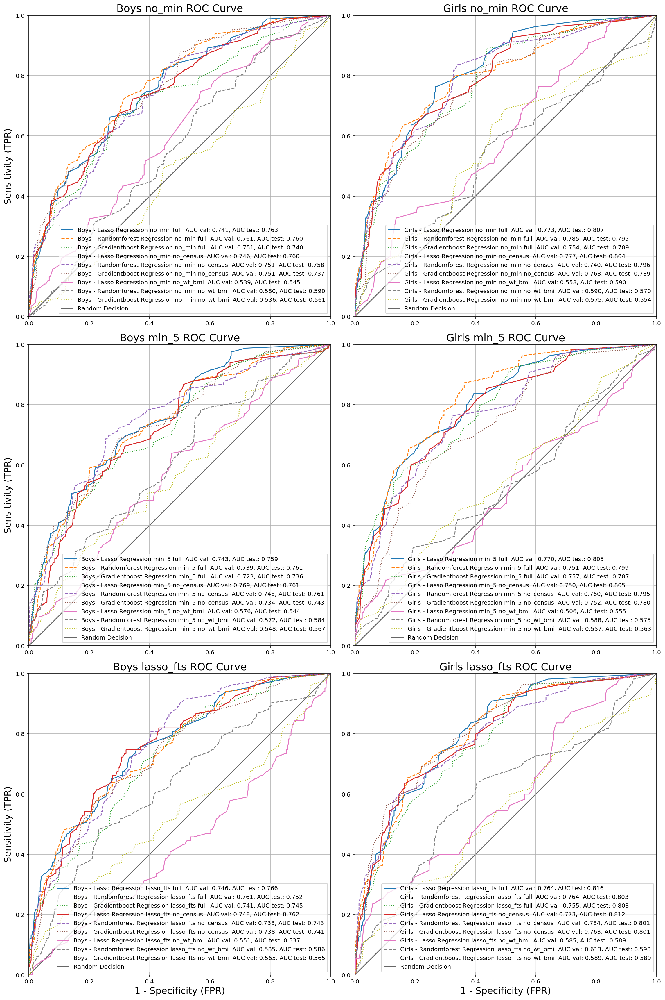

In [17]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['no_min','min_5','lasso_fts'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and all(ff not in t for ff in ('bmi_','wfl')) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    plt.title(f[0]+' '+f[1]+' ROC Curve', fontsize=18)
    if i%2 == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=16)
    if i in range(len(filters)-2,len(filters)):
        plt.xlabel('1 - Specificity (FPR)', fontsize=16)
    plt.grid(True)
    plt.tight_layout()

fig.savefig(newdir+'/all_final_multi_feature_regression_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

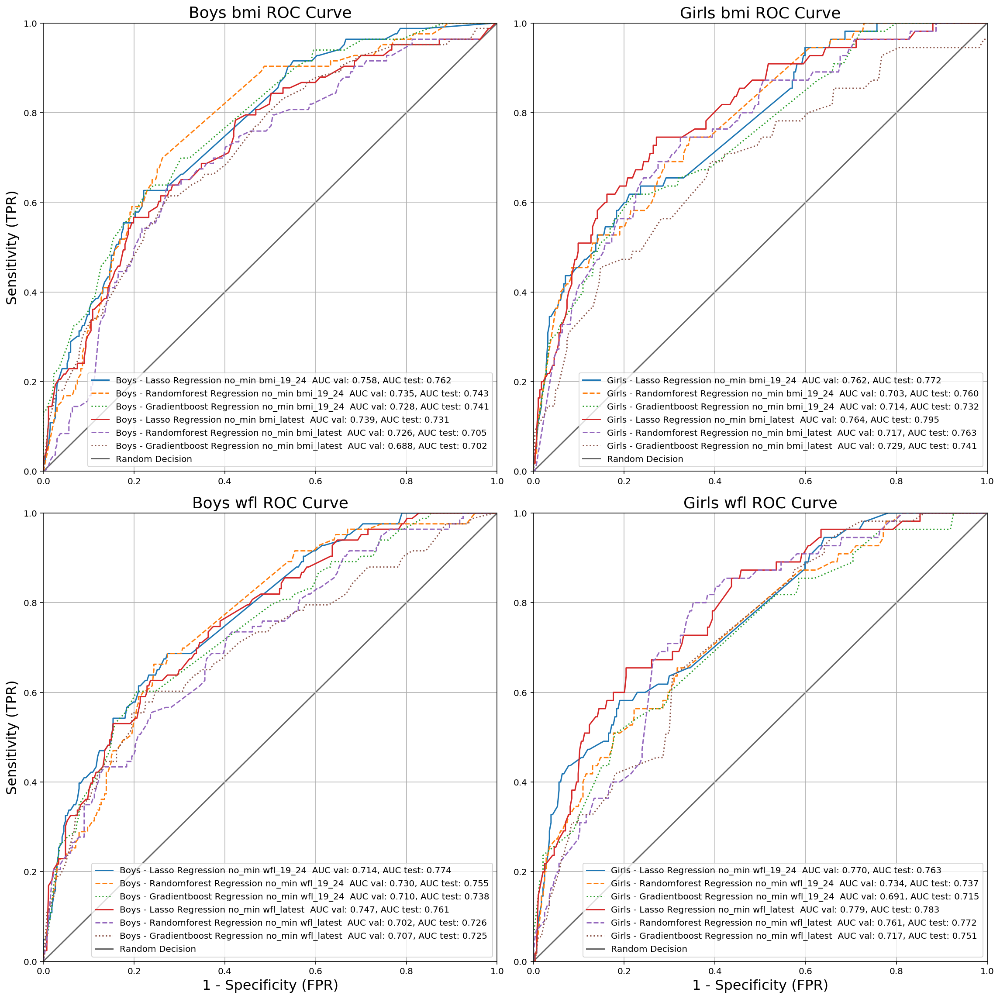

In [18]:
fig = plt.figure(figsize=(16,16))
filters = [(g,f) for f in ['bmi_','wfl'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(221+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    plt.title(f[0]+' '+f[1].strip('_')+' ROC Curve', fontsize=18)
    if i%2 == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=16)
    if i in range(len(filters)-2,len(filters)):
        plt.xlabel('1 - Specificity (FPR)', fontsize=16)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(newdir+'/all_final_single_feature_regression_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

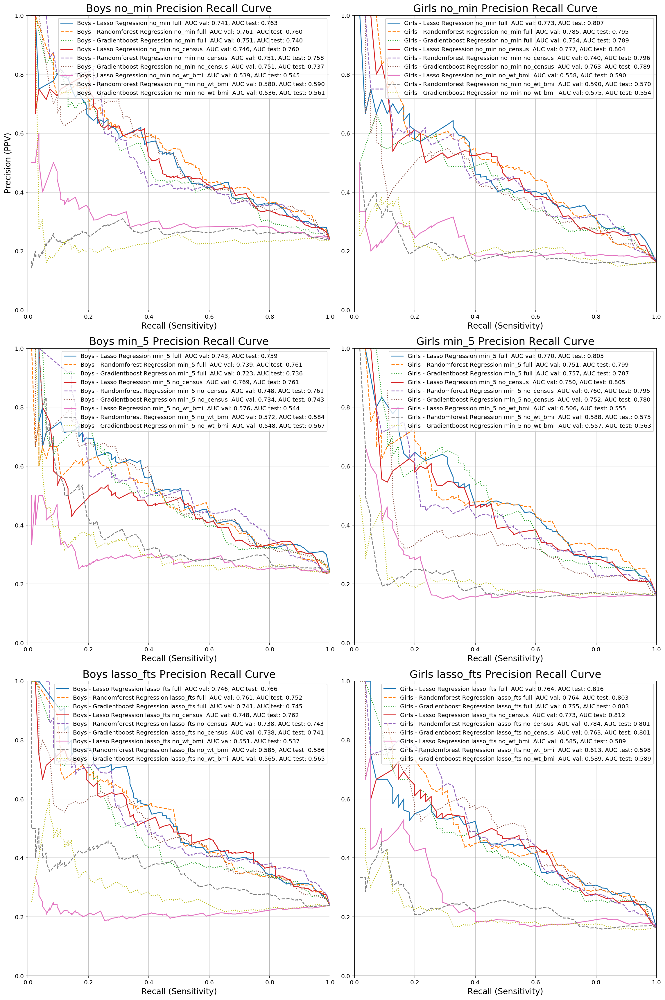

In [19]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['no_min','min_5','lasso_fts'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and all(ff not in t for ff in ('bmi_','wfl')) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            rec = results_list[ix][:,6]
            ppv = results_list[ix][:,5]
            index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
            plt.plot(rec[index:], ppv[index:], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.legend(fontsize=10)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.title(f[0]+' '+f[1]+' Precision Recall Curve', fontsize=18)
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=14)
    plt.xlabel('Recall (Sensitivity)', fontsize=14)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(newdir+'/all_final_multi_feature_regression_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

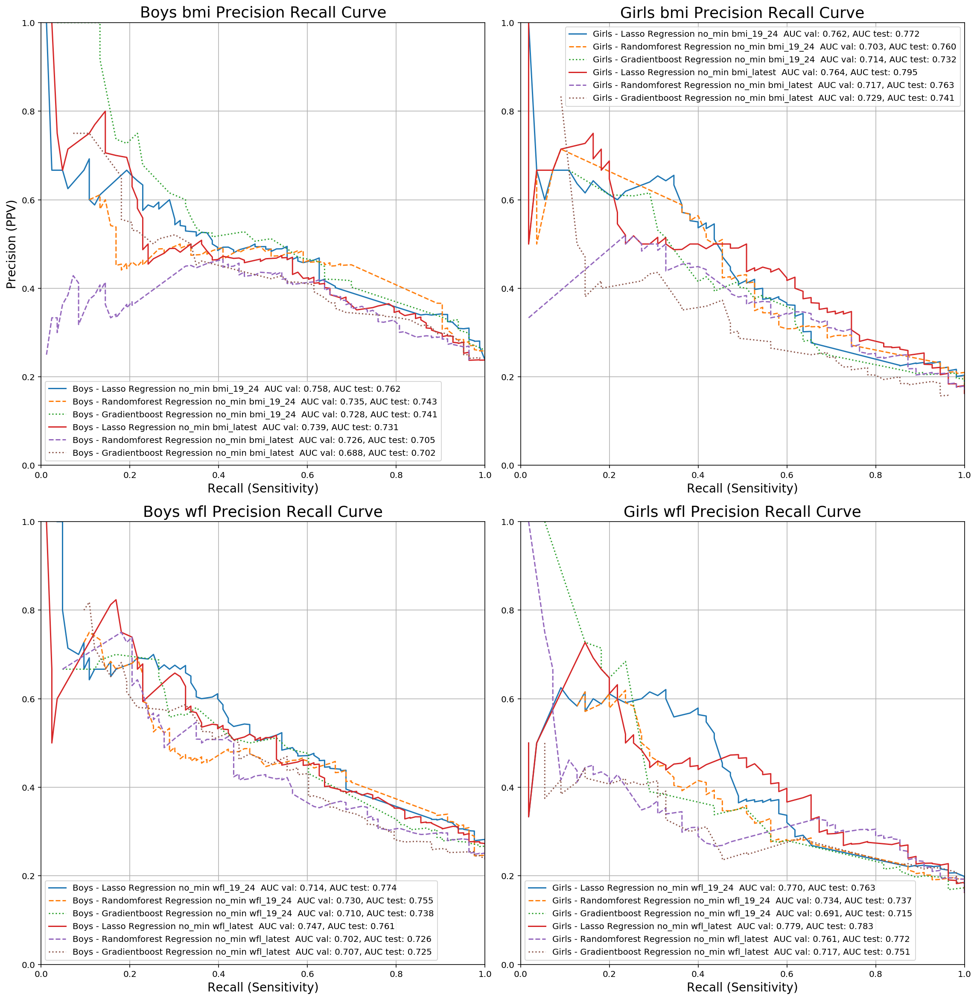

In [20]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['bmi_','wfl'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and 'Regression' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            rec = results_list[ix][:,6]
            ppv = results_list[ix][:,5]
            index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
            plt.plot(rec[index:], ppv[index:], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.legend(fontsize=10)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.title(f[0]+' '+f[1].strip('_')+' Precision Recall Curve', fontsize=18)
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=14)
    plt.xlabel('Recall (Sensitivity)', fontsize=14)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(newdir+'/all_final_single_feature_regression_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

### Plot the ROC and Precision Recall Curves for all the classification models

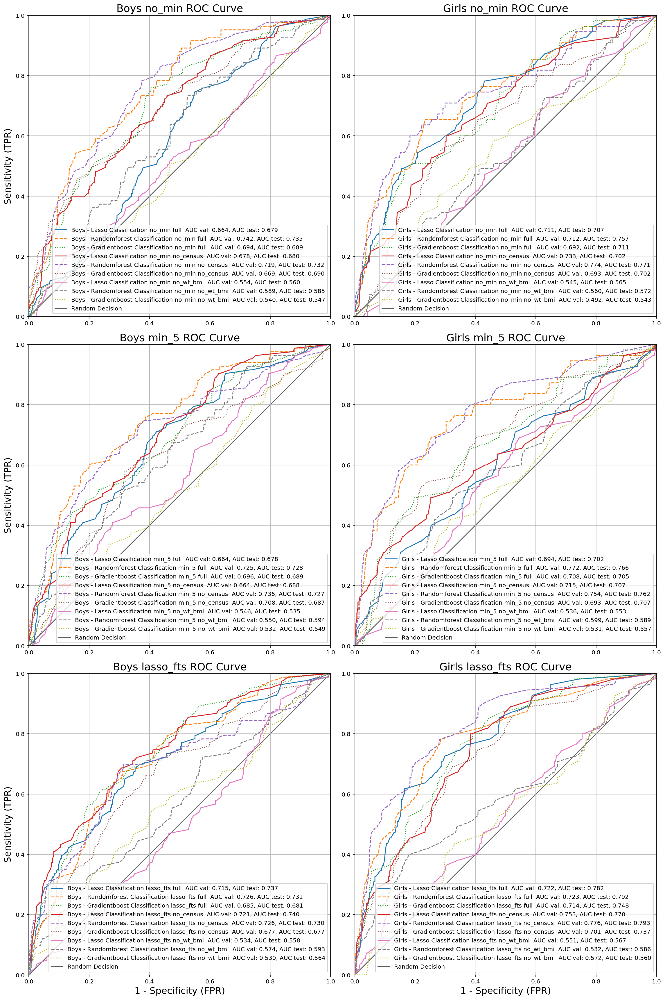

In [21]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['no_min','min_5','lasso_fts'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and all(ff not in t for ff in ('bmi_','wfl')) and 'Classification' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    plt.title(f[0]+' '+f[1]+' ROC Curve', fontsize=18)
    if i%2 == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=16)
    if i in range(len(filters)-2,len(filters)):
        plt.xlabel('1 - Specificity (FPR)', fontsize=16)
    plt.grid(True)
    plt.tight_layout()

fig.savefig(newdir+'/all_final_multi_feature_classification_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

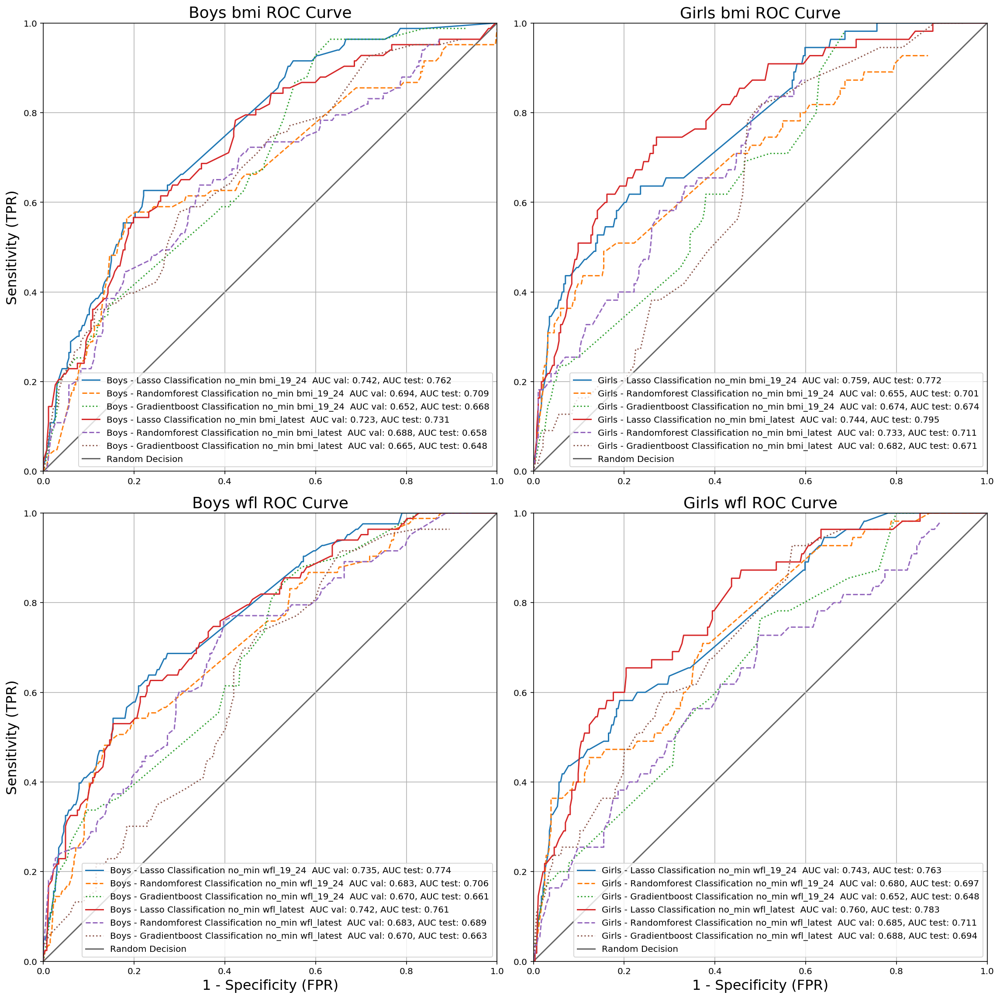

In [22]:
fig = plt.figure(figsize=(16,16))
filters = [(g,f) for f in ['bmi_','wfl'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(221+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and 'Classification' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    plt.title(f[0]+' '+f[1].strip('_')+' ROC Curve', fontsize=18)
    if i%2 == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=16)
    if i in range(len(filters)-2,len(filters)):
        plt.xlabel('1 - Specificity (FPR)', fontsize=16)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(newdir+'/all_final_single_feature_classification_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

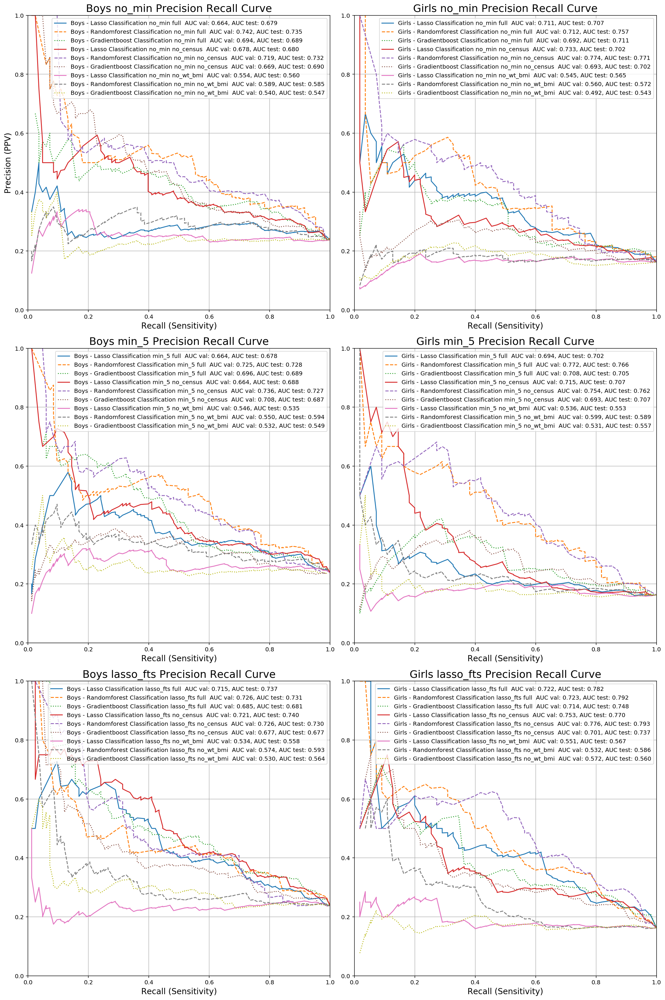

In [23]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['no_min','min_5','lasso_fts'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and all(ff not in t for ff in ('bmi_','wfl')) and 'Classification' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            rec = results_list[ix][:,6]
            ppv = results_list[ix][:,5]
            index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
            plt.plot(rec[index:], ppv[index:], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.legend(fontsize=10)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.title(f[0]+' '+f[1]+' Precision Recall Curve', fontsize=18)
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=14)
    plt.xlabel('Recall (Sensitivity)', fontsize=14)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(newdir+'/all_final_multi_feature_classification_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

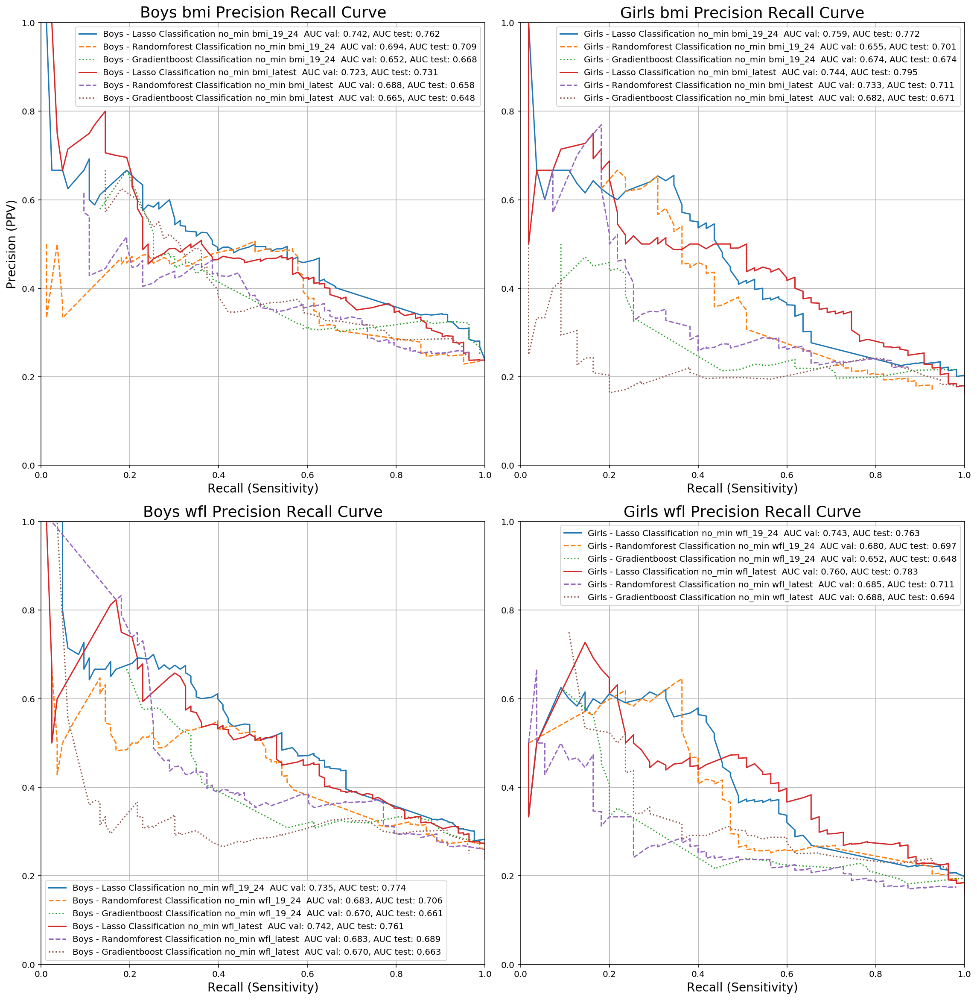

In [24]:
fig = plt.figure(figsize=(16,24))
filters = [(g,f) for f in ['bmi_','wfl'] for g in ['Boys','Girls']]
style = {'Lasso':'-', 'Randomforest':'--', 'Gradientboost':':'}
for i, f in enumerate(filters):
    ax = plt.subplot(321+i)
    for ix, t in enumerate(title_list):
        if all(ff in t for ff in f) and 'Classification' in t:
            ls = t.split(' - ')[1].split(' ')[0]
            rec = results_list[ix][:,6]
            ppv = results_list[ix][:,5]
            index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
            plt.plot(rec[index:], ppv[index:], linestyle=style[ls], label=t[:-9]+' AUC val: {0:4.3f}, AUC test: {1:4.3f}'.format(auc_list[ix][0], auc_list[ix][2]))
    
    plt.legend(fontsize=10)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.title(f[0]+' '+f[1].strip('_')+' Precision Recall Curve', fontsize=18)
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=14)
    plt.xlabel('Recall (Sensitivity)', fontsize=14)
    plt.grid(True)
    plt.tight_layout()
    
fig.savefig(newdir+'/all_final_single_feature_classification_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

### Plot the ROC and Precision Recall Curves for the best regression model and the best individual feature models

##### Note: these are the paper-ready figures (minus a few formatting bits)

In [25]:
df = pd.DataFrame(np.hstack((np.array(title_list).reshape(-1,1),np.array(auc_list),np.array(metric2_list),np.array(metric3_list))), 
                  columns=['title','AUC Validation Mean','AUC Validation Mean STE', 'AUC Test Mean', 'AUC Test STE',
                          'R^2/Accuracy Validation Mean','R^2/Accuracy Validation Mean STE', 'R^2/Accuracy Test Mean', 'R^2/Accuracy Test STE',
                          'Explained Variance/MCC Validation Mean','Explained Variance/MCC Validation Mean STE', 'Explained Variance/MCC Test Mean', 'Explained Variance/MCC Test STE'])


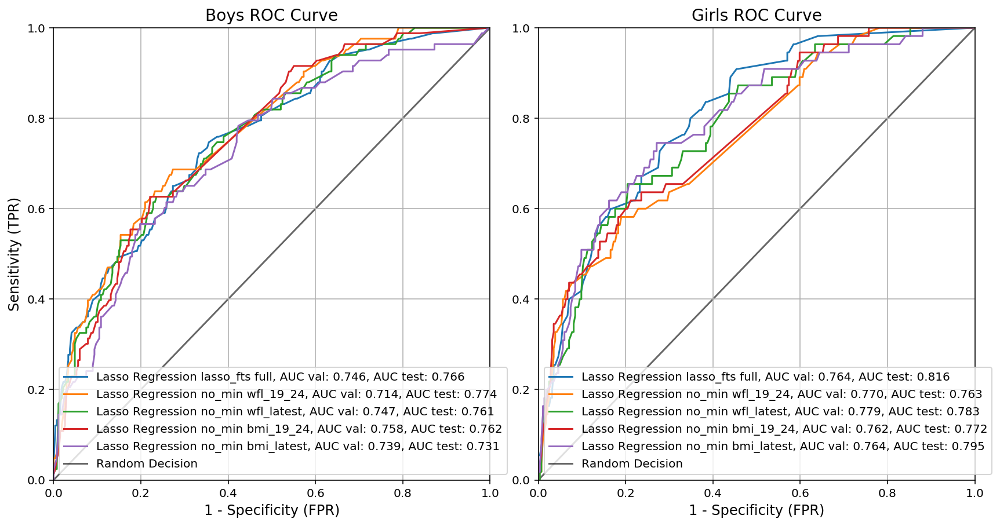

In [26]:
fig = plt.figure(figsize=(12,12))
# top_ix format: ['gender','age','index',title, auc, auc_low, auc_high,specificity,precision,recall]
for i,g in enumerate(['boys','girls']):
    plot_ix = [df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_') & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        ]
    ax = plt.subplot(221+i)
    title = g.title() + ' ROC Curve'
    plt.title(title, fontsize=14)
    for ix in plot_ix:
        w = 1.5
        s = title_list[ix].split(' - ')[1]
        end = s.find('@')
        lab = s[:end-1] + ', AUC val: {0:0.3f}, AUC test: {1:0.3f}'.format(auc_list[ix][0], auc_list[ix][2])
        plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linewidth=w, label=lab)
    plt.grid(True)
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    if i == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=12)
    plt.xlabel('1 - Specificity (FPR)', fontsize=12)
    plt.tight_layout()
            
fig.savefig(newdir+'/best_models_regression_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

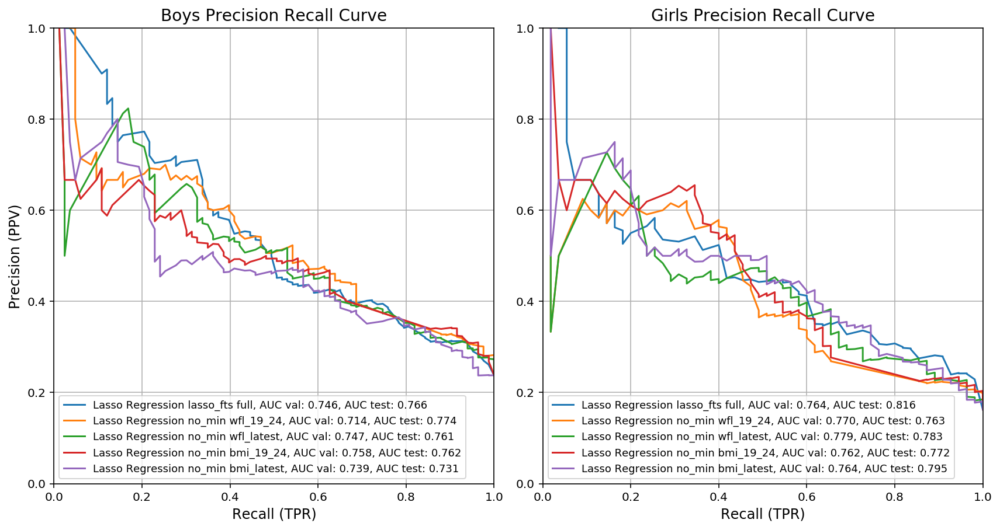

In [27]:
fig = plt.figure(figsize=(12,12))
# top_ix format: ['gender','age','index',title, auc, auc_low, auc_high,specificity,precision,recall]
for i,g in enumerate(['boys','girls']):
    plot_ix = [df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_') & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_19_24')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_latest')) & df.title.str.contains('Regression')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        ]
    ax = plt.subplot(221+i)
    title = g.title() + ' Precision Recall Curve'
    plt.title(title, fontsize=14)
    for ix in plot_ix:
        w = 1.5
        s = title_list[ix].split(' - ')[1]
        end = s.find('@')
        lab = s[:end-1] + ', AUC val: {0:0.3f}, AUC test: {1:0.3f}'.format(auc_list[ix][0], auc_list[ix][2])
        rec = results_list[ix][:,6]
        ppv = results_list[ix][:,5]
        index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
        plt.plot(rec[index:], ppv[index:], linewidth=w, label=lab)
    plt.grid(True)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.legend(fontsize=9, loc='lower left')
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=12)
    plt.xlabel('Recall (TPR)', fontsize=12)
    plt.tight_layout()
            
fig.savefig(newdir+'/best_models_regression_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

### Plot the ROC and Precision Recall Curves for the best classification model and the best individual feature models

##### Note: these are the paper-ready figures (minus a few formatting bits)

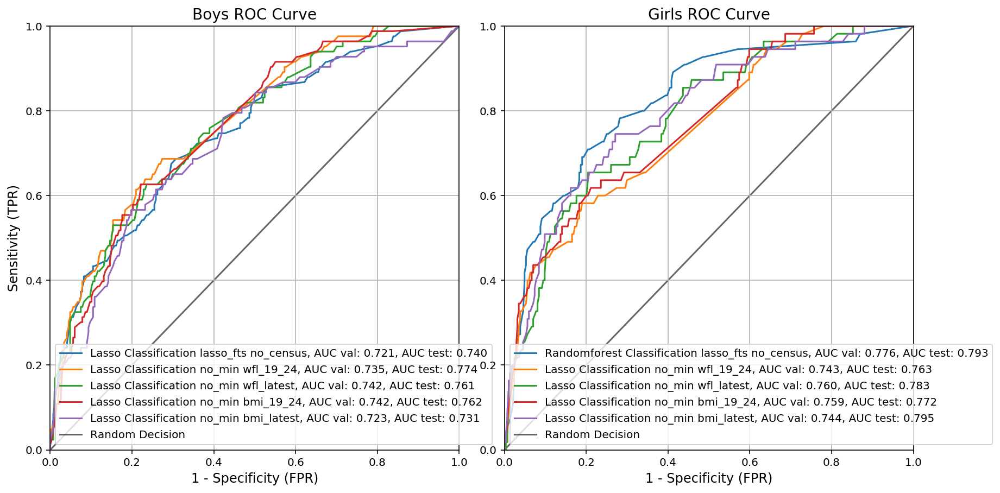

In [28]:
fig = plt.figure(figsize=(12,12))
# top_ix format: ['gender','age','index',title, auc, auc_low, auc_high,specificity,precision,recall]
for i,g in enumerate(['boys','girls']):
    plot_ix = [df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_') & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_19_24')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_latest')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_19_24')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_latest')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        ]
    ax = plt.subplot(221+i)
    title = g.title() + ' ROC Curve'
    plt.title(title, fontsize=14)
    for ix in plot_ix:
        w = 1.5
        s = title_list[ix].split(' - ')[1]
        end = s.find('@')
        lab = s[:end-1] + ', AUC val: {0:0.3f}, AUC test: {1:0.3f}'.format(auc_list[ix][0], auc_list[ix][2])
        plt.plot(1 - results_list[ix][:,7], results_list[ix][:,6], linewidth=w, label=lab)
    plt.grid(True)
    plt.xlim((0,1))
    plt.ylim((0,1))
    lims = [np.min([plt.xlim(), plt.ylim()]), np.max([plt.xlim(), plt.ylim()])]
    plt.plot(lims, lims, 'k-', alpha=0.6, zorder=0, label='Random Decision')
    plt.legend(fontsize=10)
    if i == 0:
        plt.ylabel('Sensitivity (TPR)', fontsize=12)
    plt.xlabel('1 - Specificity (FPR)', fontsize=12)
    plt.tight_layout()
            
fig.savefig(newdir+'/best_models_classification_AUC_ROC_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

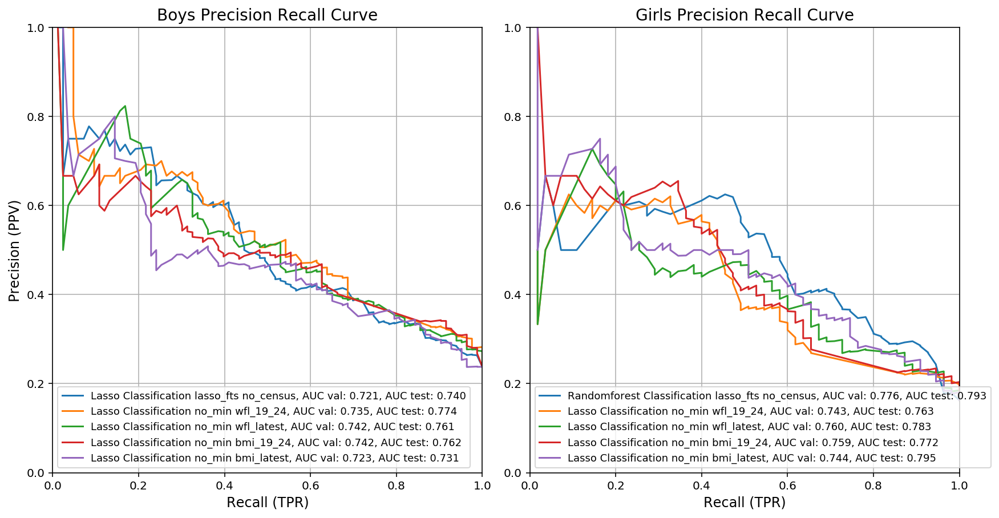

In [29]:
fig = plt.figure(figsize=(12,12))
# top_ix format: ['gender','age','index',title, auc, auc_low, auc_high,specificity,precision,recall]
for i,g in enumerate(['boys','girls']):
    plot_ix = [df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_') & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_19_24')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('wfl_latest')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_19_24')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0],
        df[df.title.str.contains(g.title()) & (df.title.str.contains('bmi_latest')) & df.title.str.contains('Classification')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        ]
    ax = plt.subplot(221+i)
    title = g.title() + ' Precision Recall Curve'
    plt.title(title, fontsize=14)
    for ix in plot_ix:
        w = 1.5
        s = title_list[ix].split(' - ')[1]
        end = s.find('@')
        lab = s[:end-1] + ', AUC val: {0:0.3f}, AUC test: {1:0.3f}'.format(auc_list[ix][0], auc_list[ix][2])
        rec = results_list[ix][:,6]
        ppv = results_list[ix][:,5]
        index = 1 + np.max(list(set([ix for ix,x in enumerate(rec) if x == 0]) & set([ix for ix,x in enumerate(ppv) if x == 0])))
        plt.plot(rec[index:], ppv[index:], linewidth=w, label=lab)
    plt.grid(True)
    plt.xlim((0,1))
    plt.ylim((0,1))
    plt.legend(fontsize=9, loc='lower left')
    if i == 0:
        plt.ylabel('Precision (PPV)', fontsize=12)
    plt.xlabel('Recall (TPR)', fontsize=12)
    plt.tight_layout()
            
fig.savefig(newdir+'/best_models_classification_prec_rec_comparison.png', bbox_inches='tight', dpi=360)
plt.show()

### Get the index for the best mult-feature model and display the top features for each of the best boys and girls models

In [30]:
pd.options.display.float_format = '{:,.4f}'.format
for col in df.columns:
    if col != 'title':
        df[col] = df[col].astype(float)
df.to_csv(newdir+'/val_test_results_matrix_24_months.csv',index=False)
df[df.title.str.contains('Girls')].sort_values(by='AUC Test Mean', ascending=False)

,title,AUC Validation Mean,AUC Validation Mean STE,AUC Test Mean,AUC Test STE,R^2/Accuracy Validation Mean,R^2/Accuracy Validation Mean STE,R^2/Accuracy Test Mean,R^2/Accuracy Test STE,Explained Variance/MCC Validation Mean,Explained Variance/MCC Validation Mean STE,Explained Variance/MCC Test Mean,Explained Variance/MCC Test STE
138,Girls - Lasso Regression lasso_fts full @24 obese,0.7637,0.0313,0.8159,0.0053,0.2631,0.0406,0.3499,0.0125,0.2530,0.0422,0.3426,0.0139
144,Girls - Lasso Regression lasso_fts no_census @...,0.7731,0.0274,0.8122,0.0035,0.2929,0.0348,0.3393,0.0125,0.2831,0.0344,0.3339,0.0129
78,Girls - Lasso Regression no_min full @24 obese,0.7733,0.0255,0.8075,0.0051,0.2736,0.0295,0.3085,0.0110,0.2605,0.0292,0.3009,0.0124
120,Girls - Lasso Regression min_5 full @24 obese,0.7697,0.0241,0.8054,0.0062,0.2818,0.0337,0.3172,0.0171,0.2648,0.0395,0.3146,0.0179
126,Girls - Lasso Regression min_5 no_census @24 o...,0.7498,0.0209,0.8047,0.0039,0.2530,0.0362,0.3260,0.0136,0.2429,0.0359,0.3200,0.0147
84,Girls - Lasso Regression no_min no_census @24 ...,0.7767,0.0339,0.8037,0.0043,0.2587,0.0300,0.3122,0.0167,0.2438,0.0294,0.3058,0.0186
140,Girls - Randomforest Regression lasso_fts full...,0.7638,0.0258,0.8032,0.0060,0.2328,0.0328,0.3353,0.0111,0.2220,0.0340,0.3302,0.0117
142,Girls - Gradientboost Regression lasso_fts ful...,0.7547,0.0302,0.8031,0.0068,0.2629,0.0484,0.3182,0.0132,0.2478,0.0509,0.3011,0.0154
146,Girls - Randomforest Regression lasso_fts no_c...,0.7837,0.0257,0.8013,0.0057,0.2739,0.0366,0.3380,0.0093,0.2649,0.0377,0.3357,0.0092
148,Girls - Gradientboost Regression lasso_fts no_...,0.7628,0.0261,0.8008,0.0059,0.2487,0.0431,0.3107,0.0114,0.2353,0.0449,0.2931,0.0125


In [31]:
df[df.title.str.contains('Boys')].sort_values(by='AUC Test Mean', ascending=False)

,title,AUC Validation Mean,AUC Validation Mean STE,AUC Test Mean,AUC Test STE,R^2/Accuracy Validation Mean,R^2/Accuracy Validation Mean STE,R^2/Accuracy Test Mean,R^2/Accuracy Test STE,Explained Variance/MCC Validation Mean,Explained Variance/MCC Validation Mean STE,Explained Variance/MCC Test Mean,Explained Variance/MCC Test STE
19,Boys - Lasso Classification no_min wfl_19_24 @...,0.7345,0.0281,0.7737,0.0000,0.8019,0.0127,0.7889,0.0034,0.2593,0.0496,0.2968,0.0222
18,Boys - Lasso Regression no_min wfl_19_24 @24 o...,0.7140,0.0341,0.7737,0.0000,0.1817,0.0490,0.2869,0.0031,0.1719,0.0514,0.2830,0.0030
60,Boys - Lasso Regression lasso_fts full @24 obese,0.7465,0.0196,0.7660,0.0055,0.2469,0.0274,0.3014,0.0088,0.2362,0.0272,0.2988,0.0087
0,Boys - Lasso Regression no_min full @24 obese,0.7407,0.0314,0.7631,0.0042,0.2358,0.0280,0.2865,0.0089,0.2241,0.0279,0.2831,0.0086
31,Boys - Lasso Classification no_min bmi_19_24 @...,0.7422,0.0271,0.7620,0.0000,0.7986,0.0146,0.7834,0.0020,0.2776,0.0552,0.2754,0.0121
30,Boys - Lasso Regression no_min bmi_19_24 @24 o...,0.7577,0.0157,0.7620,0.0000,0.2547,0.0356,0.2769,0.0018,0.2435,0.0361,0.2725,0.0035
66,Boys - Lasso Regression lasso_fts no_census @2...,0.7480,0.0232,0.7616,0.0048,0.2319,0.0388,0.3041,0.0092,0.2205,0.0374,0.2984,0.0094
48,Boys - Lasso Regression min_5 no_census @24 obese,0.7686,0.0235,0.7613,0.0043,0.2454,0.0336,0.2825,0.0083,0.2395,0.0348,0.2797,0.0093
50,Boys - Randomforest Regression min_5 no_census...,0.7484,0.0257,0.7610,0.0056,0.2323,0.0331,0.2791,0.0095,0.2176,0.0342,0.2743,0.0097
25,Boys - Lasso Classification no_min wfl_latest ...,0.7417,0.0195,0.7607,0.0000,0.7986,0.0163,0.7907,0.0017,0.2115,0.0645,0.2950,0.0108


In [32]:
for i,g in enumerate(['boys','girls']):
    if g=='boys':
        boys_ix=df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        print(g, boys_ix)
    else:
        girls_ix=df[df.title.str.contains(g.title()) & ~df.title.str.contains('wfl') & ~df.title.str.contains('bmi_')].sort_values(by='AUC Test Mean', ascending=False).index[0]
        print(g, girls_ix)

boys 60
girls 138


In [33]:
boys_fts = pd.DataFrame(features_list[boys_ix], columns=feature_data_cols)
girls_fts = pd.DataFrame(features_list[girls_ix], columns=feature_data_cols)

In [34]:
print(title_list[boys_ix], auc_list[boys_ix][2], '(', auc_list[boys_ix][2] - auc_list[boys_ix][3], auc_list[boys_ix][2] + auc_list[boys_ix][3], ')')
boys_fts.head(20)

Boys - Lasso Regression lasso_fts full @24 obese 0.766025901358 ( 0.760496184079 0.771555618638 )


,feature,significant,occurrences,auc,weight/importance,wt_low,wt_high,OR,OR_low,OR_high,OR_adj,OR_adj_low,OR_adj_high,Top1CorrFeat,Top1CorrVal,Top2CorrFeat,Top2CorrVal,Top3CorrFeat,Top3CorrVal,Top4CorrFeat,Top4CorrVal,Top5CorrFeat,Top5CorrVal,Top6CorrFeat,Top6CorrVal,Top7CorrFeat,Top7CorrVal,Top8CorrFeat,Top8CorrVal,Top9CorrFeat,Top9CorrVal,Top10CorrFeat,Top10CorrVal
0,Vital: Wt-avg19to24,True,1417,0.7489,0.1313,0.0838,0.1787,4.0670,3.2093,5.1540,1.1403,1.0874,1.1957,MatDeliveryAge,-0.0294,Census:Unemployment rate; Estimate; Population...,-0.0257,Census:Percent; Estimate; Population 25 years ...,-0.0185,Census:Percent; Estimate; Population 25 years ...,-0.0179,Census:Percent with a disability; Estimate; To...,0.0093,Census:Percent; Estimate; Population 18 to 24 ...,-0.0061,,0,,0,,0,,0
1,Vital: BMI-latest,True,1672,0.7311,0.1067,0.0607,0.1526,4.4826,3.4961,5.7474,1.1126,1.0626,1.1649,MatDeliveryAge,-0.0528,Census:Unemployment rate; Estimate; Population...,-0.0341,Census:Percent; Estimate; Population 25 years ...,-0.0239,Census:Percent; Estimate; Population 25 years ...,-0.0239,Census:Percent; Estimate; Population 18 to 24 ...,0.0031,Census:Percent with a disability; Estimate; To...,-0.0007,,0,,0,,0,,0
2,Vital: BMI-gain0to24,True,1391,0.7487,0.0993,0.0496,0.1490,4.2470,3.3492,5.3855,1.1043,1.0508,1.1606,MatDeliveryAge,-0.0443,Census:Unemployment rate; Estimate; Population...,-0.0209,Census:Percent; Estimate; Population 18 to 24 ...,0.0158,Census:Percent with a disability; Estimate; To...,0.0106,Census:Percent; Estimate; Population 25 years ...,-0.0087,Census:Percent; Estimate; Population 25 years ...,-0.0083,,0,,0,,0,,0
3,Vital: Wt-gain0to24,True,1411,0.7353,0.0544,0.0065,0.1023,3.9490,3.1183,5.0011,1.0559,1.0065,1.1077,MatDeliveryAge,-0.0339,Census:Unemployment rate; Estimate; Population...,-0.0231,Census:Percent; Estimate; Population 25 years ...,-0.0171,Census:Percent; Estimate; Population 25 years ...,-0.0165,Census:Percent with a disability; Estimate; To...,0.0119,Census:Percent; Estimate; Population 18 to 24 ...,-0.0050,,0,,0,,0,,0
4,Vital: Ht-avg7to10,False,1343,0.4826,-0.0475,-0.0786,-0.0165,1.2011,0.9511,1.5168,0.9536,0.9244,0.9837,Census:Percent with a disability; Estimate; To...,0.0320,Census:Percent; Estimate; Population 25 years ...,0.0233,Census:Percent; Estimate; Population 25 years ...,0.0233,Census:Percent; Estimate; Population 18 to 24 ...,-0.0176,MatDeliveryAge,0.0142,Census:Unemployment rate; Estimate; Population...,-0.0036,,0,,0,,0,,0
5,Vital: BMI-avg16to19,True,1293,0.7232,0.0343,0.0167,0.0520,3.1889,2.5265,4.0249,1.0349,1.0168,1.0534,MatDeliveryAge,-0.0568,Census:Percent; Estimate; Population 25 years ...,-0.0463,Census:Percent; Estimate; Population 25 years ...,-0.0454,Census:Unemployment rate; Estimate; Population...,-0.0403,Census:Percent with a disability; Estimate; To...,-0.0184,Census:Percent; Estimate; Population 18 to 24 ...,0.0096,,0,,0,,0,,0
6,Vital: Wt for Length ZScore-latest,True,1665,0.7607,0.0312,0.0002,0.0622,4.5113,3.5029,5.8101,1.0317,1.0002,1.0642,MatDeliveryAge,-0.0467,Census:Unemployment rate; Estimate; Population...,-0.0365,Census:Percent; Estimate; Population 18 to 24 ...,0.0136,Census:Percent; Estimate; Population 25 years ...,-0.0084,Census:Percent; Estimate; Population 25 years ...,-0.0080,Census:Percent with a disability; Estimate; To...,0.0019,,0,,0,,0,,0
7,MatDeliveryAge,False,1751,0.5294,0.0312,0.0118,0.0506,1.1048,0.8812,1.3850,1.0317,1.0119,1.0519,MatDeliveryAge,1.0000,Census:Percent with a disability; Estimate; To...,0.0248,Census:Percent; Estimate; Population 18 to 24 ...,0.0146,Census:Percent; Estimate; Population 25 years ...,0.0130,Census:Percent; Estimate; Population 25 years ...,0.0119,Census:Unemployment rate; Estimate; Population...,-0.0045,,0,,0,,0,,0
8,Vital: Wt for Length ZScore-avg16to19,True,1292,0.7180,0.0253,-0.0063,0.0569,3.1427,2.4904,3.9657,1.0257,0.9938,1.0586,MatDeliveryAge,-0.0714,Census:Percent; Estimate; Population 25 years ...,-0.0450,Census:Percent;

In [35]:
print(title_list[girls_ix], auc_list[girls_ix][2], '(', auc_list[girls_ix][2] - auc_list[girls_ix][3], auc_list[girls_ix][2] + auc_list[girls_ix][3], ')')
girls_fts.head(20)

Girls - Lasso Regression lasso_fts full @24 obese 0.81588028169 ( 0.81061477444 0.82114578894 )


,feature,significant,occurrences,auc,weight/importance,wt_low,wt_high,OR,OR_low,OR_high,OR_adj,OR_adj_low,OR_adj_high,Top1CorrFeat,Top1CorrVal,Top2CorrFeat,Top2CorrVal,Top3CorrFeat,Top3CorrVal,Top4CorrFeat,Top4CorrVal,Top5CorrFeat,Top5CorrVal,Top6CorrFeat,Top6CorrVal,Top7CorrFeat,Top7CorrVal,Top8CorrFeat,Top8CorrVal,Top9CorrFeat,Top9CorrVal,Top10CorrFeat,Top10CorrVal
0,Vital: BMI-avg19to24,True,1354,0.7724,0.1242,0.0615,0.1869,4.0462,3.0618,5.3473,1.1323,1.0634,1.2056,Maternal Vital: Wt-postPregnancy,0.1044,Census:Percent; Estimate; Population 25 years ...,0.0451,Census:Unemployment rate; Estimate; Population...,0.0391,Number of Visits,-0.0344,MatDeliveryAge,-0.0127,,0,,0,,0,,0,,0
1,Maternal Vital: Wt-postPregnancy,True,666,0.5875,0.1188,0.0640,0.1736,1.8455,1.3364,2.5485,1.1261,1.0661,1.1895,Maternal Vital: Wt-postPregnancy,1.0000,MatDeliveryAge,0.1243,Census:Unemployment rate; Estimate; Population...,-0.0218,Number of Visits,-0.0036,Census:Percent; Estimate; Population 25 years ...,0.0012,,0,,0,,0,,0,,0
2,Vital: BMI-avg13to16,True,1286,0.7249,0.1119,0.0558,0.1680,3.8142,2.8888,5.0361,1.1184,1.0574,1.1830,Maternal Vital: Wt-postPregnancy,0.0620,Number of Visits,-0.0258,Census:Percent; Estimate; Population 25 years ...,0.0119,MatDeliveryAge,-0.0053,Census:Unemployment rate; Estimate; Population...,-0.0044,,0,,0,,0,,0,,0
3,Vital: Wt-latest,True,1626,0.7611,0.0772,0.0460,0.1083,3.5002,2.5707,4.7660,1.0802,1.0471,1.1144,Number of Visits,0.3771,Maternal Vital: Wt-postPregnancy,0.1392,Census:Percent; Estimate; Population 25 years ...,0.0570,MatDeliveryAge,0.0481,Census:Unemployment rate; Estimate; Population...,0.0055,,0,,0,,0,,0,,0
4,Vital: BMI-avg16to19,True,1269,0.7923,0.0733,0.0318,0.1148,3.1309,2.3848,4.1106,1.0760,1.0323,1.1217,Census:Percent; Estimate; Population 25 years ...,0.0464,Number of Visits,-0.0428,Maternal Vital: Wt-postPregnancy,0.0416,Census:Unemployment rate; Estimate; Population...,0.0257,MatDeliveryAge,-0.0210,,0,,0,,0,,0,,0
5,Vital: BMI-gain0to24,True,1338,0.7783,0.0659,0.0105,0.1213,3.9232,2.9729,5.1774,1.0681,1.0106,1.1290,Maternal Vital: Wt-postPregnancy,0.1033,Census:Percent; Estimate; Population 25 years ...,0.0385,Census:Unemployment rate; Estimate; Population...,0.0338,Number of Visits,-0.0309,MatDeliveryAge,-0.0103,,0,,0,,0,,0,,0
6,Vital: Wt for Length ZScore-avg3to5,True,1299,0.6044,0.0654,0.0339,0.0968,1.9020,1.4550,2.4863,1.0675,1.0345,1.1016,Maternal Vital: Wt-postPregnancy,0.0514,Census:Unemployment rate; Estimate; Population...,-0.0462,Census:Percent; Estimate; Population 25 years ...,0.0234,Number of Visits,-0.0134,MatDeliveryAge,-0.0025,,0,,0,,0,,0,,0
7,Vital: Wt for Length ZScore-latest,True,1612,0.7832,0.0637,0.0303,0.0971,4.3672,3.2337,5.8979,1.0658,1.0308,1.1019,Maternal Vital: Wt-postPregnancy,0.1057,Number of Visits,0.0698,Census:Percent; Estimate; Population 25 years ...,0.0526,Census:Unemployment rate; Estimate; Population...,0.0143,MatDeliveryAge,-0.0042,,0,,0,,0,,0,,0
8,Vital: Wt-avg16to19,True,1298,0.7356,0.0623,0.0139,0.1107,3.0603,2.3314,4.0170,1.0643,1.0140,1.1171,Maternal Vital: Wt-postPregnancy,0.0925,Census:Unemployment rate; Estimate; Population...,0.0446,MatDeliveryAge,-0.0399,Census:Percent; Estimate; Population 25 years ...,0.0142,Number of Visits,-0.0139,,0,,0,,0,,0,,0
9,Vital: BMI-latest,True,1621,0.7952,0.0570,0.0169,0.0970,4.7657,3.5275,6.4384,1.0586,1.0171,1.1018,Maternal Vital: Wt-postPregnancy,0.0982,Census:Percent; Estimate; Population 25 years ...,0.0465,Number of Visits,0.0356,Census:Unemployment rate; Estimate; Population...,0.0102,MatDeliveryAge,0.0006,,0,,0,,0,,0,,0


## By how much does regression outperform classification?

In [37]:
diff = []
reg_auc_boys = df[df.title.str.contains('Boys') & df.title.str.contains('Regression')].sort_values(by='title')['AUC Test Mean'].values
clas_auc_boys = df[df.title.str.contains('Boys') & df.title.str.contains('Classification')].sort_values(by='title')['AUC Test Mean'].values

for reg, clas in zip(reg_auc_boys, clas_auc_boys):
    diff.append(reg - clas)

mean = np.mean(diff)
ste = (1.96/np.sqrt(len(diff))) * np.std(diff)
print('Boys Average AUC difference: {0:4.3f} [{1:4.3f}, {2:4.3f}]'.format(mean, mean-ste, mean+ste))

diff = []
reg_auc_girls = df[df.title.str.contains('Girls') & df.title.str.contains('Regression')].sort_values(by='title')['AUC Test Mean'].values
clas_auc_girls = df[df.title.str.contains('Girls') & df.title.str.contains('Classification')].sort_values(by='title')['AUC Test Mean'].values

for reg, clas in zip(reg_auc_girls, clas_auc_girls):
    diff.append(reg - clas)

mean = np.mean(diff)
ste = (1.96/np.sqrt(len(diff))) * np.std(diff)
print('Girls Average AUC difference: {0:4.3f} [{1:4.3f}, {2:4.3f}]'.format(mean, mean-ste, mean+ste))

Boys Average AUC difference: 0.033 [0.023, 0.042]
Girls Average AUC difference: 0.042 [0.031, 0.052]
